# Implemented Algorithms and Function

These functions: routines and algorithms are used throughout this notebook for computation and statistical plotting.

The computational / statistical algorithms and the parameters used are inspired from Poldrack, R., Mumford, J., & Nichols, T. (2011). *Handbook of Functional MRI Data Analysis*. Cambridge: Cambridge University Press. and  F., Gregory Ashby. (2019). *Statistical Analysis of fMRI Data*. MIT Press.



#### Imports

In [ ]:
from warnings import filterwarnings
filterwarnings('ignore')
import numpy as np
import pandas as pd
from numpy import array
import matplotlib.pyplot as plt


import gzip, shutil
import time
import yaml
import glob

from nilearn import image, plotting
from nilearn.plotting import plot_stat_map
from nilearn.image import concat_imgs, mean_img
from nistats.design_matrix import make_first_level_design_matrix
from nistats.first_level_model import FirstLevelModel
from nistats.second_level_model import SecondLevelModel
from nilearn.plotting import plot_roi
from nilearn.masking import compute_background_mask
from nilearn.image import threshold_img



from nilearn.image import math_img
from nilearn import input_data
from nilearn.input_data import NiftiMasker

from nistats.reporting import plot_design_matrix,plot_contrast_matrix
from nistats.thresholding import map_threshold
from nistats.reporting import get_clusters_table
from nistats.experimental_paradigm import check_events

from sklearn.feature_selection import f_classif, mutual_info_classif, SelectFdr

from sklearn.feature_selection import GenericUnivariateSelect
from sklearn import svm
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier        
    
%matplotlib inline

/Users/zakariabekkar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:17: FutureWarning: 

 | Starting with Nilearn 0.7.0, all Nistats functionality has been incorporated into Nilearn's stats & reporting modules.
 | Nistats package will no longer be updated or maintained.

/Users/zakariabekkar/anaconda3/lib/python3.7/site-packages/sklearn/externals/joblib/__init__.py:15: DeprecationWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=DeprecationWarning)


## GLM

In [ ]:
def compute_core_fmri_glm(task,
                          data_path,
                          events_path,
                          motion_param_path,
                          cache_mem_path,
                          analysis_type,
                          param_modulation,
                          t_r,
                          slice_time_ref,
                          hrf_model,
                          drift_model,
                          drift_order,
                          fbr_expected_tr_delay,
                          pre_whitening_spec,
                          apply_trans_mask,
                          roi_img,
                          hpf_cut,
                          smoothing_fwhm,
                          standardize,
                          detrend,minimize_memory):
    
                          
                          
    # Data processing                      

    data = image.load_img(data_path)
    m_img = mean_img(data) # mean niimg for plotting purposes
    motion = pd.read_csv(motion_param_path,sep=',',header=None)
    motion = motion[list(range(1,7))]
    motion_col = ['tx', 'ty', 'tz', 'rx', 'ry', 'rz']
    motion.columns = motion_col



    #Experimental Paradigm Processing

    events = pd.read_csv(events_path,sep='\t')
    events.columns = ['onset','duration','trial_type','modulation']
    events.dropna(inplace=True)
    events.index = range(len(events))
    
    
    
    if analysis_type == 'High_Low_Pleasance':
        
        events['trial_type_desc'] = ['High Pleasance' if x >=50 else 'Low Pleasance' for x in events['modulation'] ]
        
        if param_modulation:
           
            events = events[['onset','duration','trial_type_desc','modulation']]
            events.columns = ['onset','duration','trial_type','modulation']
        else:
            events = events[['onset','duration','trial_type_desc']]
            events.columns = ['onset','duration','trial_type']
            


    elif analysis_type == 'High_Mid_Low_Pleasance':
        
        events['trial_type_desc'] = ['High Pleasance' if x >=67 else 'Mid Pleasance' if x>=34 else 'Low Pleasance' for x in events['modulation'] ]
        
        if param_modulation:
           
            events = events[['onset','duration','trial_type_desc','modulation']]
            events.columns = ['onset','duration','trial_type','modulation']
        else:
            events = events[['onset','duration','trial_type_desc']]
            events.columns = ['onset','duration','trial_type']
            
    
    # Design Matrix Computation + plotting
    
    frametimes = np.linspace(0, (data.shape[3] - 1) * t_r, data.shape[3])
    
    fir_delays = list(range(1,fbr_expected_tr_delay+1)) if fbr_expected_tr_delay != None else None
    
    design_matrix = make_first_level_design_matrix(frametimes,
                       events=events,
                       add_regs=motion,
                       add_reg_names=motion_col,
                       hrf_model=hrf_model,
                       drift_model= drift_model,
                       fir_delays= fir_delays, 
                       drift_order =drift_order)
    
    plot_design_matrix(design_matrix)
    
    # Statistically Enhancing Mask Computation
    
    if apply_trans_mask:
    
    
        masker = input_data.NiftiMasker(mask_img=roi_img,smoothing_fwhm=smoothing_fwhm,
                                standardize=standardize,detrend=detrend,
                                high_pass=hpf_cut,t_r=t_r).fit(data)
      
    else :
        
        masker = input_data.NiftiMasker(mask_img=roi_img).fit(data)
        
        
        
    # GLM instantiation and fit
    
    glm = FirstLevelModel(t_r=t_r,
                      slice_time_ref=slice_time_ref,
                      mask_img=masker,
                      noise_model= pre_whitening_spec,
                      high_pass=hpf_cut,
                      smoothing_fwhm = smoothing_fwhm,
                      standardize=standardize,
                      memory=cache_mem_path,
                      minimize_memory=minimize_memory, 
                      verbose=1)

    glm = glm.fit(data,design_matrices=design_matrix)
    
    return glm, design_matrix

## Statistical Plotting

In [ ]:
def top_cluster_stat_results(data,task,glm,z_map,threshold,table,bg_img):
    
    # Top Cluster Selection + Masking
    coords = table.loc[range(1, 7), ['X', 'Y', 'Z']].values
    masker = input_data.NiftiSpheresMasker(coords,standardize=True)
    real_timeseries = masker.fit_transform(data)
    predicted_timeseries = masker.fit_transform(glm.predicted[0])

    
    


    # PLOT 1
    fig1, axs1 = plt.subplots(2, 3)
    for i in range(0, 3):
        axs1[0, i].set_title(' Top {} Activated Cluster \n(cluster peak voxel at coord {})'.format(i+1,coords[i]))
        axs1[0, i].plot(real_timeseries[:, i], c='blue', lw=2,label = 'Actual Bold Signal')
        axs1[0, i].plot(predicted_timeseries[:, i], c='r',  ls='-', lw=2,label= 'Predicted Bold Signal')
        axs1[0, i].set_xlabel('Time')
        axs1[0, i].set_ylabel('Signal intensity', labelpad=0)
        axs1[0, i].legend()
        roi_img = plotting.plot_stat_map(
            z_map, cut_coords=[coords[i][2]], threshold=threshold, figure=fig1,
            axes=axs1[1, i], display_mode='z', colorbar=False, bg_img=bg_img,title='{} Task : Low Pleasance (fdr=0.05, threshold = {})'.format(task,threshold))
        roi_img.add_markers([coords[i]], 'green', 300)
    fig1.set_size_inches(50, 19)
    plt.show()


    #PLOT 2
    fig2, axs2 = plt.subplots(2, 3)
    for i in range(3, 6):
        axs2[0, i-3].set_title(' Top {} Activated Cluster \n(cluster peak voxel at coord {})'.format(i+1,coords[i]))
        axs2[0, i-3].plot(real_timeseries[:, i], c='blue', lw=2,label = 'Actual Bold Signal')
        axs2[0, i-3].plot(predicted_timeseries[:, i], c='r',  ls='-', lw=2,label= 'Predicted Bold Signal')
        axs2[0, i-3].set_xlabel('Time')
        axs2[0, i-3].set_ylabel('Signal intensity', labelpad=0)
        axs2[0, i-3].legend()
        roi_img = plotting.plot_stat_map(
            z_map, cut_coords=[coords[i][2]], threshold=threshold, figure=fig2,
            axes=axs2[1, i-3], display_mode='z', colorbar=False, bg_img=bg_img,title='{} Task : Low Pleasance (fdr=0.05, threshold = {})'.format(task,threshold))
        roi_img.add_markers([coords[i]], 'green', 300)
    fig2.set_size_inches(50, 19)
    plt.show()

        

In [ ]:
def stat_result_long(z_map,contrast_name,task,alpha,method,bg_img):
    
    _, threshold = map_threshold(z_map, alpha=alpha, height_control=method)
    table = get_clusters_table(z_map, stat_threshold=threshold)
    plot_stat_map(z_map, bg_img=bg_img, threshold=threshold,
                  display_mode = 'z', cut_coords=5,
                   black_bg=True,
                  title='{} Task : {} ({}={}, threshold = {})'.format(task,contrast_name,method,alpha,threshold))
    plt.show()
    return table, threshold

In [ ]:
def stat_result(z_map,contrast_name,task,alpha,method,bg_img):
    
    _, threshold = map_threshold(z_map, alpha=alpha, height_control=method)
    table = get_clusters_table(z_map, stat_threshold=threshold)
    plot_stat_map(z_map, bg_img=bg_img, threshold=threshold,
                   black_bg=True,
                  title='{} Task : {} ({}={}, threshold = {})'.format(task,contrast_name,method,alpha,threshold))
    plt.show()
    return table, threshold

## MVPA

In [ ]:
def lss_separate_method_comp(task,
                          data_path,
                          events_path,
                          motion_param_path,
                          cache_mem_path,
                          activity_mat_saving_path,
                          analysis_type,
                          param_modulation,
                          t_r,
                          drift_model,
                          drift_order,
                          hrf_model,
                          pre_whitening_spec,
                          apply_trans_mask,
                          roi_img,  
                          hpf_cut,
                          smoothing_fwhm,
                          standardize,
                          detrend,minimize_memory):


    output_activity_matrices = dict()                          
    # Data processing                      

    data = image.load_img(data_path)
    m_img = mean_img(data) # mean niimg for plotting purposes
    motion = pd.read_csv(motion_param_path,sep=',',header=None)
    motion = motion[list(range(1,7))]
    motion_col = ['tx', 'ty', 'tz', 'rx', 'ry', 'rz']
    motion.columns = motion_col


    #Experimental Paradigm Processing

    events = pd.read_csv(events_path,sep='\t')
    events.columns = ['onset','duration','trial_type','modulation']
    events.dropna(inplace=True)
    events.index = range(len(events))



    if analysis_type == 'High_Low_Pleasance':

        events['trial_type_desc'] = ['High Pleasance' if x >=50 else 'Low Pleasance' for x in events['modulation'] ]

        if param_modulation:

            events = events[['onset','duration','trial_type_desc','modulation']]
            events.columns = ['onset','duration','trial_type','modulation']
        else:
            events = events[['onset','duration','trial_type_desc']]
            events.columns = ['onset','duration','trial_type']



    elif analysis_type == 'High_Mid_Low_Pleasance':

        events['trial_type_desc'] = ['High Pleasance' if x >=67 else 'Mid Pleasance' if x>=34 else 'Low Pleasance' for x in events['modulation'] ]

        if param_modulation:

            events = events[['onset','duration','trial_type_desc','modulation']]
            events.columns = ['onset','duration','trial_type','modulation']
        else:
            events = events[['onset','duration','trial_type_desc']]
            events.columns = ['onset','duration','trial_type']



    #  LSS - Separate event matrices computation


    mvpa_events_labels= list()
    for i in range(len(events['trial_type'])):

        mvpa_event_label = events['trial_type'][i]

        vars()['events_{}_{}'.format(mvpa_event_label.replace(' ',''),i+1)] = events.copy()

        mvpa_events_labels.append('{}_{}'.format(mvpa_event_label.replace(' ',''),i+1))

        trial_type_treated = ['{}_{}'.format(mvpa_event_label,i+1) if k == i else 'Nuisance Event' for k in  range(len(events['trial_type']))]

        vars()['events_{}_{}'.format(mvpa_event_label.replace(' ',''),i+1)]['trial_type'] = trial_type_treated



        print('Event {}'.format(i))
        print(vars()['events_{}_{}'.format(mvpa_event_label.replace(' ',''),i+1)])

    # Multiple GLM fit


    for mvpa_label in mvpa_events_labels:
        print('GLM RUN {}'.format(mvpa_label))

        # Design Matrix Computation + plotting

        frametimes = np.linspace(0, (data.shape[3] - 1) * t_r, data.shape[3])




        design_matrix = make_first_level_design_matrix(frametimes,
                           events=vars()['events_{}'.format(mvpa_label)],
                           add_regs=motion,
                           add_reg_names=motion_col,
                           hrf_model= hrf_model,
                           fir_delays = None,
                           drift_model= drift_model,
                           drift_order =drift_order)

        plot_design_matrix(design_matrix)

        # Statistically Enhancing Mask Computation

        if apply_trans_mask :


            masker = input_data.NiftiMasker(mask_img=roi_img,smoothing_fwhm=smoothing_fwhm,
                                standardize=standardize,detrend=detrend,
                                high_pass=hpf_cut,t_r=t_r).fit(data)

        else :

            masker = input_data.NiftiMasker(mask_img=roi_img).fit(data)


        # GLM instantiation and fit

        glm = FirstLevelModel(t_r=t_r,
                          mask_img=masker,
                          noise_model= pre_whitening_spec,
                          high_pass=hpf_cut,
                          smoothing_fwhm = smoothing_fwhm,
                          standardize=standardize,
                          memory=cache_mem_path,
                          minimize_memory=minimize_memory, 
                          verbose=1)

        glm = glm.fit(data,design_matrices=design_matrix)



        design_matrix = glm.design_matrices_[0]
        plot_design_matrix(design_matrix)
        plt.title('Design Matrix')
        plt.show()

        masker = NiftiMasker()

        vars()['{}_activity_matrix'.format(mvpa_label)] = pd.DataFrame(None)


        condition = np.eye(N=1,M=len(design_matrix.columns),k=0)
        plot_contrast_matrix(condition,design_matrix=design_matrix)
        z_map = glm.compute_contrast(condition,
                                  stat_type='t',
                                  output_type='z_score')
        masked_map = masker.fit_transform(z_map)

        vars()['{}_activity_matrix'.format(mvpa_label)] = vars()['{}_activity_matrix'.format(mvpa_label)].append(pd.DataFrame(masked_map))

        print(vars()['{}_activity_matrix'.format(mvpa_label)])

        print('ACTIVITY MATRIX {}'.format(mvpa_label))

        if activity_mat_saving_path != None:

            vars()['{}_activity_matrix'.format(mvpa_label)].to_csv('{}{}_activity_matrix.csv'.format(activity_mat_saving_path,mvpa_label)) 



    # Control Standardization



    if analysis_type == 'High_Low_Pleasance':

        HP_activity_matrix = list()
        LP_activity_matrix = list()


        for mvpa_label in mvpa_events_labels:

            if mvpa_label[0] == 'H':
                HP_activity_matrix.append(vars()['{}_activity_matrix'.format(mvpa_label)])
            else:
                LP_activity_matrix.append(vars()['{}_activity_matrix'.format(mvpa_label)])

        for label in ['HP','LP'] :

            activity_matrix = np.stack(vars()['{}_activity_matrix'.format(label)],axis=2)



            activity_matrix_dim_voxel_mean = activity_matrix.mean(axis=2)
            activity_matrix_dim_voxel_std = activity_matrix.std(axis=2)


            activity_matrix_dim_voxel_mean.shape = (activity_matrix.shape[0],activity_matrix.shape[1],1)
            activity_matrix_dim_voxel_std.shape = (activity_matrix.shape[0],activity_matrix.shape[1],1)


            activity_matrix_c_standardized = (activity_matrix - activity_matrix_dim_voxel_mean)/activity_matrix_dim_voxel_std

            output_activity_matrices[label] = activity_matrix_c_standardized




    elif analysis_type == 'High_Mid_Low_Pleasance':



        HP_activity_matrix = list()
        MP_activity_matrix = list() 
        LP_activity_matrix = list()

        for mvpa_label in mvpa_events_labels:
            if mvpa_label[0] == 'H':
                HP_activity_matrix.append(vars()['{}_activity_matrix'.format(mvpa_label)])
            elif mvpa_label[0] == 'M' :
                MP_activity_matrix.append(vars()['{}_activity_matrix'.format(mvpa_label)])
            else:
                LP_activity_matrix.append(vars()['{}_activity_matrix'.format(mvpa_label)]) 


        for label in ['HP','LP'] :

            activity_matrix = np.stack(vars()['{}_activity_matrix'.format(label)],axis=2)



            activity_matrix_dim_voxel_mean = activity_matrix.mean(axis=2)
            activity_matrix_dim_voxel_std = activity_matrix.std(axis=2)


            activity_matrix_dim_voxel_mean.shape = (activity_matrix.shape[0],activity_matrix.shape[1],1)
            activity_matrix_dim_voxel_std.shape = (activity_matrix.shape[0],activity_matrix.shape[1],1)


            activity_matrix_c_standardized = (activity_matrix - activity_matrix_dim_voxel_mean)/activity_matrix_dim_voxel_std

            output_activity_matrices[label] = activity_matrix_c_standardized


    # Feature Matrix and Label Vector Computation    

    label_vect = list()

    for label in output_activity_matrices.keys():
        vec = np.array([label for i in range(output_activity_matrices[label].shape[2])])
        vec.shape = (output_activity_matrices[label].shape[2],1)
        label_vect.append(vec)

    y = np.vstack(label_vect)

    features_mat = list()

    for label in output_activity_matrices.keys():
        mat = output_activity_matrices[label].copy()
        features_mat.append(mat.reshape(mat.shape[0]*mat.shape[1],mat.shape[2]).T)



        X = np.vstack(features_mat)


    return  y, X

In [ ]:
def fbr_separate_method_comp(task,
                          data_path,
                          events_path,
                          motion_param_path,
                          cache_mem_path,
                          activity_mat_saving_path,
                          analysis_type,
                          param_modulation,
                          t_r,
                          drift_model,
                          drift_order,
                          fbr_expected_tr_delay,
                          pre_whitening_spec,
                          apply_trans_mask,
                          roi_img,  
                          hpf_cut,
                          smoothing_fwhm,
                          standardize,
                          detrend,minimize_memory):
    
    
    output_activity_matrices = dict()                          
    # Data processing                      

    data = image.load_img(data_path)
    m_img = mean_img(data) # mean niimg for plotting purposes
    motion = pd.read_csv(motion_param_path,sep=',',header=None)
    motion = motion[list(range(1,7))]
    motion_col = ['tx', 'ty', 'tz', 'rx', 'ry', 'rz']
    motion.columns = motion_col


    #Experimental Paradigm Processing

    events = pd.read_csv(events_path,sep='\t')
    events.columns = ['onset','duration','trial_type','modulation']
    events.dropna(inplace=True)
    events.index = range(len(events))
    
    
    
    if analysis_type == 'High_Low_Pleasance':
        
        events['trial_type_desc'] = ['High Pleasance' if x >=50 else 'Low Pleasance' for x in events['modulation'] ]
        
        if param_modulation:
           
            events = events[['onset','duration','trial_type_desc','modulation']]
            events.columns = ['onset','duration','trial_type','modulation']
        else:
            events = events[['onset','duration','trial_type_desc']]
            events.columns = ['onset','duration','trial_type']
            


    elif analysis_type == 'High_Mid_Low_Pleasance':
        
        events['trial_type_desc'] = ['High Pleasance' if x >=67 else 'Mid Pleasance' if x>=34 else 'Low Pleasance' for x in events['modulation'] ]
        
        if param_modulation:
           
            events = events[['onset','duration','trial_type_desc','modulation']]
            events.columns = ['onset','duration','trial_type','modulation']
        else:
            events = events[['onset','duration','trial_type_desc']]
            events.columns = ['onset','duration','trial_type']
            
            
            
    #  FBR - Separate event matrices computation

    
    mvpa_events_labels= list()
    for i in range(len(events['trial_type'])):
    
        mvpa_event_label = events['trial_type'][i]

        vars()['events_{}_{}'.format(mvpa_event_label.replace(' ',''),i+1)] = events.copy()

        mvpa_events_labels.append('{}_{}'.format(mvpa_event_label.replace(' ',''),i+1))

        trial_type_treated = ['{}_{}'.format(mvpa_event_label,i+1) if k == i else 'Nuisance Event' for k in  range(len(events['trial_type']))]

        vars()['events_{}_{}'.format(mvpa_event_label.replace(' ',''),i+1)]['trial_type'] = trial_type_treated



        print('Event {}'.format(i))
        print(vars()['events_{}_{}'.format(mvpa_event_label.replace(' ',''),i+1)])
            
    # Multiple GLM fit
    
    
    for mvpa_label in mvpa_events_labels:
        print('GLM RUN {}'.format(mvpa_label))
        
        # Design Matrix Computation + plotting
        
        frametimes = np.linspace(0, (data.shape[3] - 1) * t_r, data.shape[3])
    
        fir_delays = list(range(1,fbr_expected_tr_delay+1)) if fbr_expected_tr_delay != None else None
    

        design_matrix = make_first_level_design_matrix(frametimes,
                           events=vars()['events_{}'.format(mvpa_label)],
                           add_regs=motion,
                           add_reg_names=motion_col,
                           hrf_model='fir',
                           fir_delays = fir_delays,
                           drift_model= drift_model,
                           drift_order =drift_order)

        plot_design_matrix(design_matrix)

        # Statistically Enhancing Mask Computation

        if apply_trans_mask :
    
    
            masker = input_data.NiftiMasker(mask_img=roi_img,smoothing_fwhm=smoothing_fwhm,
                                standardize=standardize,detrend=detrend,
                                high_pass=hpf_cut,t_r=t_r).fit(data)
      
        else :
        
            masker = input_data.NiftiMasker(mask_img=roi_img).fit(data)


        # GLM instantiation and fit

        glm = FirstLevelModel(t_r=t_r,
                          mask_img=masker,
                          noise_model= pre_whitening_spec,
                          high_pass=hpf_cut,
                          smoothing_fwhm = smoothing_fwhm,
                          standardize=standardize,
                          memory=cache_mem_path,
                          minimize_memory=minimize_memory, 
                          verbose=1)

        glm = glm.fit(data,design_matrices=design_matrix)
        
    
    
        design_matrix = glm.design_matrices_[0]
        plot_design_matrix(design_matrix)
        plt.title('Design Matrix')
        plt.show()

        masker = NiftiMasker()

        vars()['{}_activity_matrix'.format(mvpa_label)] = pd.DataFrame(None)

        for i in range(fbr_expected_tr_delay):
            condition_delay = np.eye(N=1,M=len(design_matrix.columns),k=i)
            plot_contrast_matrix(condition_delay,design_matrix=design_matrix)
            z_map = glm.compute_contrast(condition_delay,
                                      stat_type='t',
                                      output_type='z_score')
            masked_map = masker.fit_transform(z_map)

            vars()['{}_activity_matrix'.format(mvpa_label)] = vars()['{}_activity_matrix'.format(mvpa_label)].append(pd.DataFrame(masked_map))



        print('ACTIVITY MATRIX {}'.format(mvpa_label))
                                         
        if activity_mat_saving_path != None:
                                         
            vars()['{}_activity_matrix'.format(mvpa_label)].to_csv('{}{}_activity_matrix.csv'.format(activity_mat_saving_path,mvpa_label)) 
        
                                         
                                         
    # Control Standardization
                                         
                                         
                                         
    if analysis_type == 'High_Low_Pleasance':

        HP_activity_matrix = list()
        LP_activity_matrix = list()
        
                                         
        for mvpa_label in mvpa_events_labels:
                                         
            if mvpa_label[0] == 'H':
                HP_activity_matrix.append(vars()['{}_activity_matrix'.format(mvpa_label)])
            else:
                LP_activity_matrix.append(vars()['{}_activity_matrix'.format(mvpa_label)])
         
        for label in ['HP','LP'] :
             
            activity_matrix = np.stack(vars()['{}_activity_matrix'.format(label)],axis=2)
             
                                         
                                         
            activity_matrix_dim_voxel_mean = activity_matrix.mean(axis=2)
            activity_matrix_dim_voxel_std = activity_matrix.std(axis=2)


            activity_matrix_dim_voxel_mean.shape = (activity_matrix.shape[0],activity_matrix.shape[1],1)
            activity_matrix_dim_voxel_std.shape = (activity_matrix.shape[0],activity_matrix.shape[1],1)


            activity_matrix_c_standardized = (activity_matrix - activity_matrix_dim_voxel_mean)/activity_matrix_dim_voxel_std
                                         
            output_activity_matrices[label] = activity_matrix_c_standardized
                                         
            
            
                                         
    elif analysis_type == 'High_Mid_Low_Pleasance':
                                         
                                         
        
        HP_activity_matrix = list()
        MP_activity_matrix = list() 
        LP_activity_matrix = list()
        
        for mvpa_label in mvpa_events_labels:
            if mvpa_label[0] == 'H':
                HP_activity_matrix.append(vars()['{}_activity_matrix'.format(mvpa_label)])
            elif mvpa_label[0] == 'M' :
                MP_activity_matrix.append(vars()['{}_activity_matrix'.format(mvpa_label)])
            else:
                LP_activity_matrix.append(vars()['{}_activity_matrix'.format(mvpa_label)]) 
                                         
         
        for label in ['HP','LP'] :
             
            activity_matrix = np.stack(vars()['{}_activity_matrix'.format(label)],axis=2)
             
                                         
                                         
            activity_matrix_dim_voxel_mean = activity_matrix.mean(axis=2)
            activity_matrix_dim_voxel_std = activity_matrix.std(axis=2)


            activity_matrix_dim_voxel_mean.shape = (activity_matrix.shape[0],activity_matrix.shape[1],1)
            activity_matrix_dim_voxel_std.shape = (activity_matrix.shape[0],activity_matrix.shape[1],1)


            activity_matrix_c_standardized = (activity_matrix - activity_matrix_dim_voxel_mean)/activity_matrix_dim_voxel_std
                                         
            output_activity_matrices[label] = activity_matrix_c_standardized
                                         
                
    # Feature Matrix and Label Vector Computation    
                
    label_vect = list()
    
    for label in output_activity_matrices.keys():
        vec = np.array([label for i in range(output_activity_matrices[label].shape[2])])
        vec.shape = (output_activity_matrices[label].shape[2],1)
        label_vect.append(vec)
        
    y = np.vstack(label_vect)
    
    features_mat = list()

    for label in output_activity_matrices.keys():
        mat = output_activity_matrices[label].copy()
        features_mat.append(mat.reshape(mat.shape[0]*mat.shape[1],mat.shape[2]).T)



    X = np.vstack(features_mat)
        
    
    return  y, X

# I/O

#### Preferences Paradigm Dataset Variables

In [ ]:
subject_id = ['01','04','05','06']
ses_id = ['19','15']
n_run_per_task = 2
tasks = ['Houses','Food','Faces','Paintings']
path = 'dataset/'
experiment_data = dict()

####  Preprocessed Experiment Data Files Paths Extraction

In [ ]:
for sub in subject_id:
    
    experiment_data[sub] = {'Houses':None,'Food':None, 'Faces':None, 'Paintings':None}
    
    for task in tasks:
        
        experiment_data[sub][task] = {'ap':None,'pa':None}
        
        for direc in ['ap','pa']:
            
            experiment_data[sub][task][direc] = {'nii':None, 'motion_param':None, 'events':None}
            
            experiment_data[sub][task][direc]['nii'] = [f for f in glob.glob(path + "**/ra*func_sub-{}*{}*{}*.nii".format(sub,task,direc), recursive=True)][0]
            experiment_data[sub][task][direc]['motion_param'] = [f for f in glob.glob(path + "**/rp*func_sub-{}*{}*{}*.txt".format(sub,task,direc), recursive=True)][0]
            experiment_data[sub][task][direc]['events'] = [f for f in glob.glob(path + "**/*func_sub-{}*{}*{}*.tsv".format(sub,task,direc), recursive=True)][0]
            
            


####   Preprocessed Experiment Data

In [ ]:
print(yaml.dump(experiment_data))

'01':
  Faces:
    ap:
      events: dataset/sub-01/func/sub-01_ses-19_func_sub-01_ses-19_task-PreferenceFaces_dir-ap_events.tsv
      motion_param: dataset/sub-01/func/rp_asub-01_ses-19_func_sub-01_ses-19_task-PreferenceFaces_dir-ap_bold.txt
      nii: dataset/sub-01/func/rasub-01_ses-19_func_sub-01_ses-19_task-PreferenceFaces_dir-ap_bold.nii
    pa:
      events: dataset/sub-01/func/sub-01_ses-19_func_sub-01_ses-19_task-PreferenceFaces_dir-pa_events.tsv
      motion_param: dataset/sub-01/func/rp_asub-01_ses-19_func_sub-01_ses-19_task-PreferenceFaces_dir-pa_bold.txt
      nii: dataset/sub-01/func/rasub-01_ses-19_func_sub-01_ses-19_task-PreferenceFaces_dir-pa_bold.nii
  Food:
    ap:
      events: dataset/sub-01/func/sub-01_ses-19_func_sub-01_ses-19_task-PreferenceFood_dir-ap_events.tsv
      motion_param: dataset/sub-01/func/rp_asub-01_ses-19_func_sub-01_ses-19_task-PreferenceFood_dir-ap_bold.txt
      nii: dataset/sub-01/func/rasub-01_ses-19_func_sub-01_ses-19_task-PreferenceFood_dir

## Global  Statistical Computation Parameters

In [ ]:
voxel_dim = 1.5
t_r = 2
pre_whitening_spec = 'ar1'
smoothing_fwhm = 2*voxel_dim 
slice_time_ref = 0. # Matching with STC done in preproc
cache_mem_path = 'cache_mem/'

# Multi Voxel Pattern Analysis

### To update

![image.png](attachment:image.png)

# ROI SELECTION

### Based on the global preference FFX ( across tasks and runs)

#### High Pleasance / Low Pleasance Classification

In [ ]:
# Mean image for statistical plotting
data = image.load_img('ses-19/func/wrdcsub-01_ses-19_task-PreferenceFaces_dir-ap_bold.nii.gz')
m_img = mean_img(data)

In [ ]:
z_map_pl = image.load_img('ses-19/res_stats_preference_ffx/stat_maps/preference_quadratic.nii.gz')

In [ ]:
# Z_map plot and ROI mask computation + plot

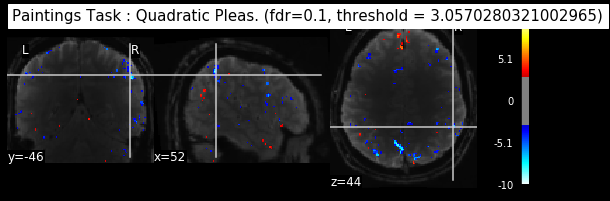

In [ ]:
table, threshold = stat_result(z_map=z_map_pl,
                               contrast_name='Quadratic Pleas.',
                               task=task,alpha=.10,method='fdr',bg_img=m_img)

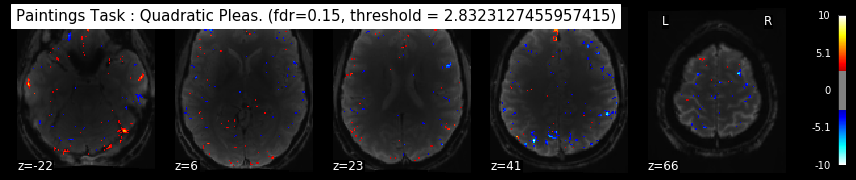

In [ ]:
table, threshold = stat_result_long(z_map=z_map_pl,
                               contrast_name='Quadratic Pleas.',
                               task=task,alpha=.15,method='fdr',bg_img=m_img)

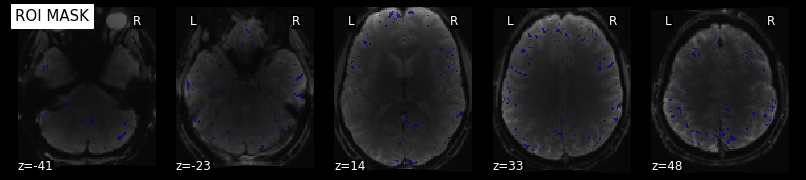

In [ ]:
thres_img = threshold_img(z_map_pl, threshold=threshold)

mask_img = compute_background_mask(thres_img)

plot_roi(mask_img, m_img,display_mode = 'z',cut_coords=5,title='ROI MASK')

In [ ]:
table

,Cluster ID,X,Y,Z,Peak Stat,Cluster Size (mm3)
0,1,-66.0,-11.5,-22.0,7.284074,162
1,2,-3.0,35.0,48.5,7.232086,361
2,2a,-6.0,41.0,41.0,4.272741,
3,3,-63.0,-2.5,-16.0,6.845646,70
4,4,43.5,-64.0,-22.0,6.832777,384
5,4a,33.0,-65.5,-17.5,6.462562,
6,4b,48.0,-64.0,-20.5,5.725835,
7,4c,39.0,-67.0,-20.5,5.295880,
8,5,3.0,48.5,36.5,6.792135,67
9,6,-1.5,20.0,62.0,6.668639,16


## Activity Matrices Extraction ( LSS Separate Method )

 - We extract the activity matrices/ label vector pair for each run, for each task
 - We perform an onset shift to capture the very moment of the decision, we set it to 1000 ms before the button press
 - We concatenate all this data to create a global dataset over all the preference battery of test

In [ ]:
y_g = list()
X_g = list()

### Faces Task

### Run AP

In [ ]:
data_path = 'ses-19/func/wrdcsub-01_ses-19_task-PreferenceFaces_dir-ap_bold.nii.gz'
events_path = 'ses-19/func/sub-01_ses-19_task-PreferenceFaces_dir-ap_events.tsv'
motion_param_path = 'ses-19/func/rp_dcsub-01_ses-19_task-PreferenceFaces_dir-ap_bold.txt'
task = 'Faces'

In [ ]:
analysis_type = 'High_Low_Pleasance'
hrf_model = 'spm + derivative'
param_modulation = False
drift_model='cosine'
t_r=2
drift_order=None
apply_trans_mask=True
roi_img = mask_img
standardize=True
detrend=True
minimize_memory = True
activity_mat_saving_path = 'mvpa/test2'

events = pd.read_csv(events_path,sep='\t')

# onset shift in order to capture the very moment of the appreciation decision
events['onset'] = events['onset']-1


onset_periods = [events['onset'][i+1] - events['onset'][i]  for i in range(len(events['onset']))if (i<len(events['onset'])-1)]
onset_periods = np.array(onset_periods)
onset_freq = np.reciprocal(onset_periods)

hpf_cut = np.min(onset_freq)/2 # cf High Pass Filtering Rule of Thumb ( fMRI Handbook 2011)

Event 0
      onset  duration        trial_type
0     7.153     4.547  High Pleasance_1
1    14.385     5.334    Nuisance Event
2    23.867     2.477    Nuisance Event
3    28.350     3.194    Nuisance Event
4    32.366     4.575    Nuisance Event
5    40.498     4.647    Nuisance Event
6    45.681     3.205    Nuisance Event
7    51.430     6.176    Nuisance Event
8    59.195     3.499    Nuisance Event
9    66.578     6.234    Nuisance Event
10   76.560     2.765    Nuisance Event
11   82.209     3.473    Nuisance Event
12   88.691     6.699    Nuisance Event
13   98.740     6.357    Nuisance Event
14  107.172     4.615    Nuisance Event
15  112.921     1.626    Nuisance Event
16  118.220     6.947    Nuisance Event
17  125.903     3.961    Nuisance Event
18  133.968     4.730    Nuisance Event
19  141.917     7.853    Nuisance Event
20  151.649     9.532    Nuisance Event
21  164.264     7.026    Nuisance Event
22  171.946     3.002    Nuisance Event
23  175.962     5.418    Nuisanc

59  418.278     2.291    Nuisance Event
Event 59
      onset  duration        trial_type
0     7.153     4.547    Nuisance Event
1    14.385     5.334    Nuisance Event
2    23.867     2.477    Nuisance Event
3    28.350     3.194    Nuisance Event
4    32.366     4.575    Nuisance Event
5    40.498     4.647    Nuisance Event
6    45.681     3.205    Nuisance Event
7    51.430     6.176    Nuisance Event
8    59.195     3.499    Nuisance Event
9    66.578     6.234    Nuisance Event
10   76.560     2.765    Nuisance Event
11   82.209     3.473    Nuisance Event
12   88.691     6.699    Nuisance Event
13   98.740     6.357    Nuisance Event
14  107.172     4.615    Nuisance Event
15  112.921     1.626    Nuisance Event
16  118.220     6.947    Nuisance Event
17  125.903     3.961    Nuisance Event
18  133.968     4.730    Nuisance Event
19  141.917     7.853    Nuisance Event
20  151.649     9.532    Nuisance Event
21  164.264     7.026    Nuisance Event
22  171.946     3.002    Nuisan

Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



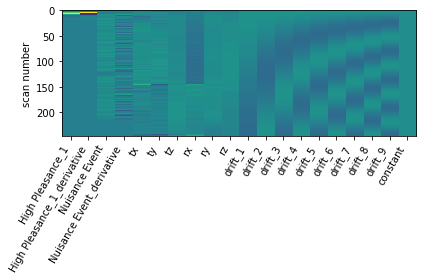

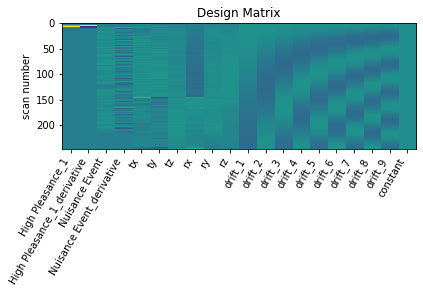

      0         1         2        3         4       5         6      \
0 -1.853148  1.681107  0.369485 -0.03569 -0.055886 -1.4844 -3.205821   

      7      8         9      ...     11447     11448     11449     11450  \
0 -3.371699 -3.181 -4.242288  ... -1.653973 -2.111291 -1.245227  0.076271   

      11451     11452     11453     11454     11455     11456  
0 -1.160633 -0.945794  1.003277 -0.432788 -0.738469  0.161555  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_1
GLM RUN LowPleasance_2


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



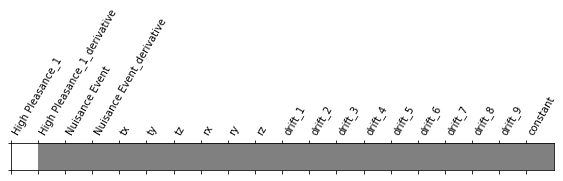

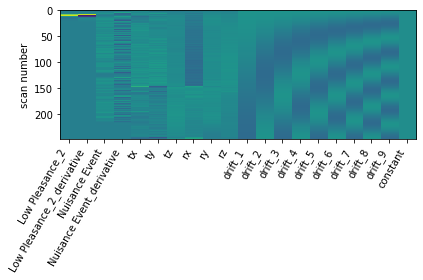

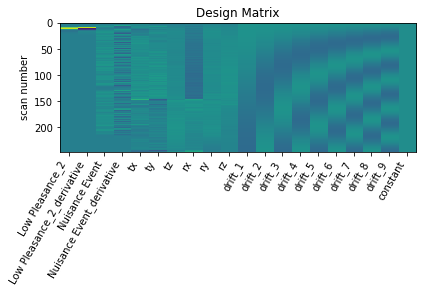

      0         1         2         3         4         5         6      \
0 -0.879105 -0.782203  0.123494 -0.092582 -0.327124  0.156896 -1.501563   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.690219  0.197229 -0.203801  ... -0.661941 -0.051497 -0.883442  0.073014   

      11451     11452     11453     11454     11455     11456  
0 -0.113247 -0.811701  0.070785 -1.312531 -1.544019  0.891325  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_2
GLM RUN LowPleasance_3


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



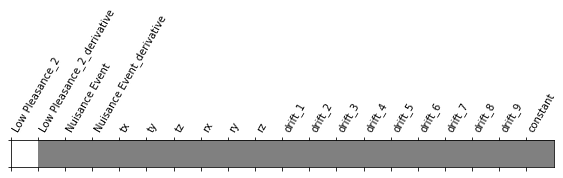

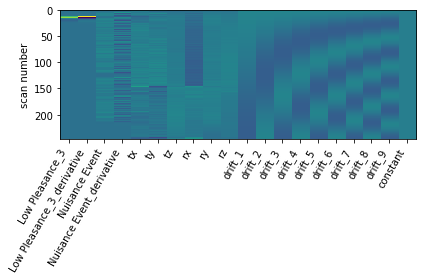

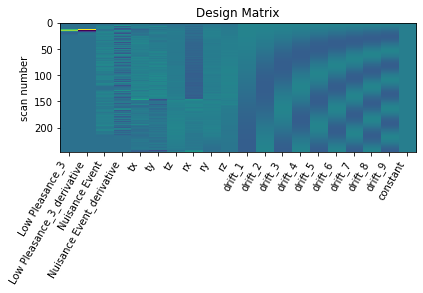

      0         1         2        3         4         5         6      \
0  0.739366 -0.040697  1.417077  1.74734  1.356789  1.732561  0.722618   

      7        8         9      ...     11447     11448     11449     11450  \
0  1.795284  1.89775  2.523161  ... -0.553657 -0.145974 -0.249318  0.791281   

      11451     11452     11453     11454     11455     11456  
0 -0.304056  0.072059  0.296627  0.314696 -0.132016 -1.491831  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_3
GLM RUN HighPleasance_4


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



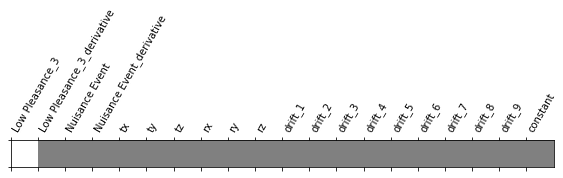

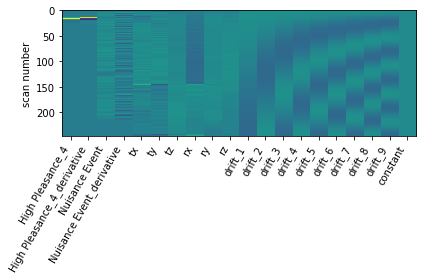

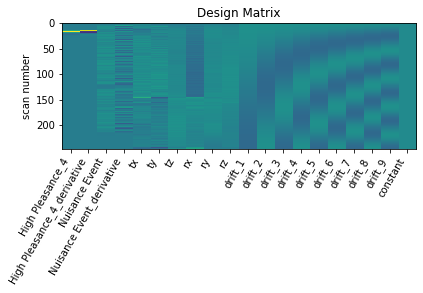

      0         1         2         3         4         5         6      \
0  0.886223 -0.349921  0.212332  0.196948  0.221403  2.680338 -0.099283   

      7        8         9      ...     11447     11448    11449     11450  \
0  0.992647  1.86376  1.544933  ... -2.189002 -2.140205 -1.55181  0.197216   

      11451     11452     11453     11454     11455     11456  
0 -1.472721 -2.400168 -0.024777 -2.155276 -0.322618 -2.544452  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_4
GLM RUN HighPleasance_5


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



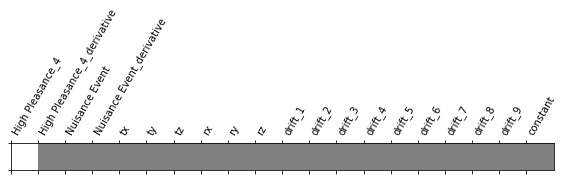

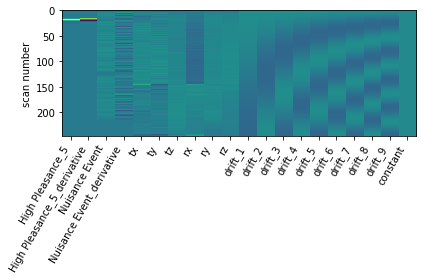

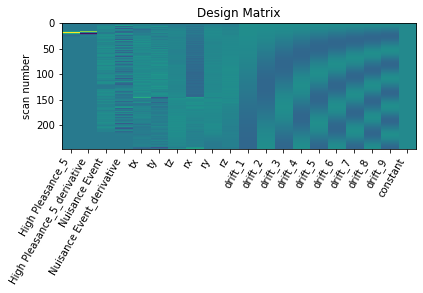

      0         1         2         3        4         5         6      \
0  1.839348 -0.592376 -0.081627 -0.052299  0.08999  2.217817  0.441921   

      7         8        9      ...     11447    11448     11449     11450  \
0  1.322448  1.809185  1.52939  ... -0.055589 -0.06986 -0.618543 -0.692847   

      11451     11452     11453     11454     11455     11456  
0 -0.634733 -1.506712  0.432292 -0.835625 -2.623106 -2.290921  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_5
GLM RUN LowPleasance_6


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



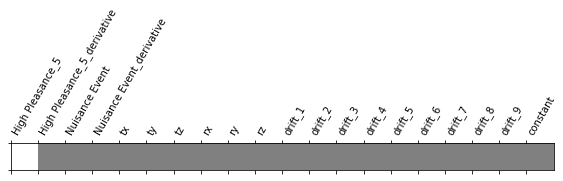

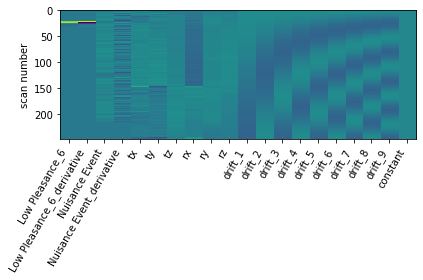

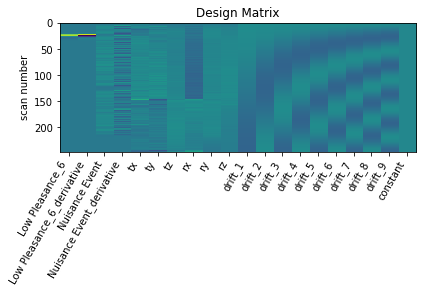

      0        1         2         3        4       5        6         7      \
0  0.263833  0.33242  0.014778 -0.091471 -0.23928 -0.6381  0.83169  1.138063   

      8         9      ...     11447     11448     11449     11450     11451  \
0  0.764253  0.649726  ...  0.028384  0.589408  0.389855  2.472882 -0.547119   

      11452     11453     11454     11455     11456  
0  0.500579  0.591954 -0.338863  0.273937  0.225455  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_6
GLM RUN HighPleasance_7


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



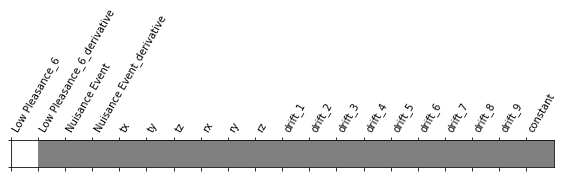

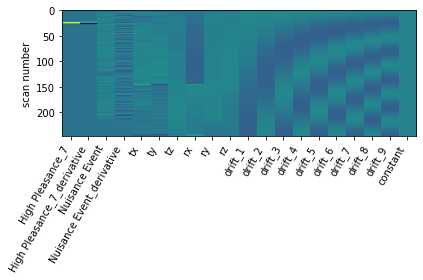

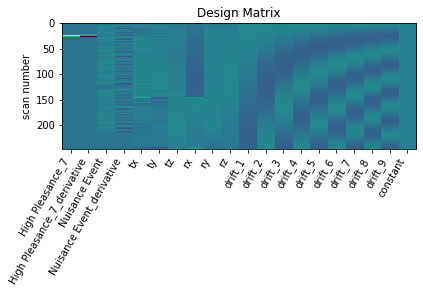

      0         1         2         3         4         5         6      \
0 -2.456204  0.665165  1.387401  0.175703 -0.153634 -0.567556 -1.329923   

     7         8         9      ...     11447    11448     11449     11450  \
0 -1.32455 -1.347225 -1.064805  ... -2.125046 -1.87413 -1.537492  0.869418   

      11451     11452     11453     11454    11455     11456  
0  0.862728 -1.590459  0.239348 -1.859595  0.89367  0.591158  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_7
GLM RUN HighPleasance_8


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



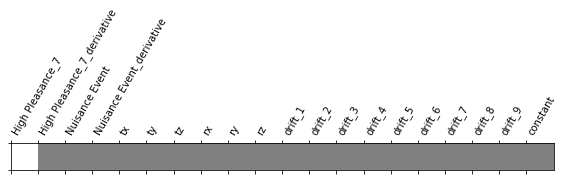

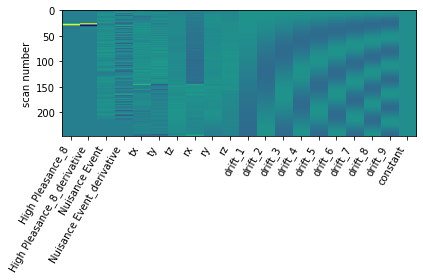

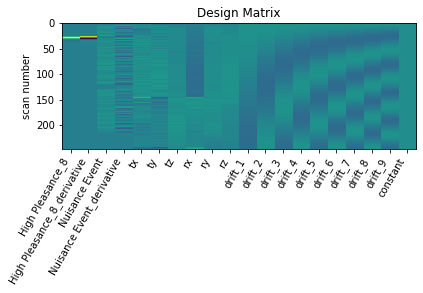

      0         1         2         3         4         5         6      \
0  0.332912 -0.595835  0.052222  0.382259  0.312259  1.410043 -1.438399   

      7         8         9      ...    11447     11448     11449     11450  \
0 -0.363882  0.847799  1.029499  ... -0.64629 -1.546113 -1.240264 -0.875557   

      11451     11452    11453   11454     11455     11456  
0 -1.163742 -2.426092 -0.12462  0.0289 -0.360396  0.719504  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_8
GLM RUN LowPleasance_9


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



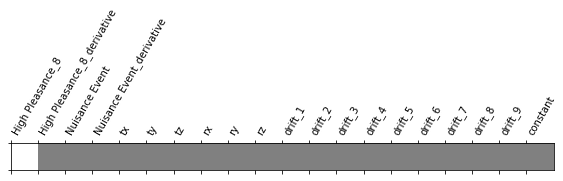

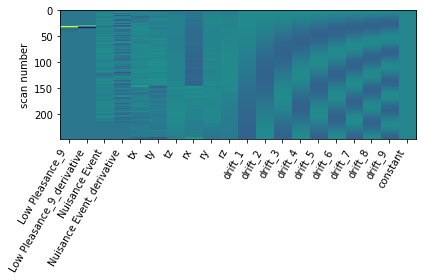

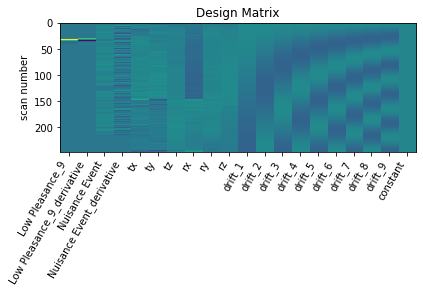

      0         1         2        3         4         5         6      \
0  1.542338 -0.098868 -0.690757 -0.27745  0.357586  0.378119  0.708952   

      7         8        9      ...     11447     11448     11449     11450  \
0  1.512094  1.165911  1.99681  ... -0.832294 -0.681771 -0.469441 -0.086826   

      11451     11452     11453     11454     11455     11456  
0 -1.644151  0.298285 -0.094041  0.121135  0.255334 -0.089251  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_9
GLM RUN HighPleasance_10


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



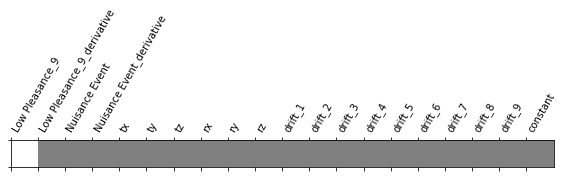

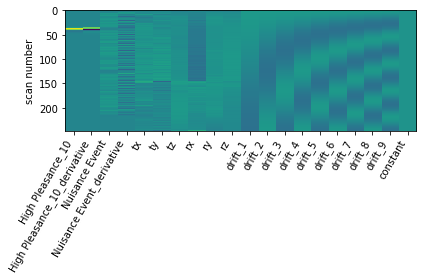

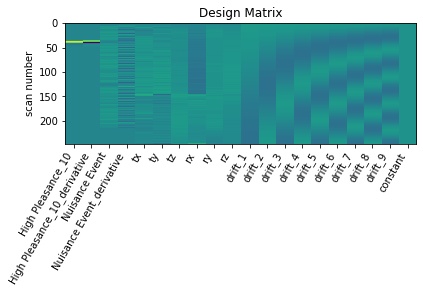

      0         1         2         3         4         5         6      \
0 -0.927971  1.624508  0.973767  0.525531 -0.315816 -1.557073 -2.347063   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.939519 -1.146467 -1.871437  ... -1.591647 -1.406442 -1.462476 -0.364587   

      11451     11452     11453    11454     11455     11456  
0  0.312295 -2.141128 -0.092765 -1.31704 -1.364301 -0.011062  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_10
GLM RUN LowPleasance_11


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 19 seconds



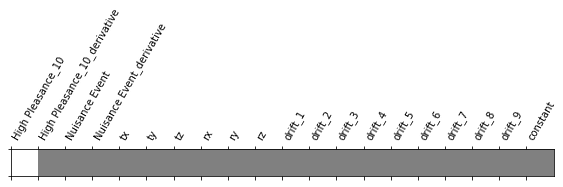

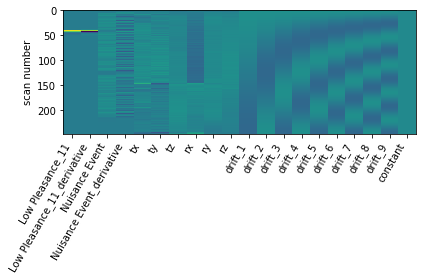

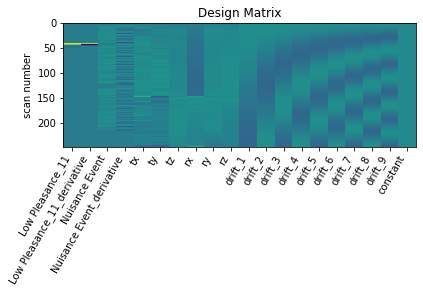

      0         1        2         3         4         5         6      \
0  0.359099 -1.062176  0.36024 -0.193849 -0.657804  0.848873  0.102746   

      7        8         9      ...     11447     11448     11449     11450  \
0 -0.273184 -0.37476  0.501595  ... -0.231582 -0.911389 -0.133134  0.087302   

      11451     11452     11453  11454     11455     11456  
0 -0.046359  0.216246  1.683921 -0.509 -0.305039 -0.725439  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_11
GLM RUN LowPleasance_12


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



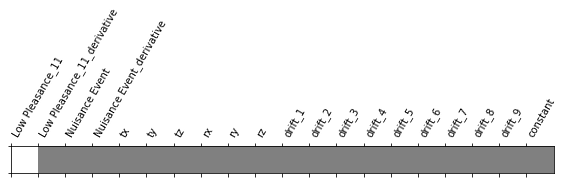

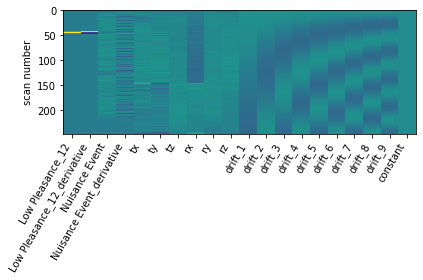

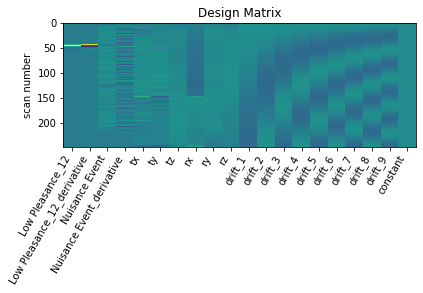

      0         1         2         3         4         5         6      \
0  0.117201  0.020517 -0.290522  0.391642  1.044551  1.868679 -0.129338   

      7         8         9      ...     11447     11448     11449    11450  \
0  1.168861  1.577103  1.609006  ... -0.990235 -0.360801 -1.176366 -0.68245   

      11451    11452     11453     11454     11455     11456  
0 -2.387409 -1.29404 -1.585636 -0.821523 -0.579049 -0.094938  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_12
GLM RUN HighPleasance_13


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



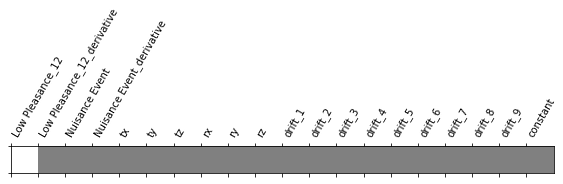

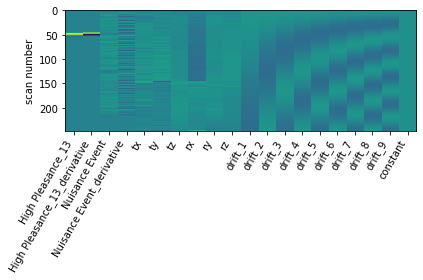

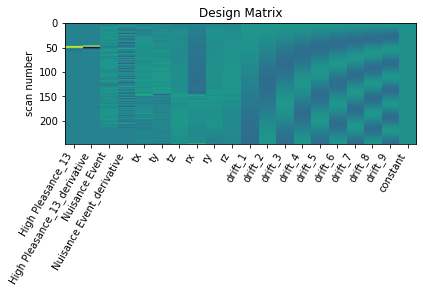

      0         1         2         3         4         5         6      \
0  0.532934  1.462316  1.331193  0.816338  0.024641 -0.408351 -0.968262   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.109284  0.865996  0.244271  ... -0.986627 -0.527852 -0.719097  0.320039   

      11451     11452     11453     11454     11455     11456  
0 -0.036285 -0.894231  1.135006 -0.854192 -0.935128 -1.255038  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_13
GLM RUN HighPleasance_14


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



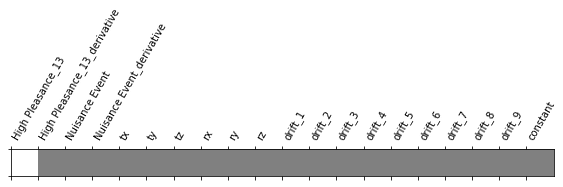

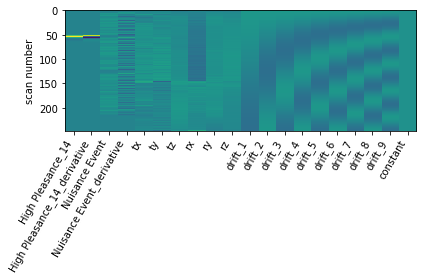

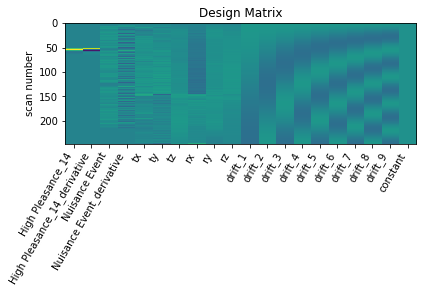

      0         1         2         3        4         5         6      \
0 -0.463406 -0.660215 -0.902023 -0.432794  0.01504  1.043665 -0.117098   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.153777  0.187948  1.016509  ... -2.612899 -2.390991 -2.255611 -0.199718   

      11451     11452     11453     11454     11455     11456  
0 -0.802237 -1.680662 -0.400116 -1.957921 -0.817848  0.033318  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_14
GLM RUN LowPleasance_15


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



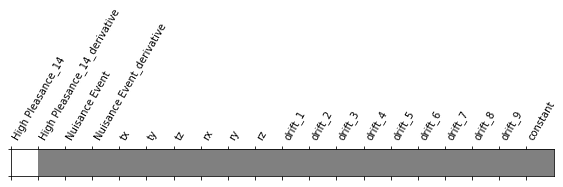

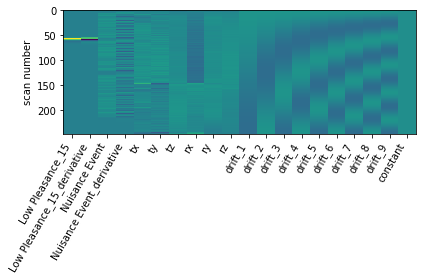

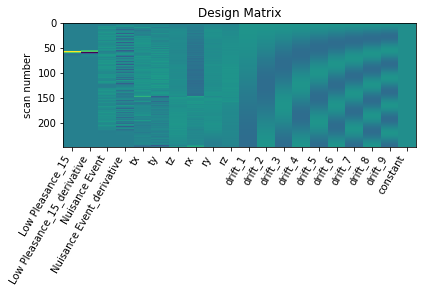

    0         1         2         3         4         5         6      \
0  1.2324  0.509167 -0.297028 -1.057138 -1.579311  0.575249 -1.367952   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.784328  1.574695  1.236316  ... -0.455368 -0.111243 -0.776426 -0.077289   

      11451     11452    11453     11454     11455     11456  
0 -1.459372 -2.381933 -0.50361 -1.145708 -1.063891 -2.145765  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_15
GLM RUN LowPleasance_16


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



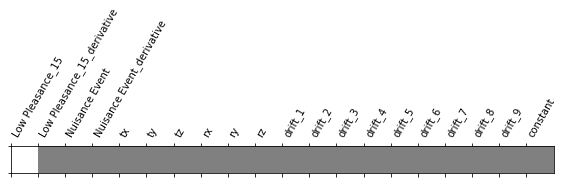

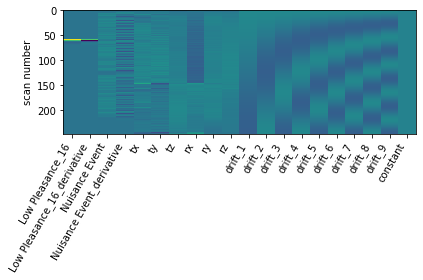

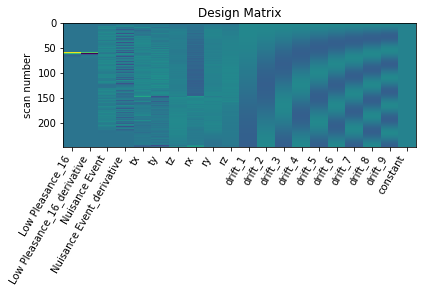

      0         1         2        3         4         5         6      \
0  1.129011  0.047942  1.268633  1.15662  1.742844  0.756689 -0.401847   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.332198  0.769486 -0.171167  ...  0.459374  0.692497  0.198857  1.286112   

      11451     11452     11453     11454     11455    11456  
0  0.630284  0.844108  1.426476 -0.195666  0.762619  1.20393  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_16
GLM RUN HighPleasance_17


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



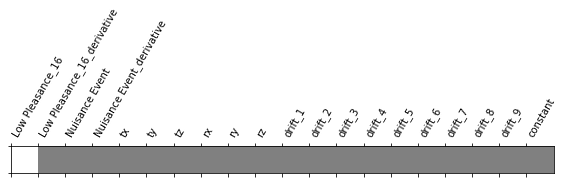

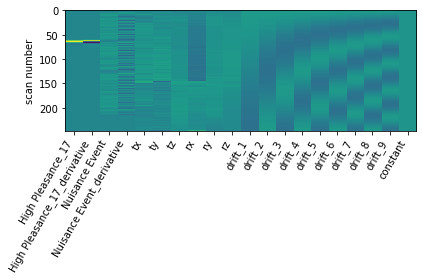

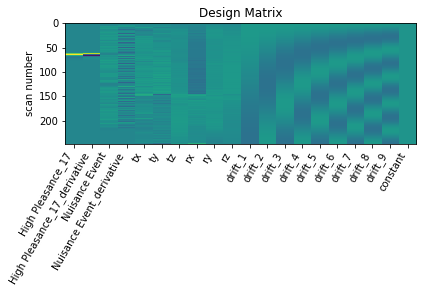

      0         1         2         3         4         5         6      \
0 -0.414973 -0.351506  0.518943  0.849793  0.578256  0.136726 -0.009743   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.178297  0.110273  1.168759  ... -0.910566 -1.198926 -0.658532  0.071143   

      11451     11452     11453     11454     11455     11456  
0 -0.360996 -1.098903  0.727217  0.096757 -2.243404 -0.317065  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_17
GLM RUN HighPleasance_18


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



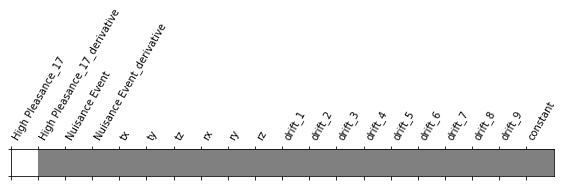

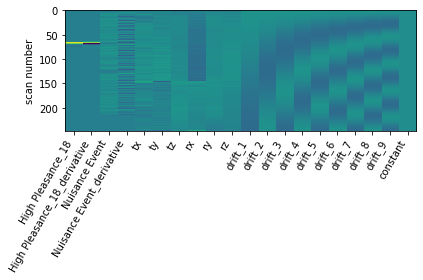

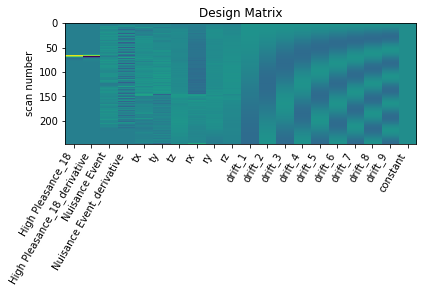

      0         1         2         3         4         5         6      \
0  0.670636 -0.493044 -0.638859 -0.473533 -0.716751  0.997101 -0.696921   

      7         8         9      ...    11447     11448     11449     11450  \
0  0.216574  1.235615  1.263177  ... -0.69737 -0.364786 -0.339536 -0.294857   

      11451     11452     11453     11454     11455     11456  
0 -1.241743 -0.675688 -0.287131 -0.863157  0.198616 -1.736647  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_18
GLM RUN LowPleasance_19


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



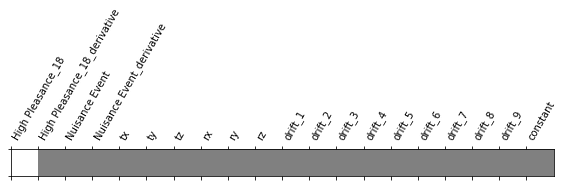

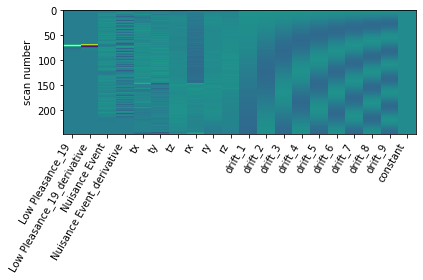

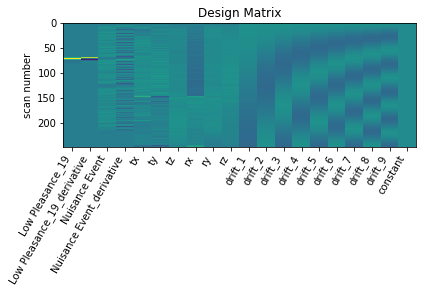

      0         1         2         3         4         5         6      \
0  0.715938  1.376204  1.259635  0.757113  0.595819  0.953971 -1.117393   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.199585  0.225027 -0.211196  ... -2.298065 -1.681722 -2.035263  0.365257   

      11451     11452     11453     11454     11455     11456  
0 -0.984237 -1.868732 -0.430291 -2.447759 -1.055699 -0.106491  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_19
GLM RUN HighPleasance_20


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



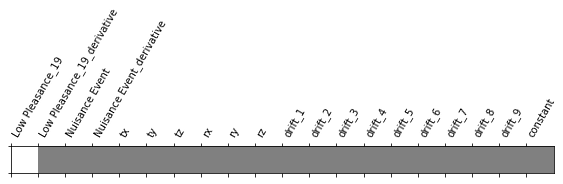

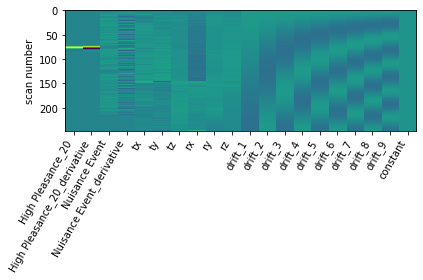

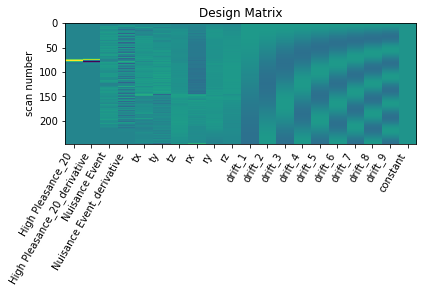

      0         1         2         3         4         5         6      \
0 -0.485405 -0.632347  0.369049  0.829686  0.721138  0.835559 -1.219371   

      7         8         9      ...    11447     11448     11449     11450  \
0  0.085729  1.017992  0.451429  ... -0.42201 -0.539172 -0.721217  0.265382   

      11451     11452     11453     11454     11455     11456  
0 -0.492748 -1.216188  1.391247 -0.086615 -0.205364 -0.047043  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_20
GLM RUN LowPleasance_21


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



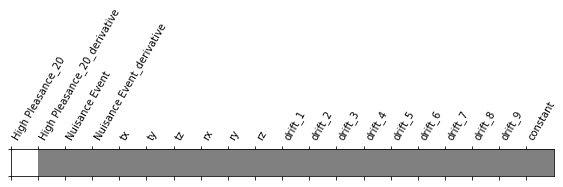

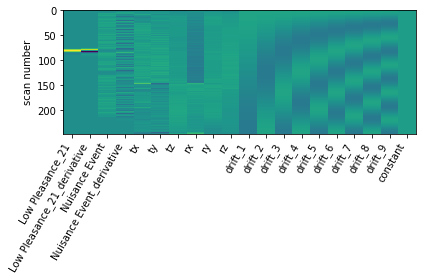

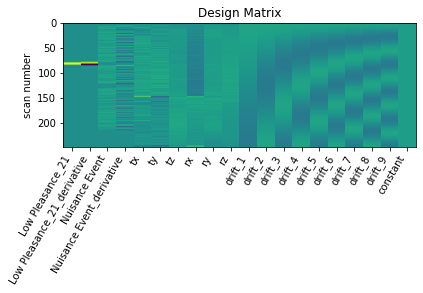

      0         1        2         3         4         5         6      \
0  1.161419  0.638287  0.41864 -0.137744 -0.013275  0.766257  0.693484   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.344018  1.249833  2.372619  ... -1.366516 -1.518823 -1.063119 -0.543761   

      11451    11452     11453     11454     11455     11456  
0 -0.973528 -1.32245 -0.625108 -0.840899 -1.313236 -0.878623  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_21
GLM RUN HighPleasance_22


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



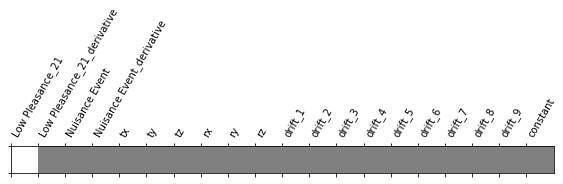

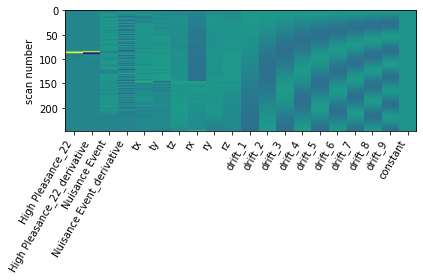

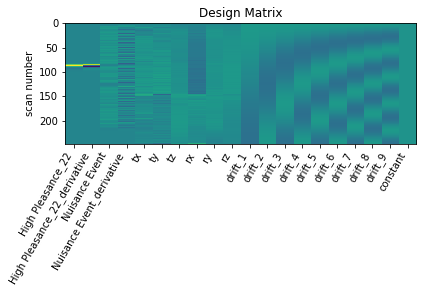

      0         1         2        3         4         5         6      \
0 -0.992527 -0.601853 -0.114982  0.04039 -0.376973 -0.117061 -2.438266   

      7       8         9      ...     11447     11448     11449     11450  \
0 -1.325129 -0.3896 -1.211924  ... -0.565311 -0.576089 -0.373439  1.760714   

      11451     11452     11453    11454     11455     11456  
0 -0.469095 -0.694223  0.850786 -0.35604 -1.194924  0.359914  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_22
GLM RUN LowPleasance_23


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



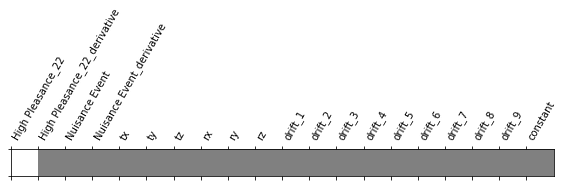

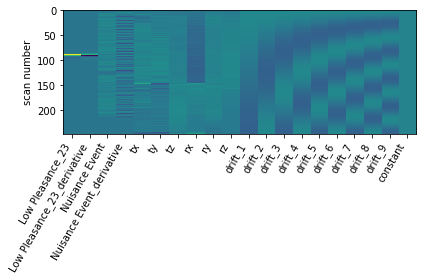

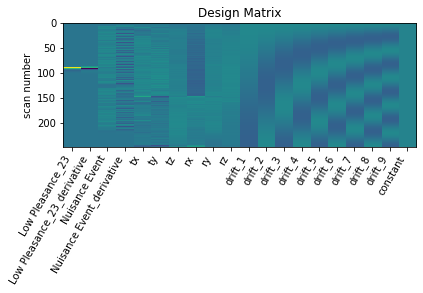

      0         1         2         3         4         5         6      \
0  0.193758 -0.789158  0.362528  0.348885 -0.196003 -0.239574 -0.462273   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.180879  0.121343  0.894026  ... -2.653859 -1.871485 -2.866933 -1.544249   

      11451     11452     11453     11454     11455     11456  
0 -1.130538 -1.533478  0.194451 -2.783639 -0.673137 -1.236812  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_23
GLM RUN HighPleasance_24


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



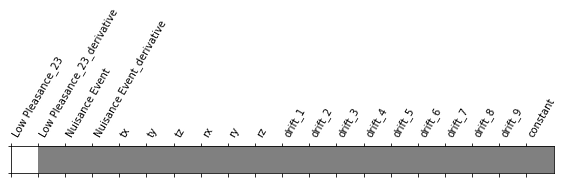

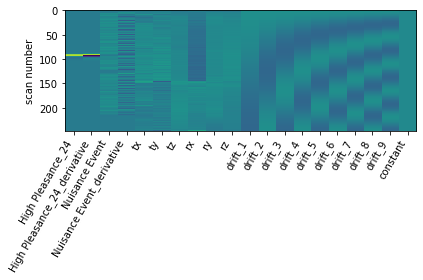

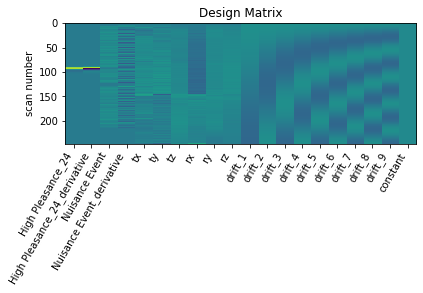

      0         1         2         3         4         5         6      \
0  0.898059  0.529615  0.954552  1.057238  1.137305  1.267525 -0.415621   

     7        8         9      ...     11447     11448     11449     11450  \
0  0.56847  1.20245  1.201679  ... -1.046143 -1.033998 -0.963471 -0.160373   

      11451   11452     11453     11454     11455     11456  
0 -1.567168 -1.5523  0.376348 -0.793678 -1.658904 -0.728843  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_24
GLM RUN LowPleasance_25


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



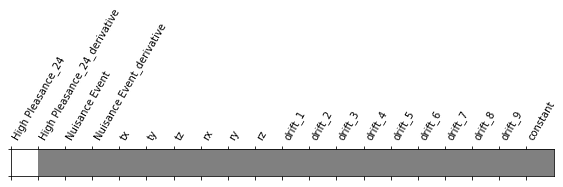

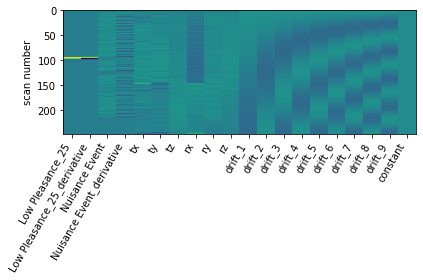

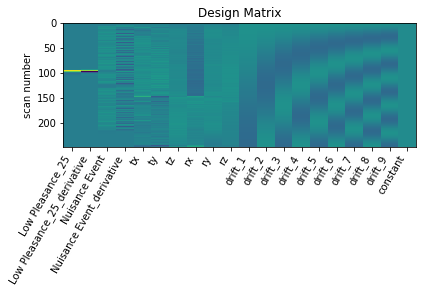

      0         1         2         3         4         5         6      \
0  0.534434  0.688877 -0.545133 -0.758609 -0.486237  0.522368  1.083146   

      7        8         9      ...     11447    11448     11449     11450  \
0  1.381625  1.36922  2.191618  ... -0.537891 -0.18148 -0.811802  0.451361   

      11451     11452    11453     11454     11455    11456  
0  0.294558 -1.086608 -0.29239  0.079945  0.172145 -0.23088  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_25
GLM RUN LowPleasance_26


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



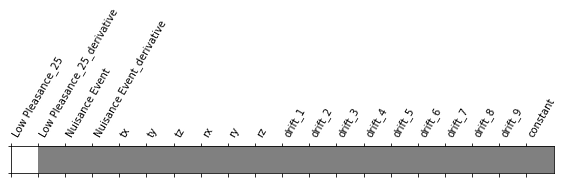

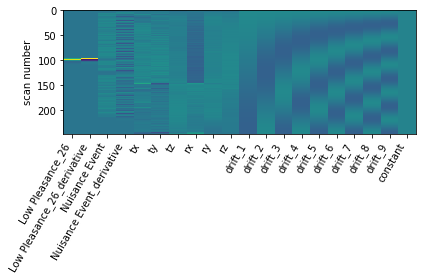

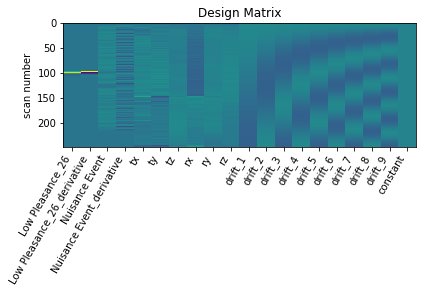

      0         1         2         3         4         5         6      \
0  0.035123 -0.938973 -1.159163 -0.975963 -0.678747 -0.350082 -2.094016   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.600001 -1.060761 -1.266956  ... -0.783229 -1.159851 -0.048474 -0.508165   

      11451     11452     11453     11454     11455     11456  
0 -0.917778 -0.311828  0.014208 -0.945418 -1.838488 -0.935357  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_26
GLM RUN LowPleasance_27


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



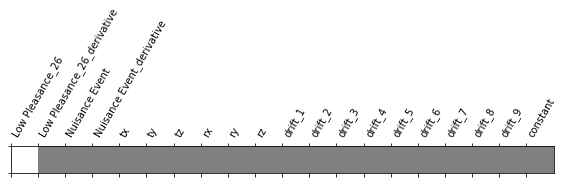

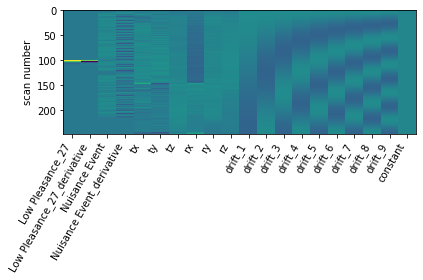

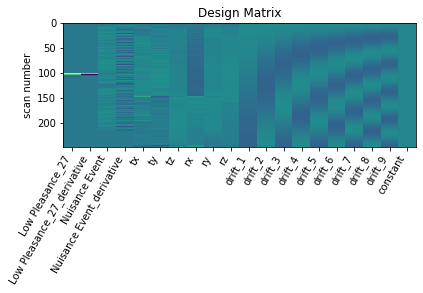

      0         1         2         3         4        5         6      \
0  0.054275  0.132572  2.416338  1.682587  0.604098  0.77278 -1.051341   

    7         8         9      ...     11447     11448     11449     11450  \
0 -0.0581  0.682037  0.187298  ... -0.358029 -0.200478 -0.194342  0.562955   

      11451     11452     11453     11454     11455     11456  
0 -0.735742  0.480101  0.964089 -0.618551  0.348764 -0.301766  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_27
GLM RUN HighPleasance_28


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



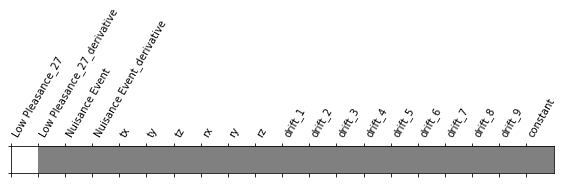

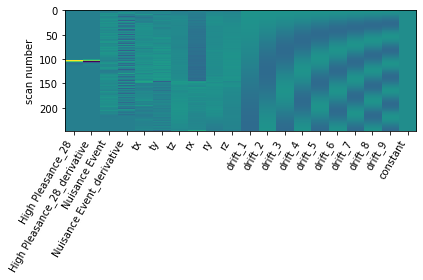

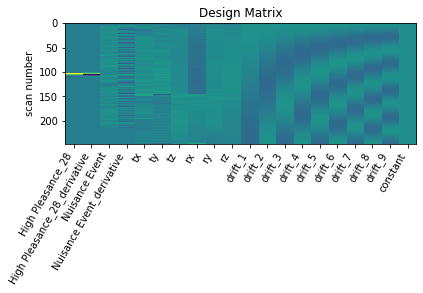

      0         1         2         3         4         5         6      \
0  0.112084 -0.189972  1.315021  0.986342  0.521823  0.391933  0.029661   

      7         8        9      ...     11447     11448     11449     11450  \
0  0.358706  0.252048  0.26414  ... -0.852148 -0.776783 -1.448392 -0.270149   

      11451     11452     11453     11454     11455     11456  
0 -0.481763 -1.318243 -0.719526 -0.759594 -0.742557 -0.147342  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_28
GLM RUN LowPleasance_29


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 27 seconds



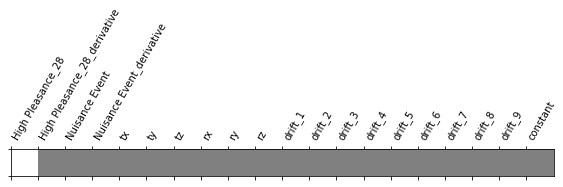

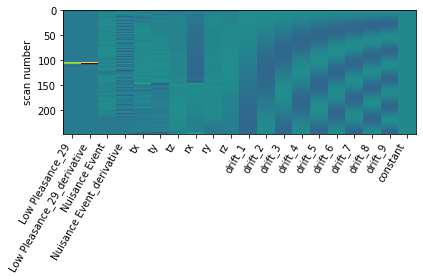

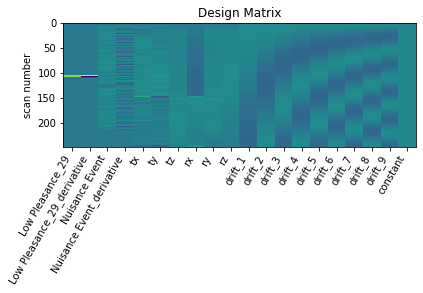

      0         1         2         3        4         5         6      \
0 -0.001993  0.382059 -0.075185  0.039874  0.52024  0.033062  1.574585   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.788919  1.263081  1.749565  ... -0.472845  0.355664 -0.576246  0.773211   

      11451     11452     11453     11454     11455     11456  
0  0.868877 -0.484833  0.341889 -0.369714 -0.855967 -0.477107  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_29
GLM RUN LowPleasance_30


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



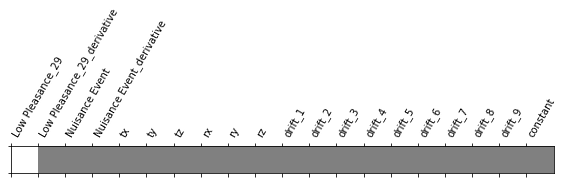

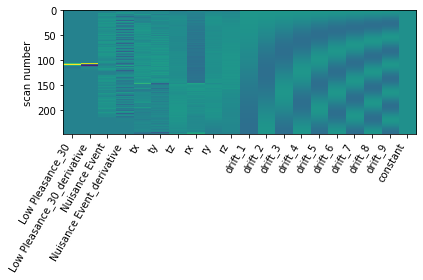

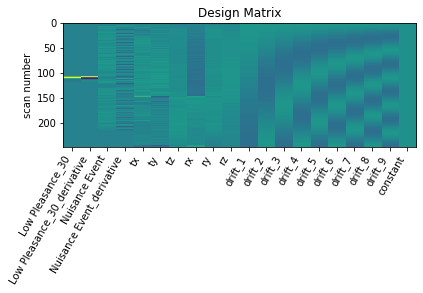

      0         1         2        3         4         5         6      \
0 -0.080311  1.544332 -1.052147 -0.83544 -0.883141 -0.190886 -1.195399   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.562628 -0.058607  0.324256  ... -0.355519 -1.056601 -0.049507 -0.135626   

      11451     11452     11453     11454     11455     11456  
0 -1.683494 -0.915238 -0.102302  0.185306 -0.319579  0.019771  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_30
GLM RUN LowPleasance_31


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



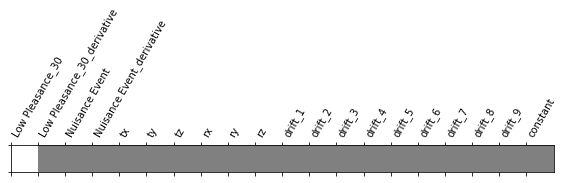

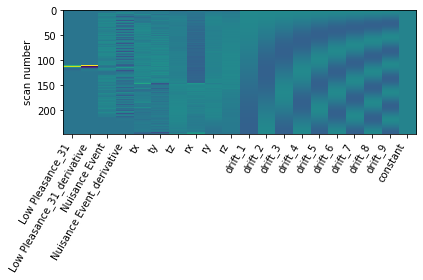

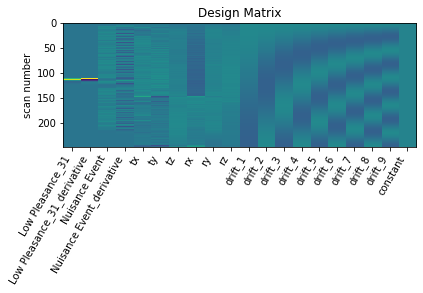

      0         1         2         3         4         5         6      \
0  0.281986 -2.186232  0.154321  0.062089 -0.000577  1.827716 -0.308652   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.497611  1.189529  0.822739  ... -1.684621 -1.168983 -1.651784 -0.259189   

      11451    11452    11453     11454   11455     11456  
0  0.793127 -1.36163 -0.05629 -1.440328 -1.1588  0.355113  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_31
GLM RUN HighPleasance_32


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 19 seconds



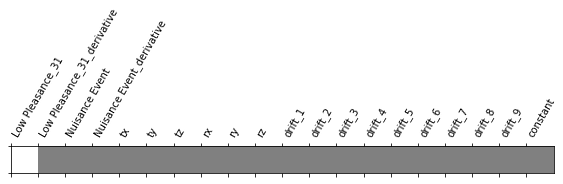

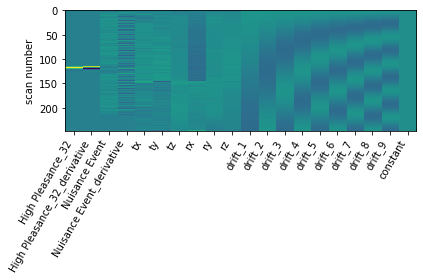

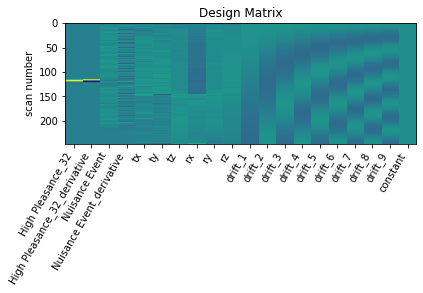

      0        1         2       3         4         5         6      \
0  0.771483  1.86968  1.089476  1.0397  0.725691  0.442081  0.278586   

      7         8         9      ...    11447     11448     11449     11450  \
0  0.830749  1.026892  1.067586  ...  0.14661  0.321454  0.177327  0.806602   

      11451     11452     11453     11454     11455     11456  
0 -1.427238 -0.123217  0.034647 -0.146546 -0.244487 -1.354304  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_32
GLM RUN LowPleasance_33


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



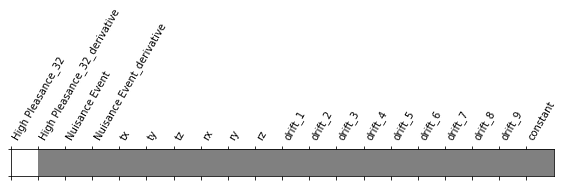

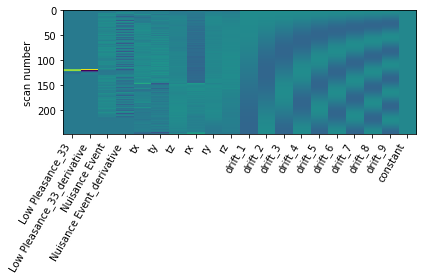

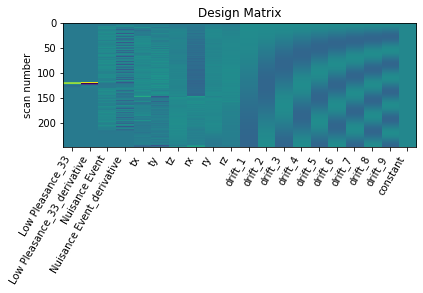

      0         1        2        3         4         5         6      \
0 -0.057499 -0.539129 -0.48789 -0.03973  0.216735  0.398388 -0.821547   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.051314  0.293658  0.590109  ... -0.819958 -0.585129 -1.200956 -0.120304   

      11451     11452     11453     11454     11455     11456  
0  0.644766 -0.964685  0.878164 -0.600107 -1.271469  0.823195  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_33
GLM RUN HighPleasance_34


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



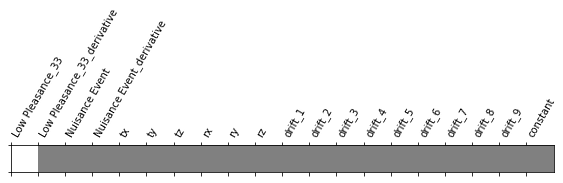

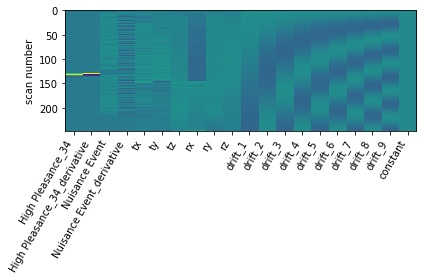

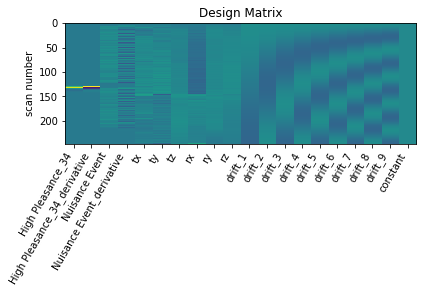

      0         1         2         3         4         5         6      \
0 -1.563862  0.139678  0.330082  0.479803  0.533186  0.409139 -0.762797   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.392919  0.932648  0.380077  ... -1.068971 -0.780245 -0.988067 -1.586754   

      11451     11452     11453     11454     11455     11456  
0 -1.164153 -0.947094 -0.524343 -1.015123 -0.534186  1.159737  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_34
GLM RUN HighPleasance_35


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



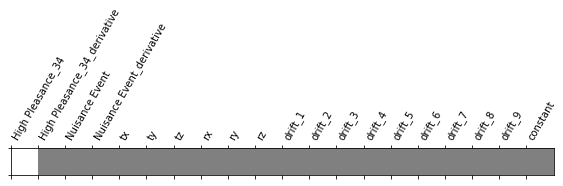

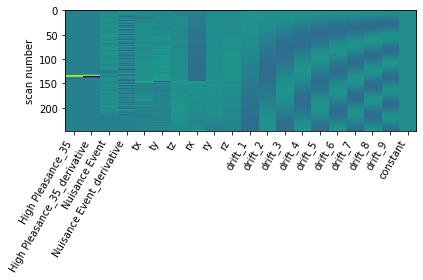

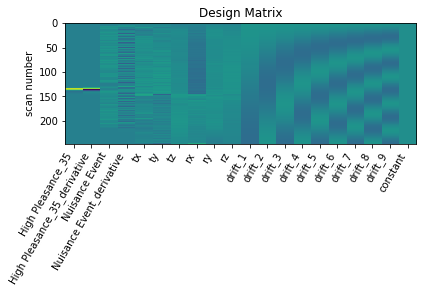

      0        1         2         3         4         5         6      \
0  0.507674 -1.02609 -0.436006 -0.780731 -0.479716  0.605987 -1.394136   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.113572 -0.334008 -0.550008  ... -0.970096 -1.033719 -1.799909  0.975927   

     11451     11452     11453     11454     11455     11456  
0  0.19565 -2.127666  1.089077 -1.082512 -0.671408 -1.001145  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_35
GLM RUN LowPleasance_36


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



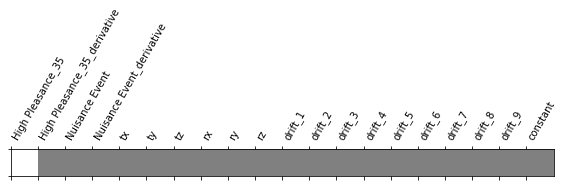

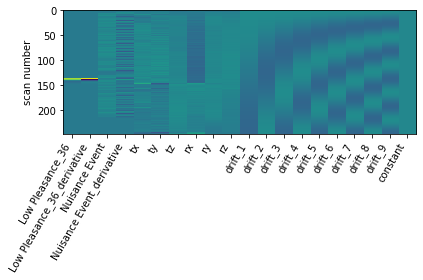

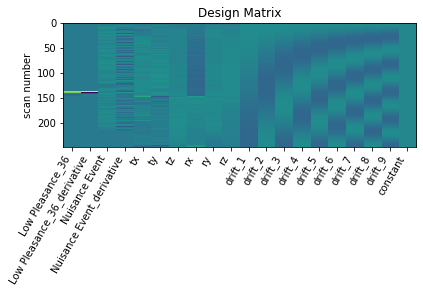

      0         1        2        3        4         5         6      \
0  0.685069 -0.491711 -0.07983 -0.18676  0.25529  1.013213  1.800457   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.643355  1.362142  1.220304  ...  0.035294  0.072493  0.484482  1.137796   

      11451     11452    11453     11454    11455     11456  
0 -0.926177 -0.144523 -0.04316  0.008383  0.05983 -1.233536  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_36
GLM RUN HighPleasance_37


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



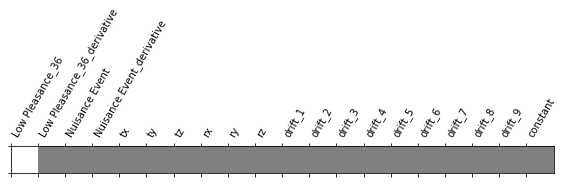

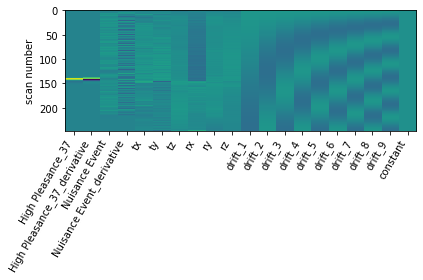

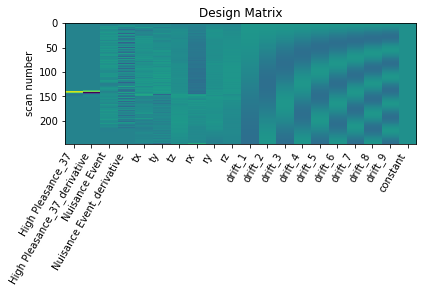

      0         1         2         3         4         5         6      \
0  1.213247 -0.583344  0.174203  0.150619 -0.381208  1.118359  0.440111   

     7         8         9      ...     11447     11448     11449     11450  \
0  0.69126  0.753449  1.051878  ... -0.785964 -0.612084  0.053554  0.101423   

      11451     11452     11453     11454    11455    11456  
0 -1.865724 -0.287422 -0.435582 -1.132732 -1.37379 -2.14773  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_37
GLM RUN LowPleasance_38


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



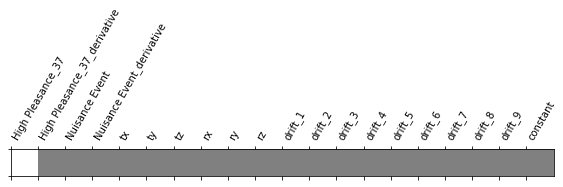

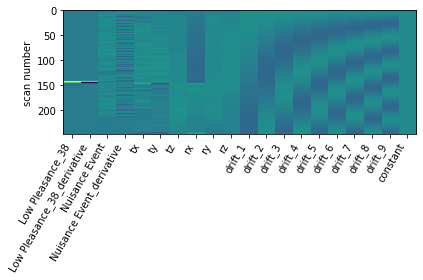

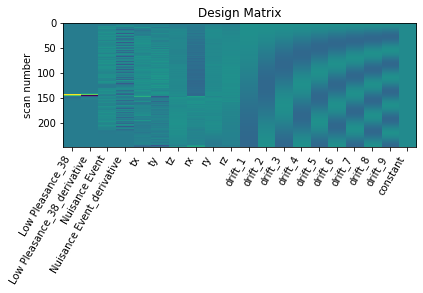

      0         1         2         3         4         5         6      \
0 -2.254328  0.622943  0.472729  0.280982 -0.494107 -2.246007 -1.343755   

      7        8         9      ...     11447    11448     11449     11450  \
0 -0.863826 -1.44318 -0.845769  ... -2.272591 -2.17584 -1.882775 -1.564282   

      11451     11452     11453     11454     11455     11456  
0  0.361555 -0.487267 -1.285753 -0.723814 -2.112286  1.326245  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_38
GLM RUN LowPleasance_39


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



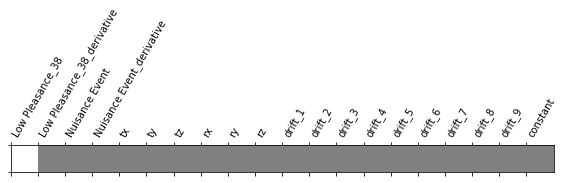

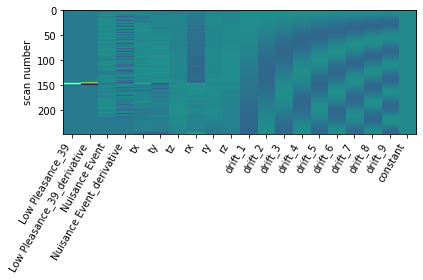

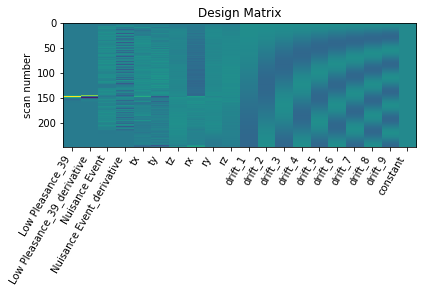

      0         1         2         3         4         5         6      \
0  1.881513  0.635461  0.218219  0.054978  0.294496  3.144022  1.761422   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.910917  2.104623  1.934722  ... -0.539241 -0.125873 -0.318114 -0.017593   

      11451     11452     11453     11454     11455     11456  
0 -0.826591  0.721911  1.545033  0.376944  0.407987 -1.007466  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_39
GLM RUN LowPleasance_40


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



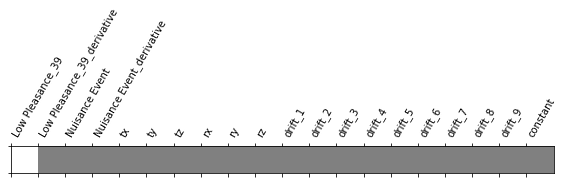

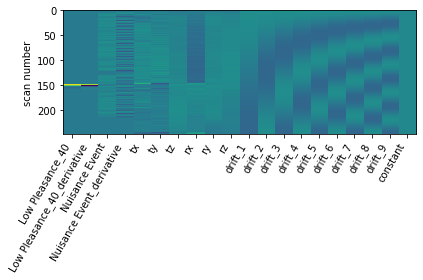

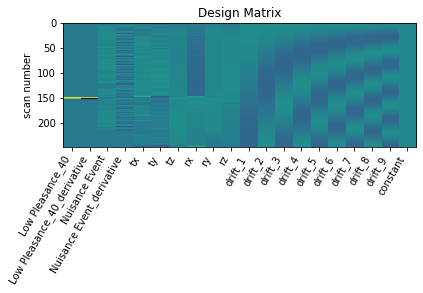

      0         1         2         3         4         5         6      \
0 -1.656507  1.512549  1.283707  1.553081  1.956324 -0.045093 -1.397765   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.556934  0.299793 -0.527166  ... -0.254096  0.147398  0.001514  1.469558   

     11451     11452     11453     11454     11455     11456  
0  0.02384 -0.882052  0.668832 -0.795204  1.061345  0.999927  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_40
GLM RUN LowPleasance_41


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



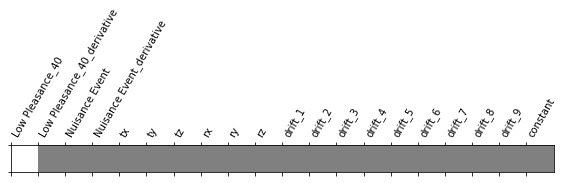

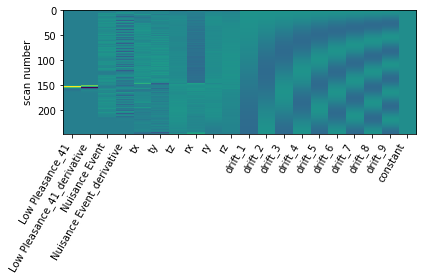

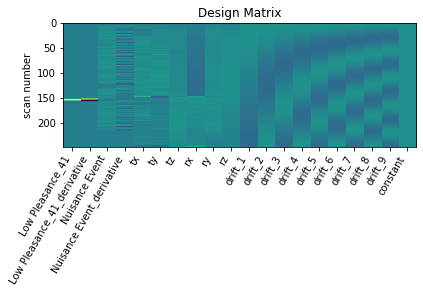

      0         1         2        3         4         5         6      \
0  2.757288  1.225543  0.450668  0.55228 -0.349026  1.275271 -0.376116   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.131681  0.677588  0.399615  ... -0.079216 -0.433385 -0.082199  0.735438   

     11451     11452     11453     11454     11455     11456  
0 -0.23209 -0.474919  0.675213 -0.062974 -1.279477 -1.523674  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_41
GLM RUN LowPleasance_42


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



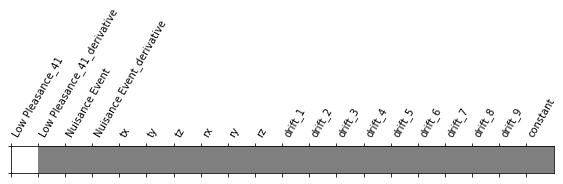

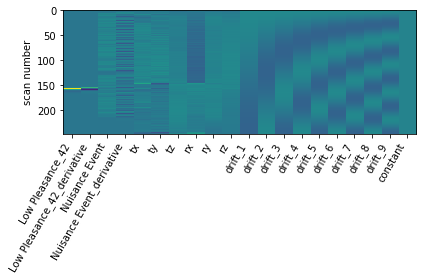

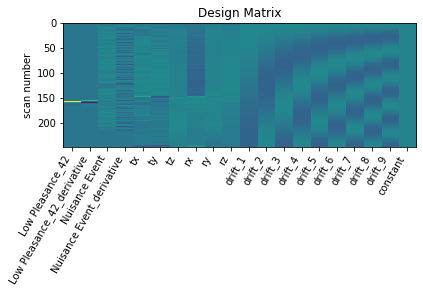

      0         1         2         3         4         5         6      \
0 -1.137853 -0.172273  0.166143  0.591236  1.033525 -1.558635 -1.248105   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.223617  0.015274  0.857852  ... -0.622826  0.295419 -0.780721 -0.482989   

      11451     11452     11453     11454     11455     11456  
0  0.439493 -0.261121 -0.319337 -0.770463 -0.215646  0.559388  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_42
GLM RUN LowPleasance_43


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



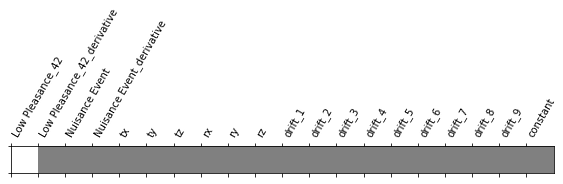

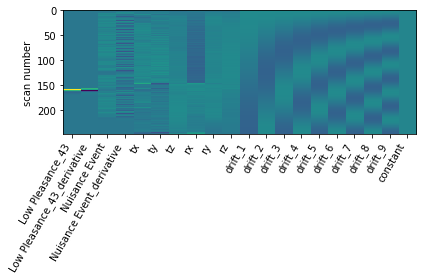

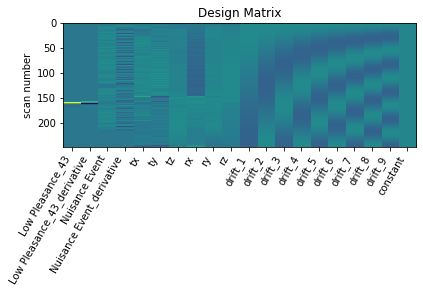

      0         1         2       3         4         5         6      \
0 -0.574041 -0.723256  0.432084  0.2233  0.027373  0.959701 -1.260934   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.584627 -0.093223 -0.714568  ...  0.409816 -0.020298 -0.013363 -0.653166   

      11451     11452     11453     11454     11455     11456  
0 -0.263675 -1.751306  1.081767  0.300701  0.430912 -0.162983  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_43
GLM RUN LowPleasance_44


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



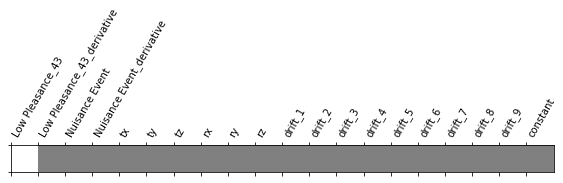

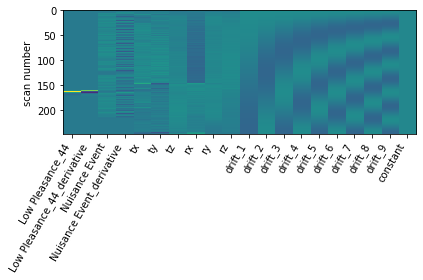

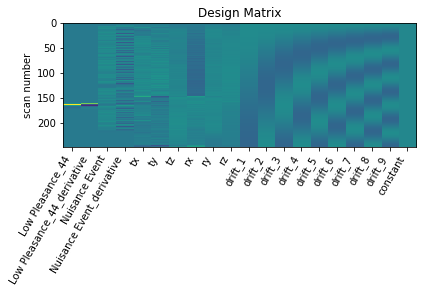

     0         1         2         3         4         5         6      \
0  2.08642 -0.065177  0.746263  0.971978  0.906689  0.616065 -0.044146   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.340518  1.467083  1.632026  ...  0.521652  0.771756  0.504923  0.228889   

      11451     11452     11453     11454     11455     11456  
0 -0.346084  0.840695 -0.084485 -0.055917  0.019473 -1.861964  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_44
GLM RUN HighPleasance_45


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



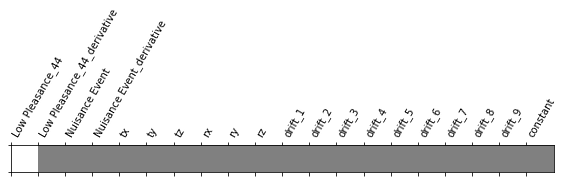

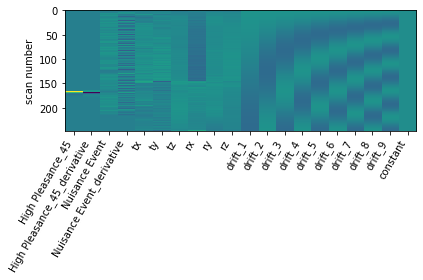

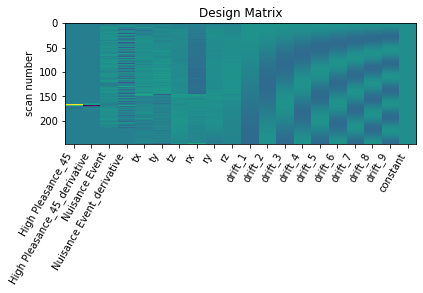

      0         1         2         3         4         5         6      \
0 -1.054389 -0.331208 -0.325305 -0.845298 -0.403041  0.784967 -0.647109   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.028844  0.596586  0.014634  ... -1.286014 -1.619958 -1.470864 -0.179238   

      11451    11452     11453     11454     11455     11456  
0 -0.590308 -1.68358  0.310264 -0.655919 -0.424256  1.245375  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_45
GLM RUN LowPleasance_46


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



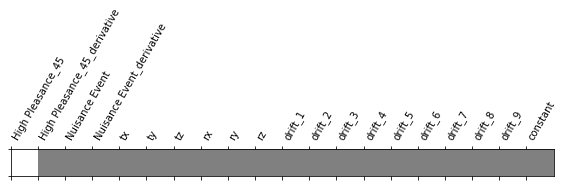

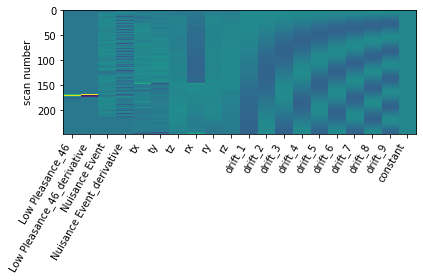

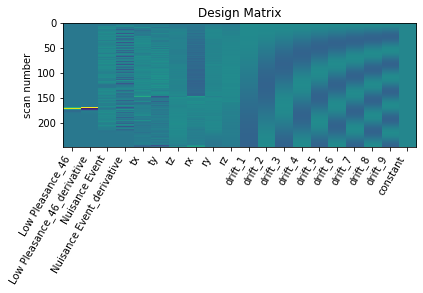

      0         1         2         3         4         5         6      \
0 -0.729639  0.606875 -0.931975 -1.437974 -2.198355 -1.496656 -1.582767   

      7         8         9      ...     11447     11448     11449    11450  \
0 -1.458606 -1.525398 -0.355584  ... -2.163645 -1.975602 -1.614604 -0.23274   

     11451     11452     11453     11454     11455     11456  
0 -0.48206 -1.620848  0.009766 -1.320862 -0.641138 -0.803879  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_46
GLM RUN LowPleasance_47


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



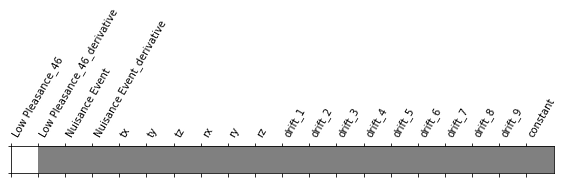

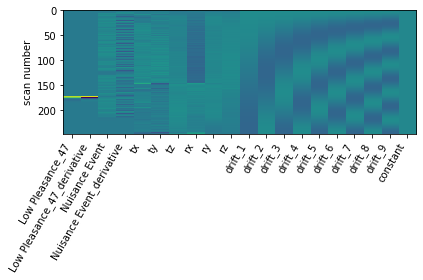

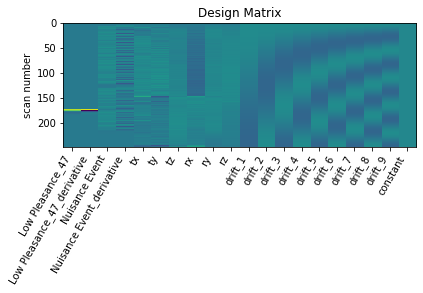

      0         1         2         3         4         5         6      \
0  0.781583 -0.000731  0.720106  1.167457  1.691773  0.883124  0.944616   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.771822  0.826432  1.114215  ...  0.170213  0.517457  0.625768  2.226024   

      11451     11452    11453     11454    11455    11456  
0  0.191033  0.267088  0.58913  0.093097 -0.03849  0.40758  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_47
GLM RUN LowPleasance_48


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



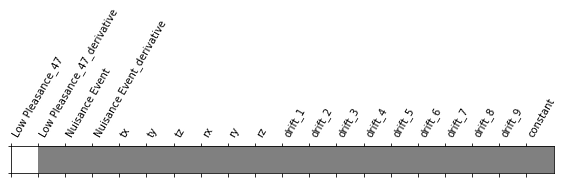

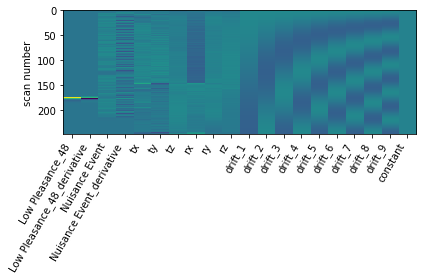

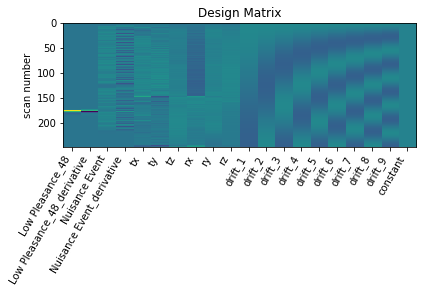

     0         1         2         3         4         5         6      \
0  0.40098 -0.704167  0.972886  1.414983  1.304656  1.452922  1.066055   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.480048  1.673257  1.208756  ...  0.410336  0.317761 -0.137465  1.271122   

      11451     11452     11453     11454     11455     11456  
0 -0.494819 -0.318678 -0.268685  0.370048  0.339147  0.461212  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_48
GLM RUN LowPleasance_49


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



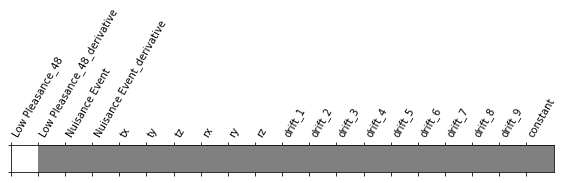

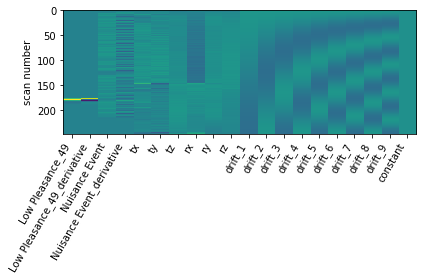

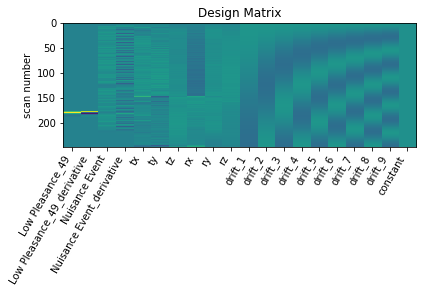

      0         1         2         3         4         5        6      \
0  1.210897 -0.379769  0.146667 -0.273392 -0.407277  1.289048 -0.53816   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.885916  1.389354  1.450885  ... -2.631426 -2.542803 -2.839377 -1.693992   

      11451     11452     11453    11454     11455     11456  
0 -1.410571 -1.866361  0.097677 -2.19784 -2.088524 -1.599379  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_49
GLM RUN LowPleasance_50


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



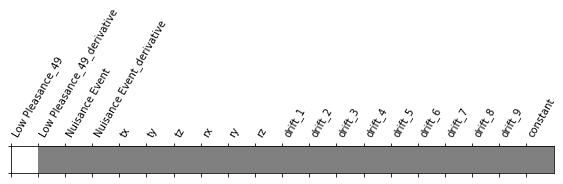

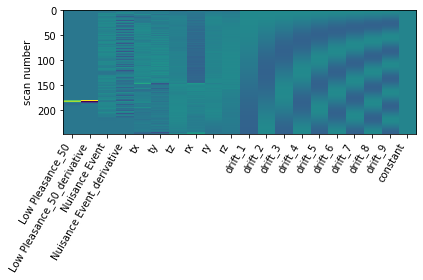

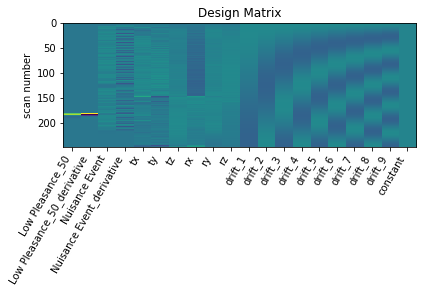

      0         1         2         3         4         5        6      \
0 -1.509088  0.923203 -0.469549 -0.636054 -0.508812 -1.171715 -0.34023   

      7        8         9      ...     11447     11448     11449     11450  \
0 -0.396653 -0.51617 -0.948699  ...  0.116576  0.428328  0.882066  0.717564   

      11451     11452     11453     11454     11455     11456  
0 -0.614045  0.301269  1.571351  0.547939  0.019196 -0.582969  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_50
GLM RUN HighPleasance_51


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



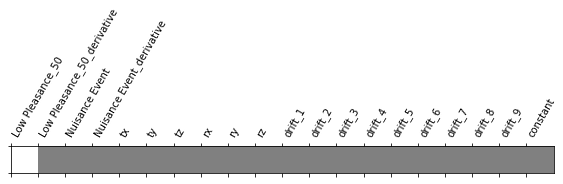

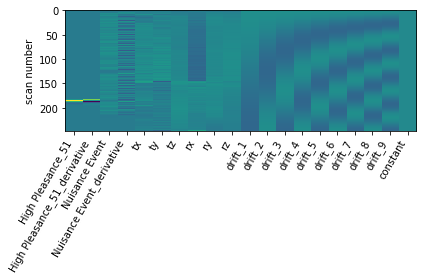

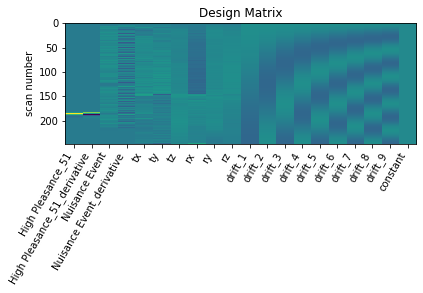

      0         1         2         3         4         5         6      \
0  1.210241 -0.123889  1.796774  2.240678  1.670557  1.698342 -0.810561   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.104657  0.791862  0.810852  ... -1.264048 -0.773296 -0.937607  0.421432   

      11451     11452     11453     11454     11455     11456  
0 -0.626311 -1.580249 -1.203154 -1.100651 -1.237107  0.348705  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_51
GLM RUN HighPleasance_52


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



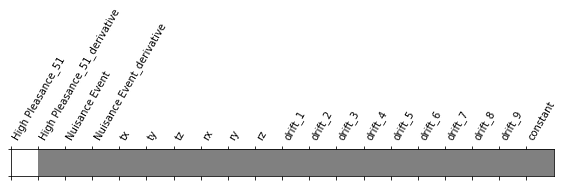

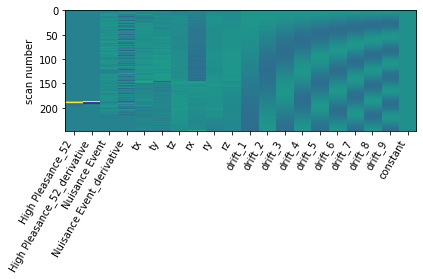

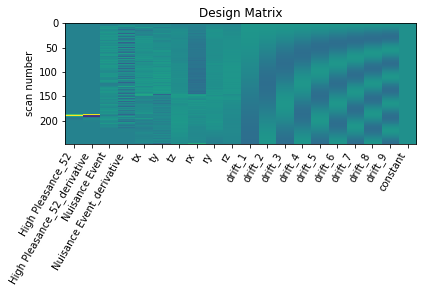

      0         1         2         3         4         5         6      \
0  1.015346 -0.699831 -0.466902 -0.692708 -0.390789  0.838878  0.081436   

      7         8         9      ...     11447     11448    11449     11450  \
0  0.646659  0.944193  1.123465  ... -1.067387 -1.342507 -1.72721 -0.629928   

      11451    11452     11453     11454     11455     11456  
0 -0.152088 -0.83659  0.018621 -0.977961 -0.056992 -0.993714  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_52
GLM RUN LowPleasance_53


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



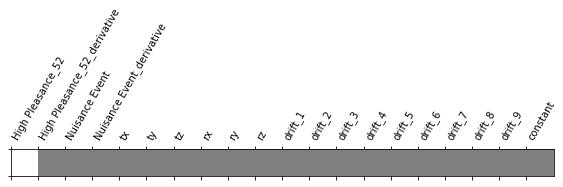

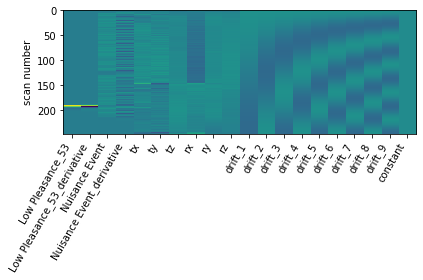

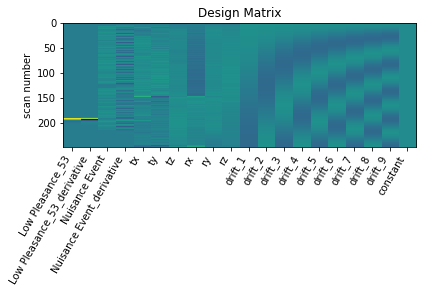

      0         1        2         3        4         5         6      \
0 -0.798165  1.227725 -1.39796 -1.187339 -1.02352 -0.429086 -0.378048   

      7        8         9      ...    11447     11448     11449     11450  \
0 -0.042796  0.01307 -0.605589  ... -0.70917 -0.438333 -0.677217  0.215164   

      11451     11452     11453     11454     11455     11456  
0 -0.797101 -0.899533  1.026422 -0.550953 -0.577417  0.228118  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_53
GLM RUN LowPleasance_54


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



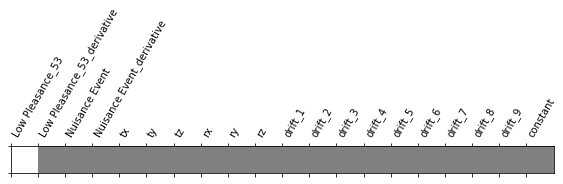

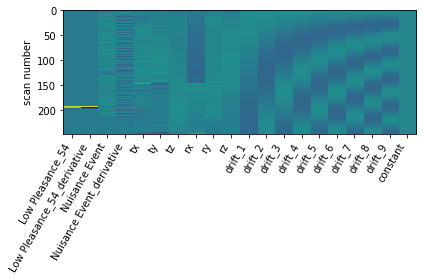

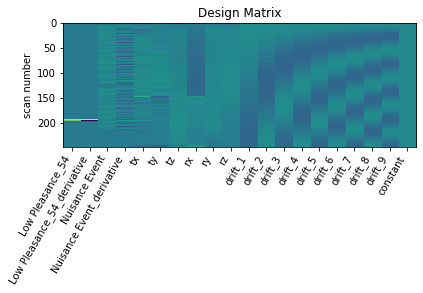

      0       1         2         3         4         5         6      \
0 -0.881525  0.1154  0.105355 -0.489868 -1.288373  0.179687 -1.469303   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.899413 -0.436063 -0.498352  ... -1.739831 -1.595683 -1.331256  0.591321   

      11451     11452     11453     11454     11455     11456  
0 -1.044858 -1.818608  0.719657 -1.578147 -1.623589 -0.012136  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_54
GLM RUN HighPleasance_55


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



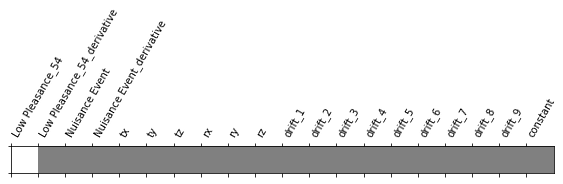

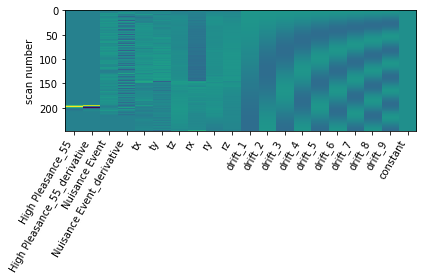

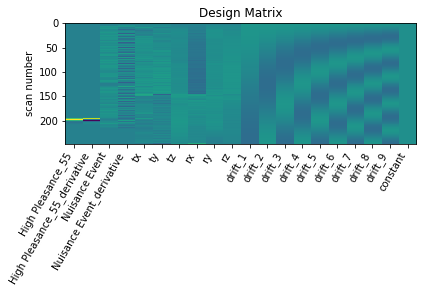

      0         1         2         3        4         5         6      \
0  0.714232 -0.255427  2.098813  2.265149  1.88773  0.444897 -0.563225   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.278933  0.890829  1.370009  ... -0.950299 -0.822601 -1.016908 -0.383887   

      11451     11452     11453     11454     11455     11456  
0 -0.776034 -1.107931 -0.574891 -0.439653 -1.167855 -1.057165  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_55
GLM RUN LowPleasance_56


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



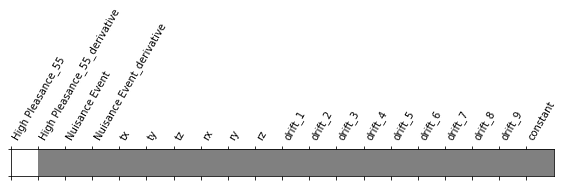

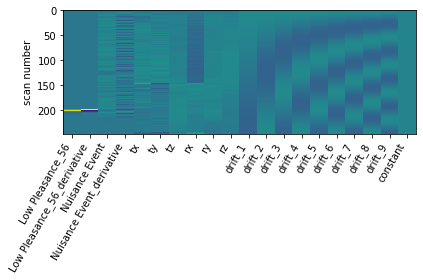

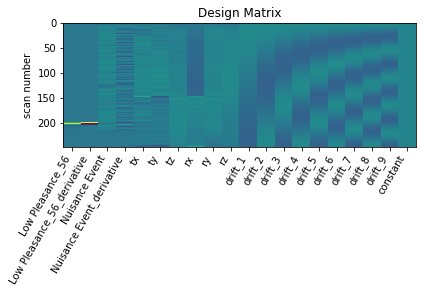

      0         1         2         3         4         5         6      \
0  1.778929  1.212019 -1.145684 -0.523957  0.535247  0.839545  0.189244   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.333362  0.468038  0.261004  ...  1.478702  1.729364  1.340452  0.482976   

      11451     11452     11453    11454     11455    11456  
0  0.127621  0.691185  1.301405  0.09587  1.406203 -0.70601  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_56
GLM RUN LowPleasance_57


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



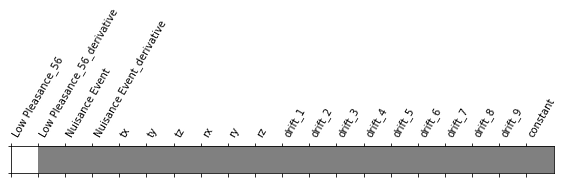

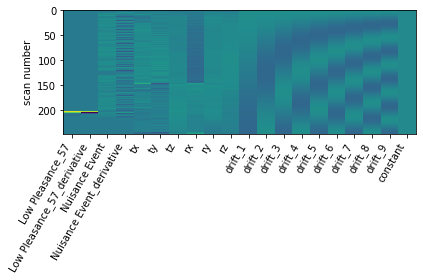

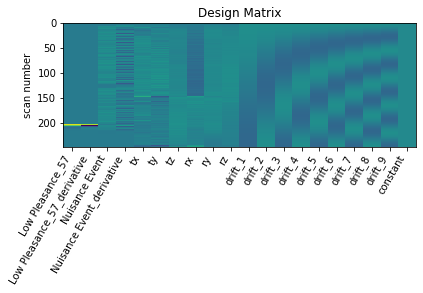

      0         1         2         3         4         5        6      \
0 -2.025897 -0.737905  0.412745 -0.570101 -1.307729  0.591296  0.68885   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.817411  0.851888  0.449634  ... -1.565788 -1.913189 -1.256803  0.184278   

     11451     11452     11453     11454     11455     11456  
0  0.36564 -0.810698  0.604737 -1.205372 -1.021702  1.894189  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_57
GLM RUN LowPleasance_58


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



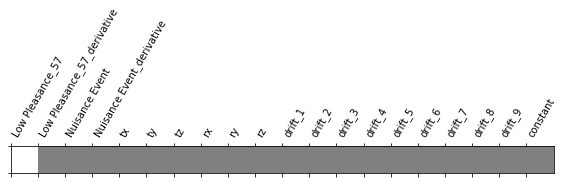

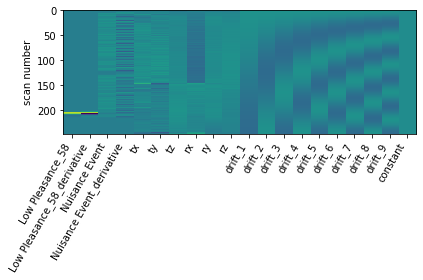

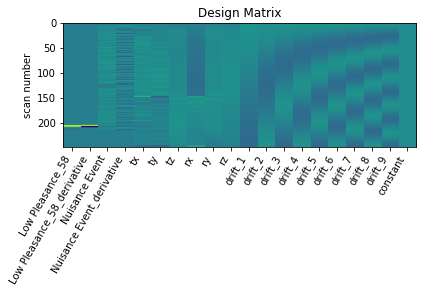

      0         1         2        3        4         5         6      \
0  1.343172  0.298188 -0.120642 -0.34501 -0.60052 -0.466573 -1.603184   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.936826 -0.739594  0.843024  ... -2.315417 -2.277257 -2.331622  1.523019   

      11451     11452     11453     11454     11455     11456  
0 -1.103249 -2.817677  0.673227 -1.540558 -1.232733 -0.872711  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_58
GLM RUN LowPleasance_59


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



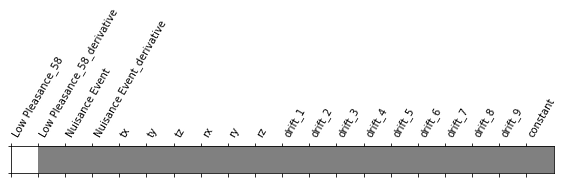

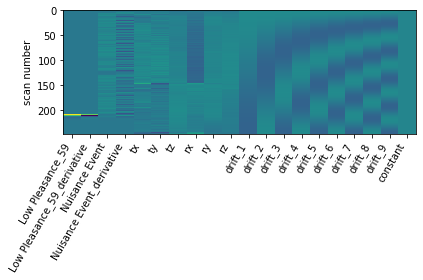

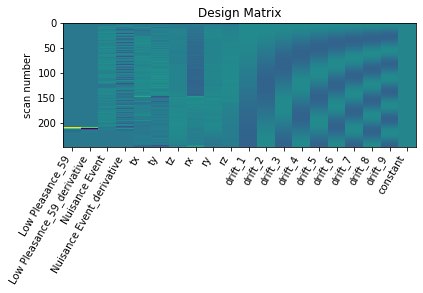

      0         1         2         3         4         5         6      \
0 -0.184539  0.893589 -0.092346  0.302195  0.636352 -0.147537  0.077725   

      7         8        9      ...     11447     11448     11449     11450  \
0  0.324647  0.010513  1.13948  ...  0.601066  0.828729  0.723674 -1.714195   

      11451     11452     11453     11454     11455     11456  
0  0.255967  0.318997 -1.000586  0.882131  1.313753  0.030026  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_59
GLM RUN LowPleasance_60


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



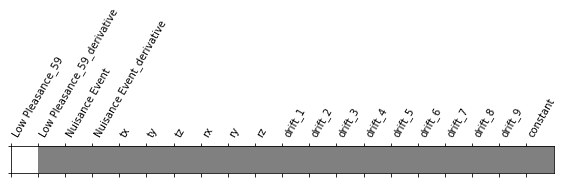

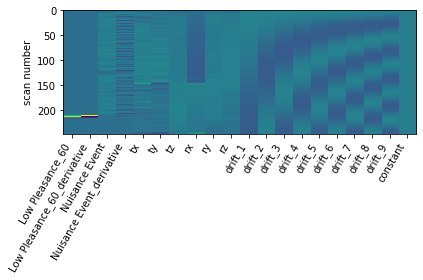

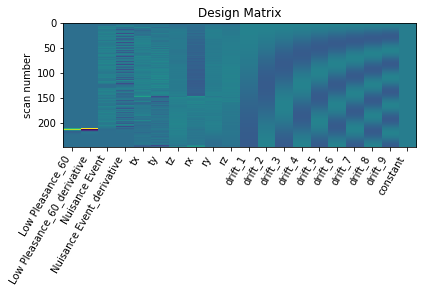

      0         1         2         3         4         5         6      \
0 -0.234502 -0.647718 -0.130085 -0.093389  0.082516 -1.075745 -1.845499   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.446646 -1.076481 -1.331525  ...  0.052092 -0.167886 -0.250871 -0.158473   

      11451     11452     11453     11454     11455     11456  
0 -0.208799  0.250878 -1.843187  0.572551 -1.087549  0.140013  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_60


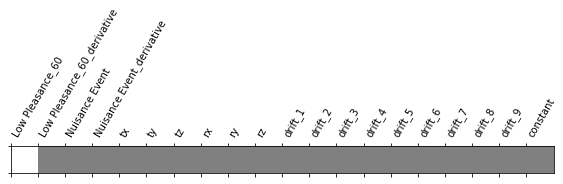

In [ ]:
y_fa_ap, X_fa_ap = lss_separate_method_comp(task =task,
                          data_path=data_path,
                          events_path=events_path,
                          motion_param_path=motion_param_path,
                          cache_mem_path=cache_mem_path,
                          activity_mat_saving_path=activity_mat_saving_path,
                          analysis_type=analysis_type,
                          param_modulation=False,
                          t_r=t_r,
                          drift_model=drift_model,
                          drift_order=drift_order,
                          hrf_model=hrf_model,
                          pre_whitening_spec=pre_whitening_spec,
                          apply_trans_mask=apply_trans_mask,
                          roi_img=roi_img,  
                          hpf_cut=hpf_cut,
                          smoothing_fwhm=smoothing_fwhm,
                          standardize=standardize,
                          detrend=detrend,minimize_memory=minimize_memory)

In [ ]:
y_g.append(y_fa_ap)
X_g.append(X_fa_ap)

In [ ]:
X_fa_ap.shape

(60, 11457)

### Run PA

In [ ]:
data_path = 'ses-19/func/wrdcsub-01_ses-19_task-PreferenceFaces_dir-pa_bold.nii.gz'
events_path = 'ses-19/func/sub-01_ses-19_task-PreferenceFaces_dir-pa_events.tsv'
motion_param_path = 'ses-19/func/rp_dcsub-01_ses-19_task-PreferenceFaces_dir-pa_bold.txt'
task = 'Faces'

In [ ]:
analysis_type = 'High_Low_Pleasance'
hrf_model = 'spm + derivative'
param_modulation = False
drift_model='cosine'
t_r=2
drift_order=None
apply_trans_mask=True
roi_img = mask_img
standardize=True
detrend=True
minimize_memory = True
activity_mat_saving_path = 'mvpa/test2'

events = pd.read_csv(events_path,sep='\t')

# onset shift in order to capture the very moment of the appreciation decision
events['onset'] = events['onset']-1

onset_periods = [events['onset'][i+1] - events['onset'][i]  for i in range(len(events['onset']))if (i<len(events['onset'])-1)]
onset_periods = np.array(onset_periods)
onset_freq = np.reciprocal(onset_periods)
hpf_cut = np.min(onset_freq)/2 # cf High Pass Filtering Rule of Thumb ( fMRI Handbook 2011)

Event 0
      onset  duration        trial_type
0     9.524     4.237  High Pleasance_1
1    15.507     4.376    Nuisance Event
2    23.039     4.480    Nuisance Event
3    32.021     4.951    Nuisance Event
4    38.654     4.874    Nuisance Event
5    47.952     3.741    Nuisance Event
6    52.635     6.975    Nuisance Event
7    62.034     5.752    Nuisance Event
8    70.466     5.500    Nuisance Event
9    78.581     5.062    Nuisance Event
10   86.997     4.497    Nuisance Event
11   94.579     5.393    Nuisance Event
12  101.995     7.024    Nuisance Event
13  111.843     4.060    Nuisance Event
14  119.376     6.127    Nuisance Event
15  127.458     4.312    Nuisance Event
16  135.607     5.811    Nuisance Event
17  144.306     6.899    Nuisance Event
18  153.754     7.378    Nuisance Event
19  165.503     5.838    Nuisance Event
20  172.152     3.824    Nuisance Event
21  178.118     4.778    Nuisance Event
22  184.434     3.244    Nuisance Event
23  188.833     5.861    Nuisanc

59  468.544     5.428     Nuisance Event
Event 55
      onset  duration        trial_type
0     9.524     4.237    Nuisance Event
1    15.507     4.376    Nuisance Event
2    23.039     4.480    Nuisance Event
3    32.021     4.951    Nuisance Event
4    38.654     4.874    Nuisance Event
5    47.952     3.741    Nuisance Event
6    52.635     6.975    Nuisance Event
7    62.034     5.752    Nuisance Event
8    70.466     5.500    Nuisance Event
9    78.581     5.062    Nuisance Event
10   86.997     4.497    Nuisance Event
11   94.579     5.393    Nuisance Event
12  101.995     7.024    Nuisance Event
13  111.843     4.060    Nuisance Event
14  119.376     6.127    Nuisance Event
15  127.458     4.312    Nuisance Event
16  135.607     5.811    Nuisance Event
17  144.306     6.899    Nuisance Event
18  153.754     7.378    Nuisance Event
19  165.503     5.838    Nuisance Event
20  172.152     3.824    Nuisance Event
21  178.118     4.778    Nuisance Event
22  184.434     3.244    Nuisa

Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



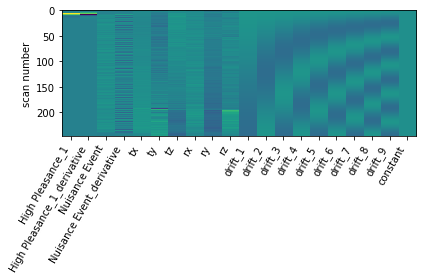

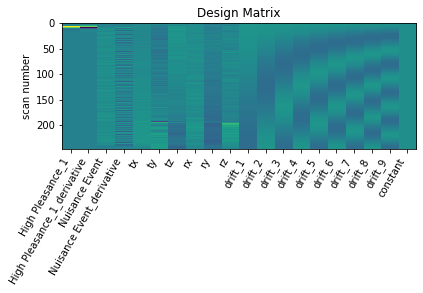

      0         1         2         3         4         5         6      \
0  1.247012 -1.483517  1.193791  1.130968  0.893985  0.577562  1.232963   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.158916  0.661395  1.025395  ... -0.115637  0.720114  1.252468  0.425155   

      11451     11452     11453    11454     11455     11456  
0  1.506416 -0.108915  0.950374 -0.95088 -1.147062 -1.591565  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_1
GLM RUN LowPleasance_2


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



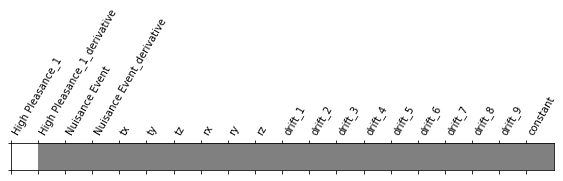

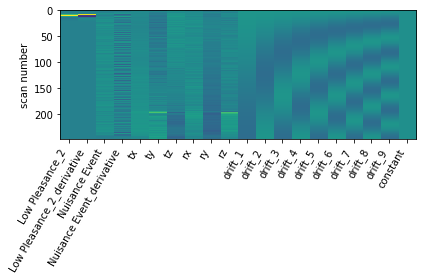

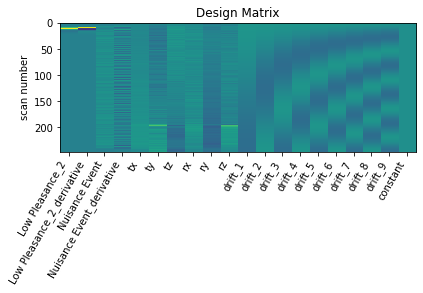

      0         1         2         3         4         5        6      \
0 -0.759599  0.173404  0.523671  0.339304  0.006672  0.697737  0.10678   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.376748  0.747984 -0.117973  ... -0.614479 -0.997894 -0.990662 -1.005145   

      11451     11452     11453     11454     11455     11456  
0 -1.414191 -0.119604  0.193718  0.216949  0.143502 -0.458732  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_2
GLM RUN LowPleasance_3


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



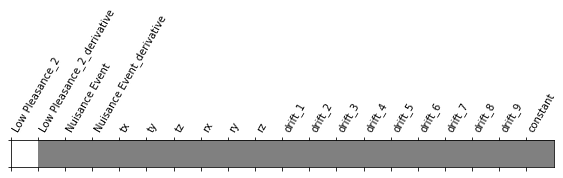

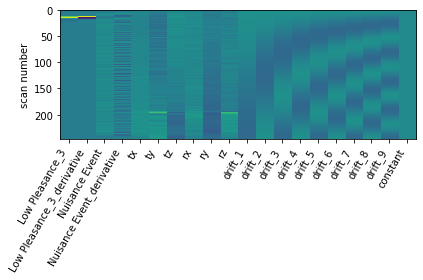

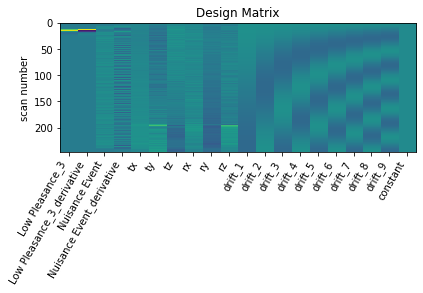

      0        1         2         3        4         5         6      \
0  1.757206 -0.10202  1.031041  1.092659  1.19747 -0.726312 -0.409855   

      7         8         9      ...    11447    11448     11449     11450  \
0 -0.603746 -0.676146 -1.018701  ... -0.77038 -0.09903 -0.634643  0.513867   

      11451     11452     11453     11454     11455     11456  
0 -0.135732 -1.382238  0.488486 -1.301689 -0.044019 -2.209843  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_3
GLM RUN LowPleasance_4


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



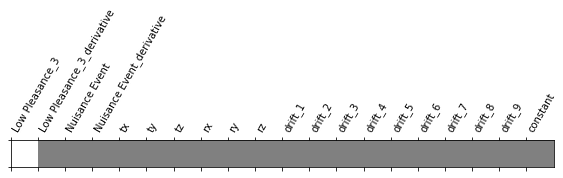

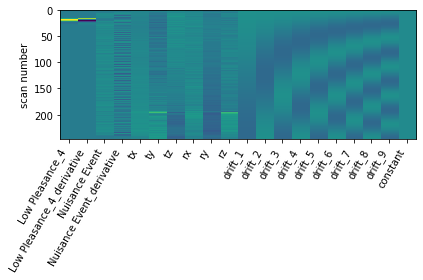

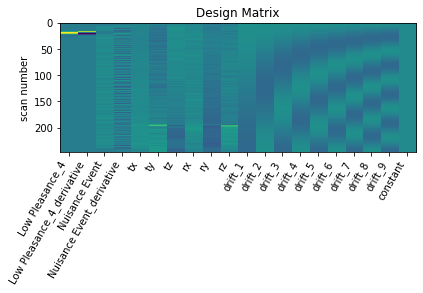

      0        1        2         3         4         5         6      \
0  0.965153 -0.89088  1.41974  0.730026  0.252485  2.673043  1.311257   

     7         8         9      ...     11447     11448     11449     11450  \
0  1.51753  1.544365  1.273905  ... -0.697262 -0.414725 -0.028294  0.222337   

      11451     11452     11453     11454    11455     11456  
0 -0.127809 -0.163662  1.517109 -0.677472  0.03797 -2.134067  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_4
GLM RUN HighPleasance_5


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



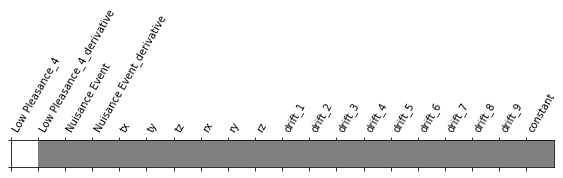

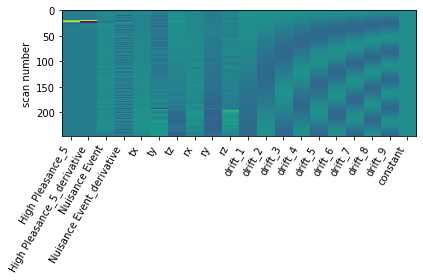

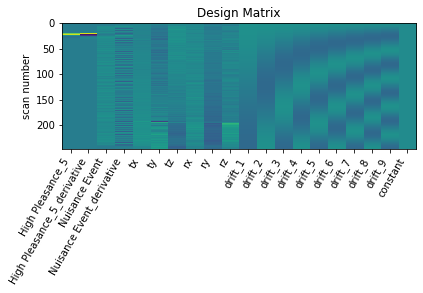

      0         1         2         3         4         5         6      \
0  0.386499 -0.558174 -0.026652  0.470453  0.744856 -0.260305 -0.158361   

      7        8         9      ...     11447    11448     11449     11450  \
0 -0.306292 -0.18453 -0.563313  ... -1.200697 -0.53335 -1.553499 -0.598617   

      11451     11452     11453     11454     11455     11456  
0 -0.561852 -2.240773 -0.675582 -1.084456  0.059363 -1.524268  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_5
GLM RUN HighPleasance_6


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



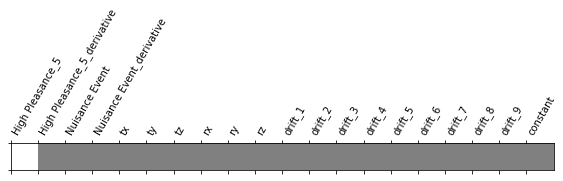

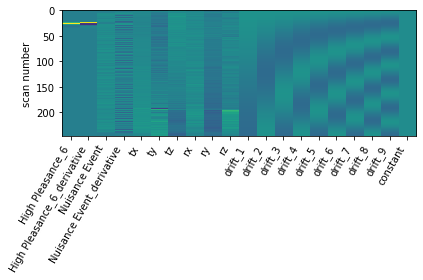

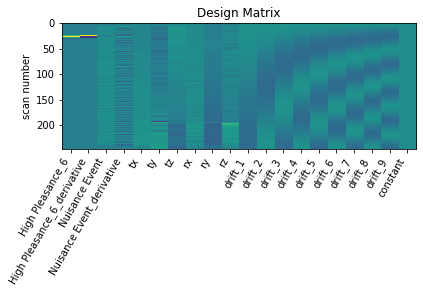

      0        1         2         3         4         5        6      \
0  1.724847  0.85313  1.066749  1.176757  1.232113  0.834156  0.70768   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.454842  0.405974 -0.281912  ... -0.226773  0.308161  0.297998  0.600693   

      11451     11452    11453     11454     11455     11456  
0  0.372935  0.850951  1.16243 -1.079661  0.348065 -1.647388  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_6
GLM RUN HighPleasance_7


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



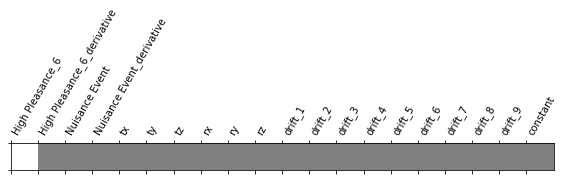

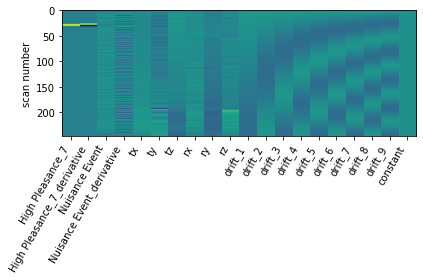

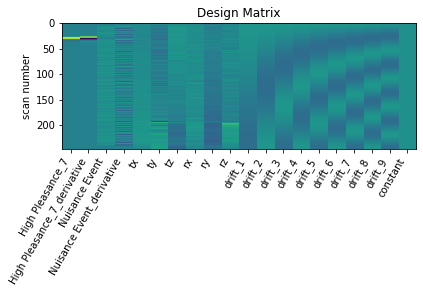

      0         1         2         3         4         5         6      \
0 -0.463873 -0.969293  0.627381  0.123925 -0.065541  1.813285  0.998768   

      7         8         9      ...     11447     11448     11449    11450  \
0  0.656302  0.487773  0.223626  ... -1.523619 -1.270714 -1.237973 -0.68975   

      11451     11452     11453    11454     11455     11456  
0 -0.530512 -2.163249 -0.234459 -0.56928  0.340464 -1.450245  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_7
GLM RUN LowPleasance_8


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



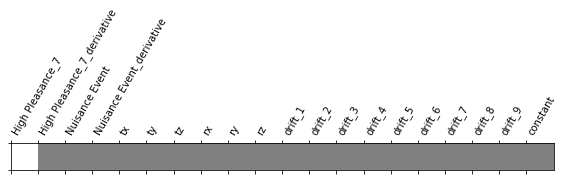

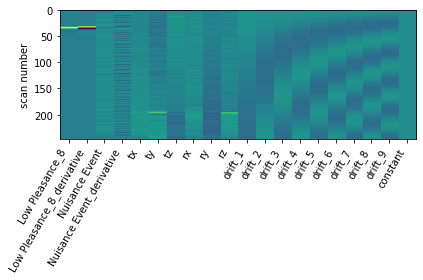

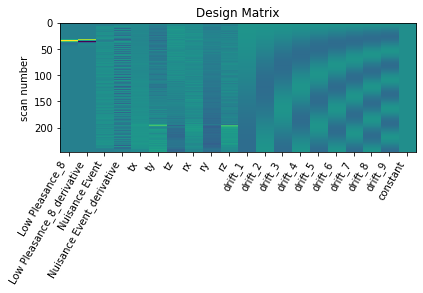

      0        1         2         3         4         5        6      \
0  2.323157 -0.09884  1.345635  1.741219  1.888152  1.002439  1.52739   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.843069  1.839382  0.794142  ... -0.544834  0.237611 -0.932517  0.322283   

      11451    11452     11453    11454     11455     11456  
0 -0.432475 -0.57827  0.852717 -1.85376 -0.129299 -1.392854  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_8
GLM RUN HighPleasance_9


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



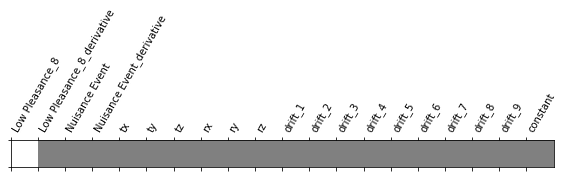

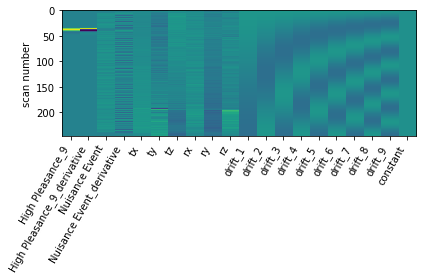

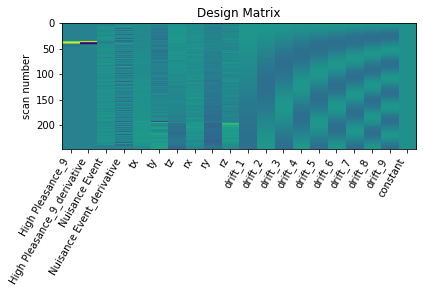

      0         1         2         3         4         5         6      \
0 -0.718802 -0.229929  0.921974 -0.093985 -0.385673  0.549903  0.411158   

      7         8         9      ...     11447     11448     11449    11450  \
0  0.367418  0.326009  0.349496  ... -1.672415 -1.439877 -1.809855 -0.83537   

      11451     11452     11453     11454     11455     11456  
0  0.752354 -2.067158  0.923656 -0.522611  0.402124 -2.126071  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_9
GLM RUN HighPleasance_10


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



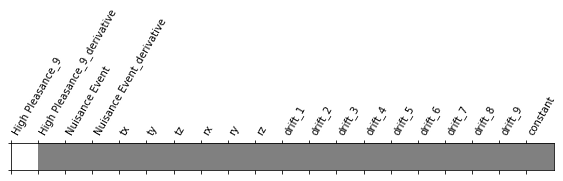

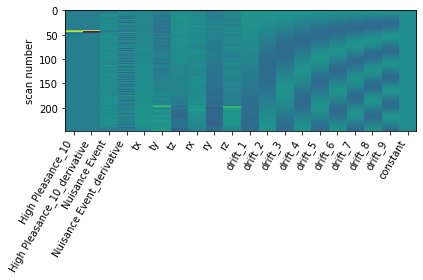

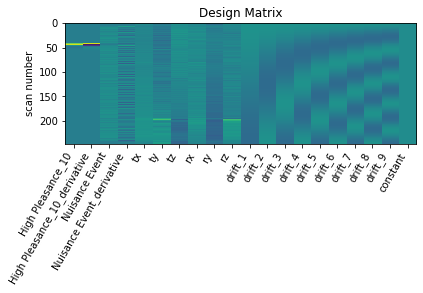

      0         1         2         3         4         5         6      \
0  2.259722 -0.595687  0.675506  1.036734  0.724815  1.711485  0.645593   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.452863  0.918912  0.101074  ... -1.190267 -0.416712 -1.068712  0.662701   

      11451     11452     11453    11454     11455     11456  
0 -0.927853 -0.913415  0.551128 -2.05175  0.552353 -1.851987  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_10
GLM RUN LowPleasance_11


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



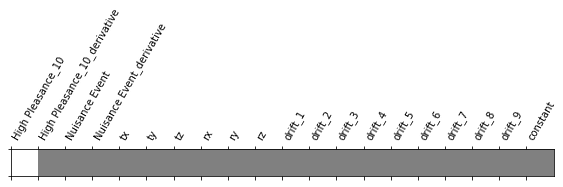

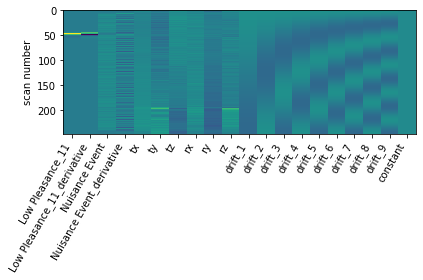

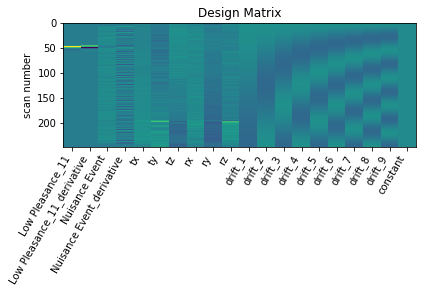

      0         1         2         3         4         5         6      \
0 -0.429414 -0.757117  1.365177  0.921062  1.032376  0.408777  0.960733   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.991392  0.559993  0.180327  ... -1.259455 -1.378879 -1.446004 -1.226177   

      11451     11452     11453     11454     11455     11456  
0  0.197964 -1.600665  0.985235 -0.763344  0.082006 -2.610592  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_11
GLM RUN HighPleasance_12


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



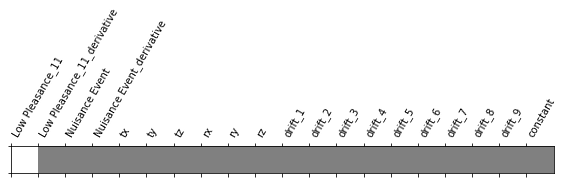

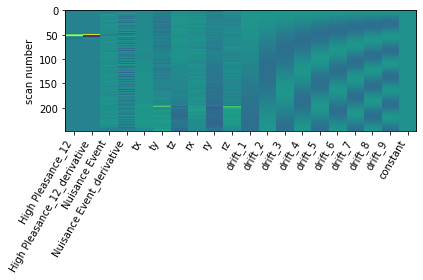

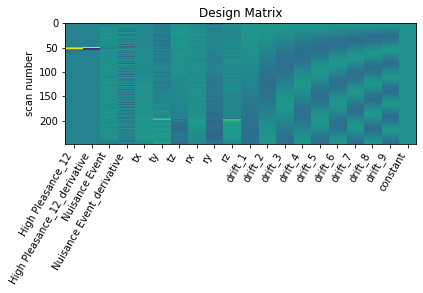

     0         1        2         3         4         5         6      \
0 -0.23497  0.581627  0.16267  0.141184 -0.160741  0.894368  0.127932   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.119416  0.456724  0.205191  ... -1.730156 -1.038543 -1.364969  0.190017   

      11451    11452     11453     11454     11455     11456  
0 -0.784647 -1.50057 -0.697503 -1.495534  0.130115 -1.491343  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_12
GLM RUN HighPleasance_13


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



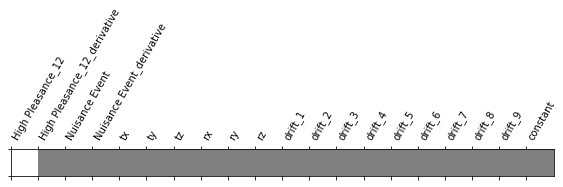

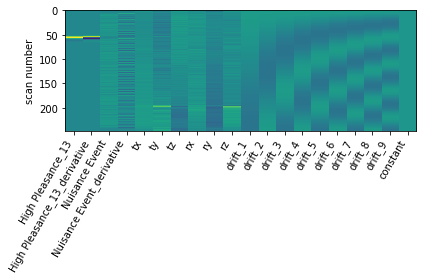

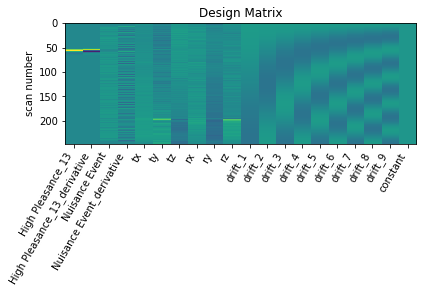

      0         1        2         3         4         5         6      \
0  1.388256 -1.382942  0.80083  1.064762  1.249971  0.399317  1.375321   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.958154  0.352177  0.176883  ... -0.608988 -0.143154 -0.916689 -0.925395   

      11451     11452     11453     11454     11455     11456  
0 -0.334743 -1.155201  1.130252 -1.230008  0.007786 -1.745816  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_13
GLM RUN HighPleasance_14


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



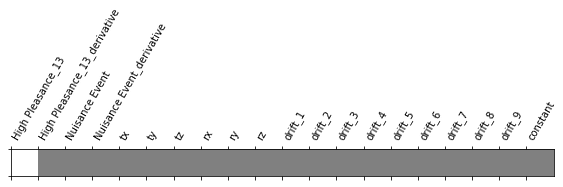

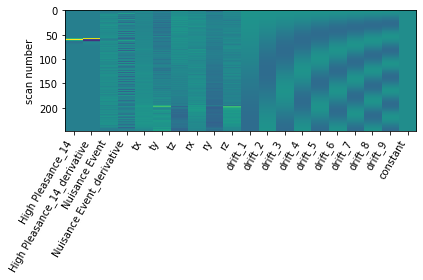

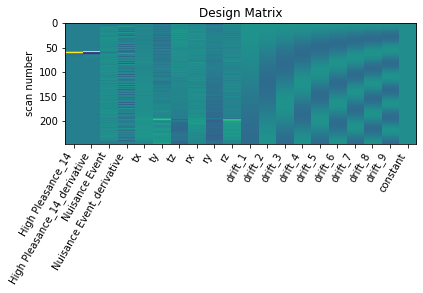

      0         1         2         3         4         5         6      \
0 -0.123662  1.751932  0.839464  0.833313  0.756756  0.566672 -0.389234   

      7        8         9      ...    11447     11448     11449     11450  \
0 -0.356957  0.32867 -0.694281  ... -0.85481 -0.503802 -0.384584  1.279772   

     11451     11452     11453     11454     11455     11456  
0  0.06057 -0.482872  0.778292 -0.312747  0.072094 -1.374064  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_14
GLM RUN HighPleasance_15


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



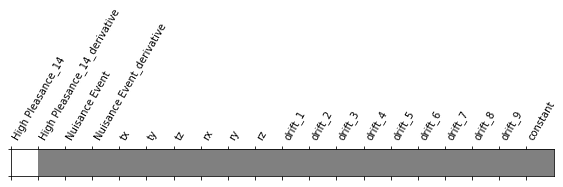

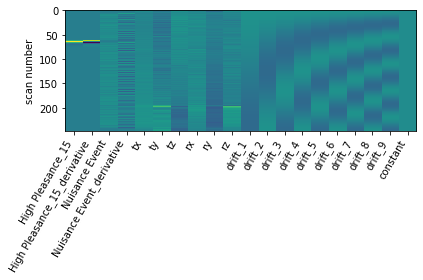

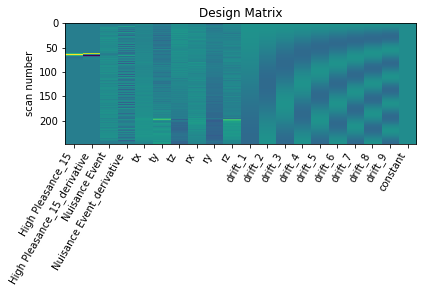

      0         1         2        3         4         5         6      \
0  1.032806 -1.401514  1.638862  1.56473  1.343759  1.330681  0.986046   

     7         8         9      ...     11447     11448     11449     11450  \
0  1.17071  1.091172  0.380148  ... -0.776732 -0.558305 -1.171826 -1.041596   

      11451     11452     11453     11454     11455    11456  
0  0.472713 -1.222395  1.440411 -0.388908  0.205891 -1.83671  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_15
GLM RUN LowPleasance_16


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



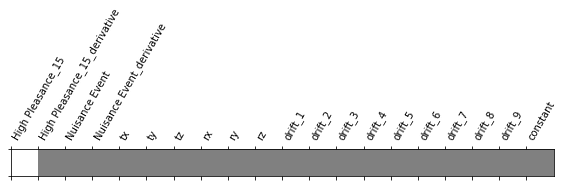

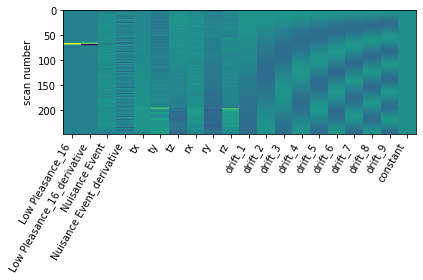

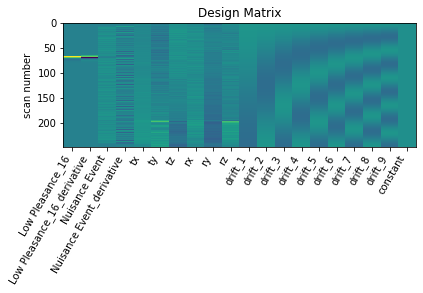

      0         1        2         3         4         5         6      \
0  0.905573  0.405318  0.99032  0.857217  0.721022  0.627643  0.002343   

      7         8         9      ...     11447     11448     11449    11450  \
0  0.256958  0.524664 -0.188422  ... -0.941125 -0.301208 -0.359714  0.79611   

      11451     11452     11453     11454     11455     11456  
0 -1.033053 -0.623369  0.948972 -1.290751 -0.654424 -2.800032  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_16
GLM RUN HighPleasance_17


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



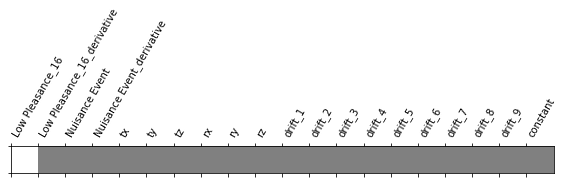

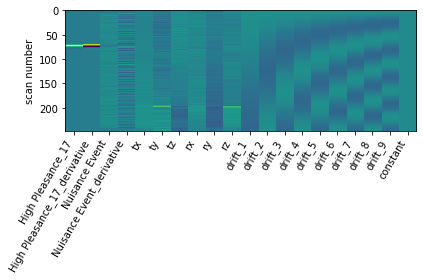

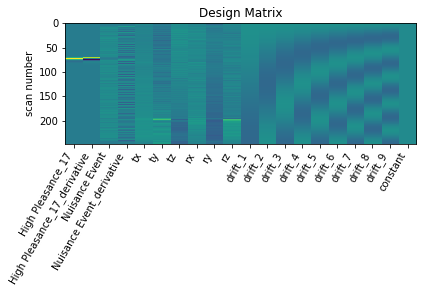

     0         1         2         3         4         5        6      \
0  0.01781 -0.726139  1.082271  0.950925  0.752922  1.699785  1.57622   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.064421  1.002365  0.576803  ... -1.369745 -1.743338 -1.294343 -1.864868   

      11451     11452     11453     11454     11455     11456  
0  0.181233 -1.199905 -0.005926 -0.725326  0.909172 -1.995664  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_17
GLM RUN HighPleasance_18


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



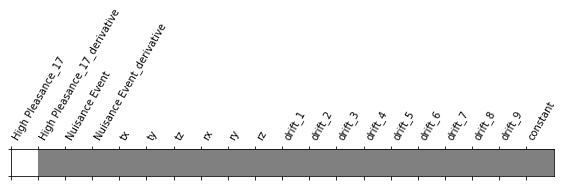

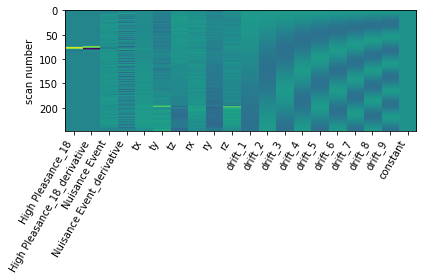

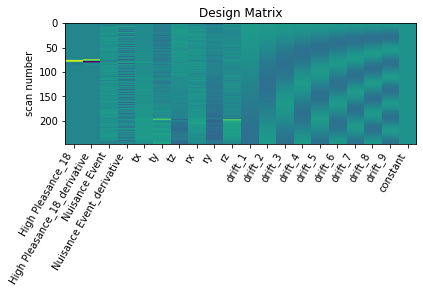

      0         1         2         3         4         5         6      \
0  1.945264 -0.366863  1.422596  1.062403  1.014253  1.095457  0.388744   

      7         8         9      ...     11447    11448     11449     11450  \
0  0.755446  0.975319  1.041566  ... -1.440624 -0.26066 -1.388201  0.821021   

     11451     11452     11453     11454     11455     11456  
0 -0.44247 -1.239685  0.547123 -1.591391 -0.547962 -1.544406  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_18
GLM RUN HighPleasance_19


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



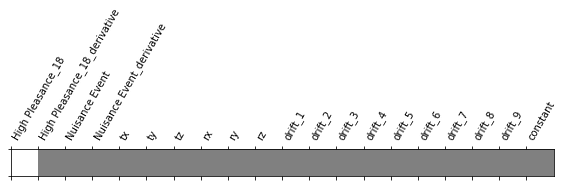

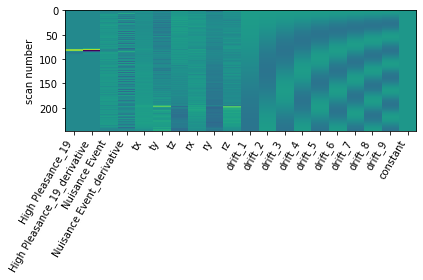

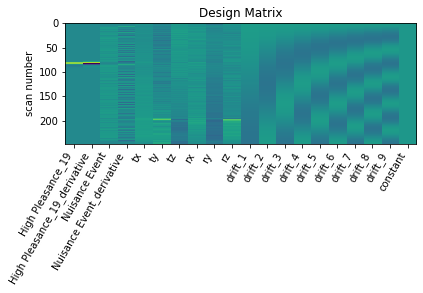

      0       1         2         3         4         5         6      \
0  1.085586 -0.2443  0.621353  0.884031  0.871752  0.824148  0.938504   

      7         8         9      ...     11447     11448    11449    11450  \
0  0.593266  0.700576  0.151361  ... -2.272394 -1.361052 -2.03762  0.33356   

      11451     11452     11453     11454     11455    11456  
0  0.203172 -2.747989  0.843115 -2.584838  0.426567 -2.82619  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_19
GLM RUN LowPleasance_20


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



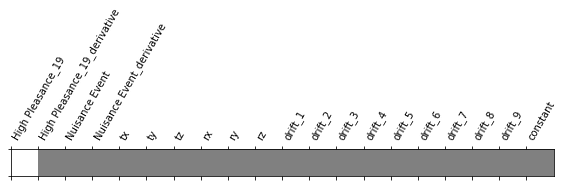

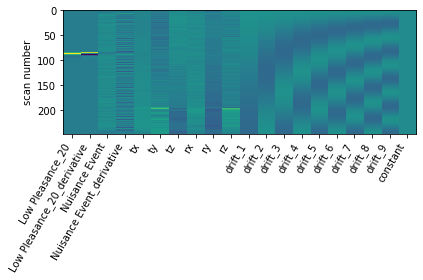

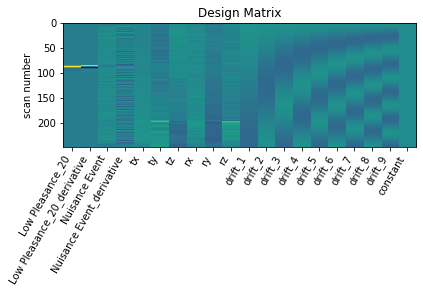

      0         1         2         3         4         5         6      \
0  1.022035 -0.935614  0.869426  1.032042  1.273785  1.175981  0.337854   

      7         8         9      ...     11447    11448     11449     11450  \
0  1.103297  1.167408  0.088439  ... -0.537139 -0.07087 -0.290588 -0.215576   

      11451     11452     11453     11454     11455     11456  
0 -0.475978 -0.240705  0.756638 -0.764376  0.687632 -1.003221  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_20
GLM RUN HighPleasance_21


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



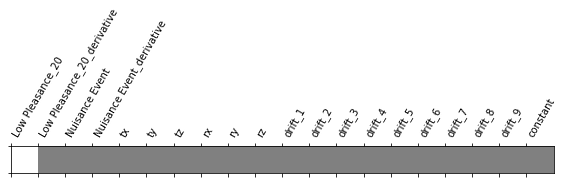

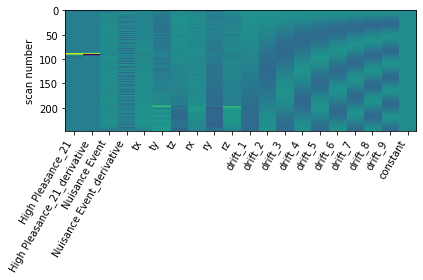

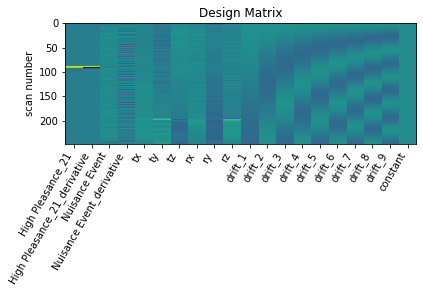

     0         1         2        3         4         5         6      \
0  0.06831  0.575394  0.830216  0.93099  0.911349  1.063251  1.302776   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.795947  0.553375  0.585896  ... -1.171306 -0.338239 -1.366124 -0.241637   

      11451     11452     11453     11454     11455     11456  
0  0.915939 -2.133267  0.816785 -1.011706 -1.720395 -2.157867  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_21
GLM RUN LowPleasance_22


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



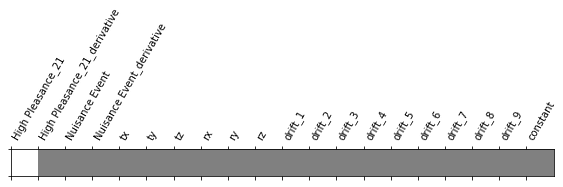

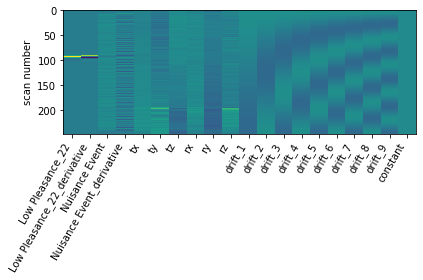

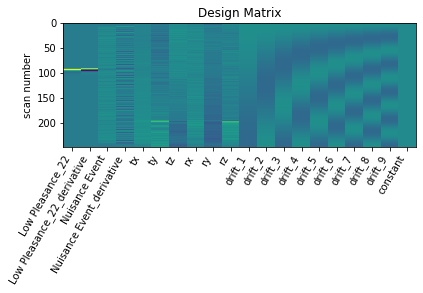

      0         1         2         3         4         5        6      \
0 -0.404046 -1.016226 -0.467647 -0.493206 -0.602808 -0.026369 -0.61328   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.523319 -0.259822 -1.056479  ... -1.432935 -1.313744 -1.365985 -0.757987   

      11451     11452    11453     11454     11455     11456  
0 -0.268769 -1.466191  0.30395 -1.652406  1.611556 -1.395554  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_22
GLM RUN LowPleasance_23


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



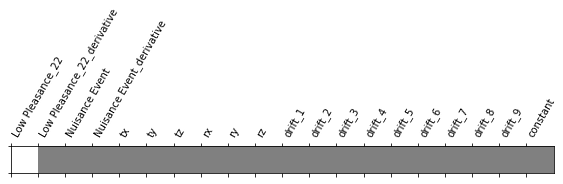

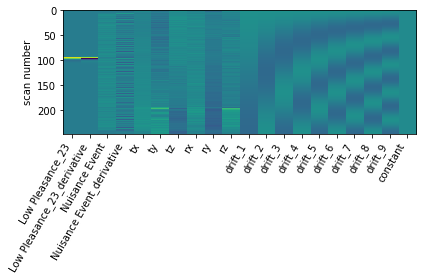

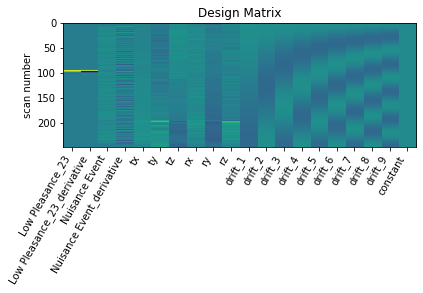

      0         1         2      3         4         5         6        7      \
0  0.338714  0.961038  1.819524  1.329  1.037782 -0.219072  0.243476  0.04624   

      8         9      ...     11447     11448     11449     11450     11451  \
0 -0.103359 -0.048207  ...  0.674343 -0.345031  1.307395 -1.182251 -1.457945   

      11452     11453     11454     11455     11456  
0  1.775524 -0.087562  1.085546 -0.592395 -0.451047  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_23
GLM RUN HighPleasance_24


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



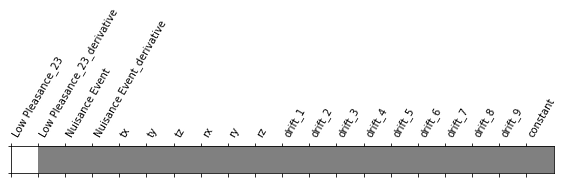

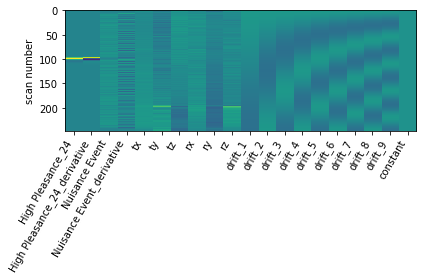

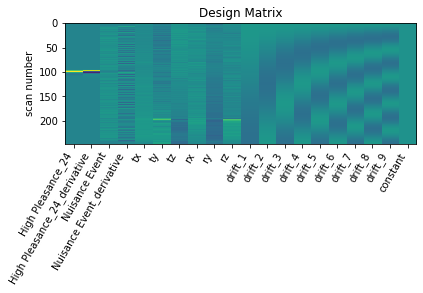

      0         1        2         3         4         5        6      \
0  1.325598 -0.914496  0.19143  0.548448  0.850695  1.587584  1.43356   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.313534  1.214646  0.994102  ... -0.766765  0.225764 -1.050629  0.529343   

      11451     11452     11453     11454     11455     11456  
0  0.658388 -1.579022  0.933498 -0.710946  0.175875 -1.815795  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_24
GLM RUN LowPleasance_25


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



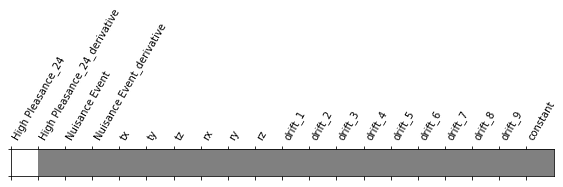

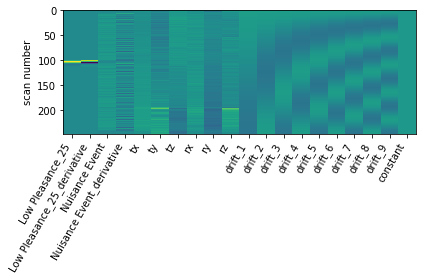

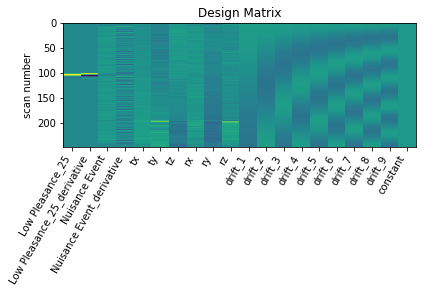

      0         1         2        3        4         5         6      \
0  0.361282 -0.482598  1.844178  1.75542  1.33875  0.691706  0.058476   

      7         8         9      ...     11447     11448     11449    11450  \
0  0.209205  0.559941 -0.458266  ... -1.415524 -1.164143 -1.356209 -0.46159   

      11451     11452     11453     11454     11455     11456  
0 -0.909405 -1.560087  0.950736 -1.459582 -0.140579 -2.068264  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_25
GLM RUN HighPleasance_26


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



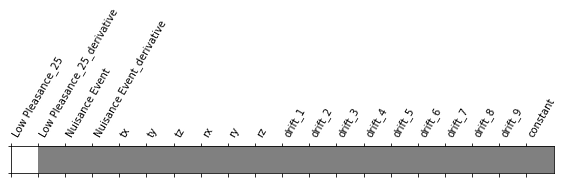

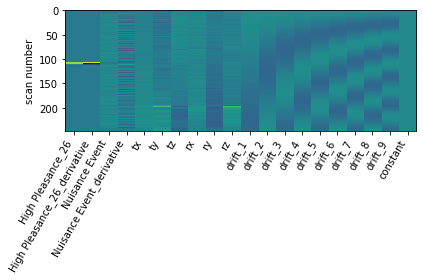

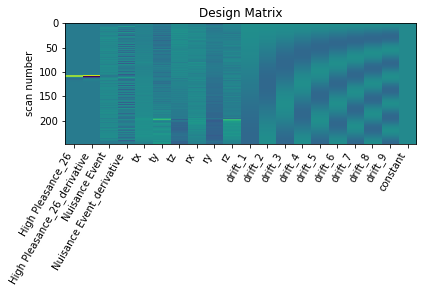

      0         1         2         3         4         5         6      \
0  1.134187  0.650497  0.705498  0.704471  0.576335  0.453517  0.901349   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.406884  0.006034  0.198062  ... -1.049847 -0.077462 -0.662275 -0.104417   

      11451     11452     11453     11454     11455     11456  
0  1.253415 -1.511988 -0.272051 -1.006267  0.542619 -3.006665  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_26
GLM RUN HighPleasance_27


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



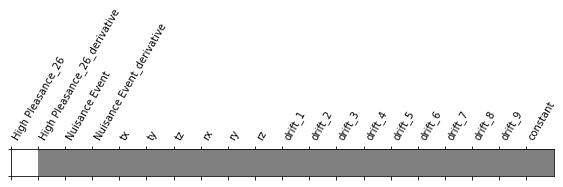

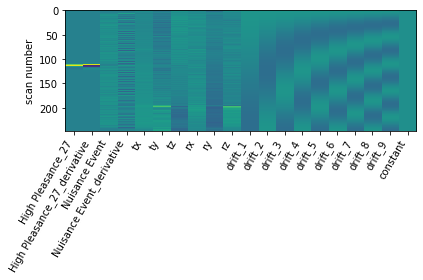

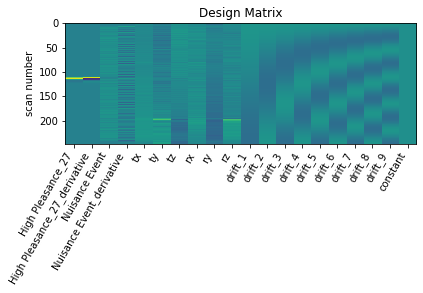

      0         1         2        3         4         5         6      \
0  0.001972 -0.804915  0.973074  0.84436  0.781722  1.351785  0.820883   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.578745  0.948968 -0.084025  ... -1.890099 -1.656872 -1.925467 -0.194597   

      11451     11452     11453     11454     11455     11456  
0 -1.698504 -1.235731  0.866066 -1.889685  0.427084 -0.683209  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_27
GLM RUN LowPleasance_28


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



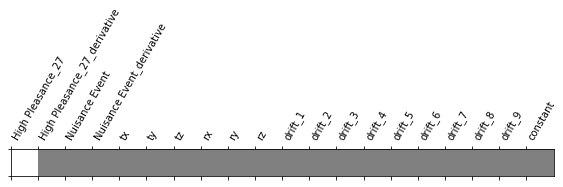

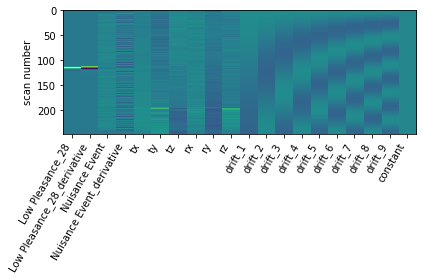

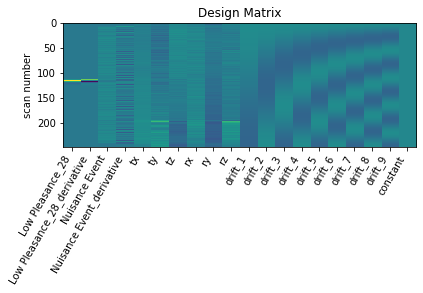

      0         1         2         3         4         5         6      \
0  1.446793  0.233011  1.630812  1.367602  1.004348 -0.174392 -0.167832   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.207448 -0.031487 -0.230839  ... -1.325266 -0.313079 -1.135902  0.912223   

      11451     11452     11453     11454     11455    11456  
0  0.413037 -1.141142  0.105933 -1.671624 -0.550739 -1.85764  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_28
GLM RUN LowPleasance_29


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



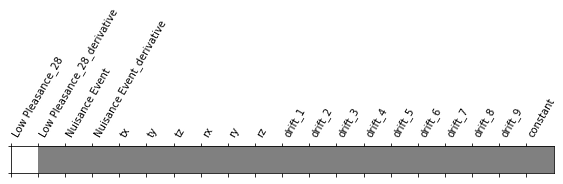

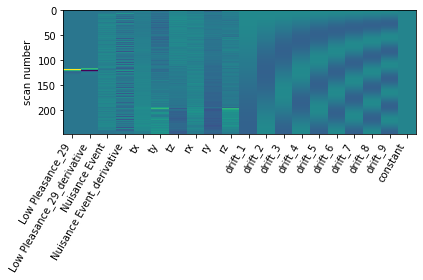

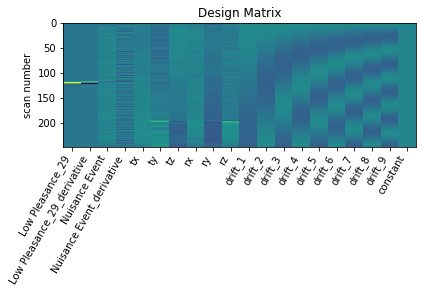

      0         1         2         3         4         5        6      \
0  0.503185 -0.344521 -0.379581 -0.146448  0.195116  1.362924  1.01995   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.771673  0.652911  0.839535  ...  0.370976  0.258399  0.463147 -0.054553   

      11451    11452     11453     11454     11455    11456  
0 -0.420591 -0.02278  0.804793  0.705767  0.547736 -1.03632  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_29
GLM RUN HighPleasance_30


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



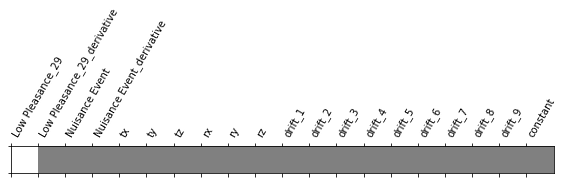

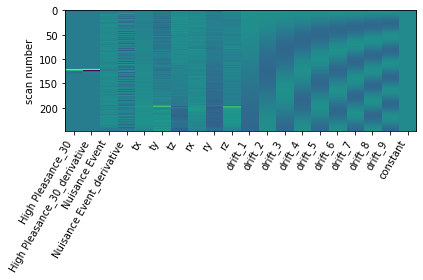

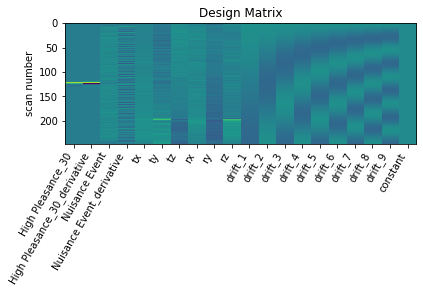

     0         1        2         3         4         5         6      \
0  0.59588 -0.970287  1.33645  1.235805  0.951979  0.707441  0.023408   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.172705 -0.157206 -0.802685  ... -1.861465 -1.413253 -1.086849 -0.314578   

      11451     11452     11453     11454     11455     11456  
0 -1.685337 -0.800891  0.081391 -1.960252 -0.191621 -1.659352  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_30
GLM RUN HighPleasance_31


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



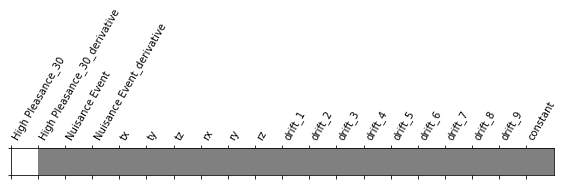

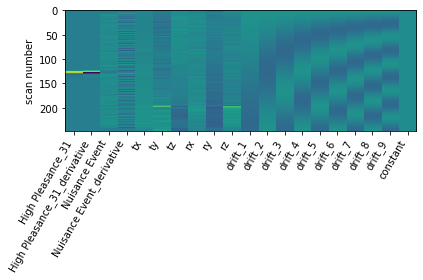

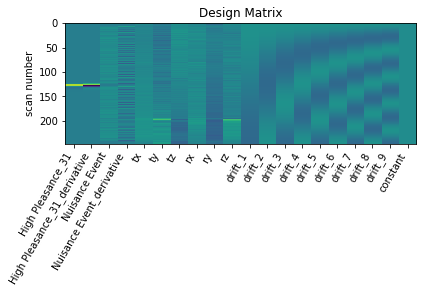

      0         1         2         3         4         5         6      \
0  1.428883  0.414885  1.075056  0.958967  1.050946  0.852207  0.512472   

      7         8         9      ...     11447    11448   11449     11450  \
0  0.484617  0.630734  0.676164  ... -0.087572 -0.15106 -0.8858 -0.117632   

      11451     11452    11453     11454     11455     11456  
0  0.932203 -1.861221  0.76369 -0.203955  0.867716 -2.294703  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_31
GLM RUN LowPleasance_32


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



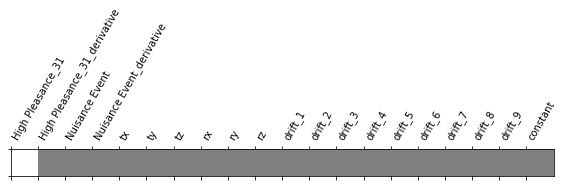

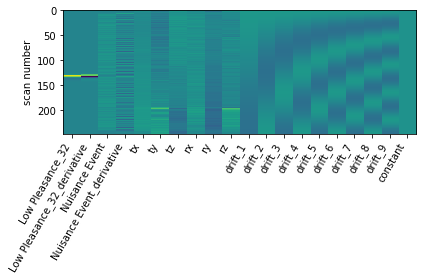

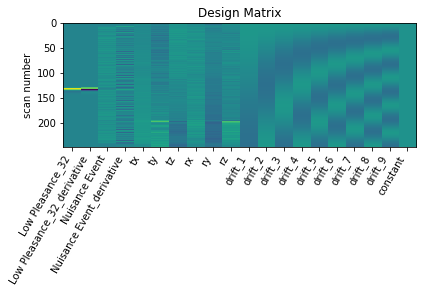

      0         1         2        3         4         5         6      \
0  1.205101 -0.792558  0.363216  0.44283  0.381114  1.393806  0.368826   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.864524  0.906221  0.416674  ... -2.279086 -1.762776 -1.562938 -0.191136   

      11451     11452     11453     11454     11455     11456  
0 -0.742929 -1.351547  1.147413 -1.942552 -0.834898 -1.600028  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_32
GLM RUN HighPleasance_33


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



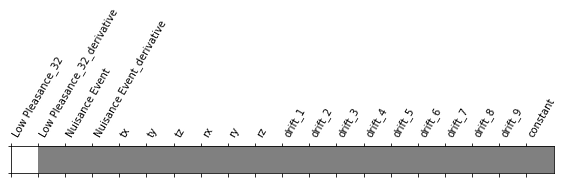

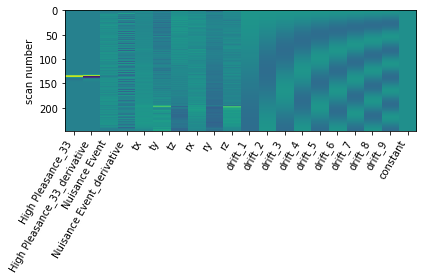

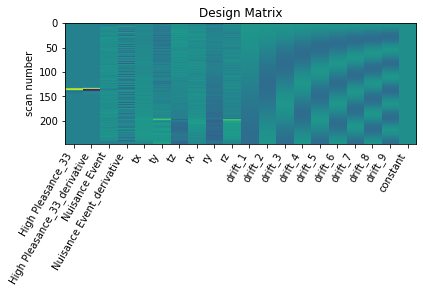

      0         1         2         3        4         5         6      \
0 -0.183184 -0.371793  0.896924  0.701634  0.77199  1.099769  0.923248   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.561104  1.046491  0.185065  ...  0.351956  0.231306 -0.001093 -0.636795   

      11451     11452     11453     11454     11455     11456  
0 -0.387256 -0.627222  0.174817  0.206702  1.164029 -1.446274  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_33
GLM RUN HighPleasance_34


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



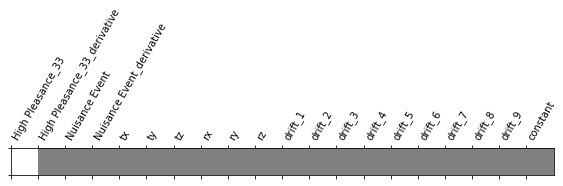

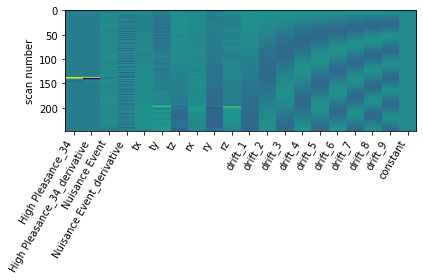

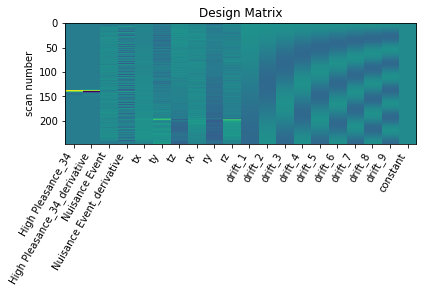

      0       1       2         3         4         5         6         7      \
0  1.240854 -0.2406  0.5102  0.894041  0.860766 -0.456827 -0.043713  0.120966   

      8         9      ...     11447     11448    11449     11450     11451  \
0 -0.334165  0.404992  ... -1.750149 -0.749415 -1.91959  0.241571  0.150904   

      11452     11453     11454     11455     11456  
0 -1.813792  0.961203 -1.790824 -0.161044 -1.724272  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_34
GLM RUN HighPleasance_35


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



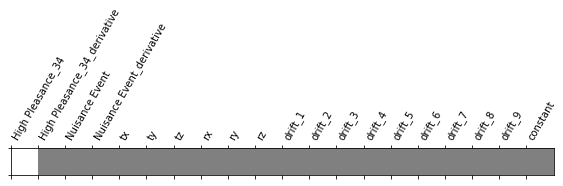

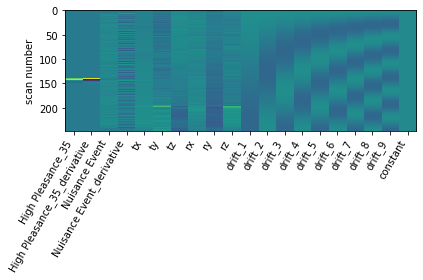

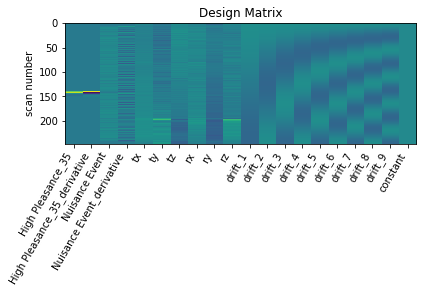

      0         1         2         3         4         5         6      \
0  0.449239  0.662967  0.926445  0.371835  0.066612  1.004923  0.695479   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.660149  0.435349 -0.708235  ... -1.208622 -1.017965 -0.811119 -0.236274   

      11451     11452    11453     11454     11455     11456  
0  0.044774 -0.698577  0.28681 -0.938286 -0.560234 -1.607094  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_35
GLM RUN HighPleasance_36


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 19 seconds



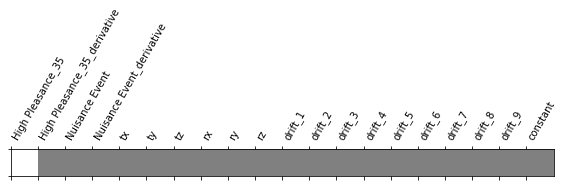

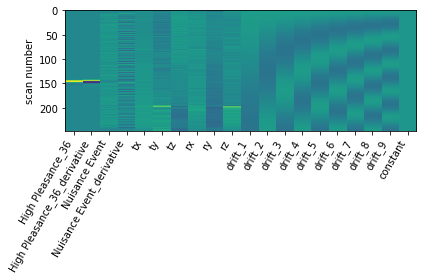

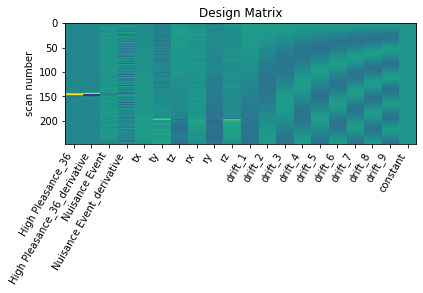

      0         1         2         3         4        5         6      \
0  0.511969 -1.268687  0.617394  0.930451  1.219019  0.95601  0.238458   

      7         8         9      ...    11447     11448     11449     11450  \
0  0.099197  0.533651  0.197967  ... -0.90132 -0.297293 -0.924805 -0.111371   

      11451     11452     11453     11454     11455     11456  
0 -0.916543 -1.603533  0.900933 -1.074546  0.475627 -2.168752  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_36
GLM RUN LowPleasance_37


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



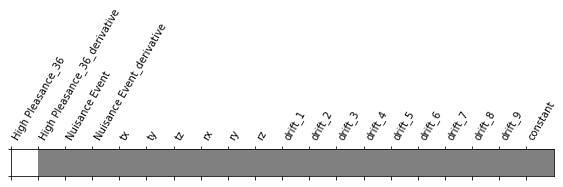

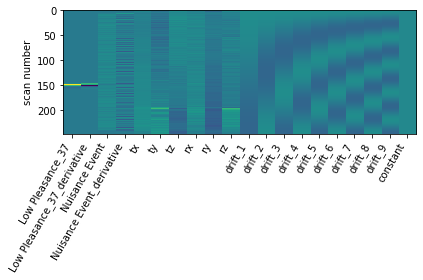

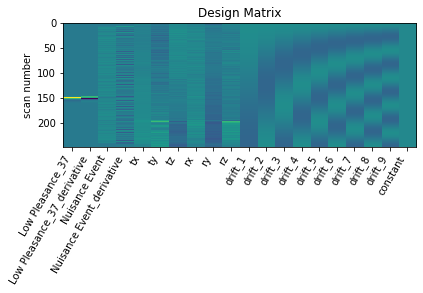

      0         1         2         3         4         5         6      \
0  0.369342  0.822216  1.543302  1.028636  0.871399  1.221877  1.346686   

     7         8         9      ...     11447     11448     11449     11450  \
0  1.84106  1.588883  0.696044  ... -2.086695 -1.612507 -1.545139 -0.344145   

      11451     11452     11453     11454     11455     11456  
0  0.724965 -1.050368 -0.081956 -2.036015 -0.444919 -1.244923  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_37
GLM RUN LowPleasance_38


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



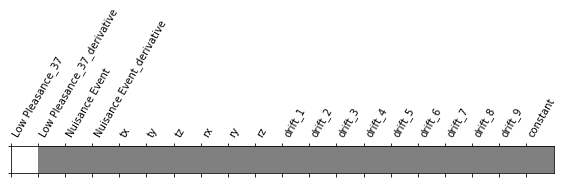

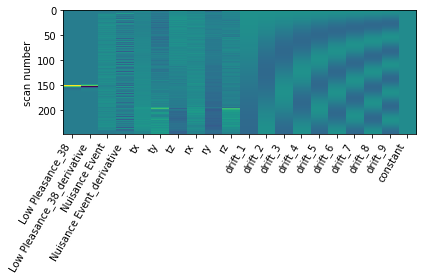

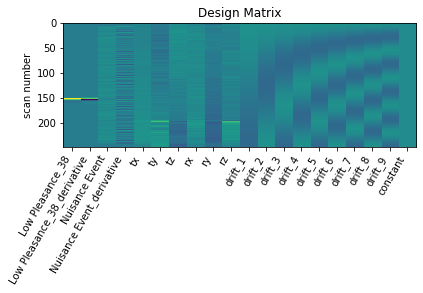

      0         1         2         3         4         5         6      \
0 -0.640454 -0.161634  0.371088  0.611045  0.623537  0.252153  0.140612   

      7         8         9      ...    11447     11448     11449     11450  \
0 -0.253335 -0.315165 -0.638635  ... -0.43348 -0.718689 -0.498211  0.424641   

      11451     11452     11453     11454     11455     11456  
0 -1.446821 -0.580047  0.274461 -0.189891  0.632106 -1.126923  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_38
GLM RUN LowPleasance_39


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 27 seconds



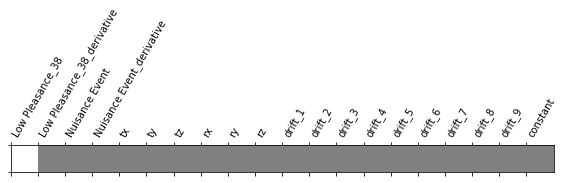

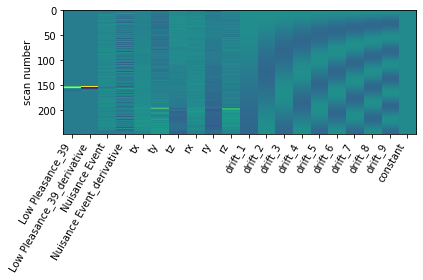

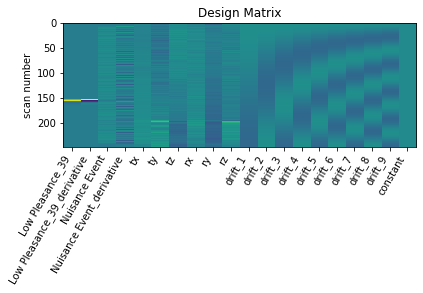

      0         1         2         3         4         5         6      \
0  0.768662 -1.291025 -0.006723 -0.491507 -0.747664  0.500542 -0.461887   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.505402 -0.214866 -0.684762  ... -1.025816 -0.011687 -0.595861 -0.578855   

      11451    11452     11453     11454     11455     11456  
0 -0.461588 -1.12161  0.876252 -1.267488 -0.448804 -2.901228  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_39
GLM RUN LowPleasance_40


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



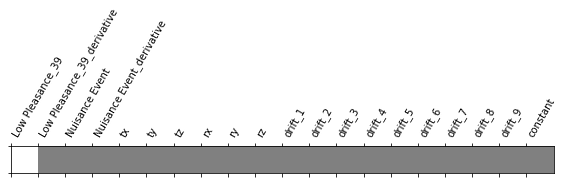

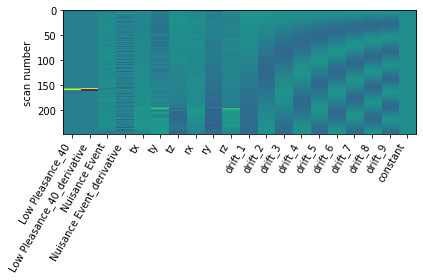

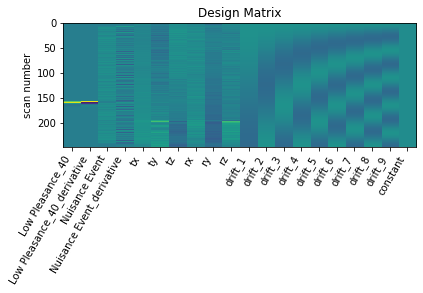

      0         1         2         3        4         5         6      \
0  0.441407  0.756025  2.326367  2.976716  2.94644  1.441735  1.914605   

      7         8         9      ...     11447     11448     11449     11450  \
0  2.021387  1.921666  1.002852  ... -0.697749 -1.201732 -0.999452 -0.071175   

      11451     11452     11453     11454     11455     11456  
0 -0.187506 -0.975147  0.386198 -0.226272  0.929383 -0.989935  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_40
GLM RUN LowPleasance_41


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



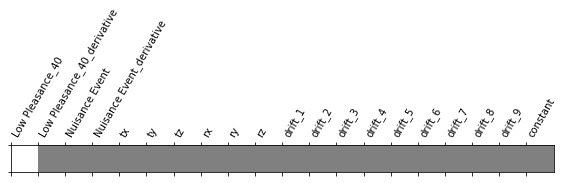

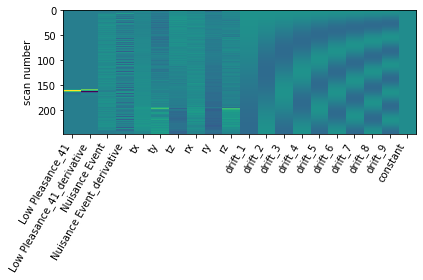

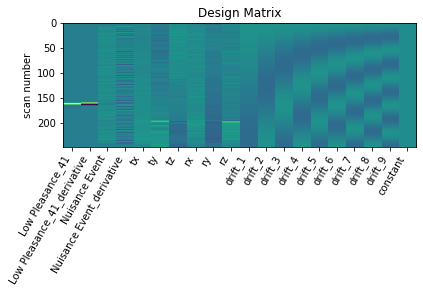

      0         1         2         3         4         5         6      \
0  0.635762 -0.305123 -0.076651 -0.282624 -0.084067  1.074349 -0.237247   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.363643 -0.365506 -0.450828  ... -0.414293  0.590991  0.081053 -0.155213   

      11451     11452     11453    11454     11455     11456  
0 -1.088552 -0.531802  0.332918 -1.13926  0.257742 -1.127661  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_41
GLM RUN HighPleasance_42


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



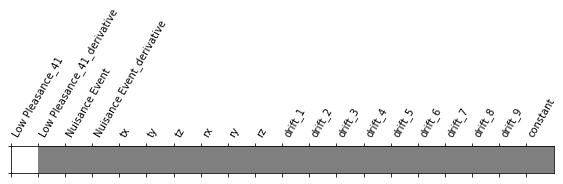

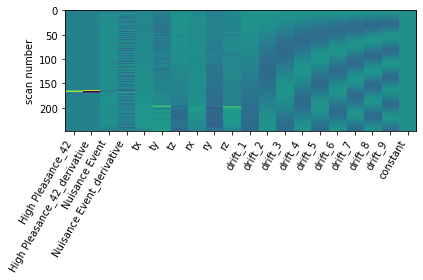

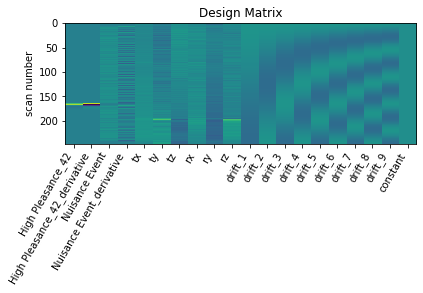

      0         1        2         3         4         5         6      \
0  0.555219 -0.915754  1.50909  1.543055  1.203689  0.723592  1.304502   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.389085  1.300912  0.439808  ... -1.290474 -1.266403 -1.632386 -0.600689   

     11451     11452     11453     11454     11455     11456  
0  0.64163 -1.907653  0.525502 -0.942749  0.277595 -2.169226  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_42
GLM RUN LowPleasance_43


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



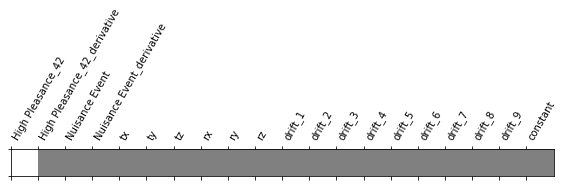

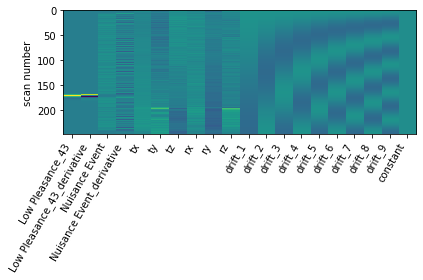

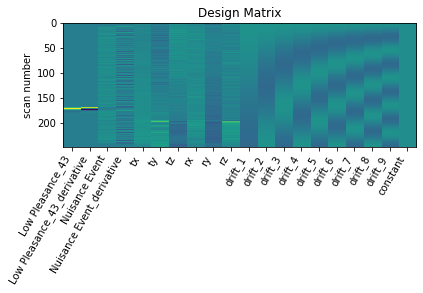

      0         1         2         3         4         5         6      \
0  1.237271  0.566832  1.727928  1.372531  1.130026  1.170494  1.194403   

     7         8         9      ...     11447     11448     11449     11450  \
0  0.98039  0.871402  0.655166  ... -1.860137 -0.921513 -1.224267  0.144314   

      11451     11452     11453    11454     11455     11456  
0 -0.923772 -1.323508  1.124919 -1.70256  0.184134 -2.382739  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_43
GLM RUN LowPleasance_44


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



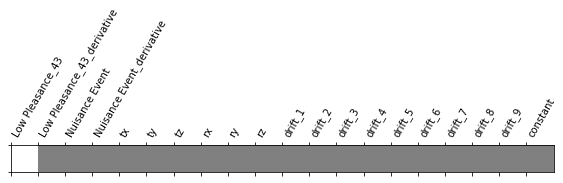

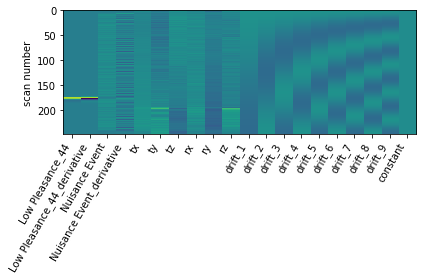

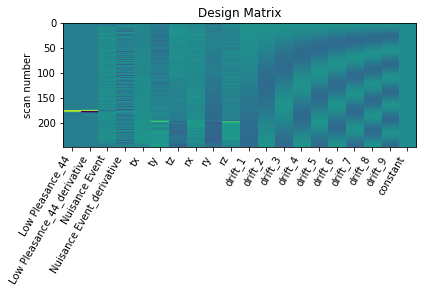

      0         1         2         3         4         5         6      \
0  1.545329 -0.071311  0.578582  0.941915  1.009333  0.472089 -0.087636   

      7         8        9      ...     11447     11448     11449     11450  \
0  0.155083  0.444149  0.01796  ...  0.260848  0.509717 -0.366041 -0.724508   

      11451     11452     11453     11454     11455     11456  
0  0.687511 -0.525492  1.112914 -0.285977  0.682549 -0.664186  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_44
GLM RUN HighPleasance_45


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



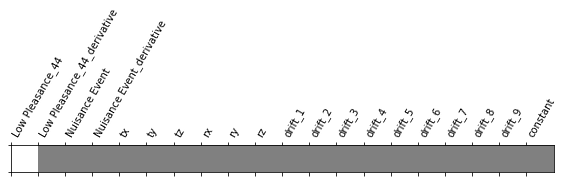

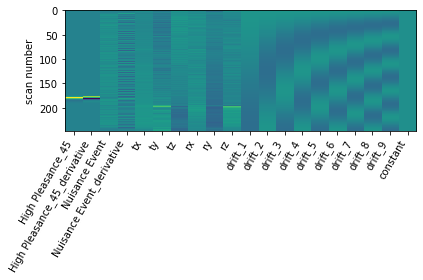

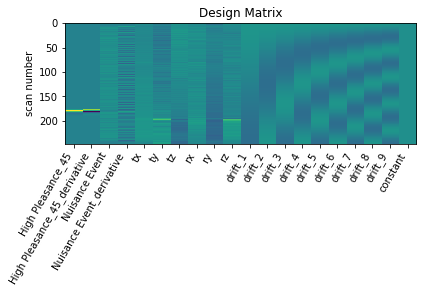

      0         1         2         3         4         5         6      \
0 -0.486691 -0.487797  0.999169  0.825112  0.805807  1.034986  1.389725   

     7         8         9      ...     11447   11448     11449     11450  \
0  1.20234  0.986846  0.646847  ... -2.465188 -2.0849 -2.008249 -0.287442   

      11451     11452     11453     11454     11455     11456  
0 -0.288793 -1.817426  0.131952 -2.003398  0.306316 -2.716694  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_45
GLM RUN LowPleasance_46


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



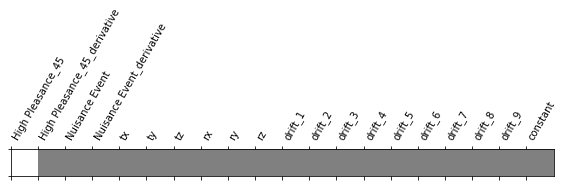

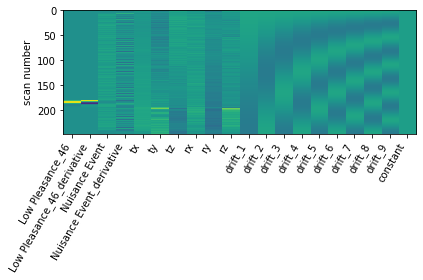

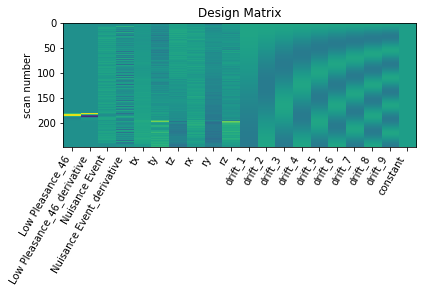

      0         1         2        3         4         5         6      \
0  1.369943 -0.336546  0.988598  0.72035  0.620029  0.942228 -0.009264   

      7         8         9      ...    11447     11448     11449    11450  \
0  0.291425  0.572571  0.216315  ... -0.17262  0.435596 -0.381671  0.28965   

      11451    11452     11453     11454     11455     11456  
0 -0.429573 -0.93277  0.916559 -0.774817 -0.203968 -1.370989  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_46
GLM RUN LowPleasance_47


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



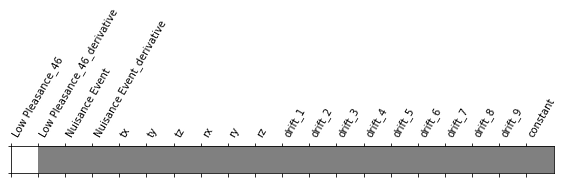

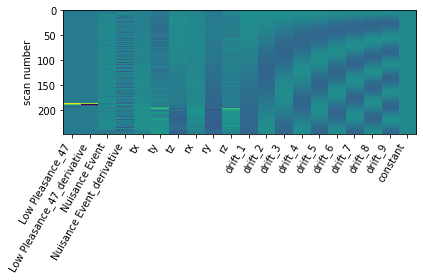

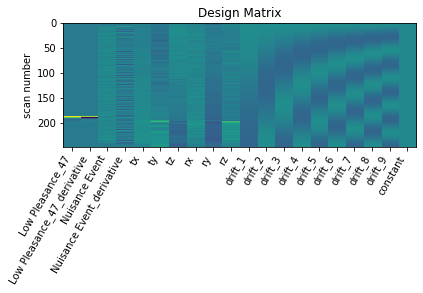

      0         1         2        3        4         5         6      \
0  1.143765 -0.162996  0.939033  0.67148  0.52122  0.848176  1.029875   

     7         8         9      ...     11447     11448     11449     11450  \
0  0.36875  0.464997  0.399939  ...  0.634156 -0.113104  1.212504  0.607587   

      11451     11452     11453     11454     11455     11456  
0  0.367751  1.601823  1.413575  1.505647  1.358348  1.040076  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_47
GLM RUN LowPleasance_48


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



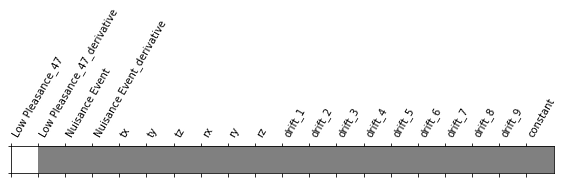

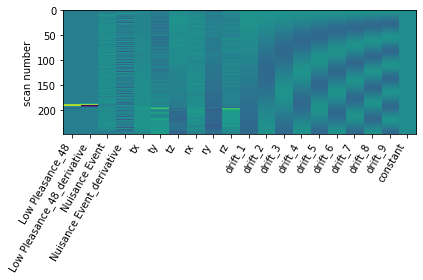

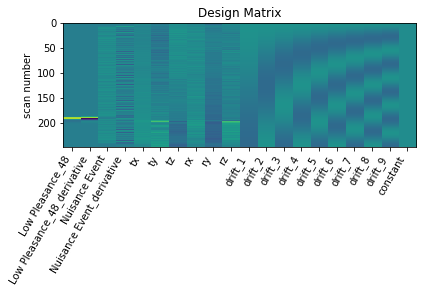

      0         1         2         3        4        5         6      \
0  1.229561  0.193561  1.190507  1.551772  1.57543  3.20909  2.171642   

      7         8        9      ...    11447     11448     11449     11450  \
0  2.591557  2.703151  1.43013  ... -1.08337 -0.369154 -1.132862 -1.131836   

      11451     11452     11453     11454     11455     11456  
0  0.396651 -1.937851  0.950759 -1.236284 -1.569566 -3.038008  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_48
GLM RUN HighPleasance_49


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



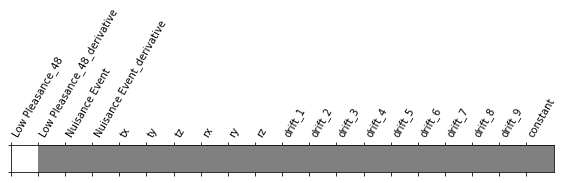

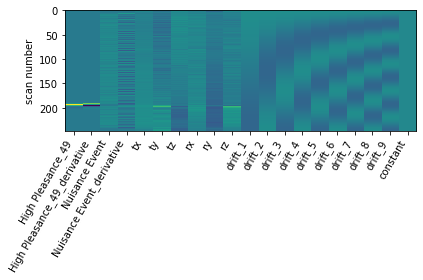

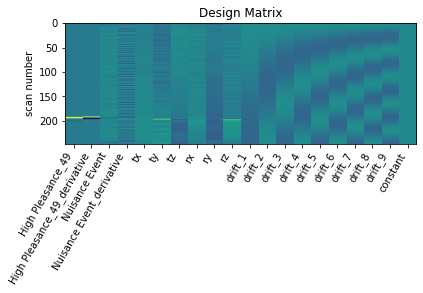

      0        1         2         3         4         5         6      \
0 -1.039014 -1.57897 -0.413471  0.080339  0.281953 -1.763063 -0.869593   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.392884 -1.970944 -0.806835  ... -2.283091 -1.860969 -1.680915 -0.366873   

      11451     11452     11453     11454     11455     11456  
0 -1.999114 -1.806959 -1.212848 -2.404604  0.148877 -3.227987  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_49
GLM RUN LowPleasance_50


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



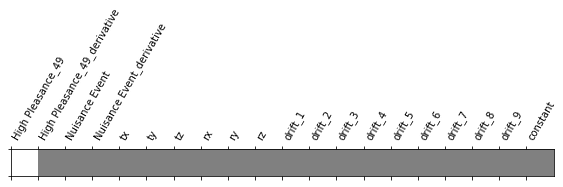

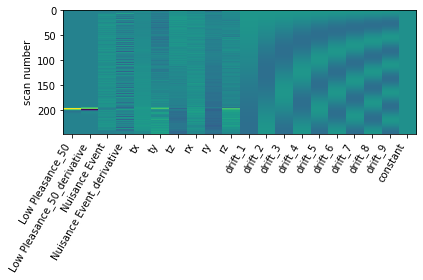

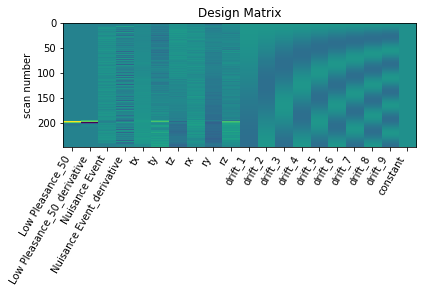

      0         1         2         3         4         5         6      \
0  2.022399 -0.145992  1.999358  1.539397  0.854727  1.742427  2.353503   

      7         8         9      ...     11447     11448     11449     11450  \
0  2.117615  2.132572  2.050107  ...  0.698131  0.233528  0.500212 -1.155596   

      11451     11452     11453     11454     11455   11456  
0  0.403777  0.839428  2.696097  0.512025  0.921751  0.0552  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_50
GLM RUN LowPleasance_51


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



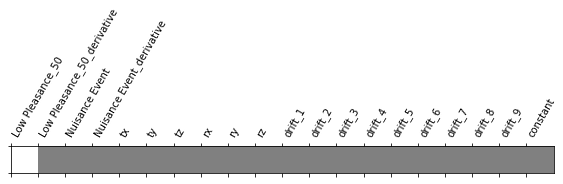

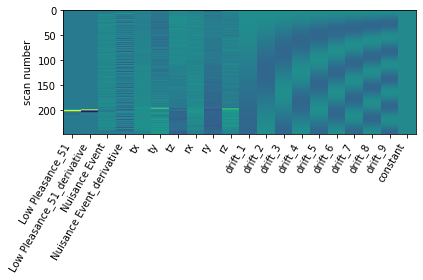

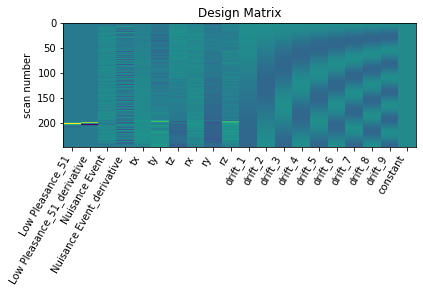

      0         1         2         3         4         5         6      \
0 -2.471926  0.430379 -2.200506 -1.798138 -1.419909 -0.824028 -2.640795   

      7         8         9      ...    11447     11448     11449    11450  \
0 -1.778682 -1.008001 -2.610922  ... -3.08357 -1.855422 -3.499511 -0.17476   

      11451     11452     11453     11454    11455     11456  
0  0.226968 -3.379118 -2.217648 -2.543594 -0.90454 -1.562812  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_51
GLM RUN HighPleasance_52


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



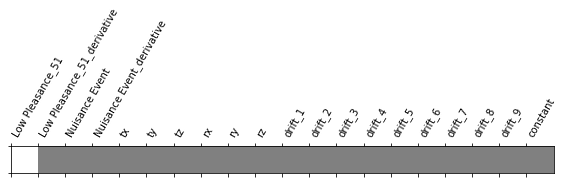

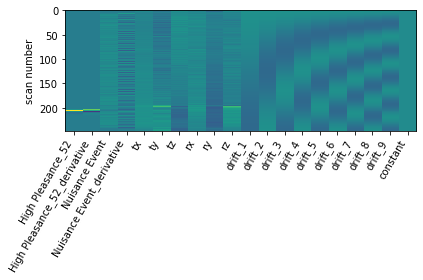

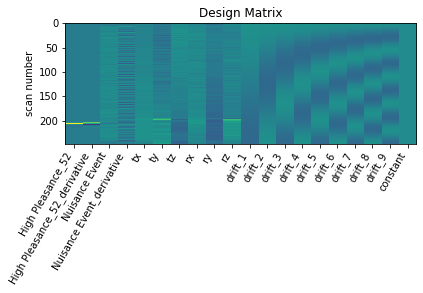

      0         1         2         3        4         5         6      \
0  2.245087  0.642705  3.135215  3.207225  3.04973  0.855947  0.891812   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.827424  0.837075  0.385914  ... -0.690741 -0.241277 -0.409369  0.643847   

     11451     11452     11453     11454     11455     11456  
0  0.44291 -0.740974  1.670304 -0.952155  1.402699 -2.072788  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_52
GLM RUN HighPleasance_53


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



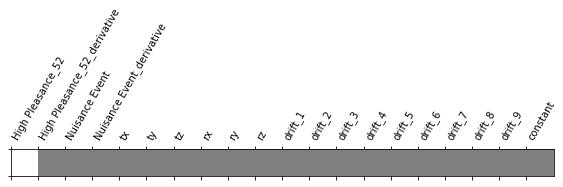

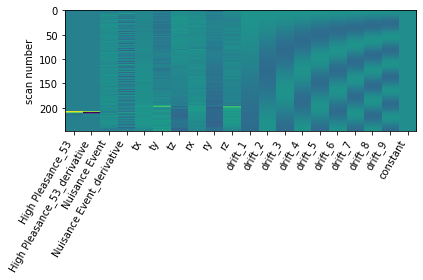

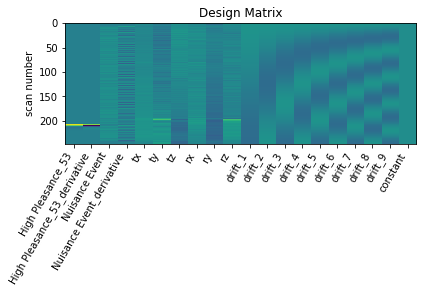

      0         1         2         3         4         5         6      \
0 -0.677929 -0.850706 -0.082846  0.160576  0.159584  0.006691  0.014037   

      7        8         9      ...     11447     11448     11449     11450  \
0 -0.071956 -0.45374 -1.197201  ... -0.880319 -0.959969 -0.773628 -0.480307   

      11451     11452     11453     11454     11455     11456  
0 -0.397237 -1.332089  0.104649 -0.778288 -0.535451 -1.611938  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_53
GLM RUN LowPleasance_54


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



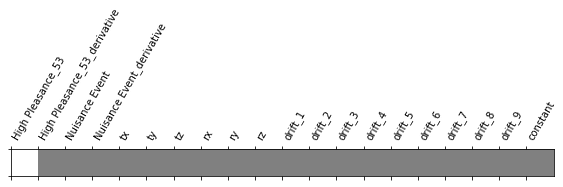

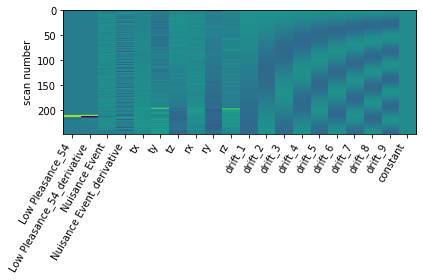

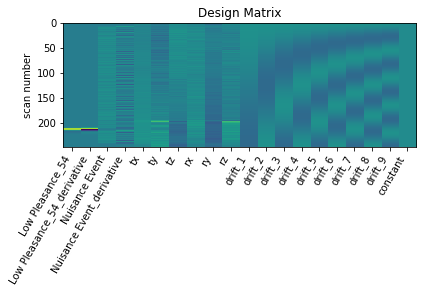

      0         1         2         3         4         5         6      \
0  0.646074 -0.254331  0.328347  0.170803  0.427797  1.004505  1.549588   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.817625  0.681055  1.159689  ... -1.095132  0.088976 -0.841239  0.042441   

      11451     11452     11453     11454     11455   11456  
0 -1.161008 -0.957034  0.763556 -1.196363 -0.599891 -1.2405  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_54
GLM RUN HighPleasance_55


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



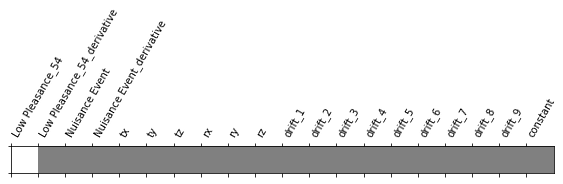

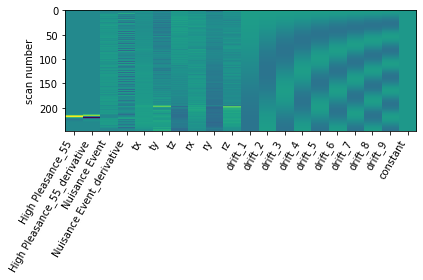

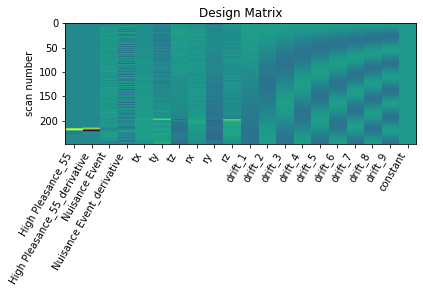

      0         1         2         3         4         5        6      \
0  0.167894 -0.679463  0.613476  0.836369  1.026045  0.859101  0.26905   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.568674  0.849591  0.193662  ... -1.536586 -0.977047 -2.009459  0.285511   

      11451    11452     11453    11454     11455    11456  
0  0.458702 -2.22724 -0.154554 -1.80233  1.058669 -2.55719  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_55
GLM RUN LowPleasance_56


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



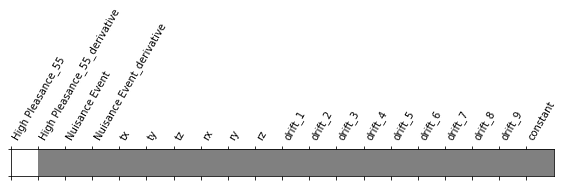

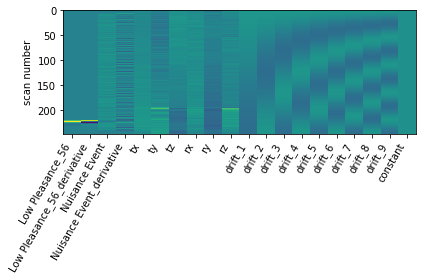

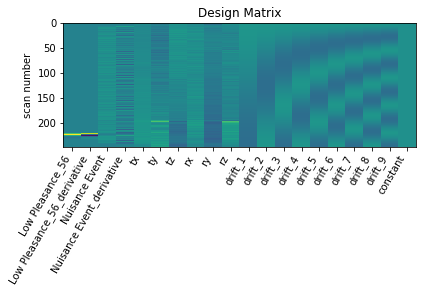

      0         1         2         3         4         5         6      \
0  1.737398  0.129369  1.983802  1.347825  0.938799  0.424152  0.354895   

      7         8        9      ...     11447     11448     11449     11450  \
0 -0.093658 -0.443769 -0.66083  ... -0.469984 -0.116864 -0.251855 -0.222155   

      11451     11452     11453    11454     11455    11456  
0 -1.507592 -0.613894  0.829364 -0.42732  0.359312 -0.61428  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_56
GLM RUN HighPleasance_57


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



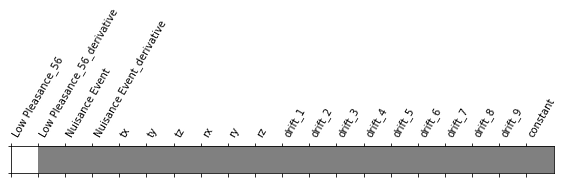

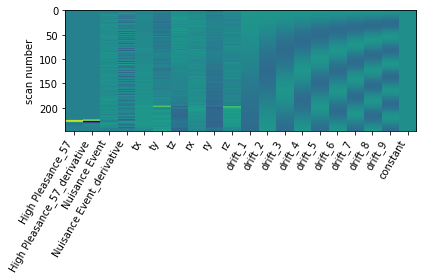

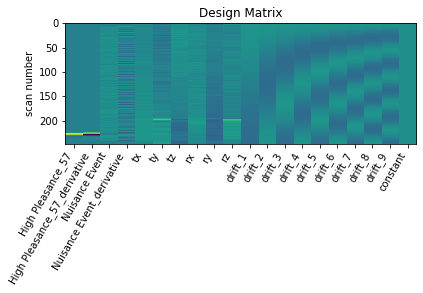

      0        1         2         3         4         5         6      \
0  0.374448 -0.42356  0.129278  0.344836  0.434669  2.382706  0.977962   

      7         8         9      ...     11447     11448     11449     11450  \
0  2.186679  2.911505  1.691434  ... -1.697173 -1.341114 -1.544324 -0.636819   

      11451     11452     11453     11454     11455     11456  
0  1.034195 -1.522251  1.263635 -1.633629  0.387128 -3.221527  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_57
GLM RUN HighPleasance_58


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



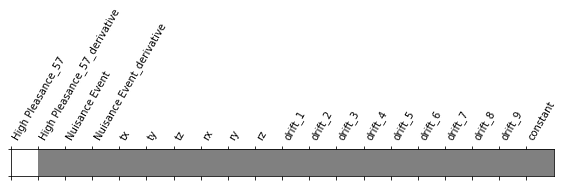

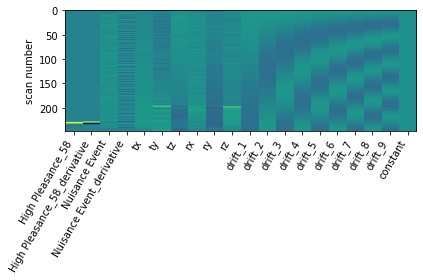

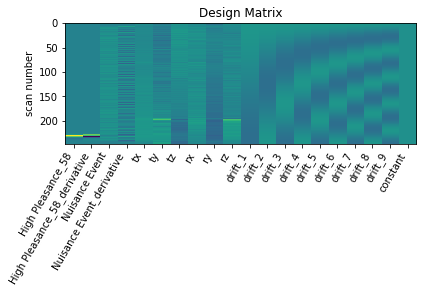

      0         1         2        3         4         5         6      \
0  1.165498  0.022075  1.621016  1.36451  1.155562  0.237776  0.929588   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.451271  0.043606  0.104832  ... -0.155333  0.199458 -0.242447 -0.141588   

      11451     11452     11453     11454     11455     11456  
0 -1.033581 -0.598121  0.481369 -0.258864 -0.804718 -1.023931  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_58
GLM RUN LowPleasance_59


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



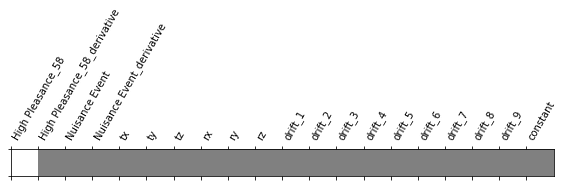

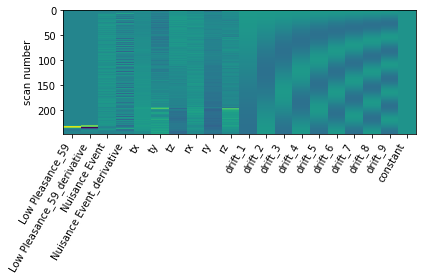

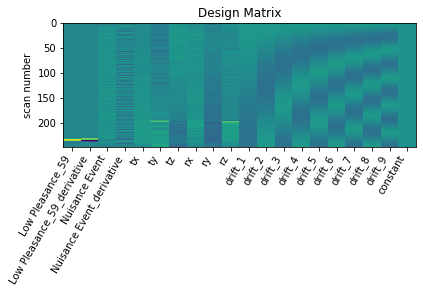

      0         1        2         3         4         5         6      \
0  1.763958 -0.553353  0.31517 -0.131676 -0.139484  1.360449  0.611759   

     7         8         9      ...     11447     11448     11449     11450  \
0  0.92883  1.295639  0.823214  ... -0.817764 -0.495627 -0.682939  1.215079   

      11451     11452    11453    11454     11455     11456  
0  0.597578 -0.469011  1.98443 -0.63742  0.794397 -1.803991  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_59
GLM RUN LowPleasance_60


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



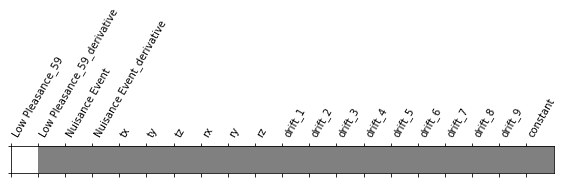

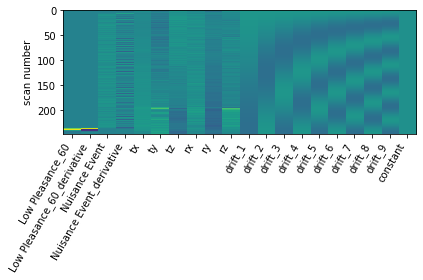

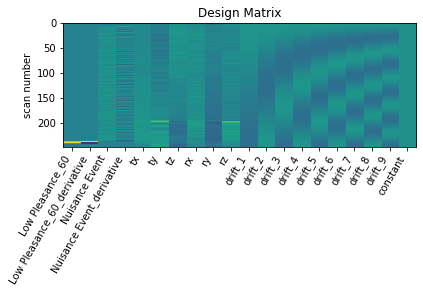

      0         1         2         3         4         5         6      \
0  0.093696  0.161751  0.304107  0.425517  0.352264  1.082714  0.607059   

      7         8         9      ...     11447     11448    11449     11450  \
0  0.621203  0.656694 -0.062211  ... -2.423167 -1.572285 -2.48717 -1.198738   

      11451     11452     11453     11454     11455     11456  
0 -1.383353 -2.164959 -0.549507 -2.395414 -0.795327 -1.967049  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_60


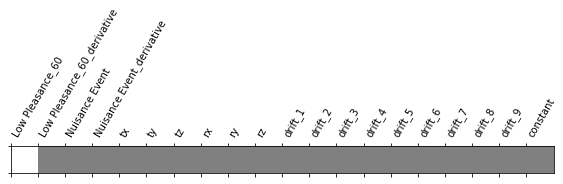

In [ ]:
y_fa_pa, X_fa_pa = lss_separate_method_comp(task =task,
                          data_path=data_path,
                          events_path=events_path,
                          motion_param_path=motion_param_path,
                          cache_mem_path=cache_mem_path,
                          activity_mat_saving_path=activity_mat_saving_path,
                          analysis_type=analysis_type,
                          param_modulation=False,
                          t_r=t_r,
                          drift_model=drift_model,
                          drift_order=drift_order,
                          hrf_model=hrf_model,
                          pre_whitening_spec=pre_whitening_spec,
                          apply_trans_mask=apply_trans_mask,
                          roi_img=roi_img,  
                          hpf_cut=hpf_cut,
                          smoothing_fwhm=smoothing_fwhm,
                          standardize=standardize,
                          detrend=detrend,minimize_memory=minimize_memory)

In [ ]:
y_g.append(y_fa_pa)
X_g.append(X_fa_pa)

In [ ]:
X_fa_pa.shape

(60, 11457)

### Food Task

### Run AP

In [ ]:
data_path = 'ses-19/func/wrdcsub-01_ses-19_task-PreferenceFood_dir-ap_bold.nii.gz'
events_path = 'ses-19/func/sub-01_ses-19_task-PreferenceFood_dir-ap_events.tsv'
motion_param_path = 'ses-19/func/rp_dcsub-01_ses-19_task-PreferenceFood_dir-ap_bold.txt'
task = 'Food'

In [ ]:
analysis_type = 'High_Low_Pleasance'
hrf_model = 'spm + derivative'
param_modulation = False
drift_model='cosine'
t_r=2
drift_order=None
apply_trans_mask=True
roi_img = mask_img
standardize=True
detrend=True
minimize_memory = True
activity_mat_saving_path = 'mvpa/test2'

events = pd.read_csv(events_path,sep='\t')

# onset shift in order to capture the very moment of the appreciation decision
events['onset'] = events['onset']-1

onset_periods = [events['onset'][i+1] - events['onset'][i]  for i in range(len(events['onset']))if (i<len(events['onset'])-1)]
onset_periods = np.array(onset_periods)
onset_freq = np.reciprocal(onset_periods)
hpf_cut = np.min(onset_freq)/2 # cf High Pass Filtering Rule of Thumb ( fMRI Handbook 2011)

Event 0
      onset  duration       trial_type
0     7.541     4.245  Low Pleasance_1
1    13.807     5.898   Nuisance Event
2    22.989     6.784   Nuisance Event
3    31.521     5.695   Nuisance Event
4    40.303     5.471   Nuisance Event
5    48.252     4.440   Nuisance Event
6    56.368     5.275   Nuisance Event
7    63.783     3.720   Nuisance Event
8    70.849     9.064   Nuisance Event
9    84.330     5.197   Nuisance Event
10   91.813     3.329   Nuisance Event
11   97.079     5.540   Nuisance Event
12  106.977     4.129   Nuisance Event
13  115.343     3.390   Nuisance Event
14  120.209     3.056   Nuisance Event
15  123.792     2.844   Nuisance Event
16  127.991     3.701   Nuisance Event
17  134.907     6.151   Nuisance Event
18  144.605     2.691   Nuisance Event
19  150.438     3.533   Nuisance Event
20  157.587     6.355   Nuisance Event
21  165.136     2.378   Nuisance Event
22  170.202     4.999   Nuisance Event
23  178.951     5.033   Nuisance Event
24  186.733     5

59  420.017     4.754     Nuisance Event
Event 55
      onset  duration         trial_type
0     7.541     4.245     Nuisance Event
1    13.807     5.898     Nuisance Event
2    22.989     6.784     Nuisance Event
3    31.521     5.695     Nuisance Event
4    40.303     5.471     Nuisance Event
5    48.252     4.440     Nuisance Event
6    56.368     5.275     Nuisance Event
7    63.783     3.720     Nuisance Event
8    70.849     9.064     Nuisance Event
9    84.330     5.197     Nuisance Event
10   91.813     3.329     Nuisance Event
11   97.079     5.540     Nuisance Event
12  106.977     4.129     Nuisance Event
13  115.343     3.390     Nuisance Event
14  120.209     3.056     Nuisance Event
15  123.792     2.844     Nuisance Event
16  127.991     3.701     Nuisance Event
17  134.907     6.151     Nuisance Event
18  144.605     2.691     Nuisance Event
19  150.438     3.533     Nuisance Event
20  157.587     6.355     Nuisance Event
21  165.136     2.378     Nuisance Event
22  170

Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



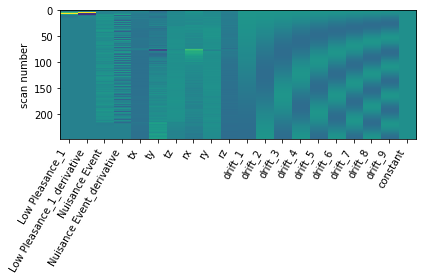

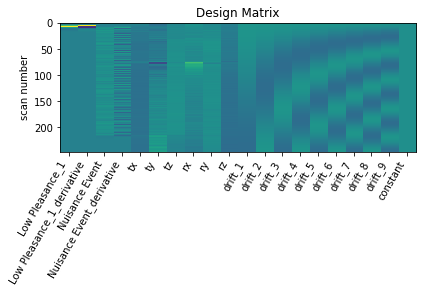

    0         1        2        3         4         5         6         7      \
0 -0.8317  0.785881  2.34725  2.16967  1.665882  1.366138  0.931757  1.262622   

      8         9      ...     11447     11448     11449     11450     11451  \
0  1.812426  1.018041  ... -1.503203 -1.295862 -1.739709 -1.334828  0.536748   

      11452     11453     11454     11455     11456  
0 -1.032562  0.179421 -1.270836 -1.294484 -1.115377  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_1
GLM RUN LowPleasance_2


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



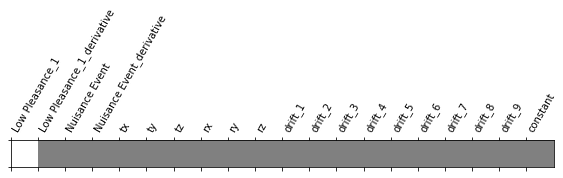

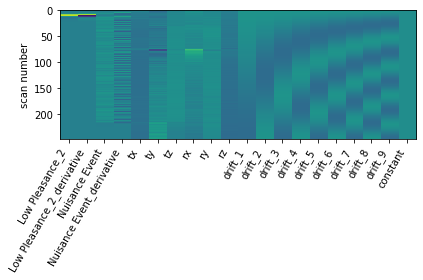

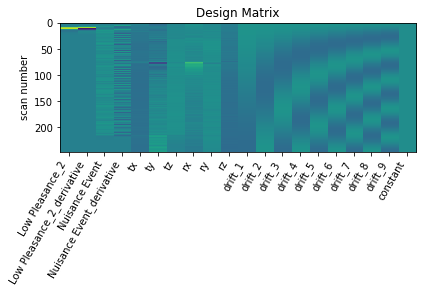

      0         1         2         3         4         5         6      \
0  1.446417 -1.291148 -1.291531 -0.335736  0.600863  0.384211 -0.405592   

    7         8         9      ...    11447     11448    11449     11450  \
0  0.3471  0.324527  1.644628  ... -1.20977 -0.503537 -1.10893 -0.493524   

     11451     11452     11453     11454    11455     11456  
0  0.93643 -0.271425  0.682001 -2.115794  0.51462 -0.337357  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_2
GLM RUN LowPleasance_3


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



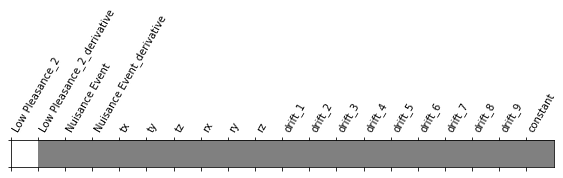

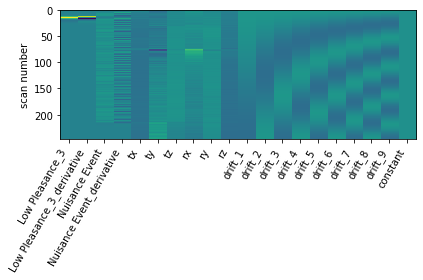

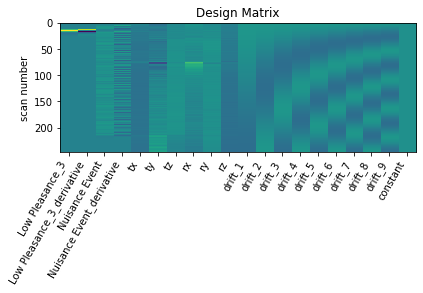

      0         1       2         3         4         5         6      \
0  1.106015  0.975843  1.2508  1.879628  2.218527  1.367032  0.486798   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.262707  1.390926  1.398555  ... -0.410326  0.208635  0.099489  1.423082   

      11451     11452     11453     11454    11455     11456  
0  0.430054  0.966759  2.135067 -1.265285 -0.08132 -0.572236  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_3
GLM RUN HighPleasance_4


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



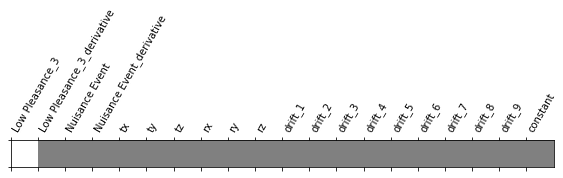

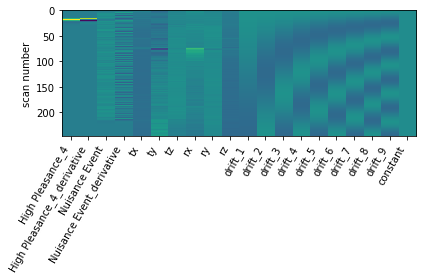

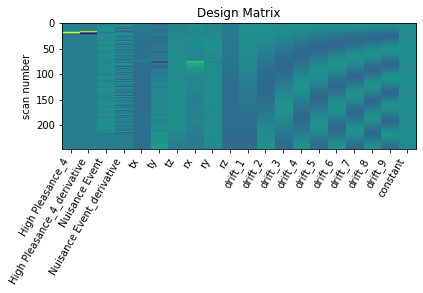

      0         1         2         3         4         5         6      \
0  0.367732 -2.717093  0.039103  0.107471  0.200398  0.831995 -0.718384   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.223529  0.482604  0.922838  ... -3.045586 -2.628413 -3.139965 -0.576223   

      11451     11452     11453    11454     11455     11456  
0  0.659536 -2.523158  0.423417 -2.85518 -0.492974 -0.770683  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_4
GLM RUN LowPleasance_5


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



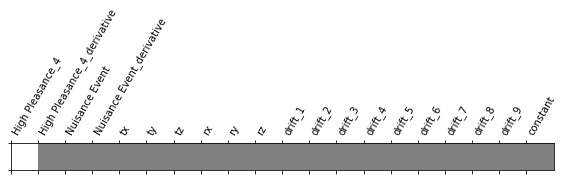

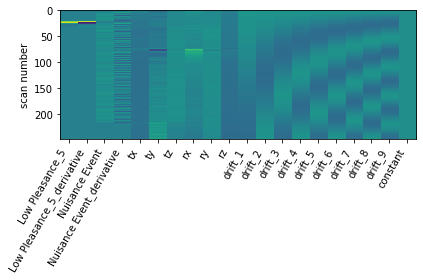

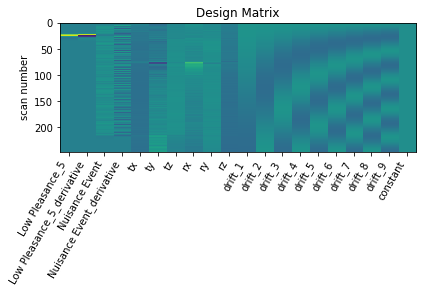

      0         1         2         3         4         5         6      \
0  1.483005  1.010807 -0.652658  0.858031  1.937796  0.196959 -0.781497   

     7         8         9      ...     11447     11448     11449     11450  \
0  0.36416  0.508337  1.350621  ... -0.918297 -0.505809 -0.604862 -0.440331   

      11451    11452    11453     11454     11455     11456  
0  1.979062  1.08136 -0.18449 -0.955952  1.158216 -0.549223  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_5
GLM RUN HighPleasance_6


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



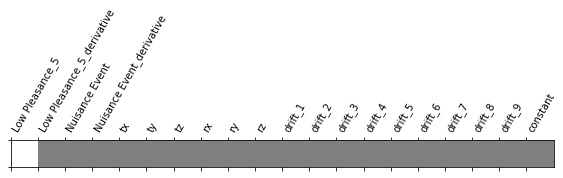

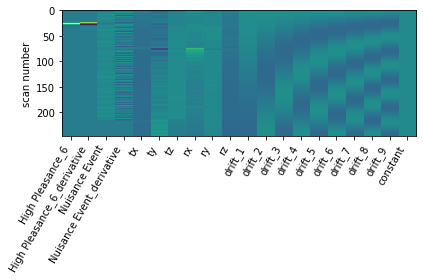

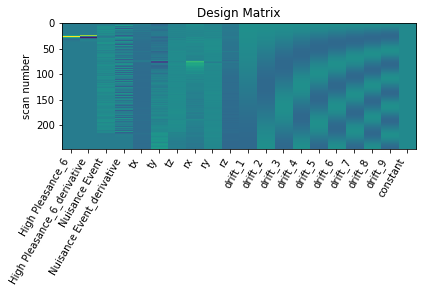

      0        1         2         3         4        5         6      \
0  0.383685 -1.41447 -1.040793 -0.540233  0.147262 -0.28904 -1.045894   

      7         8         9      ...     11447    11448     11449     11450  \
0 -1.473504 -1.051622 -0.592015  ... -2.393073 -2.57869 -2.093124 -0.820797   

      11451     11452     11453     11454    11455     11456  
0  0.218787 -2.404108 -0.806305 -0.053919 -0.56435 -0.342964  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_6
GLM RUN LowPleasance_7


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



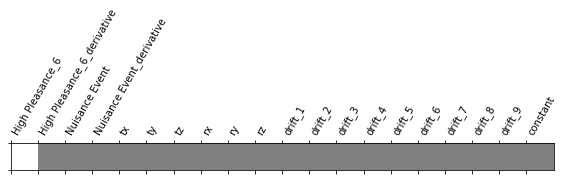

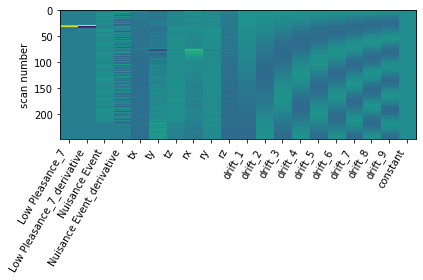

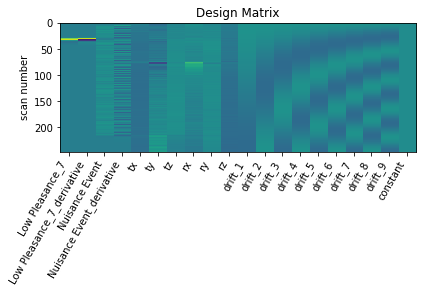

      0         1         2         3         4         5         6      \
0  0.937922 -1.244032  0.868272  1.145259  1.474552 -0.256261  0.039629   

      7         8         9      ...     11447  11448     11449     11450  \
0  0.170037 -0.068166  1.110292  ... -2.342833 -2.249 -1.501942 -1.818885   

      11451     11452    11453     11454     11455     11456  
0  0.911366 -0.402219  0.48916 -2.172712  0.462991 -0.282925  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_7
GLM RUN LowPleasance_8


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



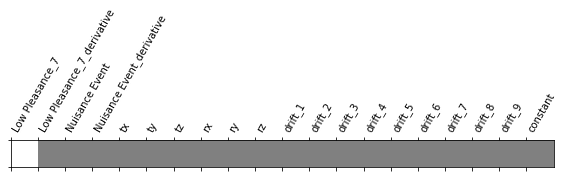

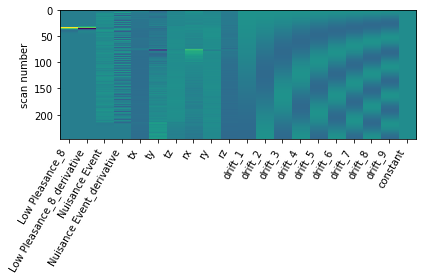

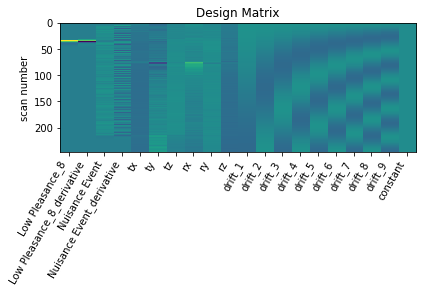

      0         1         2         3         4         5         6      \
0  1.728597  1.789053  0.505029  1.132949  1.792706  2.108444  0.082543   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.137932  1.666196  1.610434  ...  0.147839  0.331521  0.036768  0.015296   

      11451    11452     11453     11454     11455     11456  
0  0.721896 -0.11168 -0.032163 -0.305267  0.511387 -2.142206  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_8
GLM RUN HighPleasance_9


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



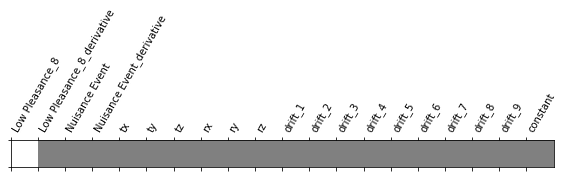

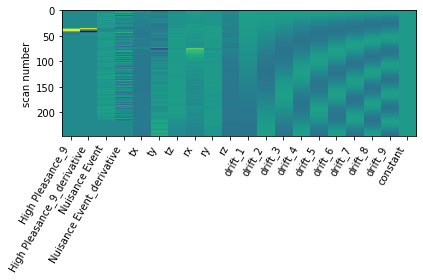

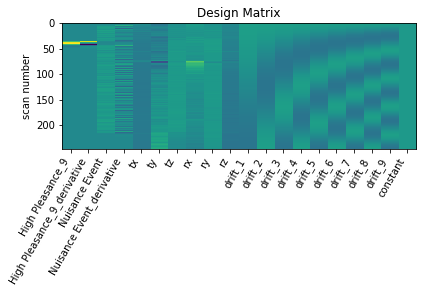

      0         1         2         3         4         5         6      \
0 -0.855588 -2.652572  0.264935  0.728839  1.447276  0.940414  0.106091   

      7         8         9      ...    11447     11448     11449     11450  \
0  0.596282  0.696535  0.701365  ... -3.66159 -2.745407 -2.914981 -0.400697   

      11451     11452     11453     11454     11455     11456  
0  0.318684 -1.515127  1.523055 -4.045942 -0.658062 -0.320458  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_9
GLM RUN LowPleasance_10


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



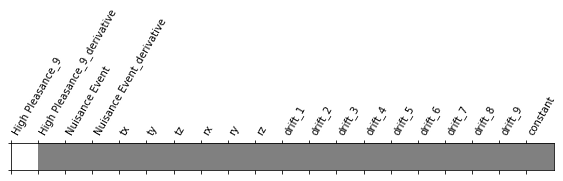

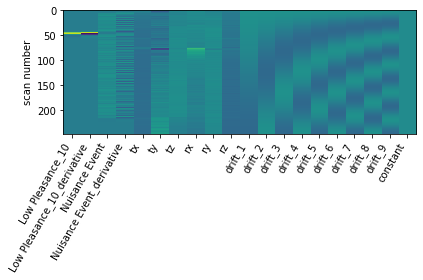

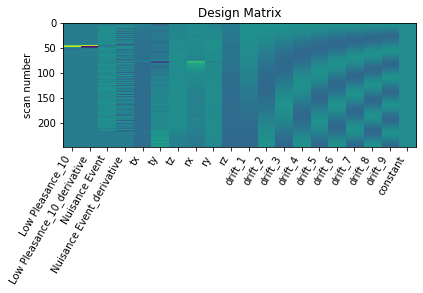

      0         1        2         3         4         5         6      \
0  2.894653  1.938556 -0.00021  1.210155  2.064487  1.262493  0.009954   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.471753  1.748351  2.777915  ... -0.129322  0.153716 -0.261699  0.121576   

     11451     11452    11453     11454     11455     11456  
0  1.48914  0.167725  1.31059 -0.791889  0.675873 -2.331301  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_10
GLM RUN HighPleasance_11


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



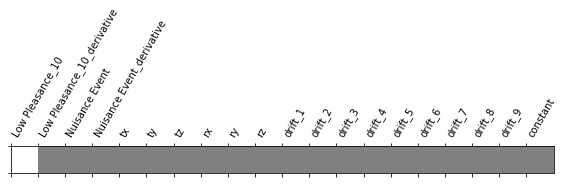

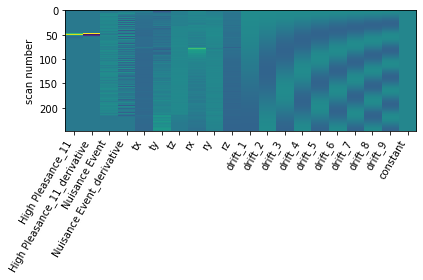

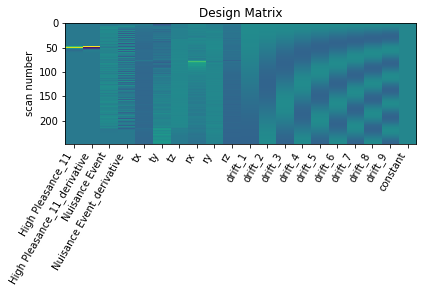

      0         1         2        3         4         5         6      \
0 -1.895069 -1.161858 -0.408357 -0.47543 -0.437467 -1.537826 -1.694001   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.696997 -1.926395 -2.152067  ... -2.228682 -2.166929 -1.165853 -0.906841   

      11451     11452     11453     11454     11455     11456  
0 -0.189356 -0.562987 -0.071888 -1.179778  2.733091  1.195303  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_11
GLM RUN LowPleasance_12


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



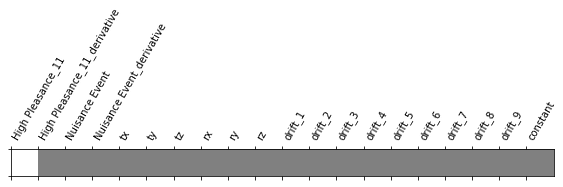

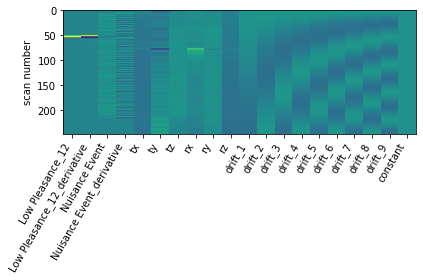

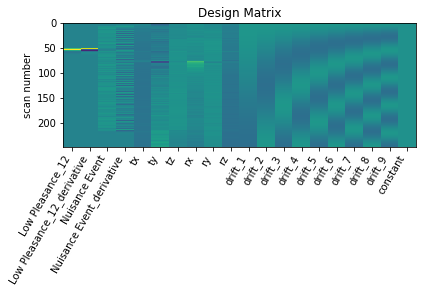

      0         1         2         3         4         5         6      \
0  2.265617 -0.536846 -0.298755  0.463168  1.179324  0.205698 -0.356912   

     7         8         9      ...     11447     11448     11449     11450  \
0 -0.49417 -0.182556  1.463005  ... -2.753756 -2.345868 -2.459661 -0.332486   

      11451     11452     11453     11454     11455     11456  
0  1.029208 -1.893999  0.312729 -2.319137 -1.220376 -1.272097  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_12
GLM RUN HighPleasance_13


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



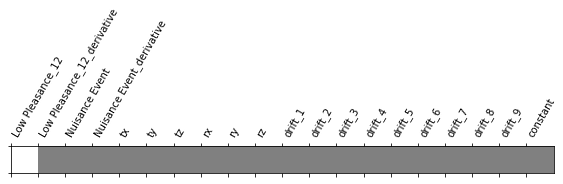

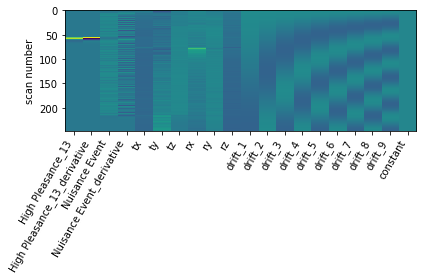

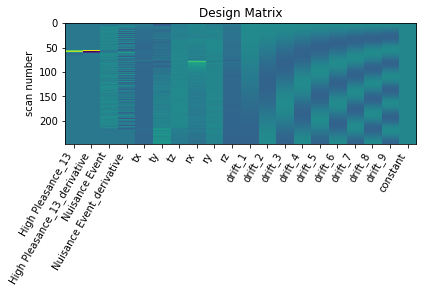

      0         1         2         3         4        5         6      \
0  0.200849 -0.044748  1.184971  1.675475  1.613409  1.06294  0.040458   

    7         8         9      ...     11447     11448     11449     11450  \
0  0.9762  1.543041  1.252281  ... -0.385288  0.296866 -0.614402 -0.031661   

      11451     11452     11453     11454     11455     11456  
0  0.071126 -0.233564  0.977451 -1.050832  1.067063 -0.107631  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_13
GLM RUN LowPleasance_14


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



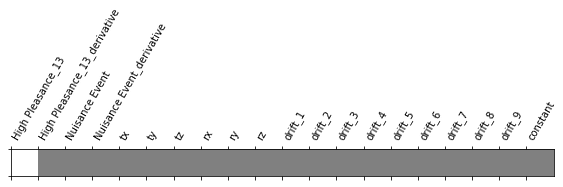

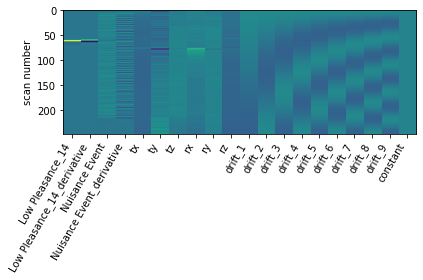

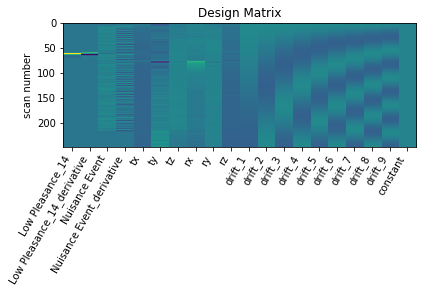

     0         1        2         3         4        5         6        7      \
0  0.23656 -0.436199 -0.39073 -0.059002  0.746023 -1.12298  0.155315  0.57508   

      8        9      ...     11447    11448    11449     11450     11451  \
0 -0.259817  0.89322  ... -1.771346 -2.10171 -1.04276 -2.036841  0.549487   

      11452     11453     11454     11455     11456  
0 -0.386617 -0.802029 -1.644349 -1.362438 -1.030357  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_14
GLM RUN HighPleasance_15


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



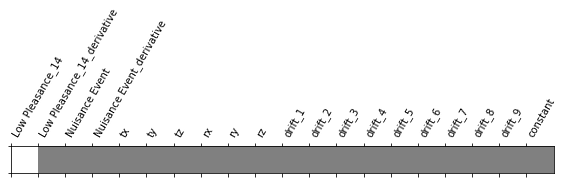

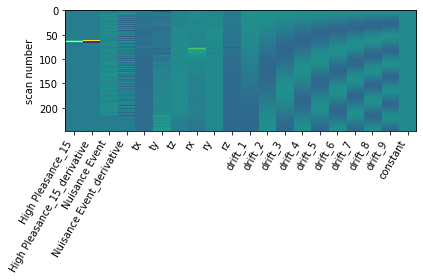

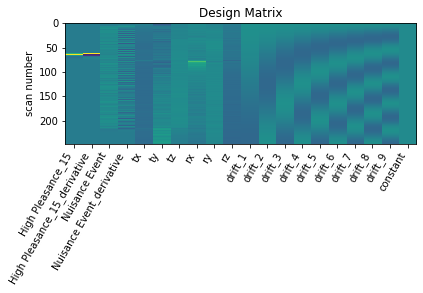

      0         1         2         3         4         5         6      \
0  1.573197 -0.237077  0.972105  1.841454  2.222624  1.603207 -0.285686   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.245365  1.158432  0.711695  ... -1.056096 -1.086413 -1.042135  0.508961   

      11451     11452    11453     11454     11455     11456  
0  1.617107 -0.395526  0.91768 -0.908427 -1.163204 -1.946236  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_15
GLM RUN HighPleasance_16


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



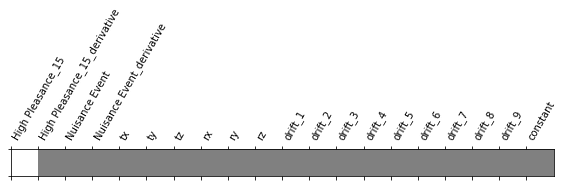

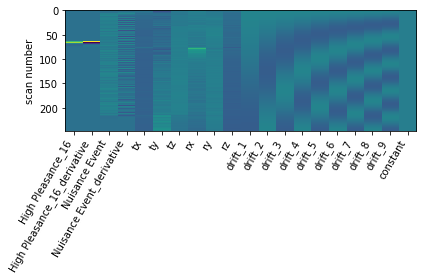

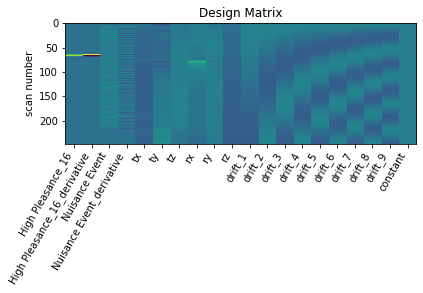

      0         1         2         3         4         5         6      \
0  1.153002  0.230792 -0.111998  0.482601  0.794294  2.004483  0.538371   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.612238  1.161755  0.434045  ... -1.005634 -0.267354 -1.315037  0.604888   

      11451     11452     11453     11454     11455     11456  
0  1.222863 -0.919951  0.264105 -0.715577  0.118249 -0.208789  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_16
GLM RUN HighPleasance_17


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



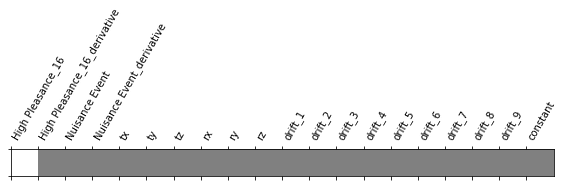

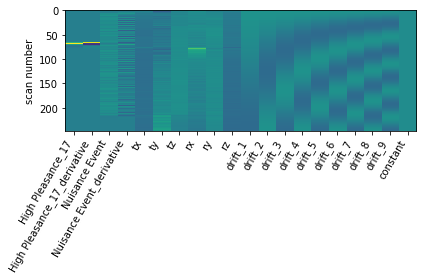

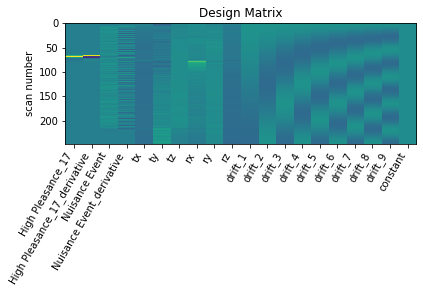

      0         1         2         3         4         5         6      \
0 -0.071829 -0.340987 -0.074943  0.363402  1.132476  0.383673  0.404123   

      7         8         9      ...     11447    11448     11449     11450  \
0  0.860066  0.717171  1.604267  ... -0.339844 -0.01683 -0.683539  1.019241   

      11451     11452     11453    11454     11455     11456  
0  0.156219  0.880995  1.082279 -0.74786  0.611009  1.143811  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_17
GLM RUN HighPleasance_18


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



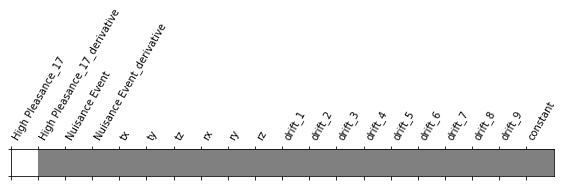

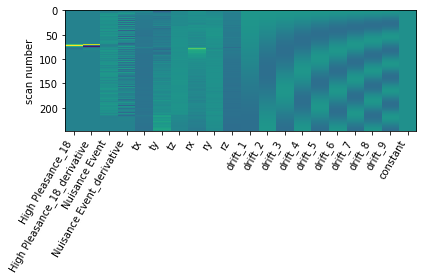

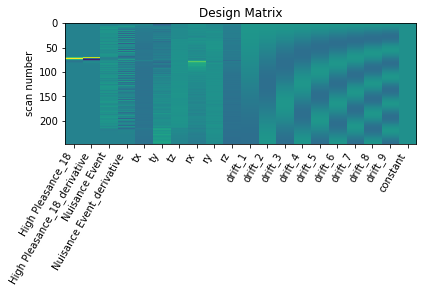

      0         1         2         3         4         5        6      \
0  0.781275 -0.539156  0.144271  0.471944  0.536663  0.738078 -0.91249   

     7         8         9      ...     11447     11448     11449     11450  \
0 -0.17928  0.231849  0.297619  ... -3.645872 -3.207544 -1.918812 -0.927416   

      11451     11452     11453     11454     11455     11456  
0  0.879964 -1.015532 -0.632156 -2.946045 -0.808537 -1.661373  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_18
GLM RUN LowPleasance_19


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



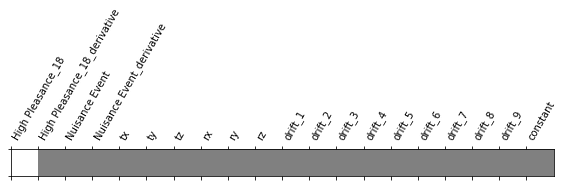

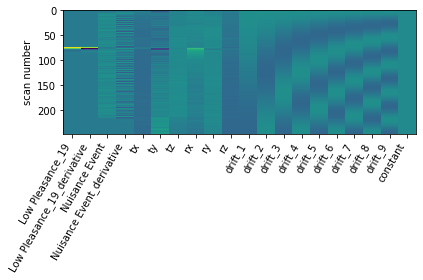

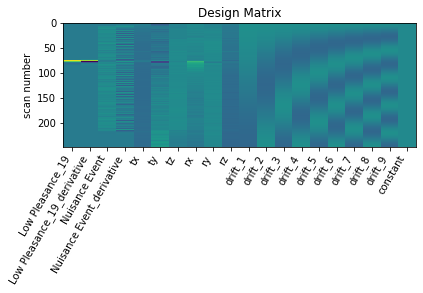

     0         1         2         3         4         5         6      \
0  1.45425  0.229117  0.708036  1.069148  1.579988  0.799688 -0.902007   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.092591  0.943316  1.169923  ... -0.652504 -0.587128 -1.102439 -1.119547   

      11451     11452     11453     11454  11455     11456  
0  0.243603 -1.425247 -0.684714 -0.167427  0.944 -1.585148  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_19
GLM RUN HighPleasance_20


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



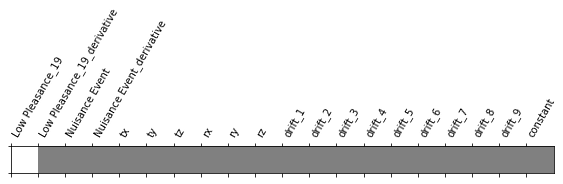

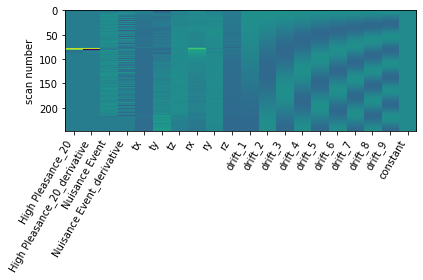

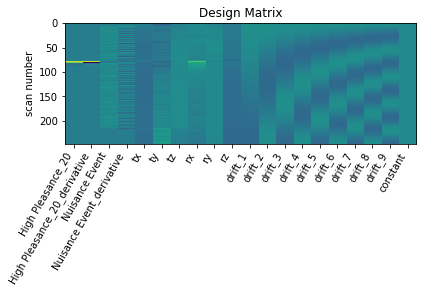

      0         1       2        3         4        5         6        7      \
0  0.797518  0.905614  2.6285  2.69492  2.765666  2.66844  1.995677  3.01009   

      8         9      ...     11447     11448     11449     11450   11451  \
0  3.521909  2.345402  ...  1.726588  1.628456  1.039699  0.925765 -2.2119   

      11452     11453     11454     11455     11456  
0 -0.650573  2.177142  0.521562  1.183494 -0.137475  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_20
GLM RUN HighPleasance_21


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



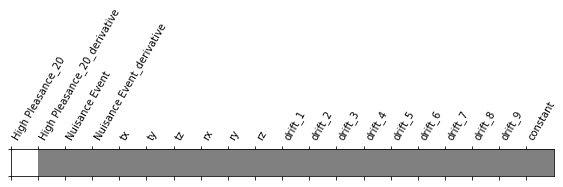

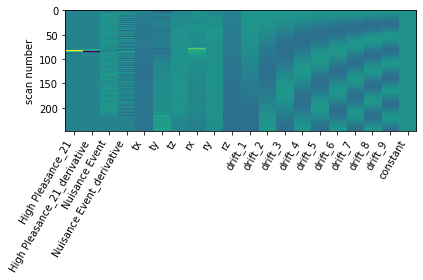

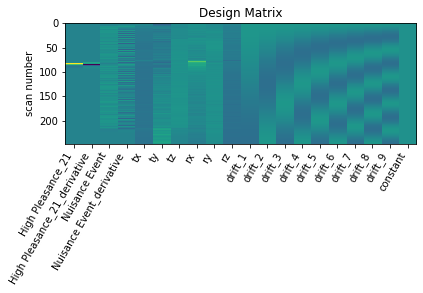

      0         1         2         3         4         5         6      \
0  0.245253 -0.866766 -1.881584 -1.375376 -0.800362 -3.174913 -2.462505   

      7         8         9      ...     11447     11448     11449     11450  \
0 -2.152624 -2.622753 -0.031271  ... -3.750257 -3.345388 -2.596712 -1.942477   

      11451     11452    11453     11454     11455     11456  
0  2.302652 -1.494381 -1.01396 -2.689511 -0.145969 -0.964049  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_21
GLM RUN HighPleasance_22


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 27 seconds



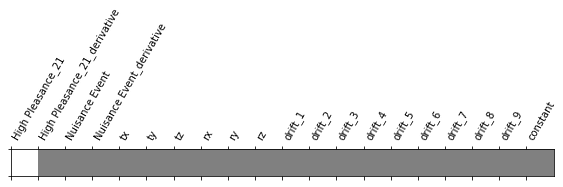

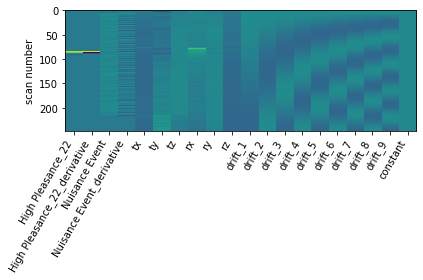

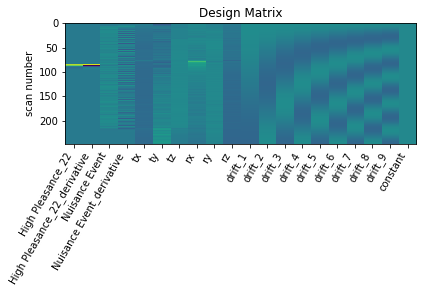

     0         1         2         3         4         5         6      \
0  2.51448  1.015689  0.727881  0.643848  0.831564  1.540288  0.806851   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.277812  1.626203  2.437514  ...  0.311833  0.922059 -0.603224  0.352492   

      11451     11452     11453     11454     11455    11456  
0  1.404515 -0.164594  1.266892 -0.622785 -0.194981 -0.33839  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_22
GLM RUN LowPleasance_23


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 27 seconds



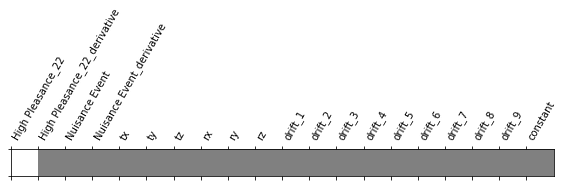

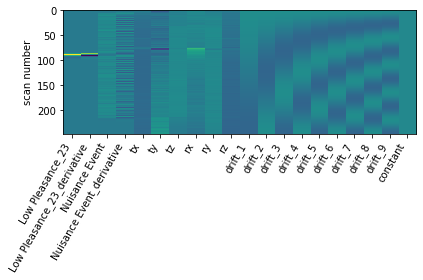

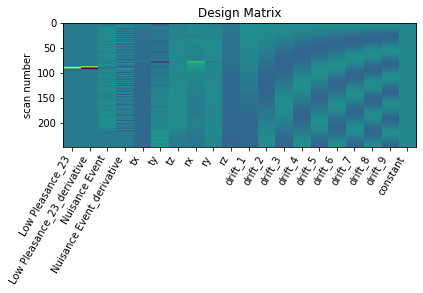

      0         1         2         3         4         5         6      \
0 -1.223602 -1.477371 -0.166897  1.026565  1.714312 -0.395914 -1.646054   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.444283 -1.213669 -1.405899  ... -2.089441 -2.007368 -2.120061 -1.303689   

      11451     11452    11453     11454     11455     11456  
0 -0.649646 -0.655776  0.26141 -1.874938  0.674791 -0.471862  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_23
GLM RUN LowPleasance_24


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



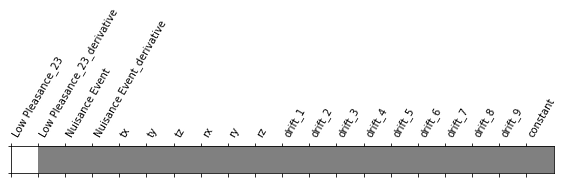

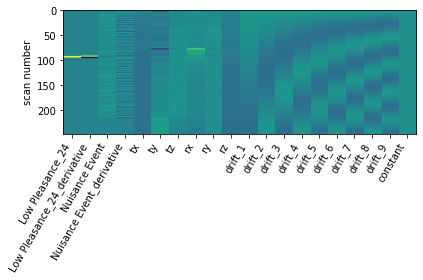

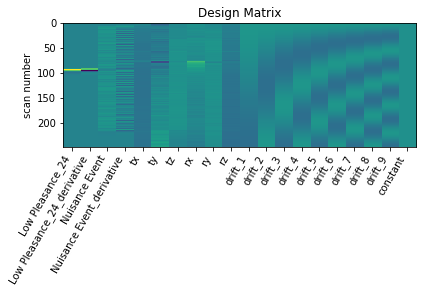

      0         1         2         3         4         5         6      \
0  2.550907  0.061302 -0.024136  0.479417  1.148928  0.916205  1.516206   

      7         8         9      ...     11447     11448    11449     11450  \
0  2.057208  1.734148  2.854299  ... -1.354541 -0.863331 -0.35749  0.187782   

      11451     11452     11453     11454     11455     11456  
0  0.790029 -0.391612  0.667502 -1.486771 -1.488289 -2.050505  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_24
GLM RUN HighPleasance_25


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



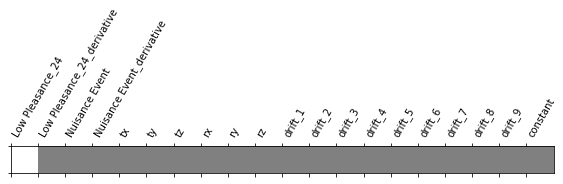

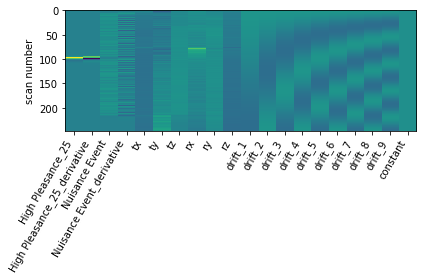

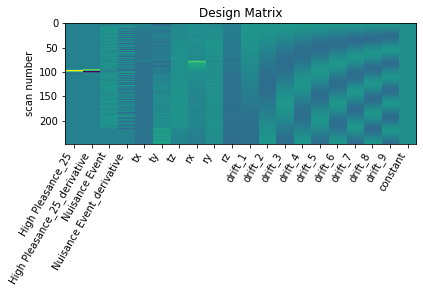

      0         1         2         3        4         5         6      \
0 -0.213242 -1.469299 -0.641121 -0.082349  0.51717  0.783057 -1.892465   

      7        8         9      ...     11447     11448     11449     11450  \
0 -1.182698 -0.35681 -0.475715  ... -3.235579 -2.809918 -3.302124 -0.971139   

      11451     11452     11453     11454    11455     11456  
0  2.231715 -1.434146  0.318565 -2.868291  0.13165  0.177765  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_25
GLM RUN HighPleasance_26


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



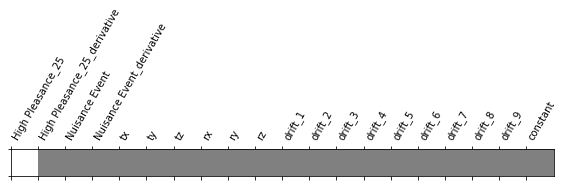

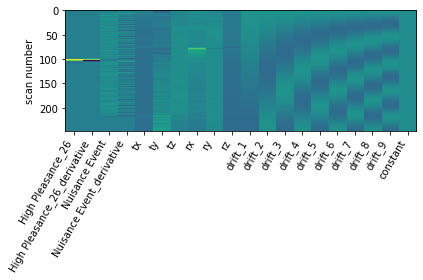

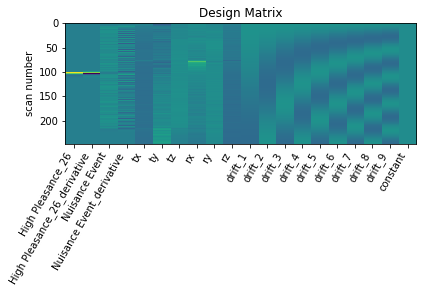

      0         1         2         3         4         5         6      \
0  1.221611  0.250466  0.500707  1.311051  2.013315  1.199969  0.736696   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.372556  1.380108  1.970027  ... -0.591377 -0.266295 -0.279158  0.680534   

     11451     11452    11453     11454    11455     11456  
0 -1.16467  0.342043  0.56847 -1.344771  0.28619 -1.660387  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_26
GLM RUN HighPleasance_27


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



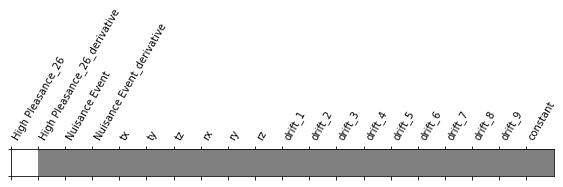

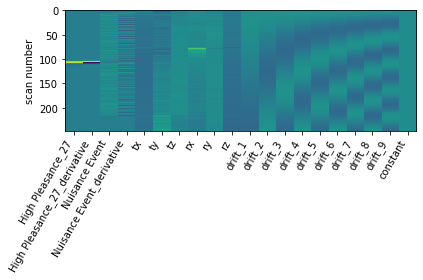

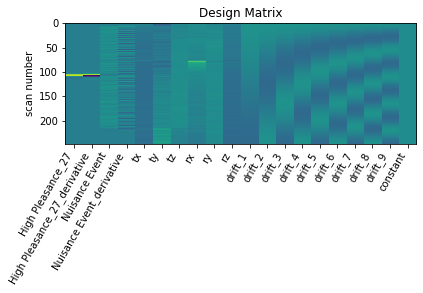

     0         1         2         3         4         5         6      \
0  1.20359 -0.549514 -0.003728  0.779952  1.525495  0.654439  0.571002   

      7         8         9      ...     11447     11448     11449    11450  \
0  0.646332  0.339123  1.064302  ... -2.690281 -2.281168 -2.283792 -0.30933   

      11451     11452   11453     11454     11455     11456  
0  1.821495 -1.712839  0.4864 -2.347555 -0.900309 -0.100992  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_27
GLM RUN LowPleasance_28


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



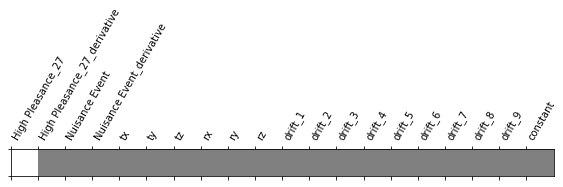

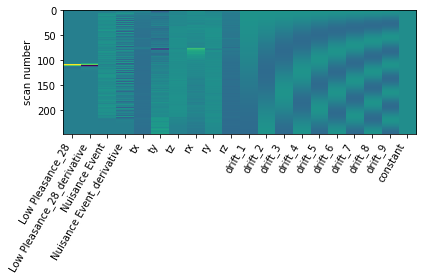

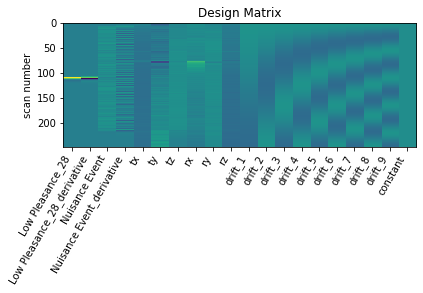

      0         1         2        3         4         5         6      \
0  0.159797 -1.217658  0.268983  0.18038  0.078018  0.159298 -1.790014   

      7         8         9      ...     11447     11448     11449    11450  \
0 -0.706536  0.229674 -0.013815  ... -1.315334 -1.202923 -0.808955 -0.95309   

      11451     11452     11453     11454     11455     11456  
0  0.063825 -0.057046 -0.551769 -0.736789  1.110506 -0.880965  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_28
GLM RUN HighPleasance_29


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



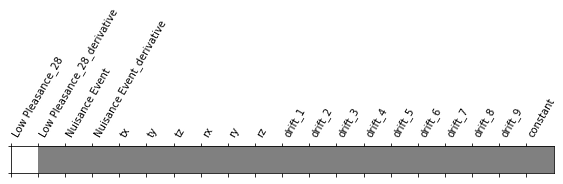

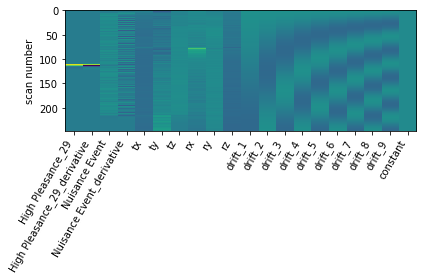

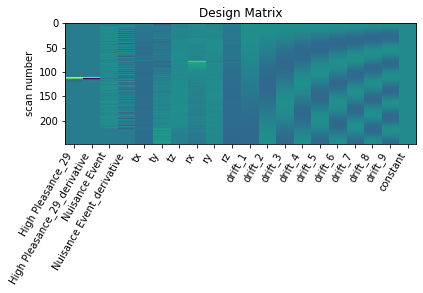

      0        1         2        3         4         5         6      \
0  0.092129  0.12898 -0.694359 -0.25122  0.504464 -0.665217  0.373525   

      7         8         9      ...     11447     11448    11449     11450  \
0 -0.072872 -0.770642  0.155514  ... -0.865416 -0.981914 -0.44699 -0.646819   

      11451     11452     11453     11454     11455     11456  
0  0.578271 -0.135048  0.205515 -0.006947  1.200408 -0.149258  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_29
GLM RUN LowPleasance_30


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



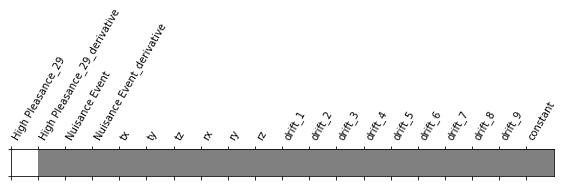

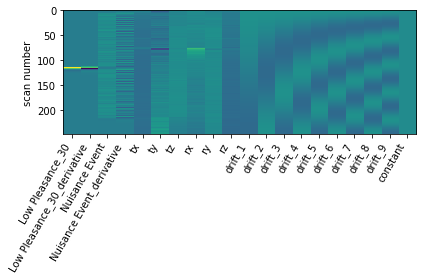

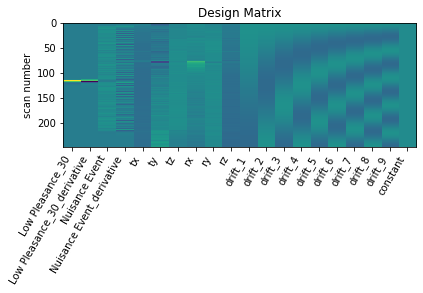

     0         1         2         3         4         5         6      \
0  1.27327 -0.268159  0.532611  1.040636  1.370981  0.811544 -0.654509   

      7         8         9      ...    11447     11448     11449     11450  \
0  0.797698  1.456939  1.906299  ... -1.80007 -1.067742 -1.776202 -0.184132   

      11451     11452     11453    11454     11455     11456  
0 -0.294346 -0.958962  0.099905 -2.63427 -1.429815 -1.191985  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_30
GLM RUN HighPleasance_31


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



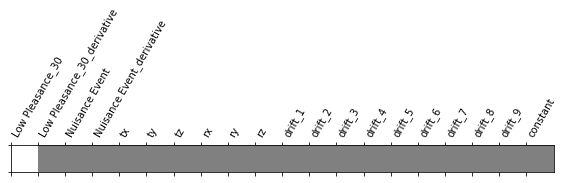

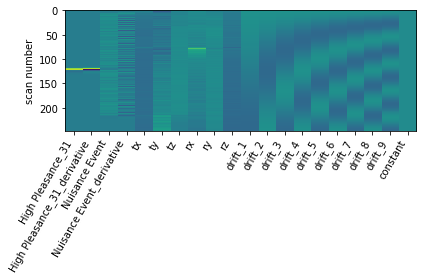

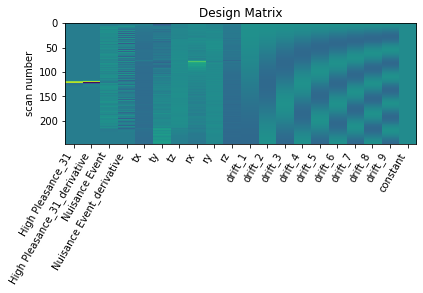

      0         1         2         3         4         5         6      \
0  0.413609 -0.282041 -0.618435 -0.028228  0.737829  0.600953 -0.117768   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.088504 -0.015118  0.353591  ... -2.247551 -1.823435 -1.726303 -1.134814   

     11451    11452     11453     11454     11455     11456  
0  1.98114 -0.75484  1.924321 -2.149659  0.830035 -0.808238  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_31
GLM RUN HighPleasance_32


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



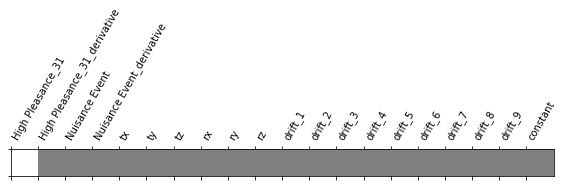

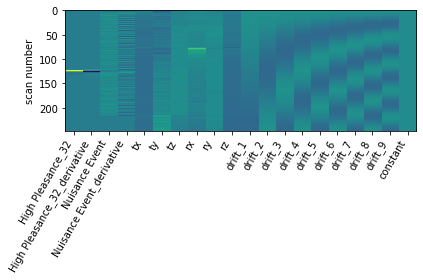

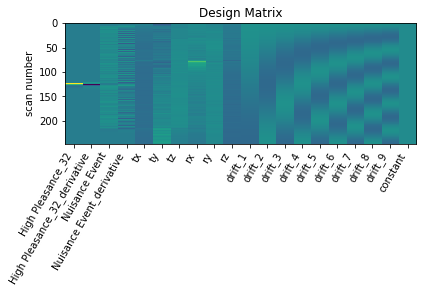

      0         1         2         3         4         5         6      \
0  0.966781 -0.750065 -0.129293  0.483356  0.977258 -0.517436 -0.837757   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.670295 -0.512494  0.261045  ... -1.613833 -1.053177 -1.282835 -1.035217   

      11451     11452     11453     11454     11455    11456  
0 -0.336119 -0.700973 -1.156687 -1.523129  0.208933 -0.85568  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_32
GLM RUN LowPleasance_33


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



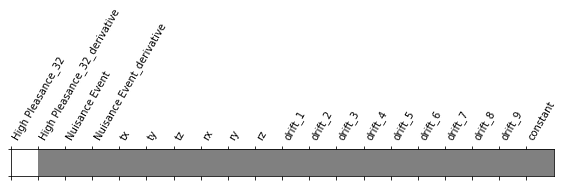

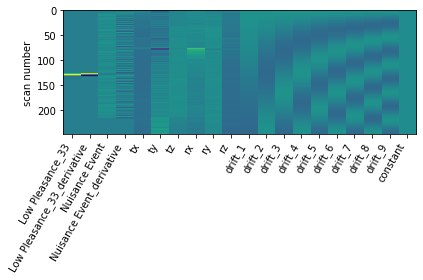

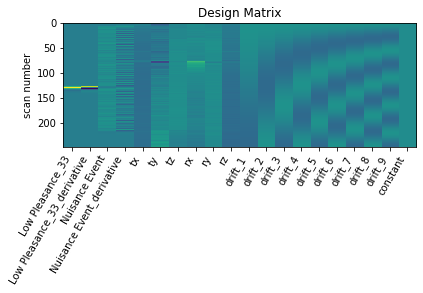

      0        1         2         3         4         5         6      \
0 -0.064186  0.14814  0.168372  0.809069  1.561791  0.999375 -0.354938   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.597256  0.761563  0.845994  ... -2.309273 -2.018366 -2.191396 -0.474626   

      11451     11452     11453     11454     11455     11456  
0  2.030282 -1.546733  1.168503 -2.447383  0.171068 -0.878382  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_33
GLM RUN HighPleasance_34


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



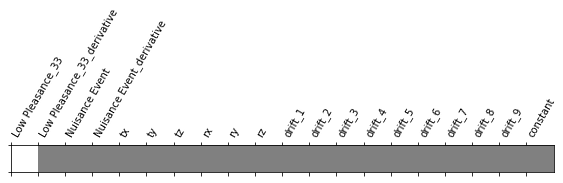

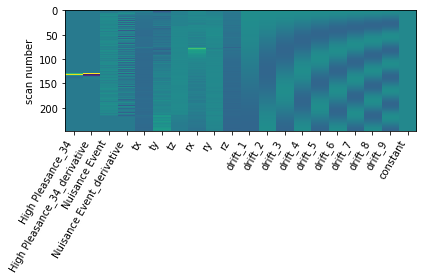

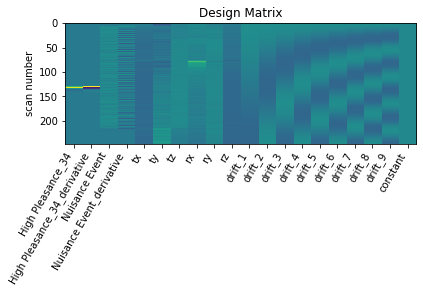

     0         1         2         3         4         5         6      \
0 -0.32713  0.232557  0.309279  0.427907  0.274595  0.630296  0.616707   

      7         8        9      ...    11447     11448     11449     11450  \
0  0.246998  0.196675 -0.59133  ...  0.31571  0.170722  0.817341  0.004108   

      11451     11452     11453     11454     11455     11456  
0 -0.442421  0.839227  1.298974  1.019138  0.249009 -0.194758  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_34
GLM RUN HighPleasance_35


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



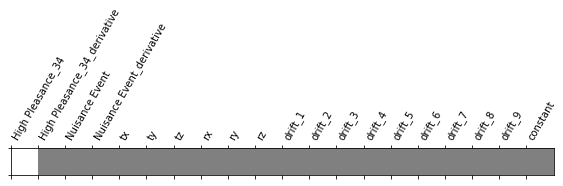

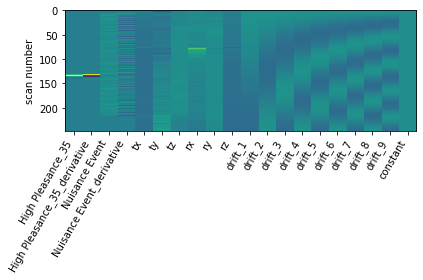

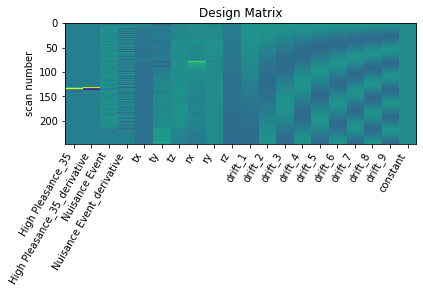

      0         1        2         3         4         5        6      \
0  0.180403 -0.898305 -0.21996 -0.100108  0.083927 -0.639732 -1.06356   

      7         8         9      ...     11447     11448    11449   11450  \
0 -0.926507 -0.544266  0.341633  ... -0.799007 -0.247588 -1.17286 -0.8146   

      11451     11452     11453     11454    11455     11456  
0 -0.433315 -0.738159 -1.240175 -0.331197 -0.55658 -0.351728  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_35
GLM RUN LowPleasance_36


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



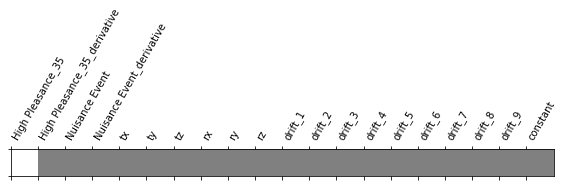

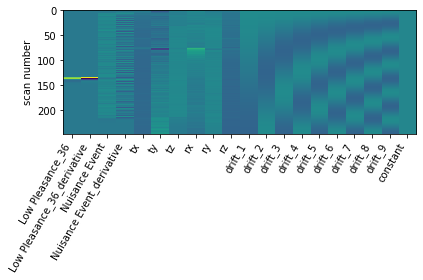

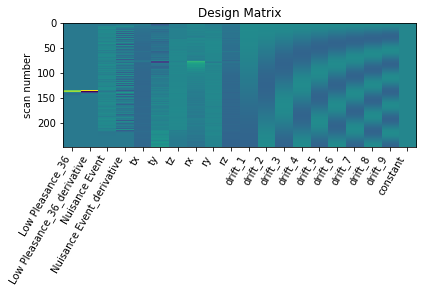

      0         1         2         3         4         5         6      \
0  0.640701 -1.178538 -0.284674  0.499158  0.980578 -0.301779 -0.524727   

     7         8         9      ...     11447     11448     11449     11450  \
0 -0.47203 -0.487574  0.445348  ... -1.910164 -1.483092 -1.690421  0.256467   

      11451     11452     11453     11454    11455     11456  
0  2.305513 -0.772876  0.277219 -2.350385  0.01292 -0.010518  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_36
GLM RUN LowPleasance_37


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



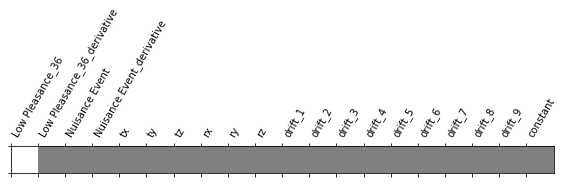

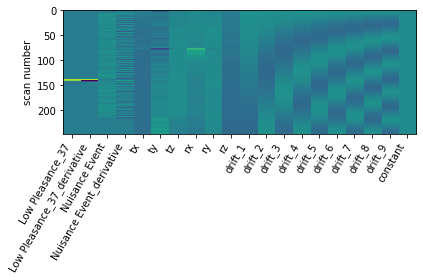

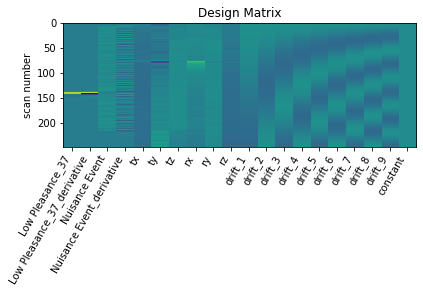

      0         1         2         3        4         5         6      \
0  1.607399  0.038742  0.084183  0.392656  0.95183  1.303189  0.305168   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.136811  1.311151  1.618673  ... -2.818232 -2.672884 -2.396312 -0.852711   

      11451     11452     11453    11454     11455     11456  
0 -0.461052 -1.819594  0.555176 -2.13336  0.577645 -1.936576  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_37
GLM RUN HighPleasance_38


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



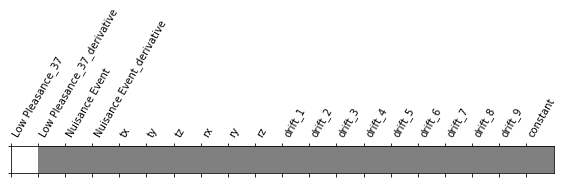

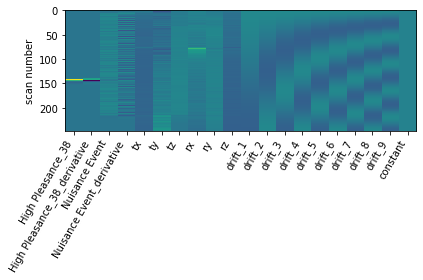

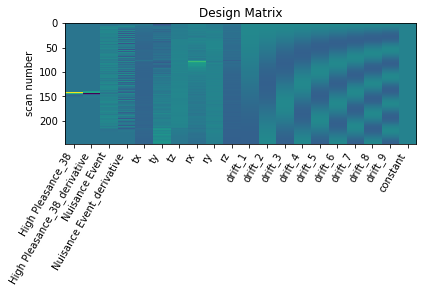

     0         1         2         3         4         5         6      \
0 -0.48615 -0.559622  0.222454  0.763503  1.099632  0.147697 -0.967469   

      7         8         9      ...     11447    11448     11449     11450  \
0  0.212163  0.688956  0.471945  ... -0.173444  0.25328 -0.437417 -1.876753   

     11451    11452     11453     11454     11455     11456  
0 -0.29112  0.50504  0.050913 -0.624665 -0.496042  0.395834  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_38
GLM RUN HighPleasance_39


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



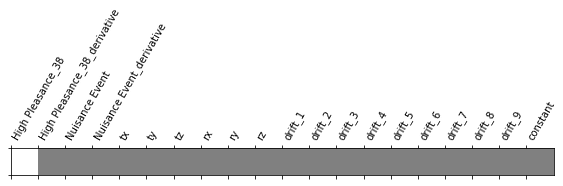

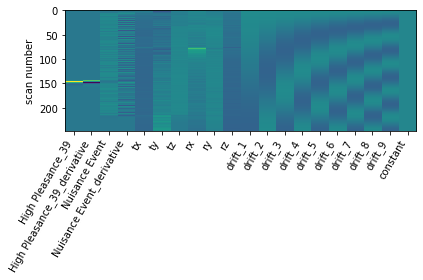

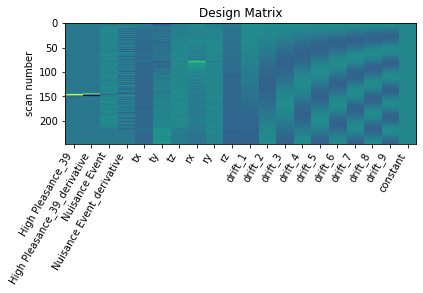

      0         1         2         3         4         5         6      \
0  1.056326 -1.326646  0.398399  1.313713  2.248545  1.699921  0.471486   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.809079  1.045908  1.588676  ... -2.954428 -2.153217 -2.256484  1.667584   

      11451     11452     11453     11454     11455     11456  
0  2.824988 -0.989157  1.325992 -3.422724 -0.230906 -2.009511  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_39
GLM RUN HighPleasance_40


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 19 seconds



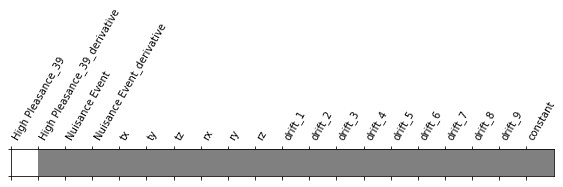

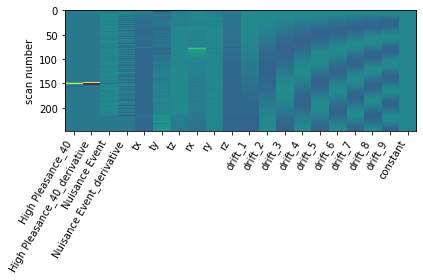

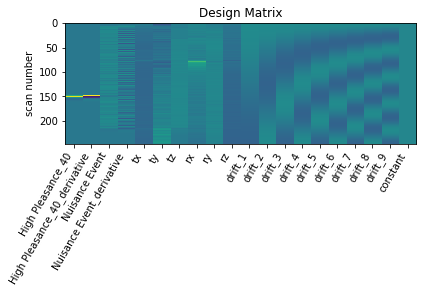

      0         1         2         3         4         5         6      \
0 -0.459364 -0.421852 -0.918786 -0.883804 -0.994741 -1.466651 -0.745188   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.350801 -1.348457 -0.908634  ... -2.157638 -2.048888 -2.607587 -1.438482   

      11451     11452     11453     11454     11455     11456  
0 -0.430996 -1.870739  0.761413 -2.300086  0.120037  0.147031  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_40
GLM RUN LowPleasance_41


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



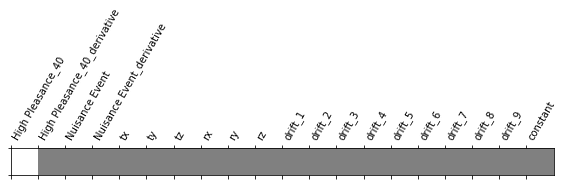

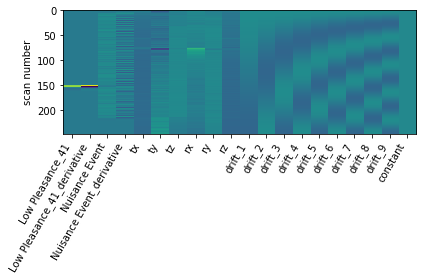

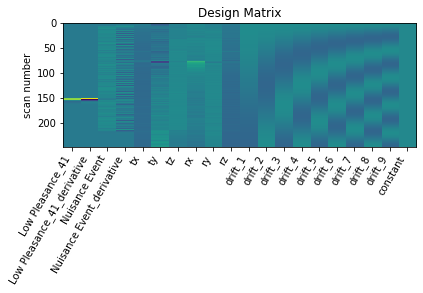

     0         1         2         3        4         5         6      \
0  0.94336  0.291582 -0.234348  0.689692  1.66019  1.821926 -0.437859   

      7         8         9      ...    11447     11448     11449     11450  \
0  1.432727  1.885777  1.959251  ... -0.53872 -0.104799 -0.477795 -1.765665   

     11451     11452    11453     11454     11455     11456  
0  0.08353  0.045256 -0.16125 -0.461258  0.375479 -0.122691  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_41
GLM RUN HighPleasance_42


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



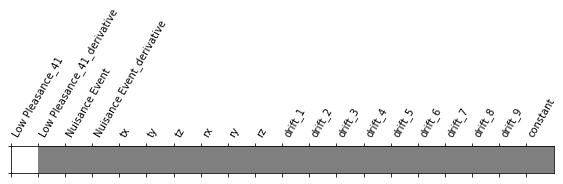

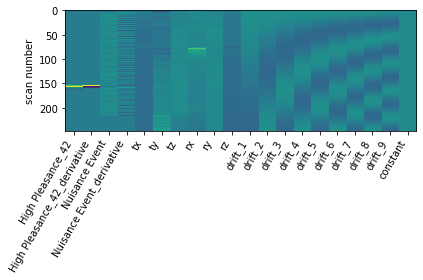

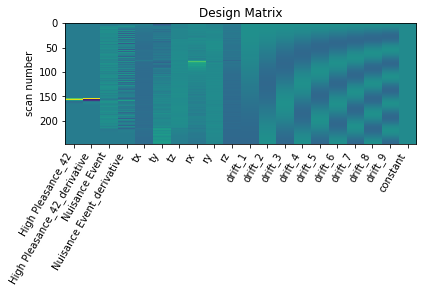

      0         1         2         3         4         5         6      \
0  0.864758 -0.008128  0.854996  1.601895  2.109616  1.561265 -0.150789   

     7         8         9      ...     11447     11448     11449     11450  \
0  0.62821  1.141991  1.456643  ... -1.373097 -0.866155 -0.565779  0.048176   

      11451     11452     11453     11454     11455     11456  
0  0.719205 -0.292572  0.974967 -1.412469 -0.113262 -1.749783  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_42
GLM RUN HighPleasance_43


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



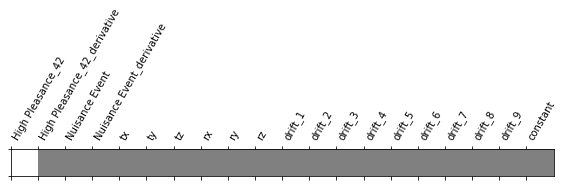

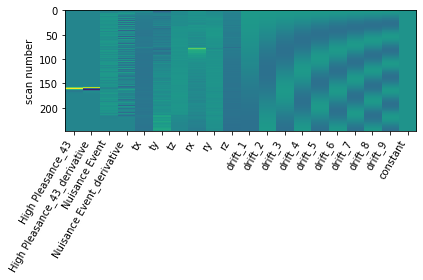

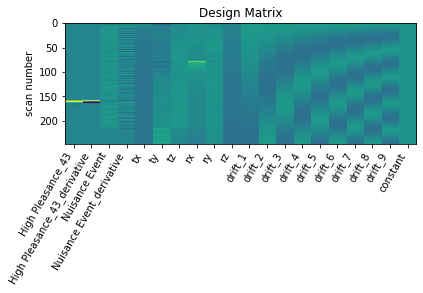

      0        1         2         3         4         5         6      \
0  0.290006 -1.35766 -0.371116  0.138271  0.775913 -0.740642 -0.405674   

      7         8         9      ...   11447     11448     11449     11450  \
0 -0.451967 -0.498027  0.249057  ... -1.7879 -1.766197 -1.513505  0.157846   

      11451     11452     11453     11454     11455     11456  
0  1.315111 -0.820237  0.362208 -1.948466  0.656869  0.505437  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_43
GLM RUN LowPleasance_44


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



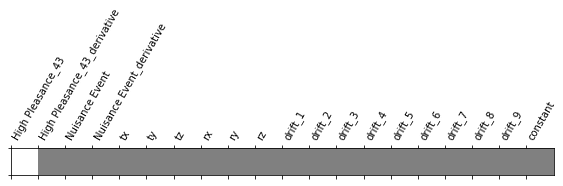

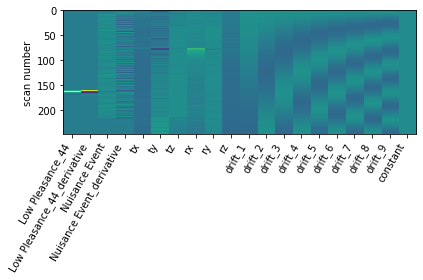

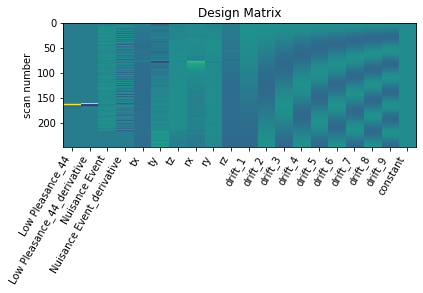

      0         1         2         3        4         5         6      \
0 -0.179811  0.688198 -0.186036 -0.146193 -0.30153 -0.249363 -1.243956   

      7         8       9      ...     11447     11448     11449     11450  \
0 -1.076088 -0.627902 -0.8952  ... -1.868527 -1.294991 -2.138346 -2.041633   

     11451     11452     11453     11454     11455     11456  
0 -0.24778 -1.325628 -0.232866 -0.233818 -1.173584 -0.182884  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_44
GLM RUN LowPleasance_45


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



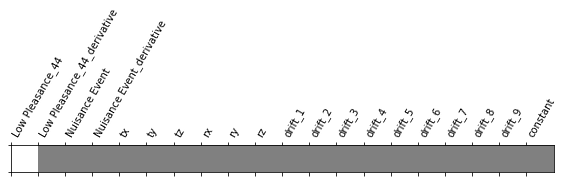

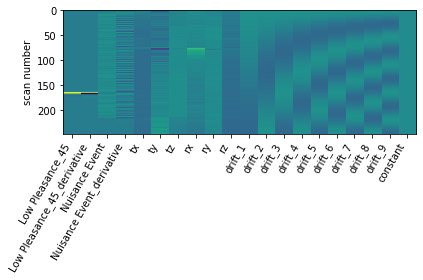

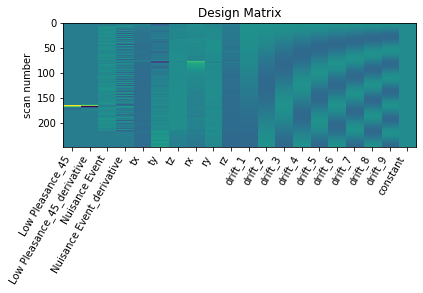

      0        1         2         3         4         5         6      \
0  1.413768  0.09585  0.152929  1.054667  2.085461  1.134672  0.513331   

      7         8       9      ...    11447     11448     11449     11450  \
0  1.076637  1.094602  0.7592  ... -0.58496 -0.585439 -0.083478 -0.523481   

      11451     11452    11453     11454    11455     11456  
0 -0.029356 -0.149604  0.31588 -1.339174  0.24786 -1.739022  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_45
GLM RUN HighPleasance_46


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



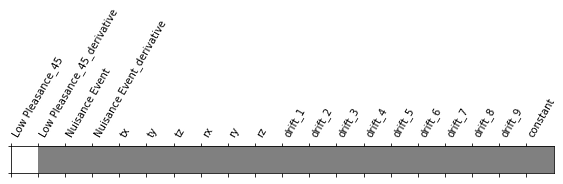

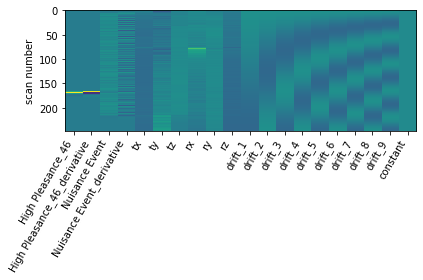

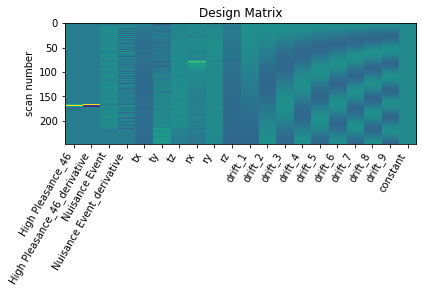

      0         1        2         3         4         5         6      \
0 -0.050083 -1.172322 -1.18252 -0.708133 -0.445728  0.601535 -0.199394   

     7         8         9      ...    11447     11448     11449     11450  \
0  0.73462  1.121635  1.988667  ... -1.35032 -1.263618 -0.486856 -0.173041   

      11451     11452     11453     11454     11455   11456  
0  1.751354  0.263294 -1.425537 -1.332907  0.802889 -0.4527  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_46
GLM RUN HighPleasance_47


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



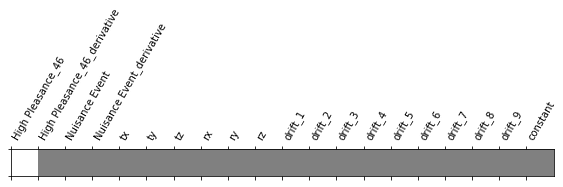

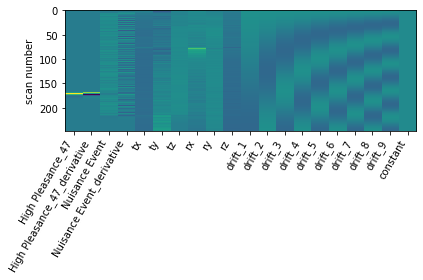

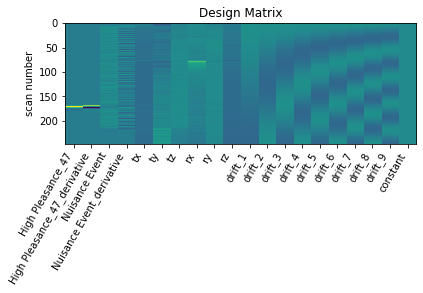

      0         1         2         3         4         5         6      \
0 -0.424267 -0.345176  0.303512  0.485098  0.793812 -0.155428 -0.481319   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.466031 -0.397214 -0.148108  ... -2.560171 -1.789673 -2.311597 -0.709367   

      11451     11452     11453     11454     11455     11456  
0  1.155155 -1.370512  1.408315 -2.636678 -0.358429  0.075051  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_47
GLM RUN HighPleasance_48


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



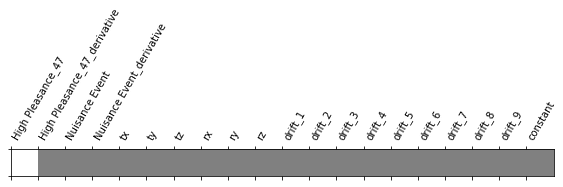

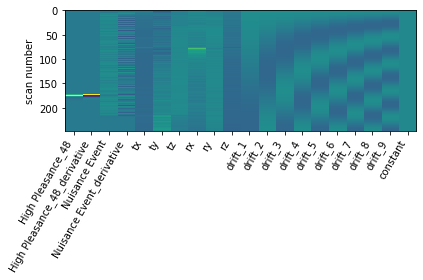

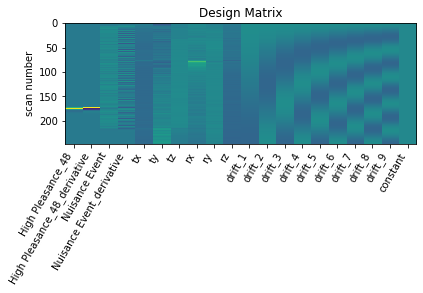

      0         1         2        3         4         5        6      \
0  0.614089 -0.470475 -0.533285 -0.14149  0.882276  0.616217  0.81761   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.498571  1.182318  1.578951  ... -1.851244 -1.146305 -2.023243  0.421555   

      11451     11452    11453     11454    11455     11456  
0  0.096208 -1.648667  0.73998 -1.671729 -0.43229 -0.835153  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_48
GLM RUN HighPleasance_49


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



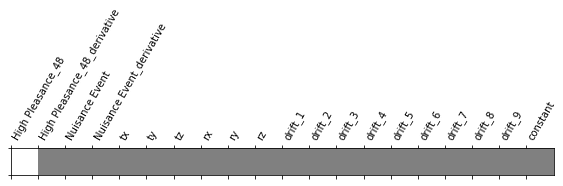

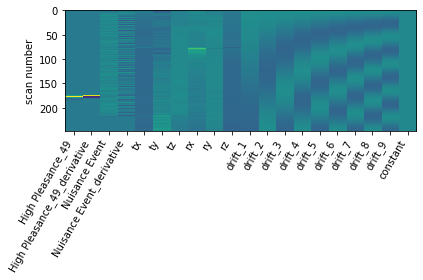

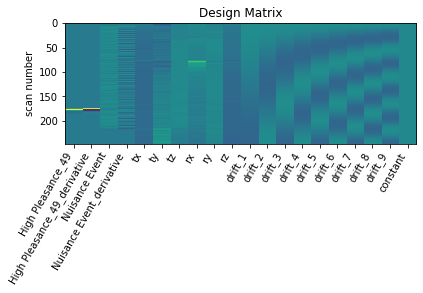

      0         1         2         3         4         5         6      \
0  2.023827  0.963819  0.568234  1.205279  1.514663  1.374537  0.577365   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.273804  1.139467  1.274253  ...  0.103656  0.148676 -0.509641 -0.585351   

      11451     11452    11453     11454     11455     11456  
0  0.786285  0.393339  0.03693 -0.068258  0.465783 -2.070359  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_49
GLM RUN HighPleasance_50


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



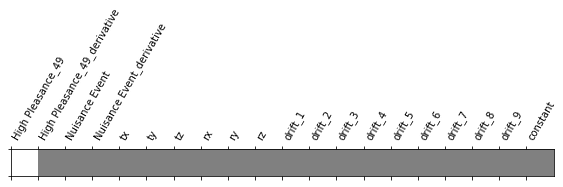

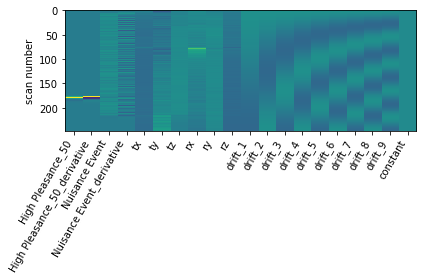

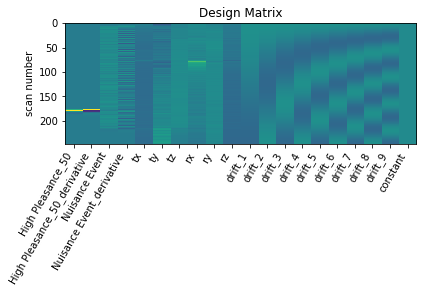

      0         1         2         3         4         5         6      \
0 -0.446889 -0.643367  0.064836  0.297836  0.230649  0.715515 -0.501317   

      7         8         9      ...     11447     11448    11449     11450  \
0 -0.152058  0.129105  0.016382  ...  0.502675  0.986881  0.87502 -1.283058   

      11451    11452     11453     11454   11455     11456  
0  0.146378  1.00603  0.156652 -0.478092 -1.2855 -0.541433  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_50
GLM RUN HighPleasance_51


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



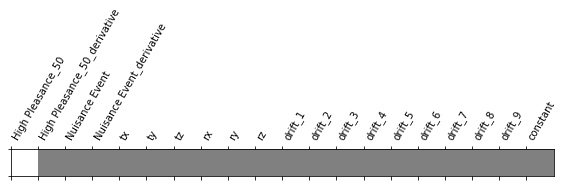

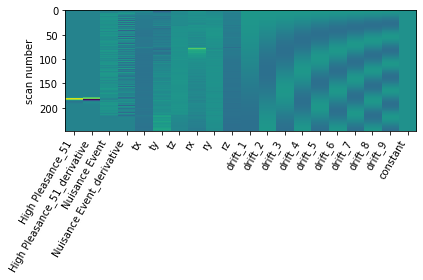

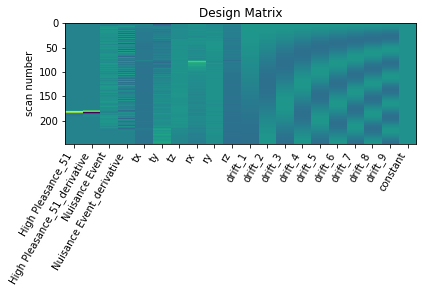

      0         1         2         3         4         5         6      \
0  0.137926 -1.763162 -0.137075  0.624148  1.453735  0.352618 -0.847713   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.040719  0.487337  1.045088  ... -3.589692 -3.033925 -2.742805 -0.161154   

      11451    11452   11453    11454     11455     11456  
0  0.686286 -1.07891  1.1383 -3.21567 -0.170667 -0.234439  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_51
GLM RUN LowPleasance_52


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



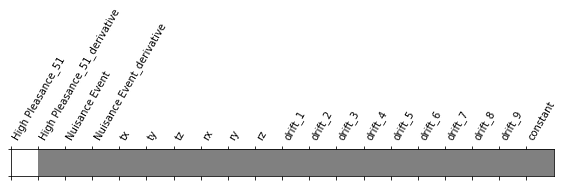

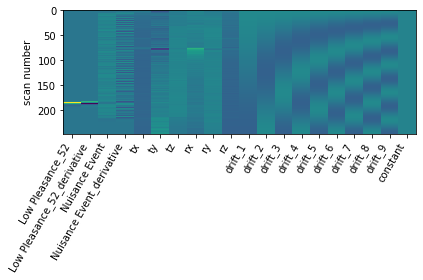

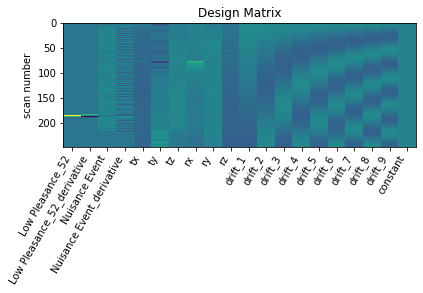

      0         1         2         3        4         5         6      \
0  1.183368  0.316052  1.332923  1.577239  1.29232  0.926012  0.375374   

     7         8         9      ...     11447     11448     11449     11450  \
0  1.10238  1.243629  1.469426  ... -0.414654 -0.821155 -0.921005  0.487536   

      11451    11452     11453     11454     11455     11456  
0  1.340645 -1.13391  0.825791  0.135403  1.593339 -1.396706  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_52
GLM RUN HighPleasance_53


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



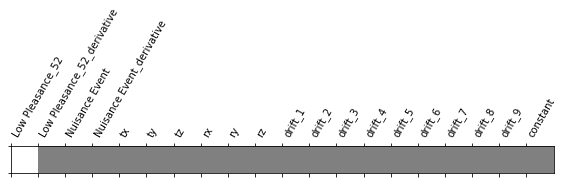

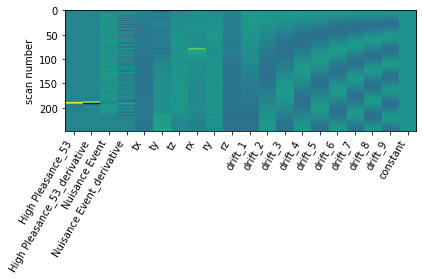

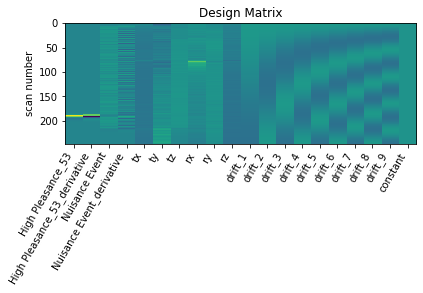

      0         1         2         3         4         5         6      \
0  0.982786 -0.838696 -0.975181  0.149961  0.850331 -0.787263 -2.279946   

      7       8        9      ...     11447     11448    11449     11450  \
0 -2.147286 -1.6999 -0.96333  ... -2.466064 -1.969844 -1.30003 -2.073612   

      11451     11452     11453     11454     11455     11456  
0  0.260666 -0.326683 -0.151345 -2.301618 -0.485874 -0.701675  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_53
GLM RUN HighPleasance_54


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



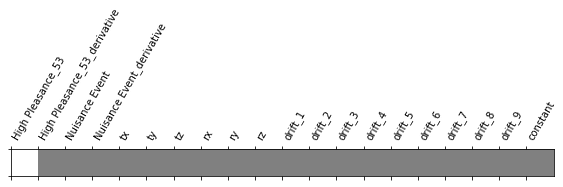

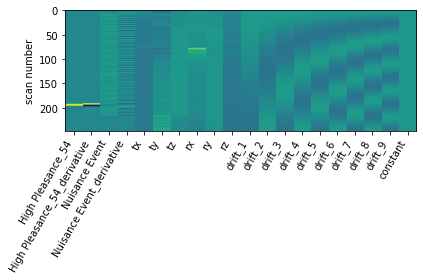

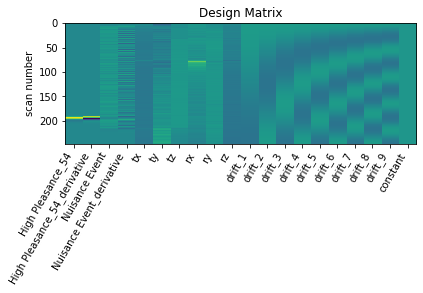

      0         1         2         3         4         5         6      \
0  0.405176 -0.673533  0.621863  0.948165  1.292684  0.547533 -0.330811   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.286021  0.463301  1.277238  ... -2.510221 -2.308136 -2.289135 -0.157892   

      11451     11452    11453     11454     11455     11456  
0  0.638923 -1.328194  0.45813 -2.094487  0.890826 -0.853593  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_54
GLM RUN HighPleasance_55


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



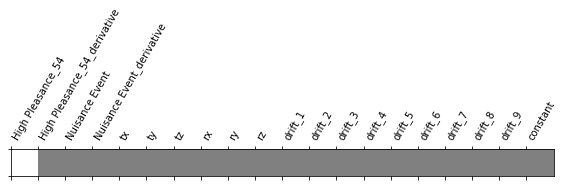

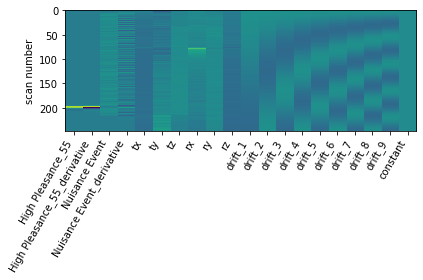

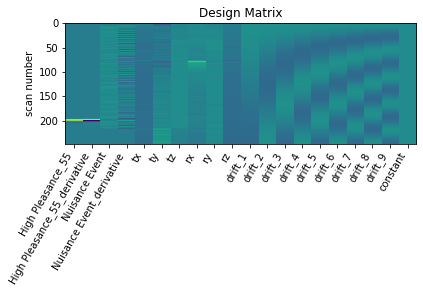

      0        1        2         3         4        5         6        7      \
0  0.278385 -0.60863 -0.94434 -0.431635 -0.061941  0.45626 -0.924112 -0.04334   

      8        9      ...  11447     11448     11449     11450    11451  \
0  0.609871  0.87096  ... -2.303 -1.527788 -1.803284 -0.765448  1.10701   

      11452     11453     11454     11455     11456  
0 -1.386481  0.202931 -2.540321 -0.205485 -0.011041  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_55
GLM RUN HighPleasance_56


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



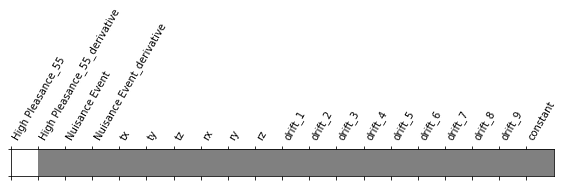

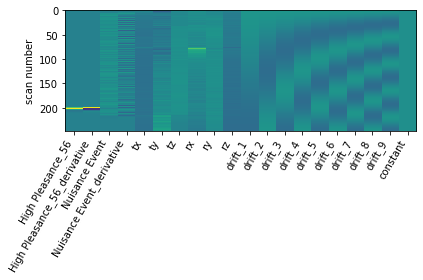

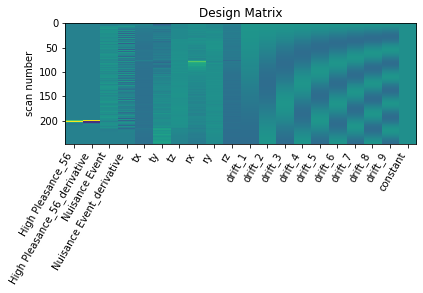

     0         1         2         3         4         5         6      \
0  0.77157 -0.815972  0.916148  1.791681  2.451869  0.821307 -0.078836   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.301675  0.346236  0.884735  ... -1.510624 -1.396667 -1.432517 -1.228545   

      11451     11452     11453     11454    11455     11456  
0  1.519907 -0.063489  0.011798 -1.538216  0.65628 -1.268838  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_56
GLM RUN HighPleasance_57


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



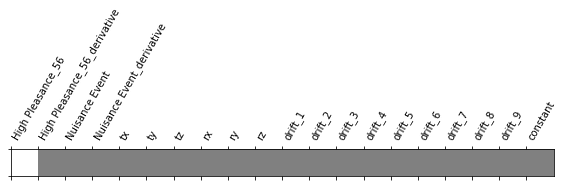

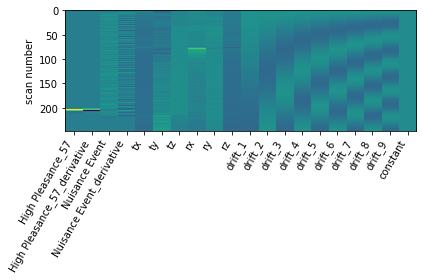

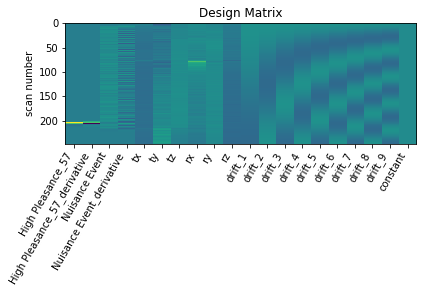

      0         1         2         3         4         5         6      \
0  0.586698  1.277842 -1.199044 -0.798163  0.065307 -0.169185  0.020995   

      7        8        9      ...     11447     11448     11449     11450  \
0  0.375442  0.18394  0.81572  ... -1.708246 -1.604028 -1.536059 -0.218158   

      11451     11452     11453     11454     11455     11456  
0 -0.952791 -1.101105 -0.431736 -1.347651 -0.815275 -0.678835  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_57
GLM RUN HighPleasance_58


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



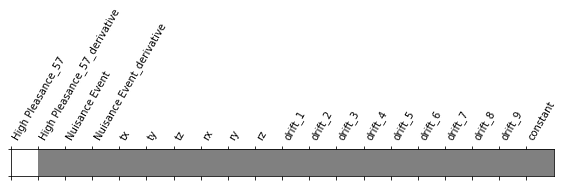

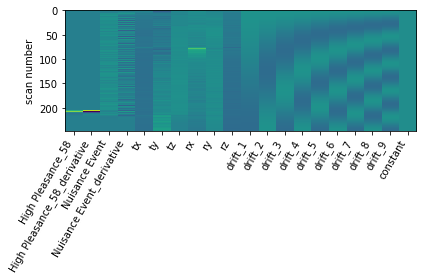

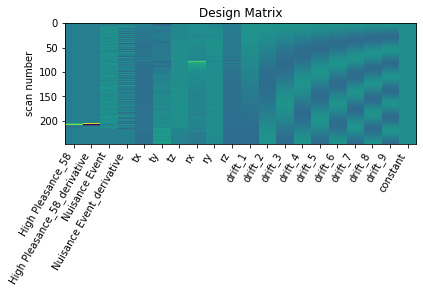

     0         1         2         3         4        5         6      \
0  0.81669 -1.877733  0.636959  1.108576  1.515969  1.24109  0.750731   

      7         8         9      ...    11447     11448     11449     11450  \
0  1.300687  1.192107  1.764601  ... -1.89677 -0.833367 -1.370837  0.451116   

      11451     11452     11453    11454     11455     11456  
0  1.587523 -0.083445  1.865533 -2.71344 -0.325144 -1.110195  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_58
GLM RUN HighPleasance_59


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



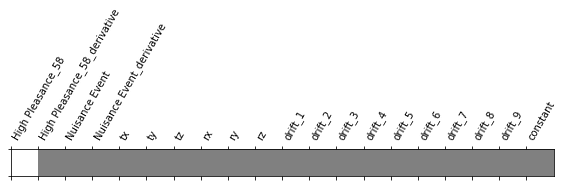

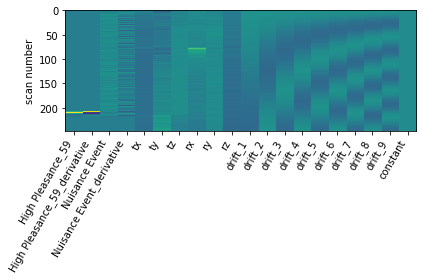

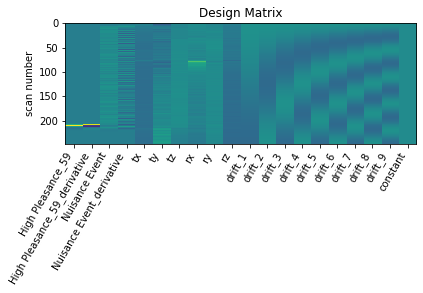

      0         1        2         3         4         5         6      \
0 -0.236006 -0.581886 -1.03893 -0.940229  0.081736  0.883457  0.724715   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.606765  1.784987  1.387052  ... -1.315155 -0.621602 -0.872996 -0.485865   

      11451     11452     11453     11454     11455     11456  
0  1.545039  0.046508  0.057126 -1.634241 -1.148069  0.639776  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_59
GLM RUN HighPleasance_60


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 19 seconds



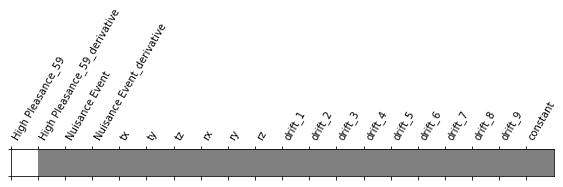

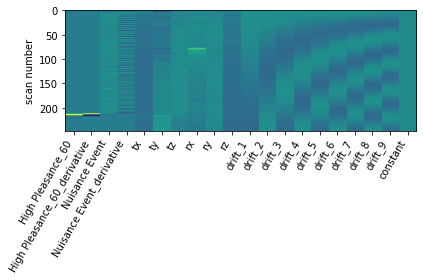

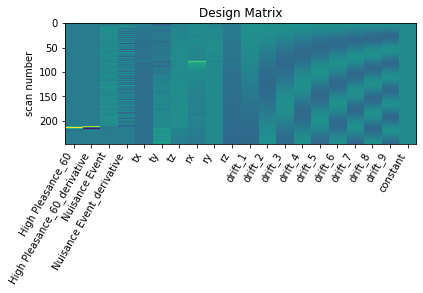

      0         1         2         3         4         5         6      \
0  0.535562  0.410544  0.539728  1.657094  2.392737  0.593269 -0.504855   

      7         8         9      ...     11447    11448     11449     11450  \
0 -0.156297  0.005189  0.362165  ... -1.585409 -1.10371 -1.938016 -0.569869   

      11451     11452     11453     11454    11455     11456  
0 -0.184455 -1.419167  0.171349 -1.886538  0.15866 -2.115669  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_60


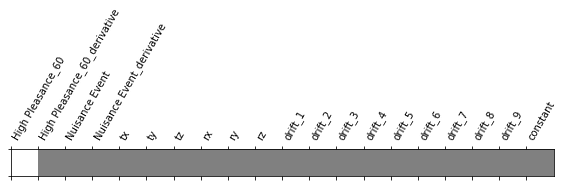

In [ ]:
y_fo_ap, X_fo_ap = lss_separate_method_comp(task =task,
                          data_path=data_path,
                          events_path=events_path,
                          motion_param_path=motion_param_path,
                          cache_mem_path=cache_mem_path,
                          activity_mat_saving_path=activity_mat_saving_path,
                          analysis_type=analysis_type,
                          param_modulation=False,
                          t_r=t_r,
                          drift_model=drift_model,
                          drift_order=drift_order,
                          hrf_model=hrf_model,
                          pre_whitening_spec=pre_whitening_spec,
                          apply_trans_mask=apply_trans_mask,
                          roi_img=roi_img,  
                          hpf_cut=hpf_cut,
                          smoothing_fwhm=smoothing_fwhm,
                          standardize=standardize,
                          detrend=detrend,minimize_memory=minimize_memory)

In [ ]:
y_g.append(y_fo_ap)
X_g.append(X_fo_ap)

In [ ]:
X_fo_ap.shape

(60, 11457)

### Run PA

In [ ]:
data_path = 'ses-19/func/wrdcsub-01_ses-19_task-PreferenceFood_dir-pa_bold.nii.gz'
events_path = 'ses-19/func/sub-01_ses-19_task-PreferenceFood_dir-pa_events.tsv'
motion_param_path = 'ses-19/func/rp_dcsub-01_ses-19_task-PreferenceFood_dir-pa_bold.txt'
task = 'Food'

In [ ]:
analysis_type = 'High_Low_Pleasance'
hrf_model = 'spm + derivative'
param_modulation = False
drift_model='cosine'
t_r=2
drift_order=None
apply_trans_mask=True
roi_img = mask_img
standardize=True
detrend=True
minimize_memory = True
activity_mat_saving_path = 'mvpa/test2'

events = pd.read_csv(events_path,sep='\t')

# onset shift in order to capture the very moment of the appreciation decision
events['onset'] = events['onset']-1

onset_periods = [events['onset'][i+1] - events['onset'][i]  for i in range(len(events['onset']))if (i<len(events['onset'])-1)]
onset_periods = np.array(onset_periods)
onset_freq = np.reciprocal(onset_periods)
hpf_cut = np.min(onset_freq)/2 # cf High Pass Filtering Rule of Thumb ( fMRI Handbook 2011)

Event 0
      onset  duration        trial_type
0     7.923     5.152  High Pleasance_1
1    16.821     9.172    Nuisance Event
2    30.353     7.442    Nuisance Event
3    39.335     4.027    Nuisance Event
4    44.651     4.989    Nuisance Event
5    50.767     5.088    Nuisance Event
6    56.666     4.523    Nuisance Event
7    65.281    10.539    Nuisance Event
8    77.963     3.818    Nuisance Event
9    86.012     3.860    Nuisance Event
10   90.478     4.045    Nuisance Event
11   97.010     8.105    Nuisance Event
12  108.659     4.317    Nuisance Event
13  114.591     3.028    Nuisance Event
14  118.841     2.397    Nuisance Event
15  124.940     3.033    Nuisance Event
16  132.256     3.227    Nuisance Event
17  138.305     8.353    Nuisance Event
18  147.537     4.197    Nuisance Event
19  153.153     2.353    Nuisance Event
20  159.402     4.466    Nuisance Event
21  164.401     9.067    Nuisance Event
22  176.899     2.779    Nuisance Event
23  180.632     3.270    Nuisanc

59  450.295     3.198    Nuisance Event
Event 58
      onset  duration        trial_type
0     7.923     5.152    Nuisance Event
1    16.821     9.172    Nuisance Event
2    30.353     7.442    Nuisance Event
3    39.335     4.027    Nuisance Event
4    44.651     4.989    Nuisance Event
5    50.767     5.088    Nuisance Event
6    56.666     4.523    Nuisance Event
7    65.281    10.539    Nuisance Event
8    77.963     3.818    Nuisance Event
9    86.012     3.860    Nuisance Event
10   90.478     4.045    Nuisance Event
11   97.010     8.105    Nuisance Event
12  108.659     4.317    Nuisance Event
13  114.591     3.028    Nuisance Event
14  118.841     2.397    Nuisance Event
15  124.940     3.033    Nuisance Event
16  132.256     3.227    Nuisance Event
17  138.305     8.353    Nuisance Event
18  147.537     4.197    Nuisance Event
19  153.153     2.353    Nuisance Event
20  159.402     4.466    Nuisance Event
21  164.401     9.067    Nuisance Event
22  176.899     2.779    Nuisan

Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



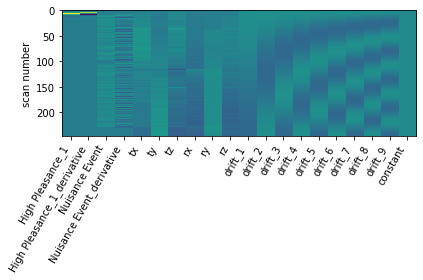

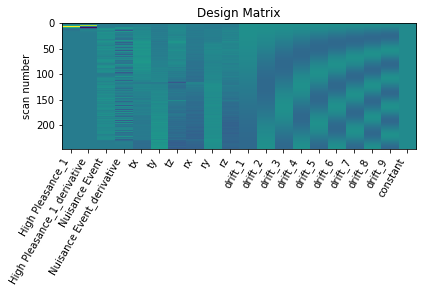

      0         1         2        3         4         5         6      \
0  1.988506 -1.485736  1.330497  0.74923 -0.093311  2.034258  1.680876   

      7         8         9      ...     11447     11448     11449     11450  \
0  2.276739  2.224428  2.097288  ...  0.808283  1.141558  1.027718 -0.428698   

      11451     11452     11453     11454     11455     11456  
0  0.548696  1.505401  1.359369  0.286589  0.416067  0.280114  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_1
GLM RUN LowPleasance_2


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



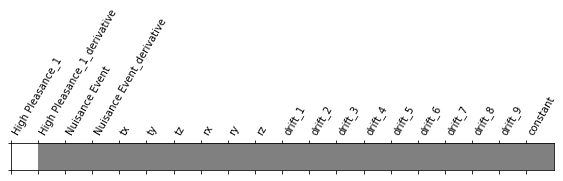

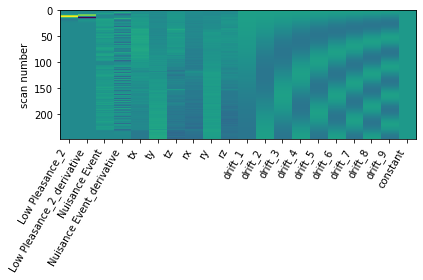

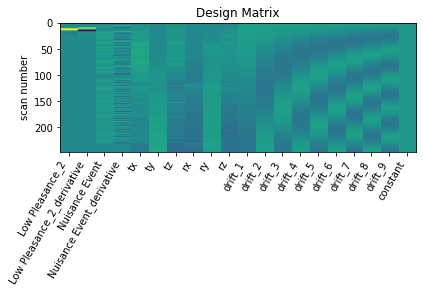

      0         1         2         3         4         5         6      \
0  1.137619  0.324764  0.394935  0.295191  0.058676  0.943353  0.225082   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.586606  0.714696  0.517967  ... -0.091683  0.103178 -0.183691  0.637026   

      11451     11452     11453     11454     11455     11456  
0  0.276967 -0.463259  0.706069 -0.616657 -0.030208 -0.362901  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_2
GLM RUN HighPleasance_3


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



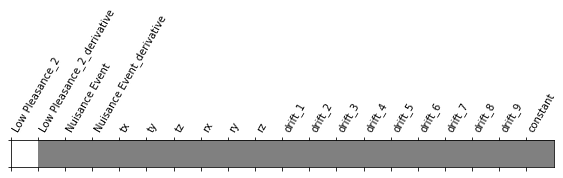

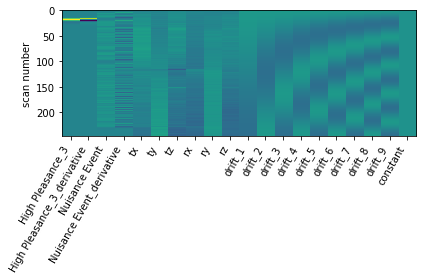

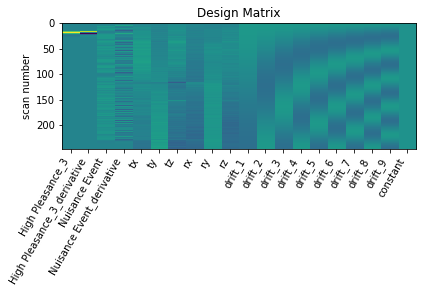

      0         1         2         3         4         5         6      \
0  1.534881 -0.898304  0.215302 -0.041232 -0.451386  1.567393  1.813112   

      7         8         9      ...     11447     11448     11449     11450  \
0  2.230704  2.090639  1.621462  ... -0.479576 -0.216976 -1.135975 -0.757606   

      11451     11452    11453     11454     11455     11456  
0  0.481809 -1.183384  1.08484 -0.913113  0.279551  0.311466  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_3
GLM RUN HighPleasance_4


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



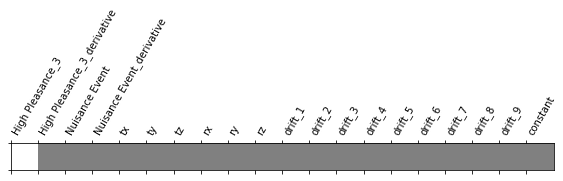

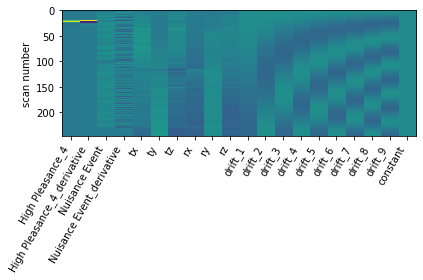

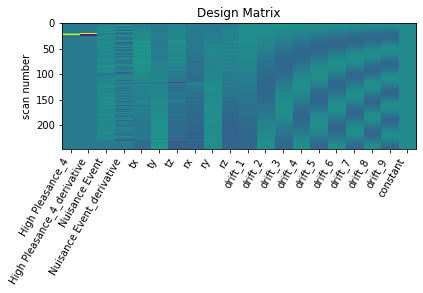

      0         1         2         3         4         5         6      \
0  0.508982  0.118281  0.022205  0.163024  0.526322  1.768089  0.383307   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.481335  0.998757  0.352493  ...  0.567156  0.980399  0.307132  0.337394   

     11451     11452     11453     11454     11455     11456  
0 -0.80276  0.136309 -0.298763  0.154519 -0.096708 -0.198244  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_4
GLM RUN HighPleasance_5


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



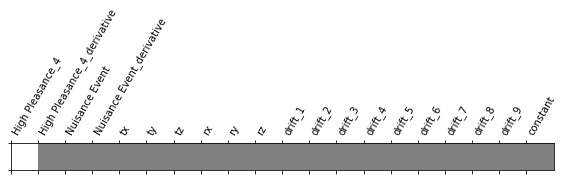

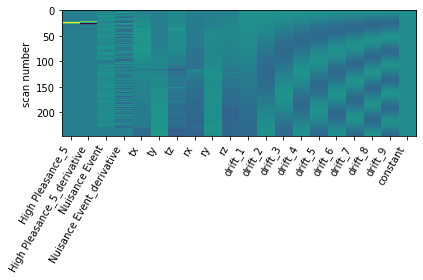

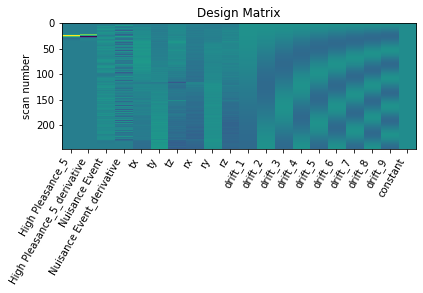

      0         1         2         3         4         5         6      \
0  1.577413 -1.311031  0.855876  0.343171 -0.252497 -0.379132 -0.575556   

      7         8         9      ...     11447     11448    11449     11450  \
0 -0.779199 -0.650263 -0.624967  ...  0.826755  1.016716  0.68492 -0.807665   

      11451     11452     11453     11454     11455     11456  
0 -0.404939  0.015849  1.472248  0.249615  1.373344  1.045414  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_5
GLM RUN HighPleasance_6


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



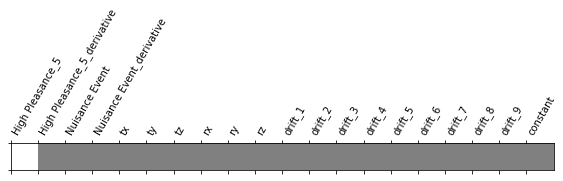

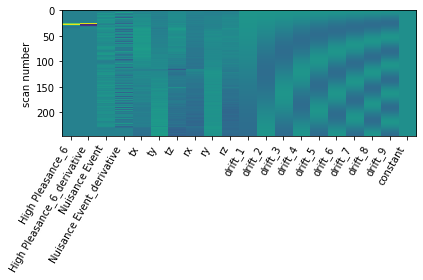

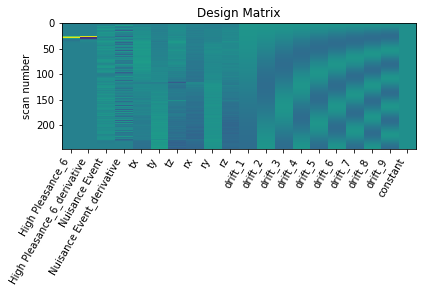

      0         1         2         3         4         5         6      \
0 -0.405398 -0.610235 -0.035359  0.133503 -0.111108  1.827675  0.655438   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.181638  1.737045  0.801024  ... -1.730521 -1.490412 -1.449949 -0.400918   

      11451     11452     11453     11454     11455     11456  
0 -0.630719 -1.093339  0.772129 -1.242079 -0.426095  0.129389  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_6
GLM RUN LowPleasance_7


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



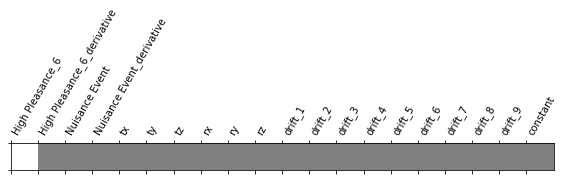

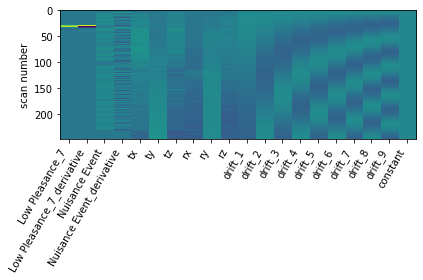

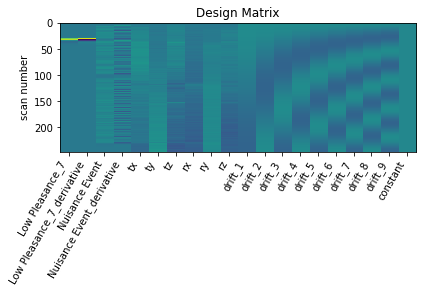

      0         1         2         3         4         5         6      \
0  0.352863  1.113011 -0.854452 -0.749074 -0.442788  0.209428 -0.224187   

      7         8         9      ...    11447     11448     11449     11450  \
0 -0.242773 -0.245344 -0.100206  ...  0.15294  0.441788 -0.466178  0.902184   

      11451     11452     11453     11454     11455     11456  
0 -0.267388 -1.612881  0.108642 -0.380982 -0.669244 -0.644206  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_7
GLM RUN HighPleasance_8


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 19 seconds



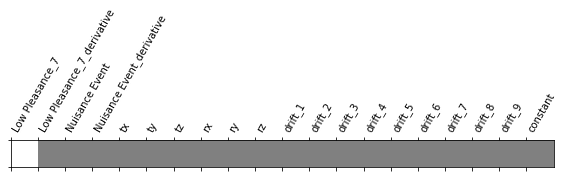

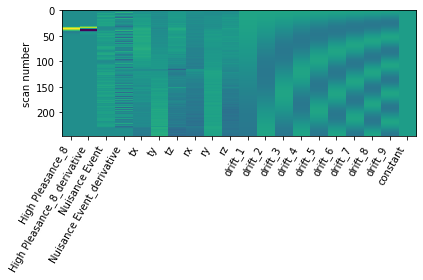

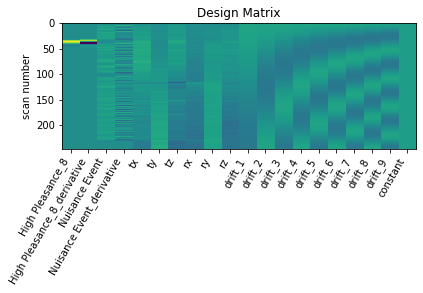

      0         1         2         3         4         5         6      \
0  3.075786 -1.683465  1.728216  2.151373  1.622034  1.437062  0.936142   

    7         8        9      ...     11447     11448    11449     11450  \
0  1.5193  1.839059  1.32967  ... -0.237226  0.137938 -0.40771 -0.885647   

      11451     11452     11453     11454    11455     11456  
0  0.141841  0.217726  1.265163 -0.586006  0.44496  0.077627  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_8
GLM RUN LowPleasance_9


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



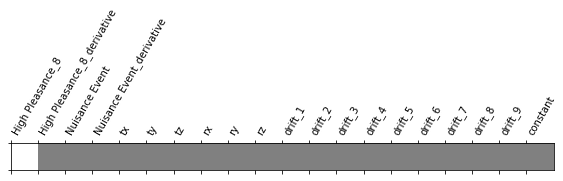

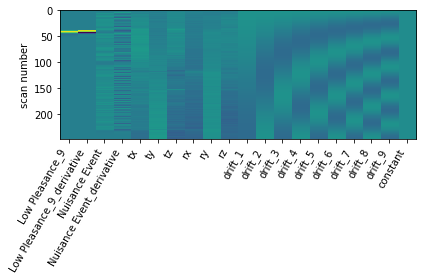

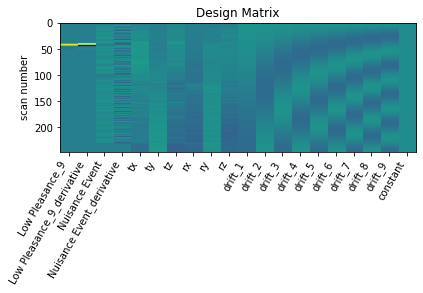

      0         1         2        3         4         5         6      \
0  0.661337  1.394429 -1.352816 -1.77351 -1.604597  1.025601 -0.437406   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.775823 -0.448257 -0.526018  ...  0.032158  0.301821 -0.315553  0.911651   

     11451     11452     11453     11454     11455     11456  
0  0.31353 -1.275464  0.031522 -0.176803 -1.000469  0.534162  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_9
GLM RUN HighPleasance_10


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



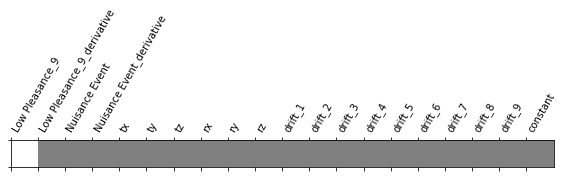

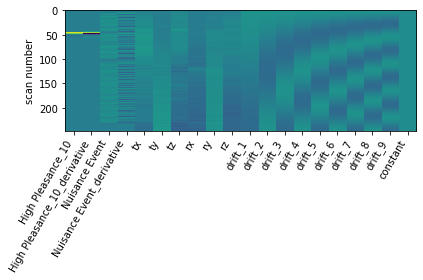

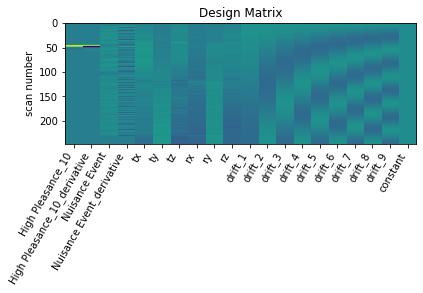

      0         1         2        3         4         5         6      \
0  1.014069 -1.137871  1.046385  1.20596  1.014164  0.290853  1.720329   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.421676  0.809345  1.475895  ...  1.014327  0.421108  0.419167  0.595066   

      11451     11452     11453     11454     11455     11456  
0  0.929996  0.557811  0.992101  1.419754  0.445191 -0.546776  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_10
GLM RUN HighPleasance_11


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



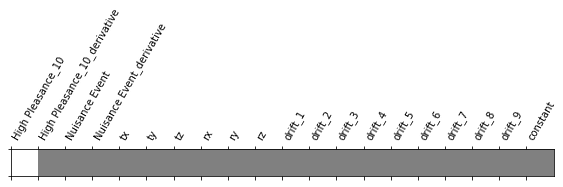

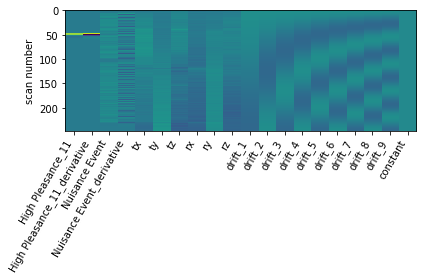

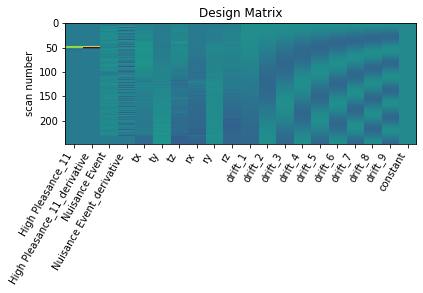

      0         1         2         3         4        5         6      \
0  0.073299  0.044976 -0.053741  0.445654  0.588445  0.19682  1.284427   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.221805  0.731993  0.772653  ...  0.511776  0.725888  0.175787  0.465594   

      11451     11452     11453     11454     11455     11456  
0 -0.536389 -0.198844 -0.362131  0.341932  0.073013  0.724653  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_11
GLM RUN HighPleasance_12


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



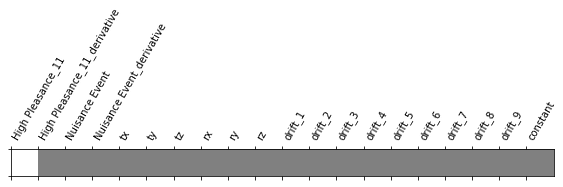

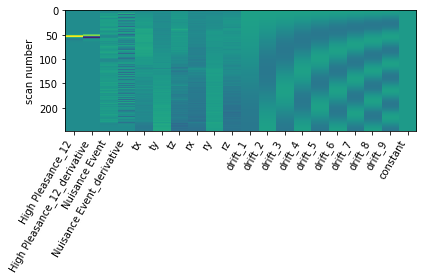

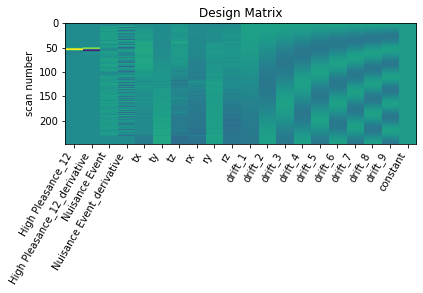

      0         1         2         3         4         5         6      \
0  1.508778 -0.828988  0.151088 -0.127828 -0.208916  1.686484  0.705814   

      7         8         9      ...    11447     11448     11449     11450  \
0  0.403042  0.948451  0.385387  ...  0.31616  0.558797  0.344555 -0.633352   

      11451     11452     11453     11454     11455     11456  
0  0.109038  0.261552  1.189449  0.167094  0.623621  1.667247  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_12
GLM RUN HighPleasance_13


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



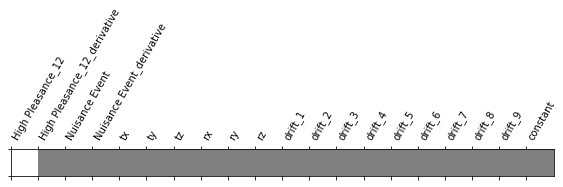

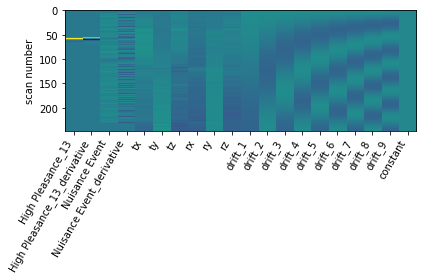

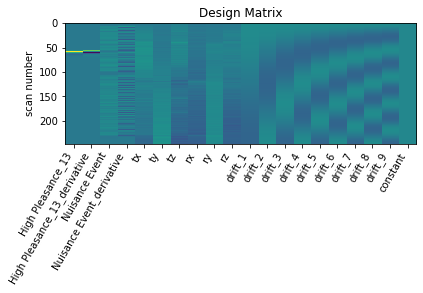

      0         1        2         3         4         5         6      \
0 -0.310703  0.209805 -0.03544 -0.158915 -0.627722  0.639195 -1.313115   

      7         8         9      ...    11447     11448     11449     11450  \
0 -0.141752  0.462585 -0.480941  ... -1.33902 -0.777454 -1.808031  0.369206   

      11451     11452     11453     11454     11455     11456  
0  0.095665 -2.123978  0.542815 -2.291608  0.088117 -2.614688  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_13
GLM RUN HighPleasance_14


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



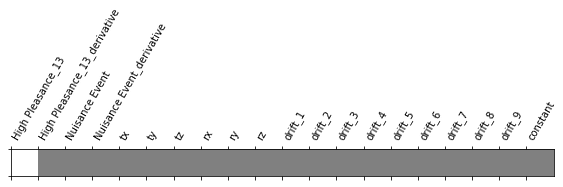

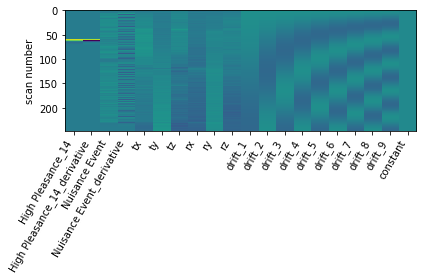

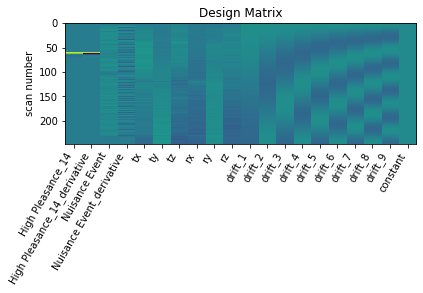

      0         1         2         3         4         5         6      \
0  0.783838  0.107915  0.622385  0.571021  0.085463  0.858545 -0.069673   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.459142  0.746549  0.115699  ...  1.630532  1.270689  0.954447 -0.171468   

     11451     11452     11453     11454     11455     11456  
0 -0.12795  1.246608 -0.030215  1.037612  1.187688  1.316109  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_14
GLM RUN HighPleasance_15


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



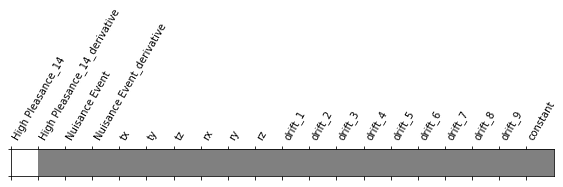

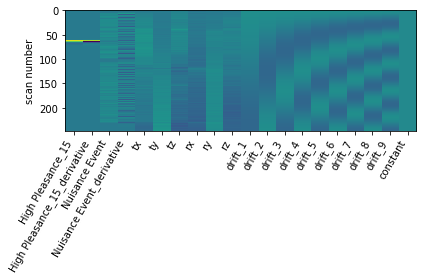

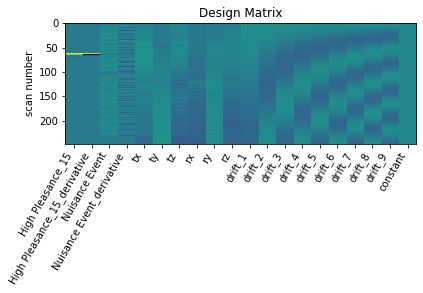

      0         1         2         3         4         5         6      \
0  0.712201 -0.239311  1.528986  1.535938  1.027787  1.083743  0.445007   

      7         8         9      ...     11447    11448     11449     11450  \
0  0.762995  1.070243  0.723127  ...  1.218677  1.26743  0.866645 -2.105147   

      11451     11452     11453     11454     11455     11456  
0 -0.562579  1.406637 -0.189936  0.961817  0.503328  1.817949  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_15
GLM RUN LowPleasance_16


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



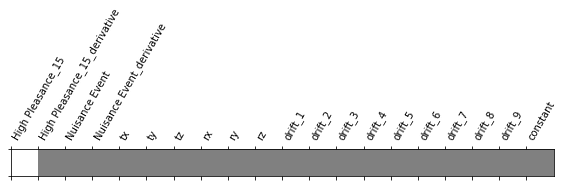

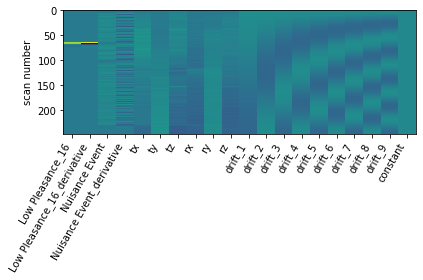

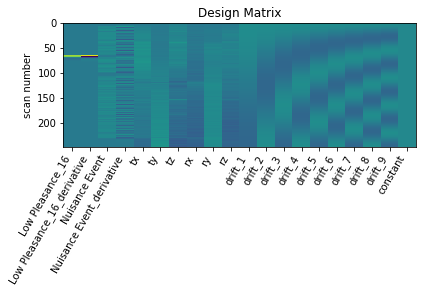

      0         1        2         3         4         5         6      \
0  1.120535 -1.361311 -1.46794 -0.930144 -0.185965  0.827721 -0.085683   

      7         8         9      ...     11447    11448     11449    11450  \
0 -1.002667 -0.472306 -0.472909  ... -1.903182 -1.40251 -1.486857  0.46331   

      11451     11452     11453     11454     11455     11456  
0  0.201004 -1.901997  1.762942 -0.873009 -0.552865 -0.351697  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_16
GLM RUN HighPleasance_17


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



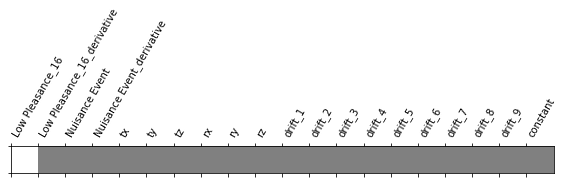

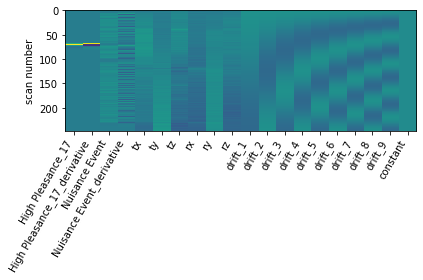

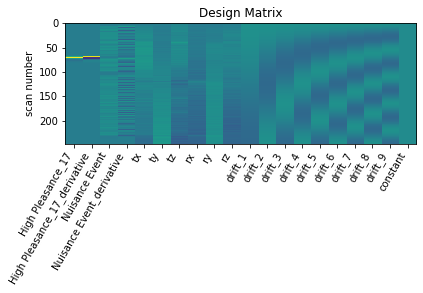

      0         1         2         3         4         5         6      \
0  0.547266  0.332959  0.434378 -0.270974 -0.755865  0.498603  0.786284   

      7         8         9      ...     11447     11448     11449    11450  \
0  1.805276  1.407072  0.886085  ...  0.430786  0.441708  0.473218 -0.69559   

      11451     11452    11453    11454     11455     11456  
0  0.999004  0.177914 -0.24096 -0.70482 -0.209141 -1.062871  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_17
GLM RUN HighPleasance_18


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



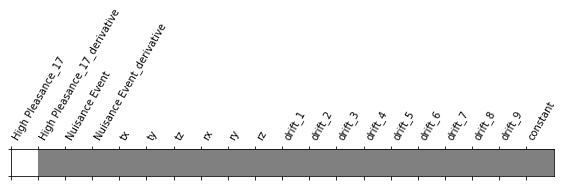

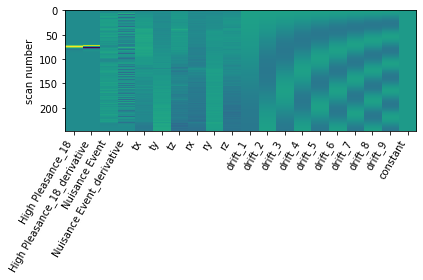

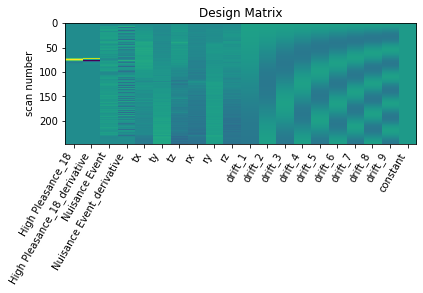

      0         1         2         3         4         5         6      \
0  1.490946 -1.155026  0.823272  0.909787  0.349221  1.063378  0.346574   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.532363  0.755988  0.892504  ... -0.282564 -0.159275 -0.672292  0.628496   

      11451     11452     11453     11454     11455     11456  
0 -0.683496 -0.870356  1.511735  0.164563 -0.399737  0.667792  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_18
GLM RUN HighPleasance_19


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



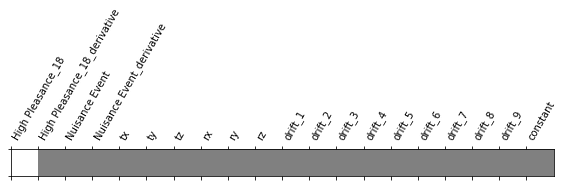

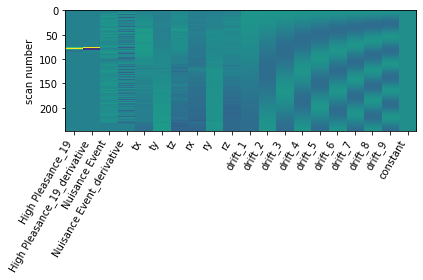

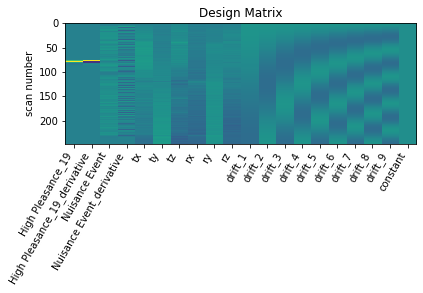

      0         1         2         3         4         5         6      \
0  1.034846 -1.653944 -1.088608 -0.802319 -0.436582  0.165427 -0.250158   

      7         8        9      ...     11447     11448     11449     11450  \
0 -0.418545  0.058925 -0.25066  ... -1.409143 -0.717663 -1.089154 -0.454619   

      11451     11452     11453     11454     11455     11456  
0  0.597977 -1.329367 -0.103812 -1.757853  1.086525 -1.162977  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_19
GLM RUN HighPleasance_20


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



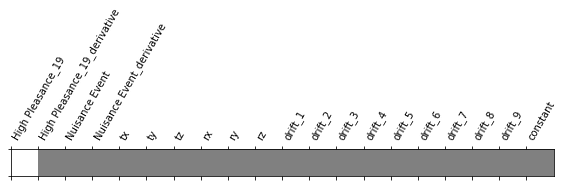

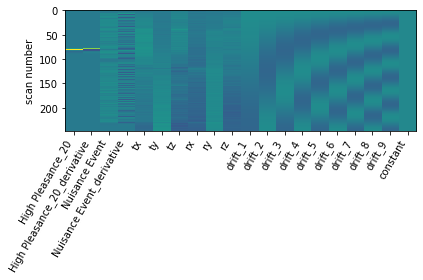

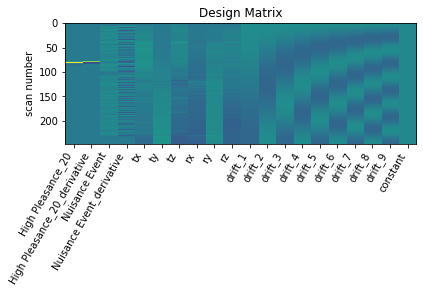

      0         1         2        3         4        5         6      \
0  1.121129  0.604472  0.641945  1.00171  1.266283  1.27906  0.994841   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.440662  1.352103  1.061257  ...  0.503388  0.696477  0.656623  0.067506   

     11451     11452     11453     11454     11455     11456  
0 -0.29756  1.315367  0.571387 -0.359654  1.487218  0.385016  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_20
GLM RUN HighPleasance_21


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



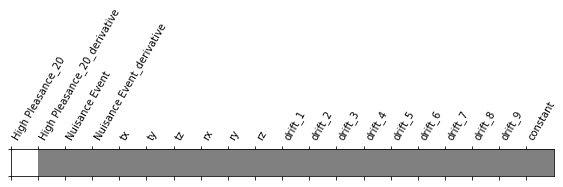

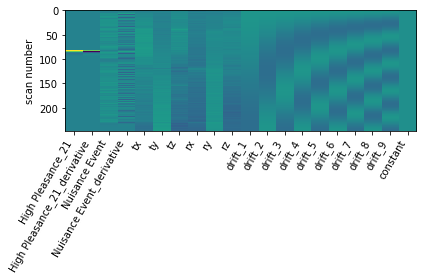

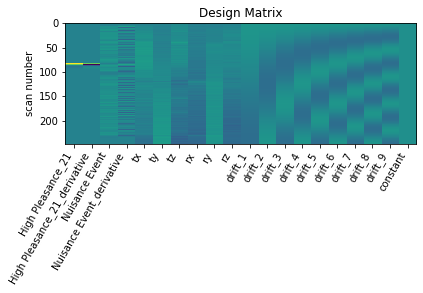

      0         1         2         3         4         5         6      \
0  0.806383  0.882063  1.075374  0.577609 -0.389352  0.857427  0.567329   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.685348  0.545757  1.002437  ...  1.311079  1.162396  0.657112 -0.407471   

     11451     11452     11453     11454    11455     11456  
0 -0.17247 -0.293337  0.907134  0.980364 -1.19768  0.759339  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_21
GLM RUN LowPleasance_22


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



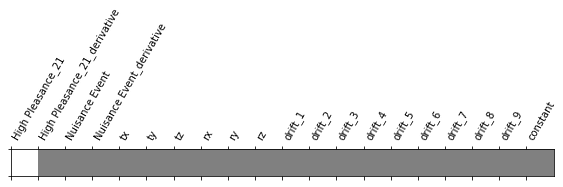

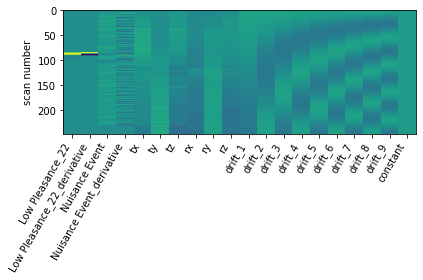

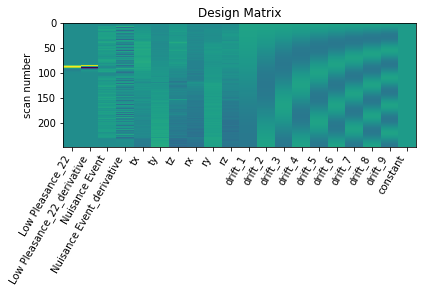

    0         1         2         3         4        5         6      \
0  1.1859 -2.740931 -0.406063 -0.147745 -0.153076  0.25626 -0.176894   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.030233  0.220094 -0.172194  ... -1.813232 -1.074515 -1.918606  0.606453   

      11451     11452     11453     11454     11455     11456  
0  0.483638 -1.717734  0.668279 -1.925652  0.465819 -1.361371  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_22
GLM RUN LowPleasance_23


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



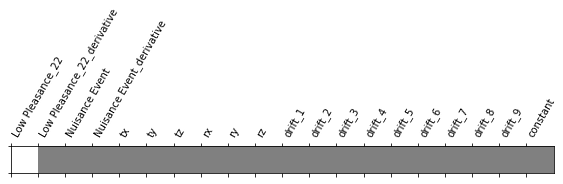

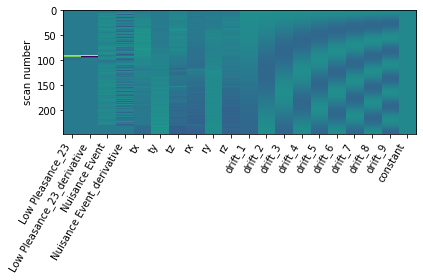

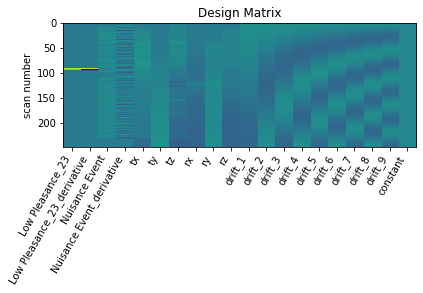

      0         1         2         3         4         5         6      \
0  1.136802  2.662103  1.691739  1.644519  1.483822  1.585333  0.201553   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.240671  0.673335  0.158789  ...  2.557515  1.886089  1.885425 -0.040904   

     11451     11452     11453     11454     11455     11456  
0 -0.13974  1.105604  1.022408  1.904157  0.820757  2.044335  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_23
GLM RUN HighPleasance_24


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



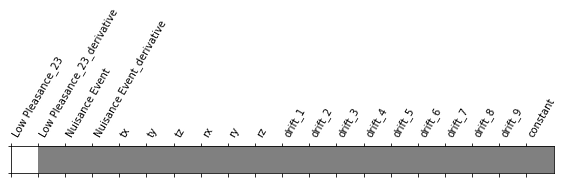

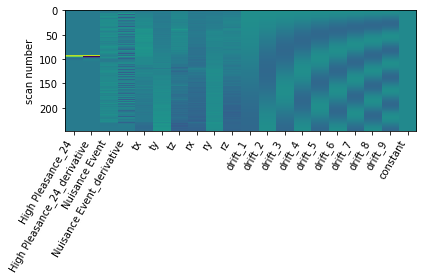

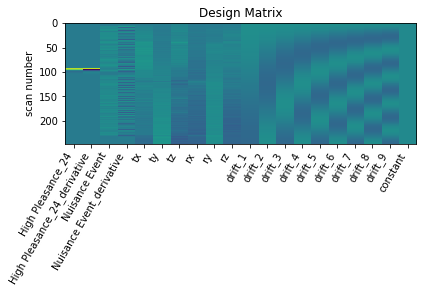

      0         1         2         3         4        5        6      \
0  1.096004  0.649085 -0.688238 -1.162993 -1.021424 -1.30142  1.94097   

      7         8         9      ...     11447     11448    11449     11450  \
0  0.385495 -0.639179  0.496786  ...  1.296138  1.600102  1.56752  0.041485   

      11451     11452     11453     11454     11455     11456  
0 -1.245441  1.049791  0.787715  1.217347  0.752724  1.156374  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_24
GLM RUN LowPleasance_25


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



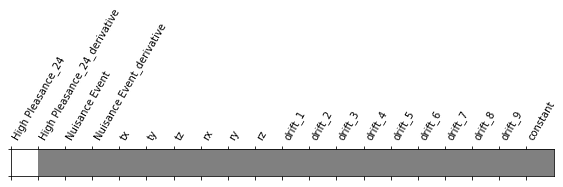

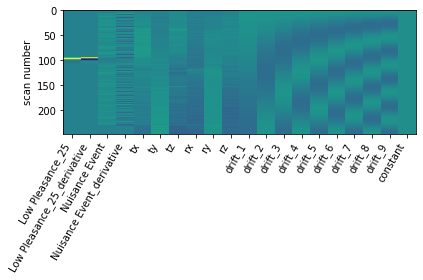

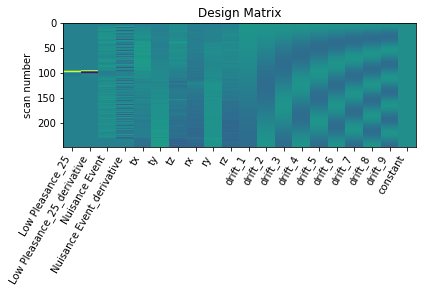

      0         1         2         3         4         5         6      \
0 -0.095341 -0.999323 -0.021866  0.044525  0.048195  1.330012 -0.737656   

      7        8         9      ...     11447    11448     11449     11450  \
0 -0.711484 -0.13422 -1.010701  ... -0.845593 -0.40385 -0.793072 -0.392508   

      11451     11452     11453     11454     11455     11456  
0  0.079479 -0.983333  0.748524 -1.066074 -0.472889 -0.557219  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_25
GLM RUN HighPleasance_26


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



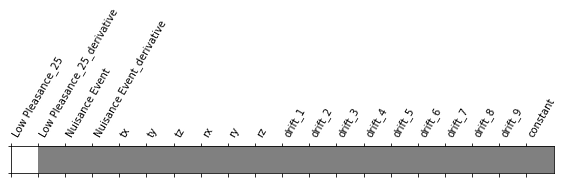

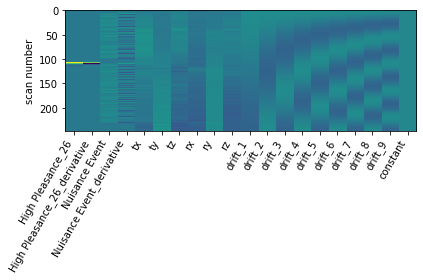

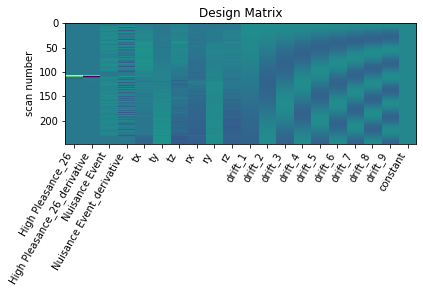

      0         1       2        3         4         5         6        7      \
0  2.118705  0.578167 -1.3816 -1.45953 -1.172185  1.029912  0.727792  0.76731   

      8         9      ...     11447     11448   11449     11450     11451  \
0  1.287049  1.096417  ...  0.156899  0.793483  0.1215  0.377219  0.689073   

      11452   11453     11454     11455     11456  
0 -0.125363  2.2897 -0.349082  0.277002  1.111203  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_26
GLM RUN HighPleasance_27


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



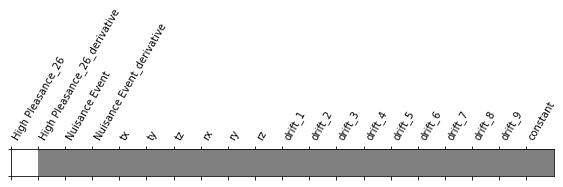

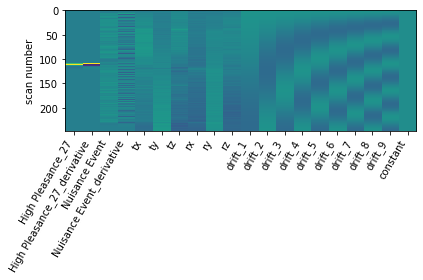

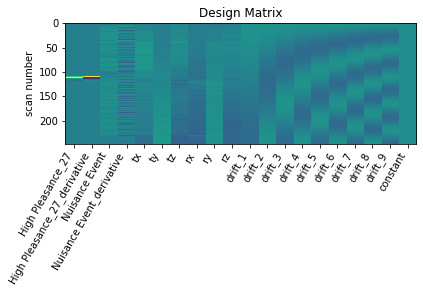

      0         1         2         3         4         5         6      \
0  0.457522 -2.109413 -1.326955 -1.302469 -1.345844  1.184884  0.711938   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.479928  1.491312  1.037212  ... -1.989065 -1.527155 -2.268418  0.325863   

      11451     11452     11453    11454     11455     11456  
0 -0.184074 -2.118519  0.087615 -1.95241  0.819215 -1.259462  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_27
GLM RUN LowPleasance_28


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



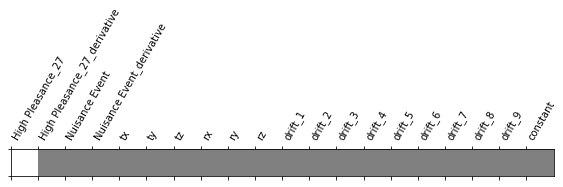

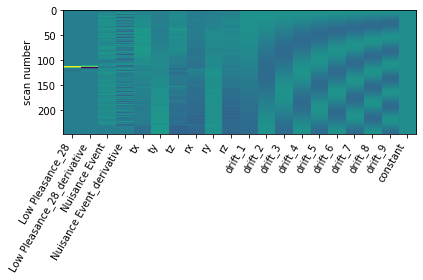

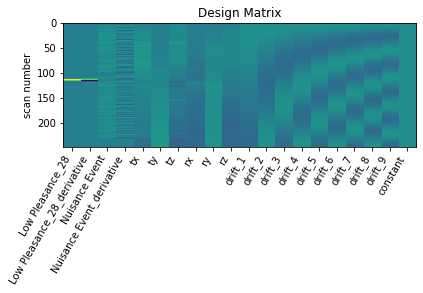

      0         1         2         3         4         5         6      \
0  0.094109 -0.485195  0.394463  0.289697  0.535853  0.157351  0.436215   

      7         8         9      ...    11447     11448     11449     11450  \
0  0.471783  0.653061  0.877258  ...  1.57287  1.140241  1.288824  0.005843   

      11451     11452     11453     11454     11455     11456  
0 -1.359548  0.370775  0.481305  1.272327  0.634223  0.151617  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_28
GLM RUN HighPleasance_29


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



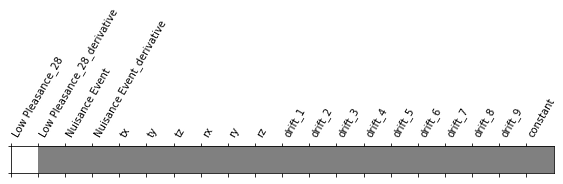

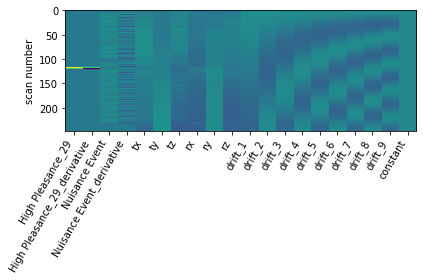

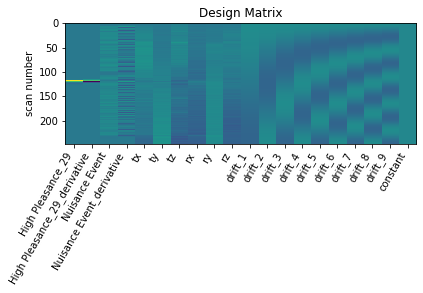

      0         1         2         3         4         5         6      \
0 -0.972609  0.781446  1.117923  1.248637  1.191391  0.404894  0.760695   

      7         8         9      ...     11447     11448    11449     11450  \
0  2.023661  1.437853  2.150893  ... -0.647766 -0.897325  0.14528  0.354654   

      11451     11452     11453     11454     11455     11456  
0  0.086283  0.597269 -0.857007  0.228787 -2.409998  1.374264  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_29
GLM RUN HighPleasance_30


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



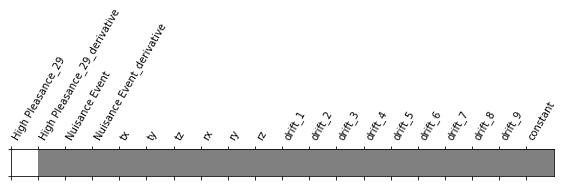

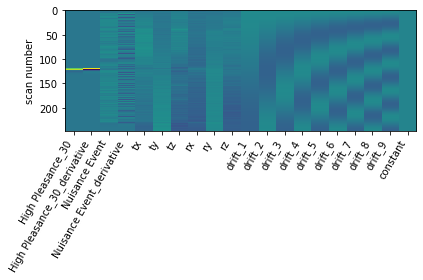

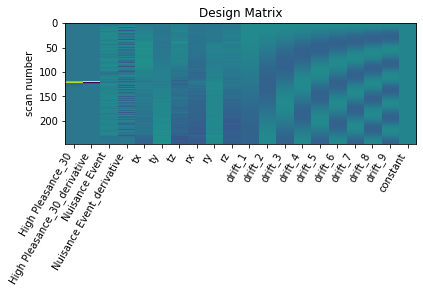

      0         1         2         3         4         5        6      \
0  1.393532 -0.736276  0.027731 -0.945942 -2.169481  1.319041  0.11674   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.089928  0.530074  0.319307  ... -0.570991 -0.177076  0.050421  0.890418   

      11451     11452     11453     11454     11455     11456  
0  0.727437 -0.422338  1.443343 -0.940446  1.321302 -0.999825  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_30
GLM RUN LowPleasance_31


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



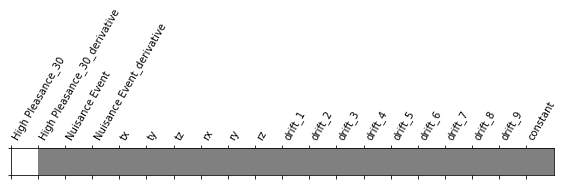

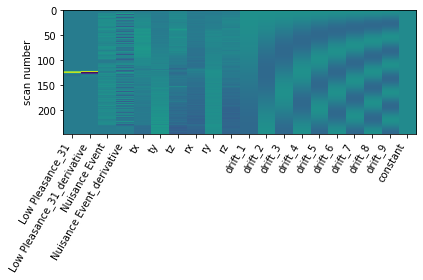

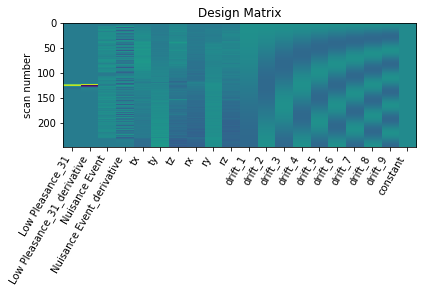

      0         1         2         3         4         5         6      \
0 -0.075148  2.038222  0.880691  1.648126  1.976912 -0.022239 -1.428991   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.565377 -1.217947 -1.620004  ...  0.443247  0.984875 -0.560673 -0.219913   

      11451     11452    11453    11454     11455     11456  
0  0.219061 -0.584355  1.42217  0.04615  0.609216  0.718518  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_31
GLM RUN LowPleasance_32


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



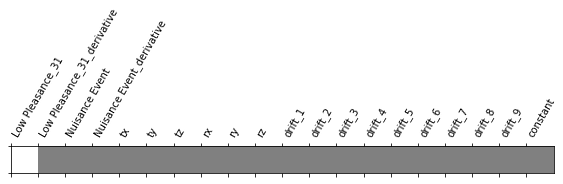

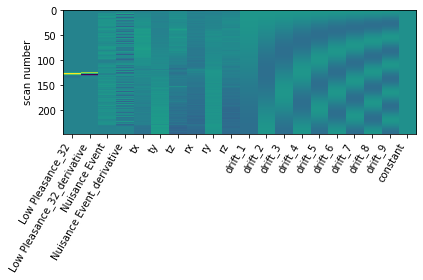

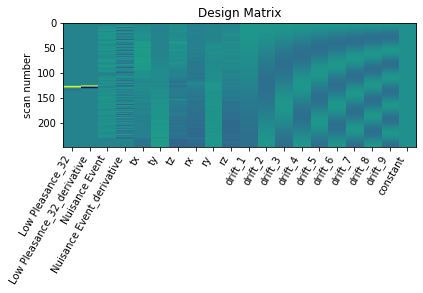

      0         1         2         3         4         5         6      \
0  1.358229 -0.913649  1.005317  0.653638 -0.018832  0.780546  0.606729   

      7         8         9      ...    11447    11448     11449     11450  \
0  1.100699  1.242247  1.416077  ...  0.93101  1.07512  0.445086 -1.346759   

      11451     11452     11453     11454     11455     11456  
0 -0.958711 -0.128578 -0.537117  0.101127 -0.488332 -0.521383  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_32
GLM RUN HighPleasance_33


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



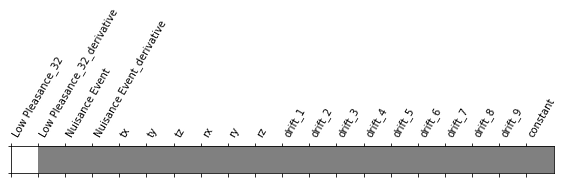

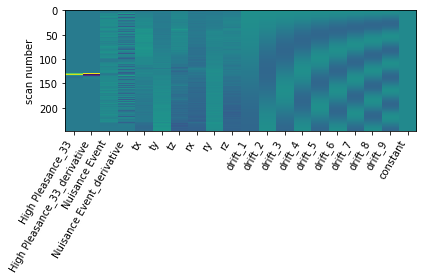

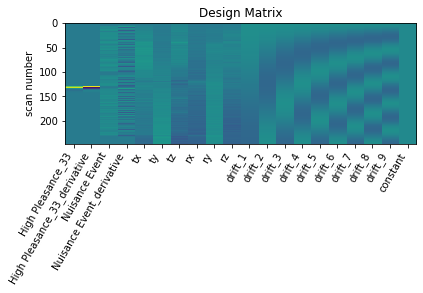

      0         1         2         3         4         5         6      \
0  1.680035 -0.121741  0.026868 -0.209677 -0.221358  2.065618  0.497162   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.891242  1.326807  0.660706  ... -1.179138 -1.247962 -1.254752 -0.499099   

      11451     11452     11453     11454     11455     11456  
0  0.603216 -0.787292  0.877919 -1.346701  0.719844  1.050521  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_33
GLM RUN LowPleasance_34


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



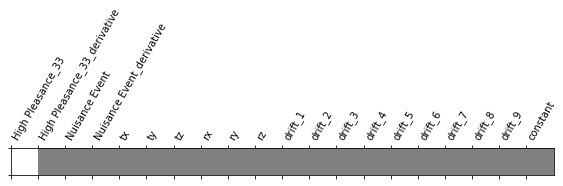

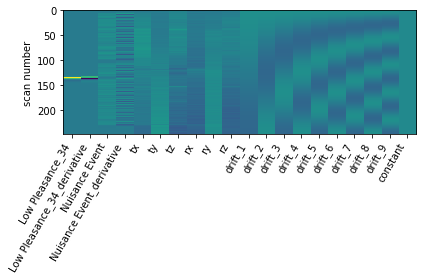

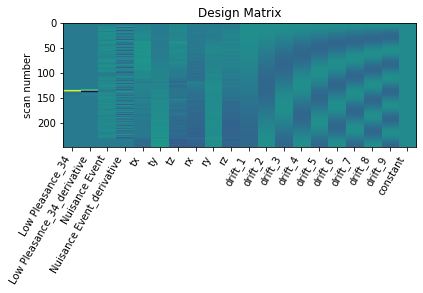

      0         1         2         3         4         5         6      \
0  2.693066 -0.454966  0.727435  0.801751  0.619554  0.484389  0.107311   

      7         8         9      ...     11447     11448     11449    11450  \
0  0.062116  0.581822  0.519848  ...  1.050319  1.864107  0.291123  1.17898   

     11451     11452     11453     11454     11455     11456  
0  0.05313 -0.481632  1.912371 -0.049757  0.819495 -1.030133  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_34
GLM RUN LowPleasance_35


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



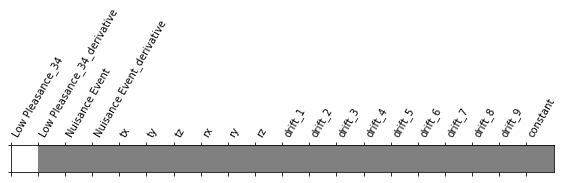

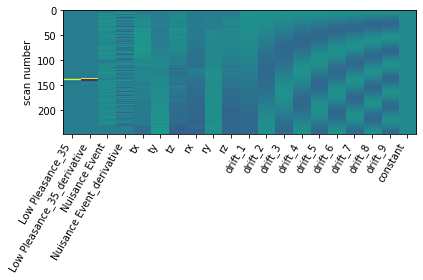

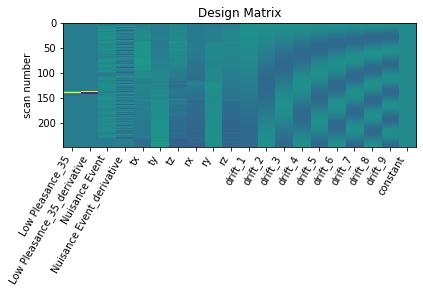

      0         1         2         3         4        5         6      \
0 -0.210386  1.096336  0.137616  0.186497 -0.154975  0.22659 -1.309048   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.233289 -0.088542 -0.227181  ... -0.451087 -0.561774  0.090287 -0.130263   

      11451     11452     11453     11454     11455     11456  
0  0.328615 -0.084745 -1.036282 -0.092864  0.541025 -0.240487  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_35
GLM RUN LowPleasance_36


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 19 seconds



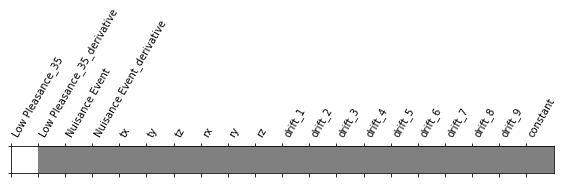

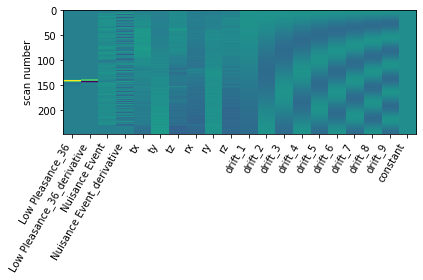

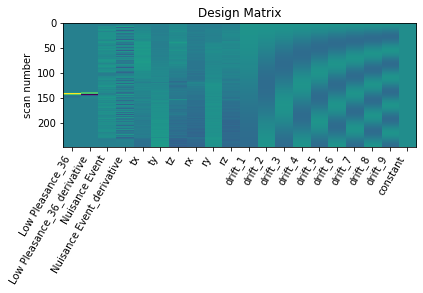

      0         1         2         3        4         5         6      \
0  1.519575 -1.959831  0.376809  1.006511  1.57461  1.033049  3.794251   

     7         8         9      ...     11447     11448    11449    11450  \
0  2.30421  1.417899  1.473142  ...  0.544192  0.525749  0.03742 -0.98207   

      11451    11452     11453     11454    11455     11456  
0 -0.645904  0.50304  1.940518  0.314558  0.67783  1.204046  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_36
GLM RUN LowPleasance_37


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



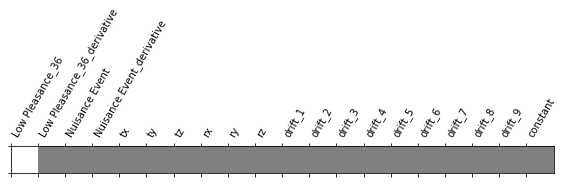

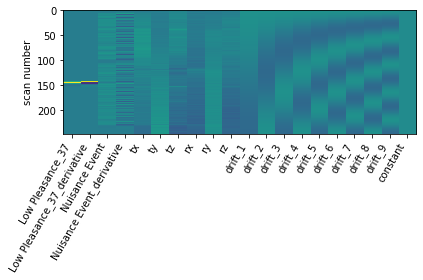

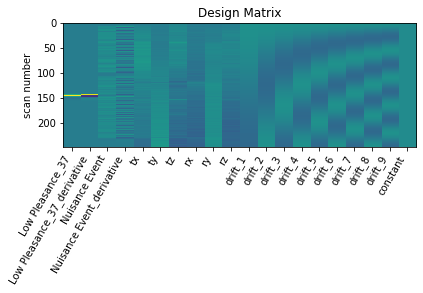

     0         1         2         3         4         5        6      \
0  1.04697 -0.543749  0.009598 -0.696936 -1.019968  1.477992  0.37076   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.750211  1.282974  0.930061  ...  0.179352  0.434545  0.717258  0.460926   

      11451     11452     11453     11454     11455     11456  
0 -0.674469 -0.488206 -0.359411 -0.425749 -0.955309 -1.212915  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_37
GLM RUN LowPleasance_38


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



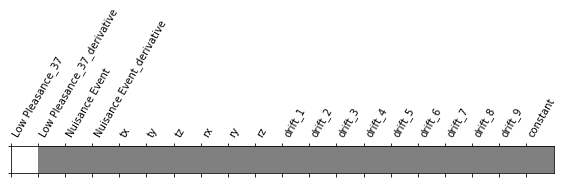

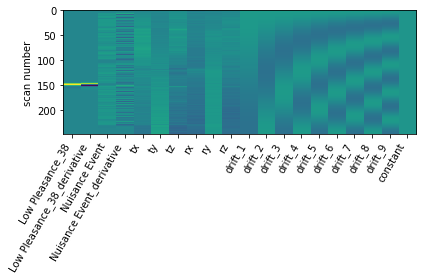

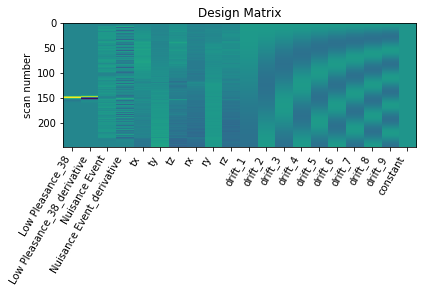

      0         1         2        3         4         5         6      \
0 -0.319306  0.191602  0.160565  0.38718  0.267857  0.324741 -0.792141   

      7         8        9      ...     11447     11448     11449     11450  \
0  0.404473  0.662475  0.31893  ... -0.121614  0.035287 -0.560587 -0.499877   

      11451     11452     11453     11454     11455    11456  
0  0.634241 -0.390169  1.152129  0.194656  0.534758  0.75514  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_38
GLM RUN HighPleasance_39


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



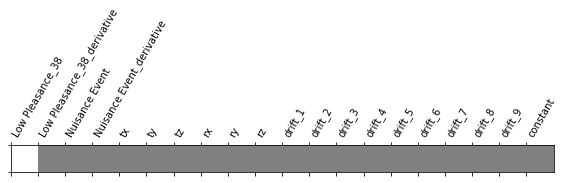

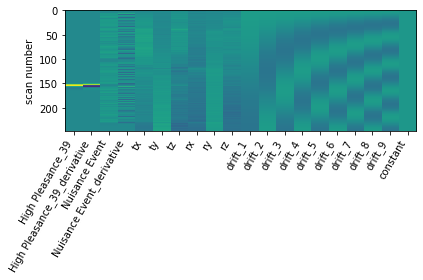

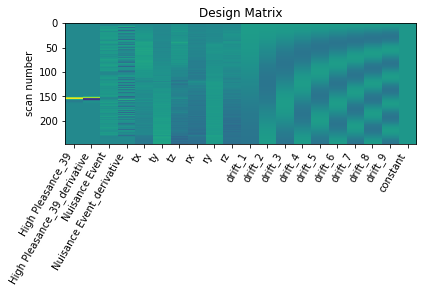

     0         1         2         3         4         5         6      \
0  2.13224 -0.888173  1.360372  1.124055  0.698485  1.349282  0.554647   

      7         8         9      ...     11447    11448     11449     11450  \
0  0.029369  0.364128 -0.463841  ... -0.496472  0.12989 -1.119468  0.684443   

      11451     11452     11453     11454    11455    11456  
0 -0.017954 -0.725739  1.219242 -1.614459 -0.25677 -0.94507  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_39
GLM RUN HighPleasance_40


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



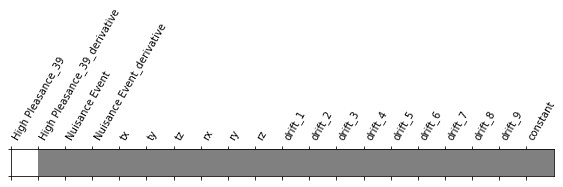

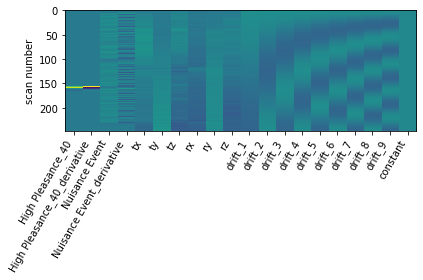

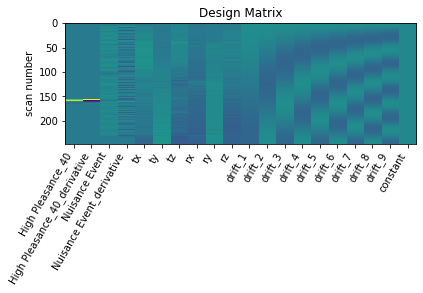

      0         1         2         3         4         5         6      \
0  1.012798  0.131719  0.565762  0.800109  0.393514  0.577176 -1.282017   

      7         8         9      ...     11447     11448     11449    11450  \
0  0.043753  0.837425  0.513858  ... -0.931839 -0.898233 -0.599898 -0.38611   

      11451     11452    11453     11454     11455     11456  
0  1.658068 -0.988371  0.18876 -0.774029  0.027885 -1.114028  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_40
GLM RUN HighPleasance_41


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



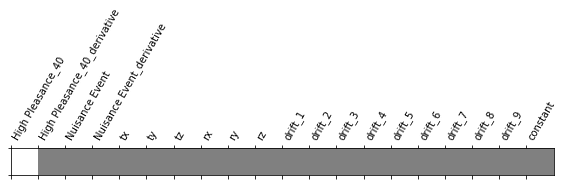

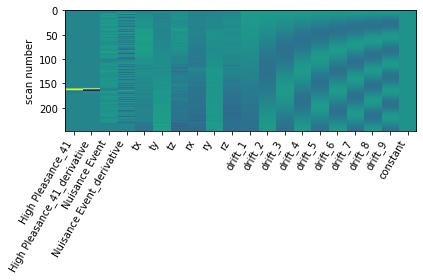

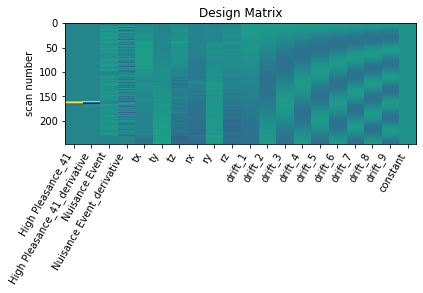

      0         1         2         3         4         5         6      \
0  0.000198 -1.154322 -0.901157 -0.370272  0.171726  0.902269  1.267459   

      7         8         9      ...     11447     11448     11449    11450  \
0  0.510929  0.429734  0.425138  ...  1.012884  1.568517  0.589294  0.04743   

      11451    11452     11453    11454     11455     11456  
0 -1.589189  0.13375  0.822593  0.67608  0.132344  1.046601  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_41
GLM RUN HighPleasance_42


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



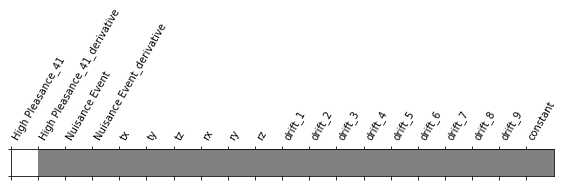

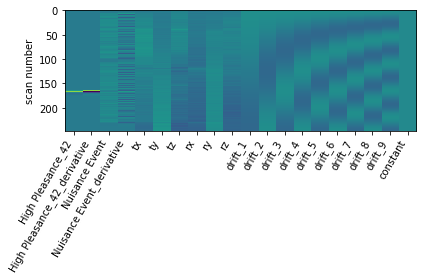

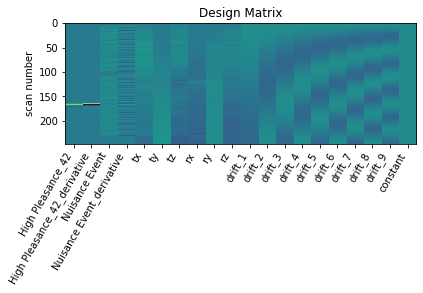

      0         1         2         3         4         5         6      \
0  1.102358  0.443239  1.326726  0.769248  0.194774  1.766275  0.678583   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.357854  1.843146  0.865315  ... -0.592791 -0.850269 -0.651228  0.255194   

      11451     11452    11453     11454     11455     11456  
0  1.944713 -0.718483 -0.13414 -0.856837  0.837104 -0.712983  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_42
GLM RUN HighPleasance_43


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



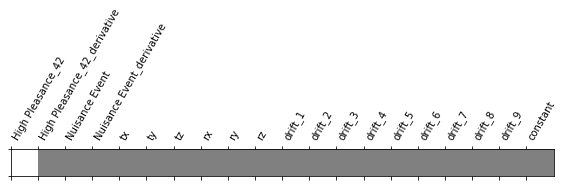

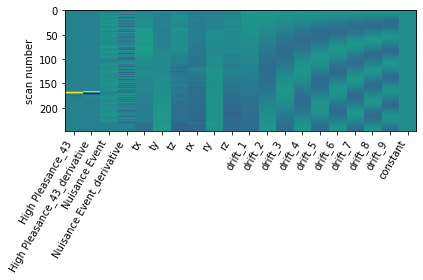

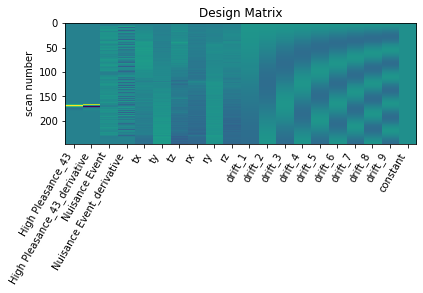

      0         1         2         3         4         5         6      \
0  0.704193  0.262689  0.247228  0.314337 -0.206041  0.228832 -0.646462   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.396337 -0.309822 -0.573573  ... -0.553488 -0.039206 -0.939325 -0.877361   

     11451     11452     11453     11454     11455   11456  
0 -0.74133 -1.544037  1.298632 -1.051489 -0.978858 -0.3687  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_43
GLM RUN HighPleasance_44


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



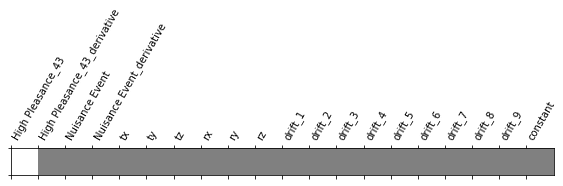

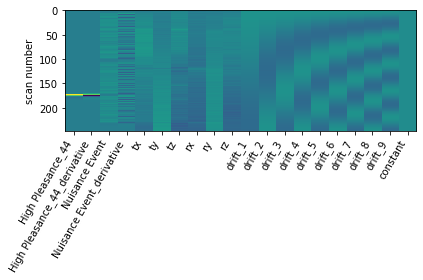

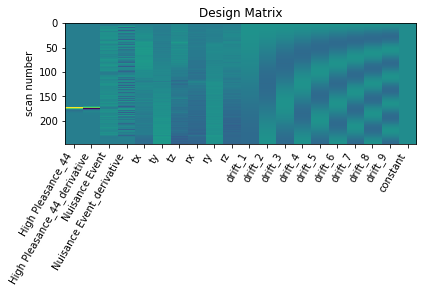

      0         1         2         3         4         5         6      \
0  1.288066 -0.801367 -0.399529 -0.239226  0.019122  1.661564  1.181875   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.219123  1.698666  1.048108  ...  1.526306  1.669566  1.289485 -0.377983   

      11451     11452     11453     11454     11455     11456  
0 -0.237924  0.597523  1.513129  0.873174  0.864222  1.113739  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_44
GLM RUN HighPleasance_45


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



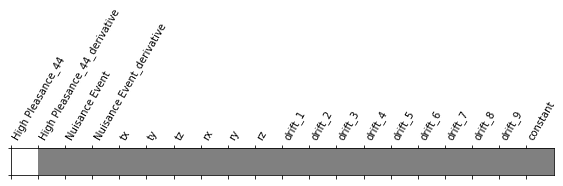

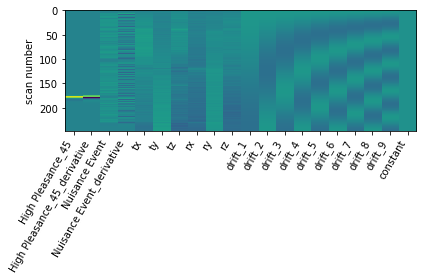

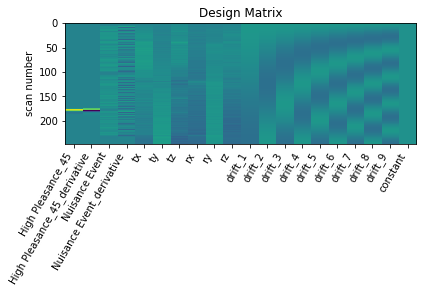

      0         1         2         3        4        5       6         7      \
0  1.066385 -0.281877  0.496915  0.143068 -0.54025  0.42953 -1.1333 -0.428331   

      8         9      ...     11447     11448     11449     11450     11451  \
0  0.046029 -0.107764  ... -0.716834 -0.422665 -1.179654  0.362747  1.301637   

      11452     11453     11454     11455    11456  
0 -1.161284  0.118785 -1.171579  0.020253 -0.74578  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_45
GLM RUN HighPleasance_46


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



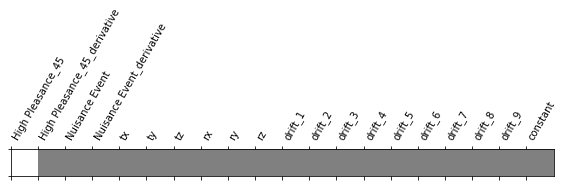

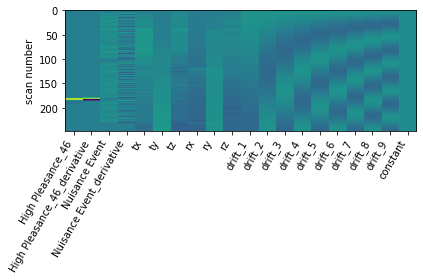

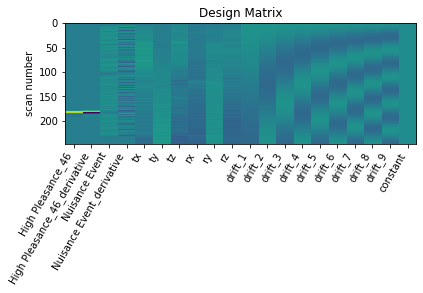

      0         1        2         3         4         5         6      \
0  1.235094 -0.451389 -0.43492  0.174105  0.490037  1.059053  0.713491   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.388546  0.473965 -0.184683  ...  0.777225  1.005046  0.435139 -0.255244   

      11451     11452     11453     11454     11455     11456  
0 -0.798211  0.379802  0.642537  0.301457  0.255717  0.705874  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_46
GLM RUN HighPleasance_47


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



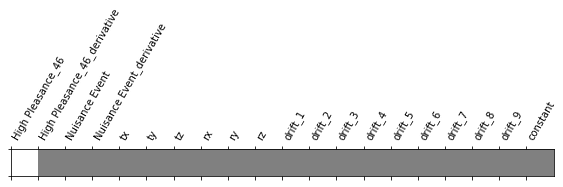

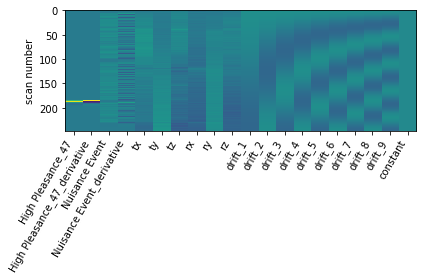

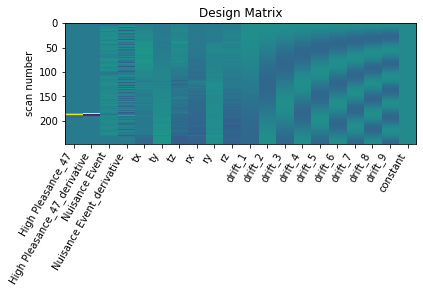

      0         1         2         3         4         5         6      \
0  1.361918  0.515828  1.167232  1.265441  1.070871 -0.232892 -0.489613   

      7        8         9      ...     11447     11448     11449     11450  \
0  0.090546  0.33101  0.677754  ... -1.141356 -1.539946 -1.615816  0.053296   

      11451     11452    11453     11454     11455     11456  
0  2.556937 -0.849042  0.05167 -1.089594 -0.409991 -1.259852  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_47
GLM RUN HighPleasance_48


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



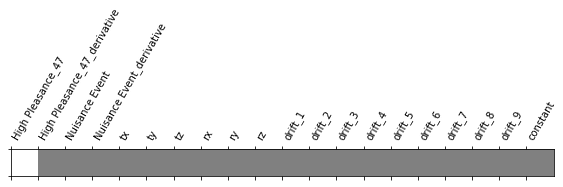

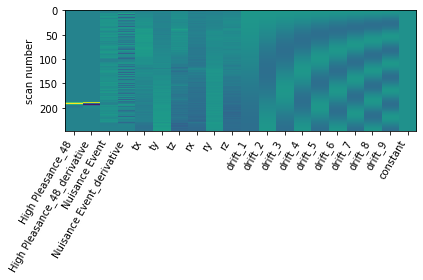

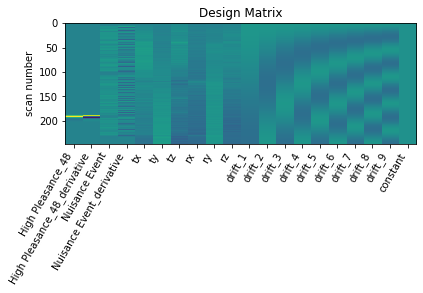

      0         1         2         3        4         5         6      \
0  1.657157 -1.454248 -0.779929 -1.160171 -1.53583  1.207799  0.419622   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.323153  0.413034  0.178189  ...  1.365382  2.192615  1.293267 -0.499488   

     11451     11452    11453     11454     11455     11456  
0 -0.64732  0.734046  1.10048  1.090644  0.649395  1.256693  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_48
GLM RUN LowPleasance_49


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 27 seconds



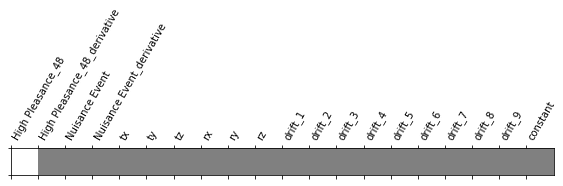

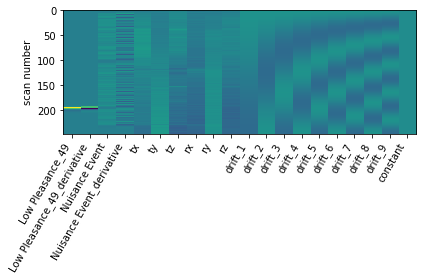

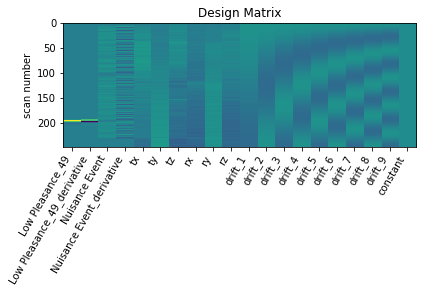

      0         1         2         3         4         5         6      \
0  0.606806 -0.080895  0.269657  0.805313  1.106572  1.588744  0.738398   

     7         8         9      ...     11447    11448     11449     11450  \
0  1.45195  1.703059  0.902463  ... -0.915015 -1.39922 -1.655649 -1.256291   

      11451     11452     11453     11454     11455     11456  
0  0.074228 -0.972802  0.675393 -1.491209  0.846916 -0.457168  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_49
GLM RUN LowPleasance_50


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



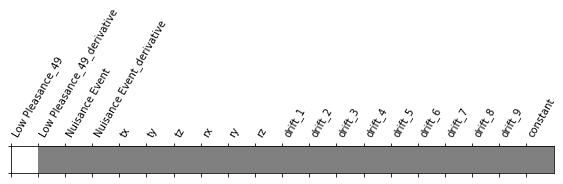

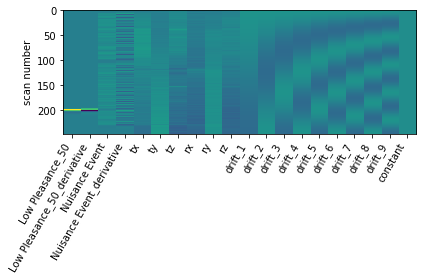

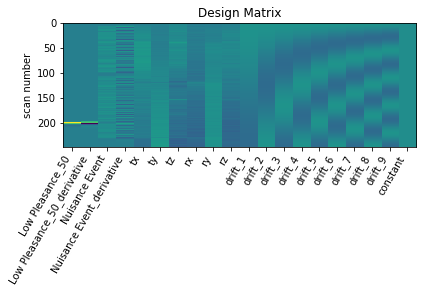

      0        1         2         3         4         5         6      \
0  0.004189 -0.73756  1.356808  0.908522  0.260528 -0.273929  0.142405   

      7         8        9      ...     11447     11448   11449     11450  \
0  0.045174 -0.070335  0.23928  ... -0.298545  0.293918  0.1606  2.015154   

      11451     11452     11453     11454     11455     11456  
0  0.096881 -0.728035  1.606632 -0.073773 -0.350579 -0.282262  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_50
GLM RUN LowPleasance_51


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



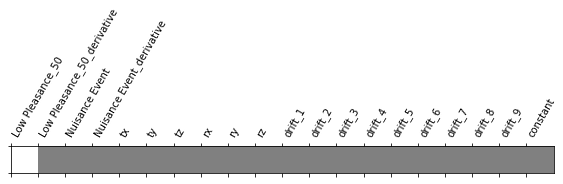

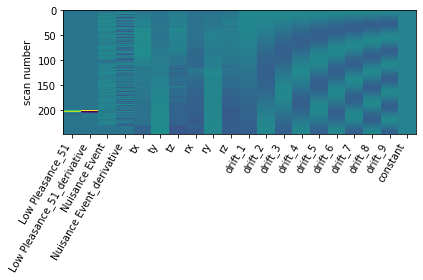

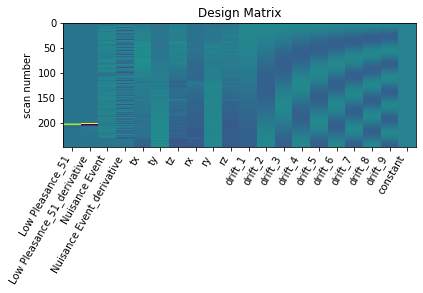

     0         1        2         3         4         5         6      \
0  0.99179  0.451286  1.10802  1.294824  1.378373  2.016203  0.439399   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.074529  0.309413 -0.007234  ...  0.977519  0.797834  0.846063 -0.667292   

    11451     11452     11453     11454     11455     11456  
0 -0.6223  0.469297 -1.565046  1.007106  0.921967  0.584938  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_51
GLM RUN LowPleasance_52


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



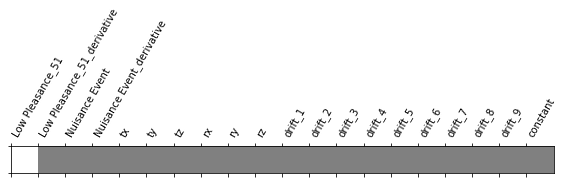

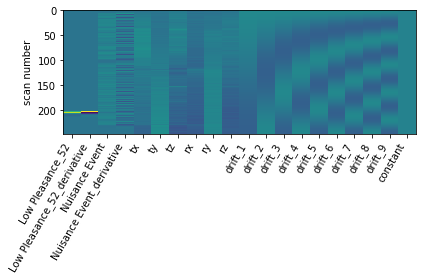

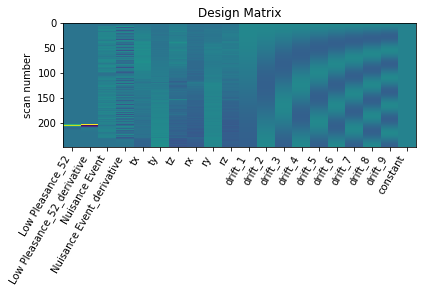

      0        1         2         3         4         5         6      \
0  0.700047  0.64647 -0.438611 -0.440432 -0.251204  0.818167  1.560207   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.832981  1.336867  1.186975  ...  2.721628  2.551646  2.204932 -0.391801   

      11451     11452     11453     11454    11455     11456  
0 -0.140418  2.337642  1.505099  2.004788  1.36515  1.273103  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_52
GLM RUN HighPleasance_53


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



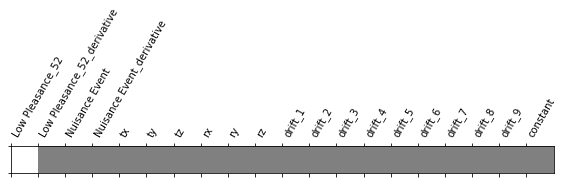

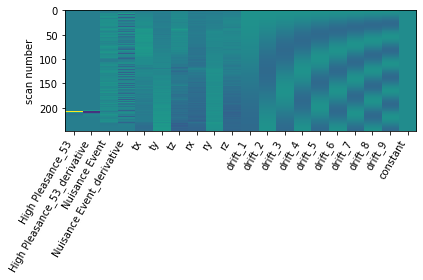

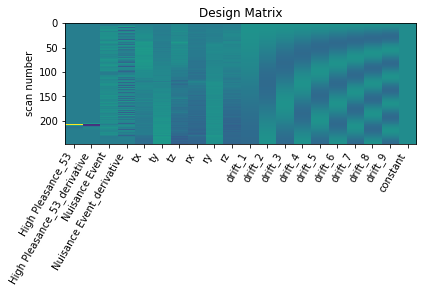

      0         1         2         3         4         5         6      \
0  0.795696 -2.040974 -0.798669 -0.559839 -0.559004  0.509672 -0.134075   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.292937  0.617762  0.116234  ... -2.443026 -1.634881 -2.399668 -0.258073   

      11451     11452     11453     11454     11455     11456  
0  0.440576 -3.131432  1.363709 -2.614802 -1.945821 -0.551645  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_53
GLM RUN HighPleasance_54


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



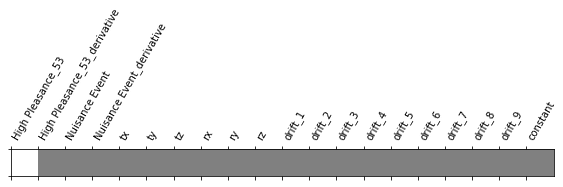

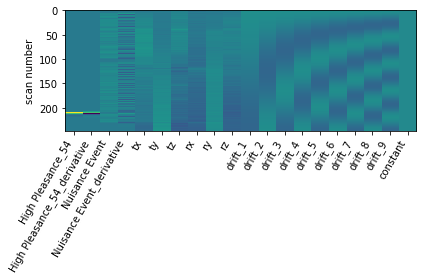

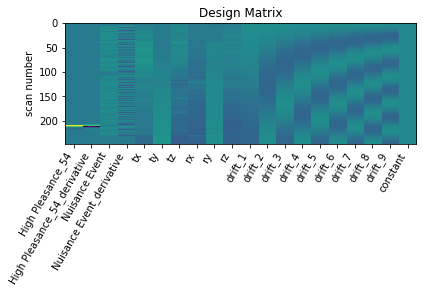

     0         1         2         3         4         5         6      \
0 -0.05364 -0.965913  0.872122  0.277126 -0.503627 -0.064649 -0.218864   

      7         8         9      ...     11447     11448     11449    11450  \
0 -0.442112 -0.528177  0.177165  ... -0.781046 -0.840962 -1.148892  0.21343   

      11451     11452     11453    11454     11455     11456  
0 -0.314658 -0.671434 -0.607122 -0.74081  0.477074 -0.189222  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_54
GLM RUN LowPleasance_55


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



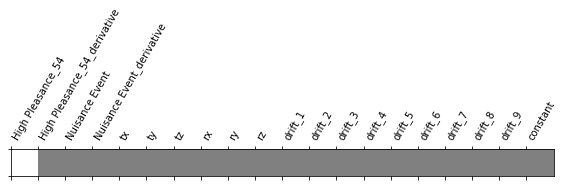

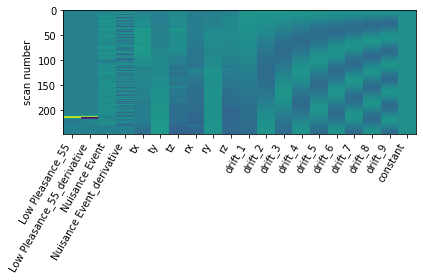

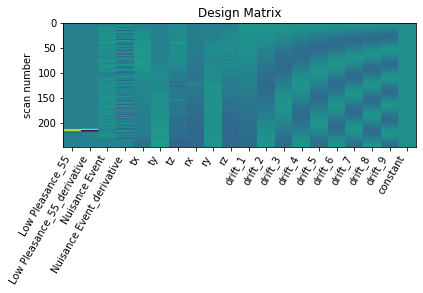

      0        1         2         3         4         5         6      \
0  1.746225  1.08332  0.993261  1.339037  1.695799  1.872246  1.017718   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.099084  1.665583  0.323848  ...  0.870709  1.051339  0.803578 -0.019131   

      11451     11452     11453     11454     11455     11456  
0 -0.260935  0.535286  1.341484  0.521732  1.195908  0.101165  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_55
GLM RUN LowPleasance_56


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



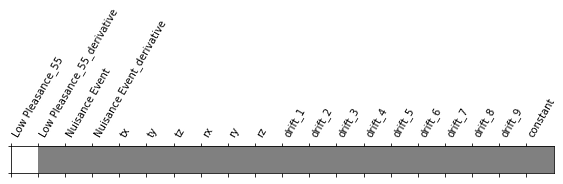

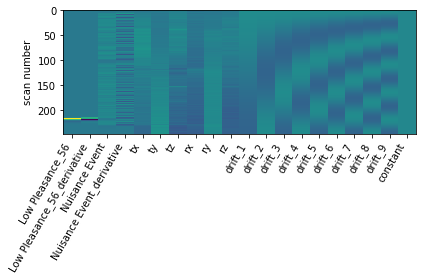

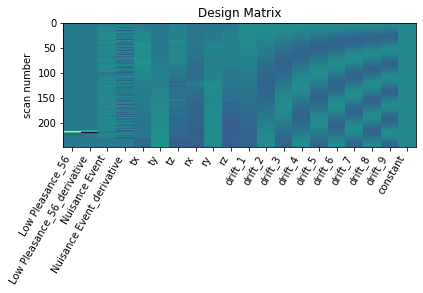

      0         1         2         3         4         5         6      \
0 -0.163411 -0.830576 -0.774939 -0.706875 -0.757644 -0.071107  0.395744   

      7         8         9      ...     11447     11448     11449    11450  \
0  0.728059  0.033628  0.385254  ...  0.174669  0.806238 -0.189822  0.48385   

      11451     11452    11453     11454     11455     11456  
0 -0.713891 -0.826255  0.29521 -0.750699  0.209864 -0.115621  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_56
GLM RUN HighPleasance_57


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



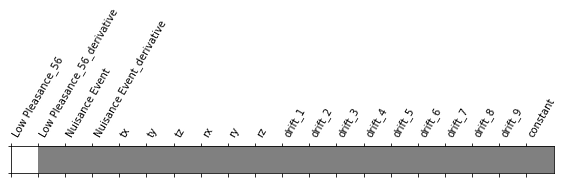

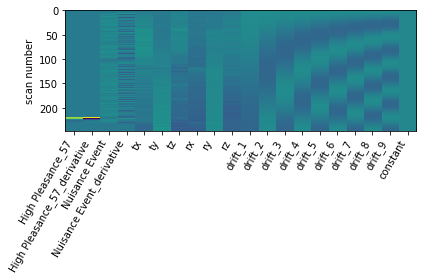

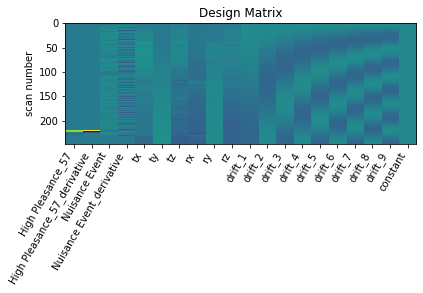

      0         1         2         3         4        5        6      \
0  1.050577 -1.819764 -0.081091 -0.193282 -0.286657  1.51561  0.17958   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.377141  0.925475  0.857711  ... -0.920629 -1.097737 -0.542119 -0.935872   

      11451     11452     11453    11454     11455     11456  
0  0.590418  0.044763  0.657706  0.57686 -0.967125  1.090197  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_57
GLM RUN LowPleasance_58


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



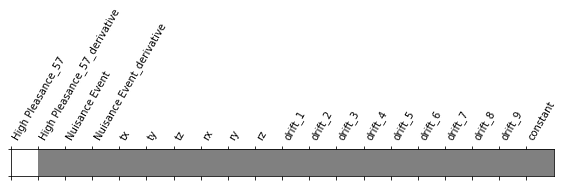

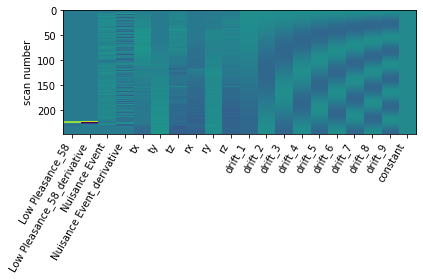

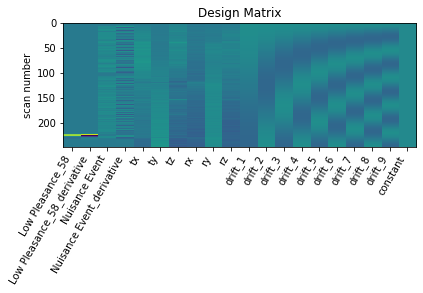

      0         1         2         3         4         5         6      \
0  2.785586  0.183572  0.983748  1.193106  1.043512 -0.599348 -0.505046   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.646118 -0.429124 -0.042764  ... -0.528549  0.056274 -0.889745  0.321086   

      11451     11452     11453     11454     11455     11456  
0 -0.323655 -0.802189  0.624571 -1.898284  1.947749 -0.555679  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_58
GLM RUN LowPleasance_59


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



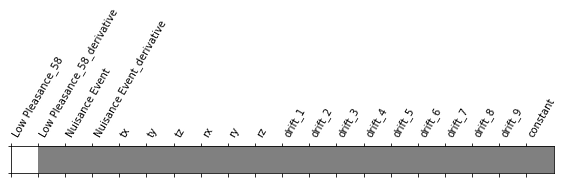

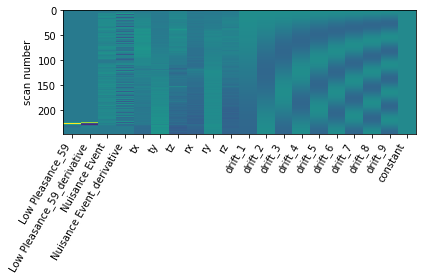

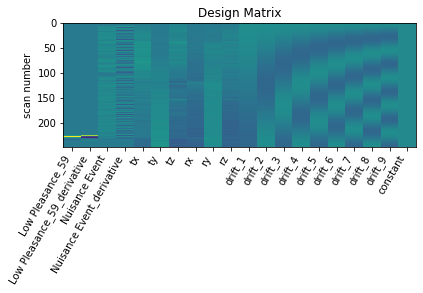

      0         1        2         3         4         5         6      \
0  0.074646  0.751013 -0.31283 -0.547272 -0.685735  0.345243 -0.292227   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.633408  0.598768  0.423867  ...  0.899373  0.885288  0.284102  0.940996   

      11451     11452     11453     11454     11455    11456  
0 -0.137752  0.127417  0.000393  0.190899 -0.288367  0.15921  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_59
GLM RUN HighPleasance_60


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



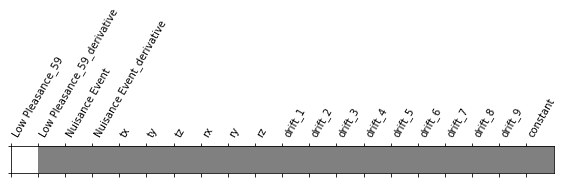

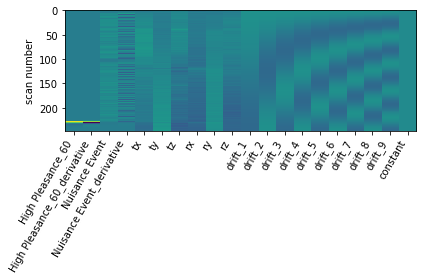

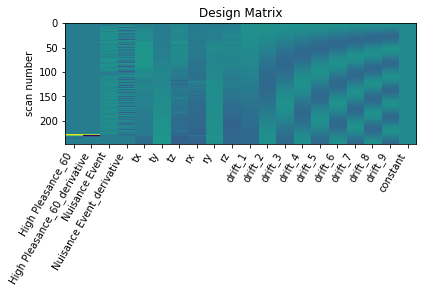

    0        1         2        3         4         5         6         7      \
0 -1.4958 -0.20868 -1.176301 -1.19918 -1.194762  0.330624 -0.193201  0.248797   

      8         9      ...     11447     11448     11449     11450     11451  \
0 -0.024796 -0.110713  ... -0.367599 -0.572868 -0.323949 -1.002214  0.648628   

      11452     11453     11454    11455     11456  
0 -0.531768 -1.242372  0.394237 -0.51408 -0.452413  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_60


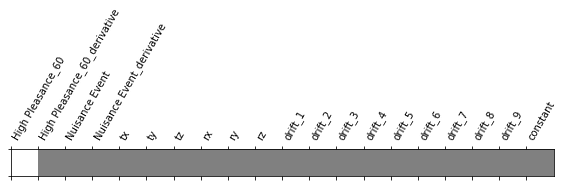

In [ ]:
y_fo_pa, X_fo_pa = lss_separate_method_comp(task =task,
                          data_path=data_path,
                          events_path=events_path,
                          motion_param_path=motion_param_path,
                          cache_mem_path=cache_mem_path,
                          activity_mat_saving_path=activity_mat_saving_path,
                          analysis_type=analysis_type,
                          param_modulation=False,
                          t_r=t_r,
                          drift_model=drift_model,
                          drift_order=drift_order,
                          hrf_model=hrf_model,
                          pre_whitening_spec=pre_whitening_spec,
                          apply_trans_mask=apply_trans_mask,
                          roi_img=roi_img,  
                          hpf_cut=hpf_cut,
                          smoothing_fwhm=smoothing_fwhm,
                          standardize=standardize,
                          detrend=detrend,minimize_memory=minimize_memory)

In [ ]:
y_g.append(y_fo_pa)
X_g.append(X_fo_pa)

In [ ]:
X_fo_pa.shape

(60, 11457)

### Houses Task

### Run AP

In [ ]:
data_path = 'ses-19/func/wrdcsub-01_ses-19_task-PreferenceHouses_dir-ap_bold.nii.gz'
events_path = 'ses-19/func/sub-01_ses-19_task-PreferenceHouses_dir-ap_events.tsv'
motion_param_path = 'ses-19/func/rp_dcsub-01_ses-19_task-PreferenceHouses_dir-ap_bold.txt'
task = 'Houses'

In [ ]:
analysis_type = 'High_Low_Pleasance'
hrf_model = 'spm + derivative'
param_modulation = False
drift_model='cosine'
t_r=2
drift_order=None
apply_trans_mask=True
roi_img = mask_img
standardize=True
detrend=True
minimize_memory = True
activity_mat_saving_path = 'mvpa/test2'

events = pd.read_csv(events_path,sep='\t')

# onset shift in order to capture the very moment of the appreciation decision
events['onset'] = events['onset']-1

onset_periods = [events['onset'][i+1] - events['onset'][i]  for i in range(len(events['onset']))if (i<len(events['onset'])-1)]
onset_periods = np.array(onset_periods)
onset_freq = np.reciprocal(onset_periods)
hpf_cut = np.min(onset_freq)/2 # cf High Pass Filtering Rule of Thumb ( fMRI Handbook 2011)

Event 0
      onset  duration       trial_type
0    10.474     4.155  Low Pleasance_1
1    18.173     5.657   Nuisance Event
2    26.988     4.347   Nuisance Event
3    32.338     4.398   Nuisance Event
4    40.970     5.517   Nuisance Event
5    47.435     3.805   Nuisance Event
6    54.651     4.112   Nuisance Event
7    59.567     4.122   Nuisance Event
8    66.166     3.324   Nuisance Event
9    70.149     4.963   Nuisance Event
10   77.998     3.051   Nuisance Event
11   82.247     2.270   Nuisance Event
12   85.047     3.993   Nuisance Event
13   92.263     2.412   Nuisance Event
14   97.362     2.084   Nuisance Event
15  102.261     2.360   Nuisance Event
16  106.277     5.276   Nuisance Event
17  115.443     6.156   Nuisance Event
18  125.958     5.542   Nuisance Event
19  132.907     3.707   Nuisance Event
20  138.906     3.060   Nuisance Event
21  143.105     3.656   Nuisance Event
22  150.721     2.849   Nuisance Event
23  156.120     4.638   Nuisance Event
24  162.036     2

59  391.771     4.202    Nuisance Event
Event 55
      onset  duration         trial_type
0    10.474     4.155     Nuisance Event
1    18.173     5.657     Nuisance Event
2    26.988     4.347     Nuisance Event
3    32.338     4.398     Nuisance Event
4    40.970     5.517     Nuisance Event
5    47.435     3.805     Nuisance Event
6    54.651     4.112     Nuisance Event
7    59.567     4.122     Nuisance Event
8    66.166     3.324     Nuisance Event
9    70.149     4.963     Nuisance Event
10   77.998     3.051     Nuisance Event
11   82.247     2.270     Nuisance Event
12   85.047     3.993     Nuisance Event
13   92.263     2.412     Nuisance Event
14   97.362     2.084     Nuisance Event
15  102.261     2.360     Nuisance Event
16  106.277     5.276     Nuisance Event
17  115.443     6.156     Nuisance Event
18  125.958     5.542     Nuisance Event
19  132.907     3.707     Nuisance Event
20  138.906     3.060     Nuisance Event
21  143.105     3.656     Nuisance Event
22  150.

Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



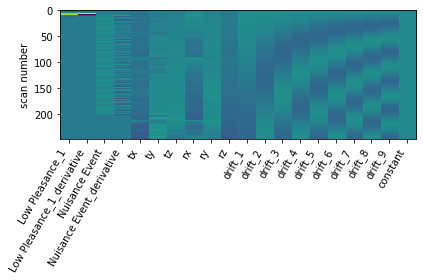

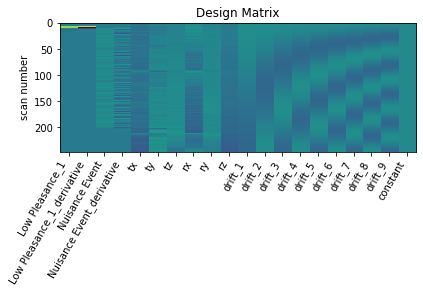

      0         1         2         3         4         5         6      \
0  1.033792  0.032101  0.425073  0.913275  1.192288  1.288678  0.985599   

     7         8         9      ...    11447     11448    11449     11450  \
0  1.39111  1.454943  1.049587  ... -0.04148  0.053662  0.24396  1.246022   

      11451   11452    11453     11454     11455     11456  
0  0.397965 -0.6304 -0.31958 -0.681838 -1.032235 -0.404111  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_1
GLM RUN HighPleasance_2


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



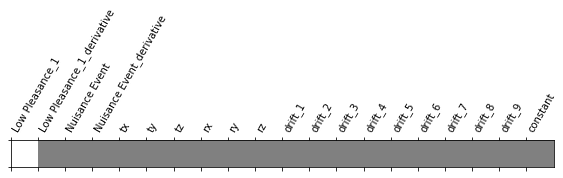

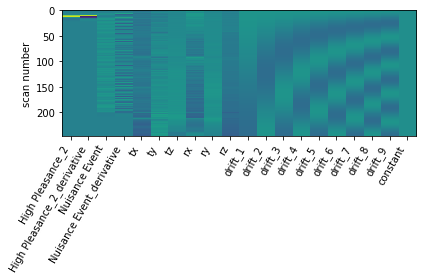

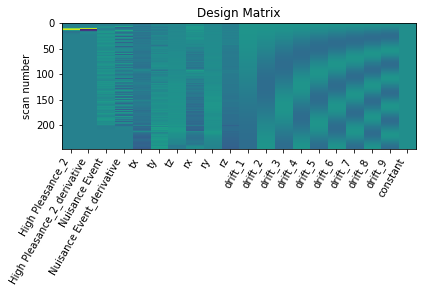

     0         1         2         3         4         5         6      \
0  0.66917 -0.651721  0.746191  0.445452 -0.109567  0.295827  0.435624   

      7         8         9      ...     11447     11448     11449    11450  \
0  0.997264  1.061899  1.293038  ... -0.993179 -1.227243 -0.448906  0.47609   

      11451     11452     11453     11454     11455     11456  
0  0.697165 -0.133009  0.126468 -0.275023  0.978966 -1.116683  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_2
GLM RUN HighPleasance_3


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



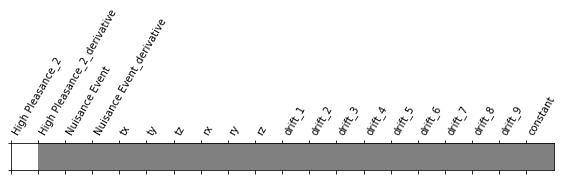

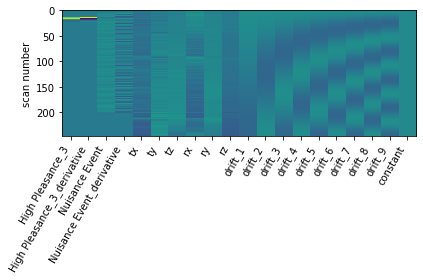

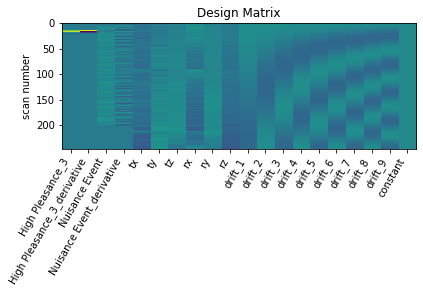

      0         1         2         3         4        5         6      \
0  1.260544  0.235226  0.179685  0.539813  0.695385  1.19595  0.314643   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.001373  1.484892  0.817059  ... -0.974773 -0.838008 -0.466497  0.561121   

      11451     11452     11453     11454     11455     11456  
0  0.028523 -0.134945 -0.426824 -1.492896 -0.465984 -1.248585  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_3
GLM RUN LowPleasance_4


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



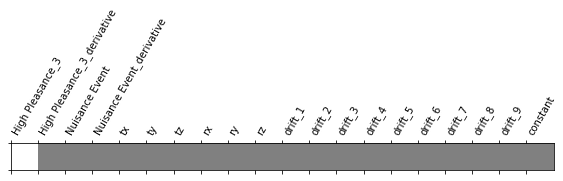

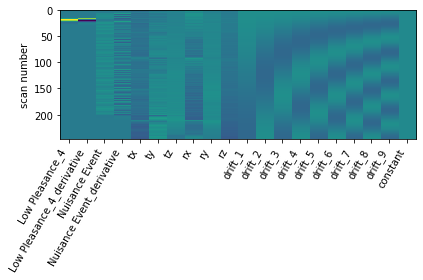

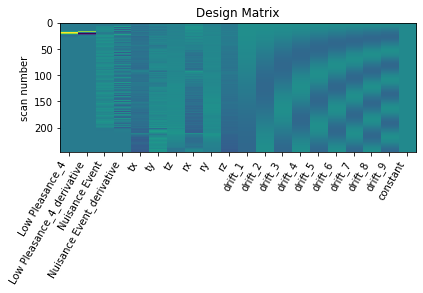

      0         1        2         3         4         5         6      \
0  0.651165 -1.524403  0.15759 -0.030803 -0.187192  0.322302  1.016932   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.246201  0.948814  1.653359  ... -1.005137 -1.126455 -0.569541  1.012035   

      11451     11452    11453     11454     11455     11456  
0  0.794961 -1.303784  0.00041 -0.446658  0.593808 -0.416922  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_4
GLM RUN HighPleasance_5


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



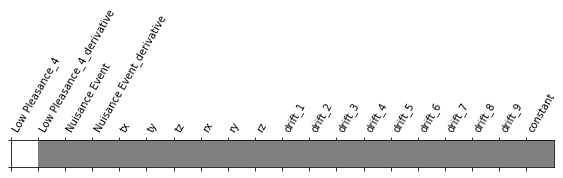

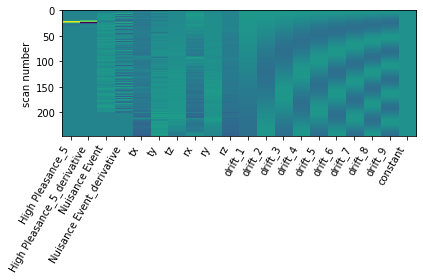

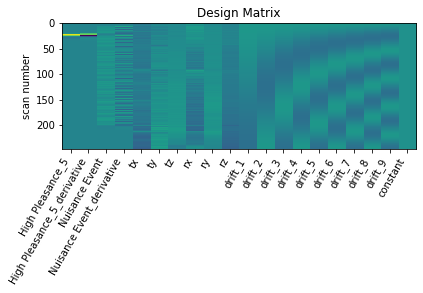

      0         1         2         3         4         5         6      \
0  1.576942 -0.191039 -0.046144  0.044948 -0.229668  1.174295  0.819722   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.172153  1.146858  1.350595  ... -1.409849 -1.126747 -0.654493  0.956524   

      11451     11452     11453     11454     11455     11456  
0  0.694948 -0.590574 -0.300466 -1.105439 -0.926189 -1.574107  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_5
GLM RUN LowPleasance_6


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



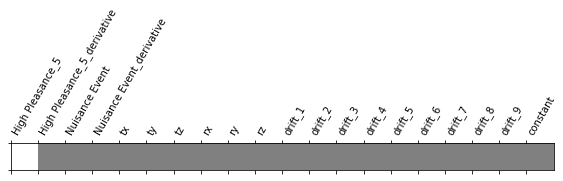

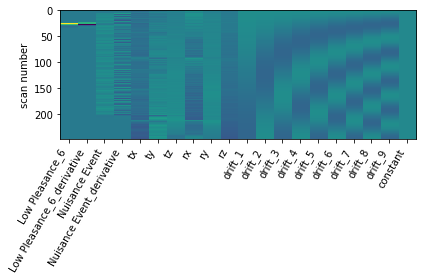

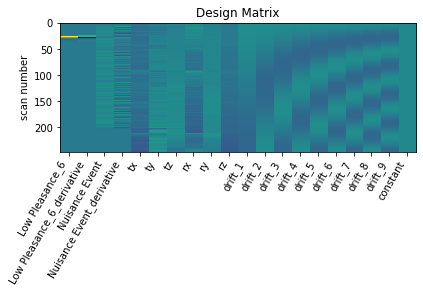

     0        1         2         3         4         5         6      \
0  0.58065 -0.50128  0.108303  0.104126  0.209059  0.211839  0.553052   

      7         8        9      ...     11447     11448     11449     11450  \
0  1.244719  1.085131  1.15874  ... -0.794546 -0.750535 -0.304481  0.975365   

    11451     11452     11453     11454     11455    11456  
0 -0.1278 -0.759371 -0.172798 -0.771304  0.673475 -0.29797  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_6
GLM RUN HighPleasance_7


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



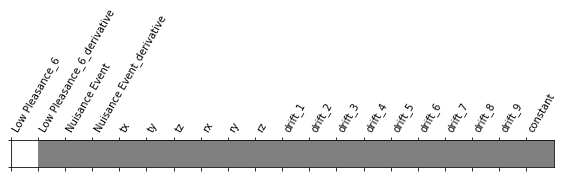

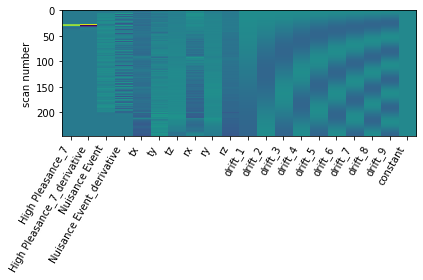

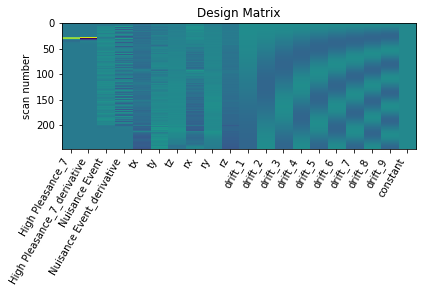

      0         1         2         3         4         5         6      \
0  0.711481 -0.341606 -0.228657  0.522342  0.674412  1.390206  0.688256   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.097226  1.238706  1.080379  ... -1.312424 -1.270477 -1.197851  0.307123   

      11451     11452     11453     11454     11455     11456  
0  1.288521 -1.153358  0.042588 -0.962331 -1.072895 -0.950323  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_7
GLM RUN LowPleasance_8


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



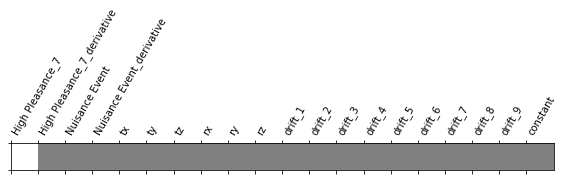

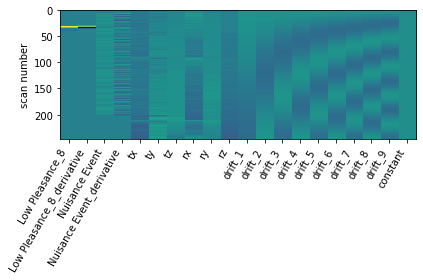

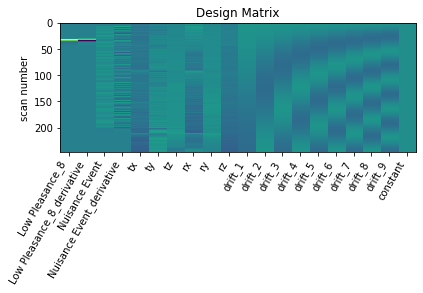

      0         1        2         3         4         5         6      \
0  0.754976 -0.948743  0.01091 -0.311246 -0.627007 -0.209137  0.282353   

      7         8         9      ...    11447     11448     11449     11450  \
0  0.219088  0.020399  0.776094  ... -1.09903 -0.617818 -0.220652  0.288915   

      11451     11452     11453     11454     11455    11456  
0  1.018786 -0.704699 -0.246951 -1.521471  0.244178 -0.79875  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_8
GLM RUN HighPleasance_9


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



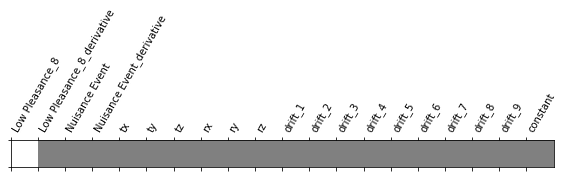

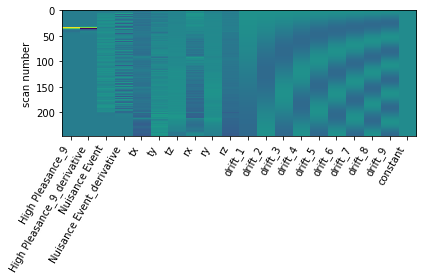

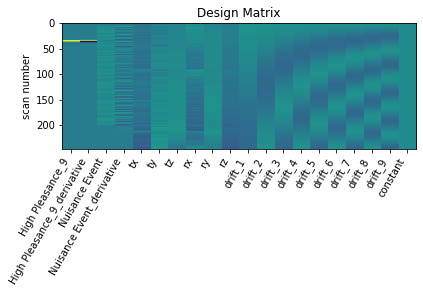

      0       1         2         3         4         5         6      \
0  1.759355  0.2889  0.707069  0.995416  1.295236  1.041386  0.910888   

      7         8        9      ...     11447     11448     11449     11450  \
0  1.749635  1.657094  1.38696  ...  0.270814 -0.085491  0.319928  0.726214   

      11451     11452     11453     11454    11455     11456  
0 -0.364783  0.394612  0.529715  0.584724 -0.23752 -0.103306  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_9
GLM RUN HighPleasance_10


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



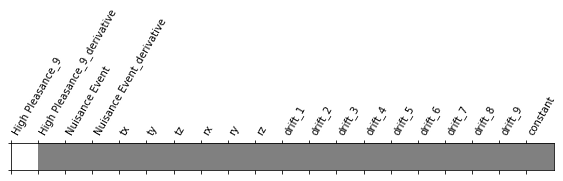

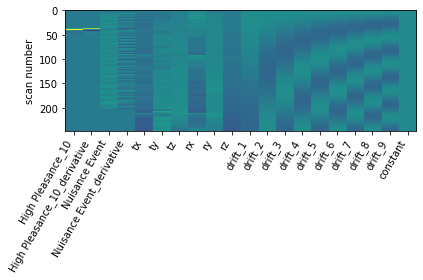

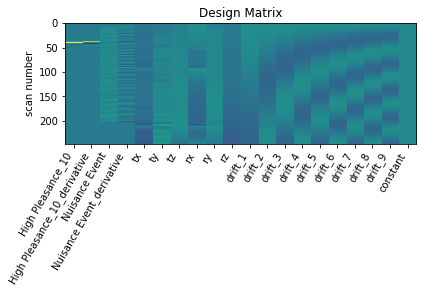

      0         1         2         3         4         5         6      \
0  0.250545 -1.477663  0.187685  0.399852  0.163116  1.549638  1.150463   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.433117  1.408465  0.858428  ... -2.188923 -1.911562 -1.431182  1.205566   

      11451     11452     11453     11454     11455     11456  
0  1.930274 -1.556538  0.103909 -1.898294 -1.082535 -1.637752  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_10
GLM RUN LowPleasance_11


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



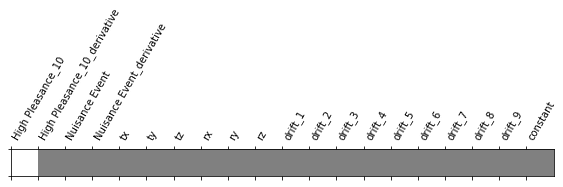

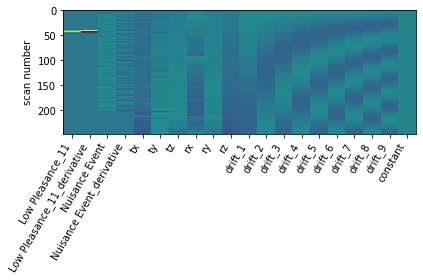

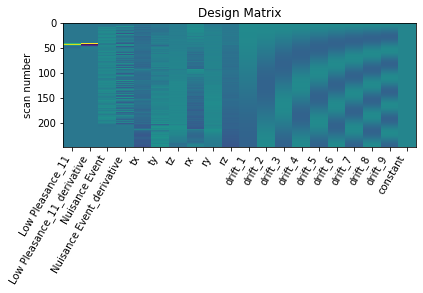

      0         1         2         3         4         5         6      \
0  2.035874  0.266327 -0.621241 -0.556771 -0.222418  0.044417 -0.186974   

      7        8         9      ...     11447     11448     11449     11450  \
0  0.242769  0.66534  1.299689  ... -0.704803 -0.654643 -0.612961  0.594653   

      11451     11452     11453     11454     11455     11456  
0 -0.400692 -0.828399 -0.513843 -0.472349  0.700236 -1.021115  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_11
GLM RUN LowPleasance_12


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



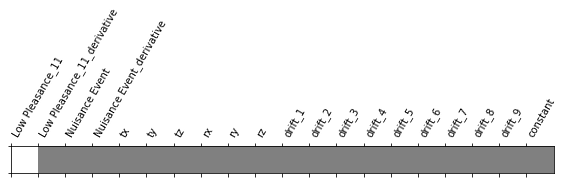

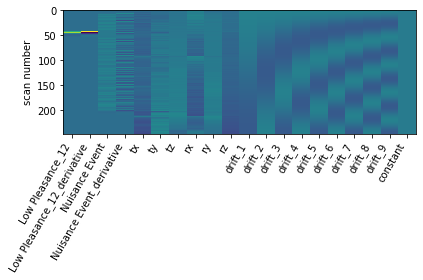

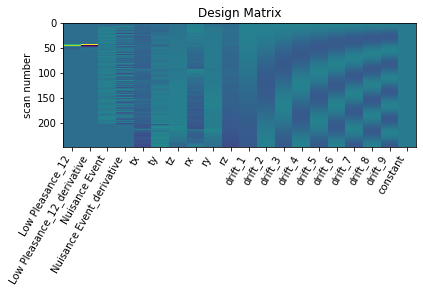

      0         1         2         3         4         5        6      \
0  0.554247 -0.193865  0.027947  0.282057  0.557728  0.427957  0.36594   

      7         8         9      ...     11447     11448     11449    11450  \
0  1.040881  1.334858  0.632857  ...  0.482942  0.085133  0.405924  0.68639   

      11451     11452     11453     11454     11455     11456  
0  0.948494  0.203929 -0.092458  0.369104 -0.043058 -0.103402  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_12
GLM RUN HighPleasance_13


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



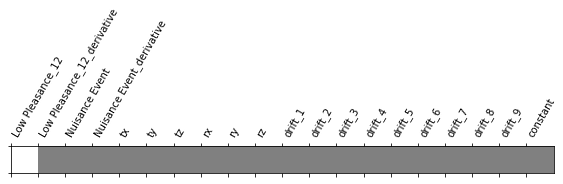

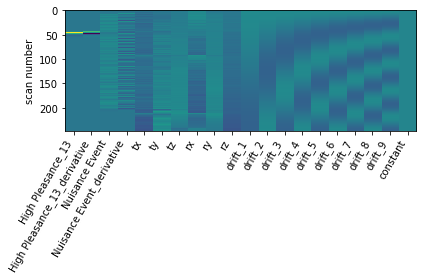

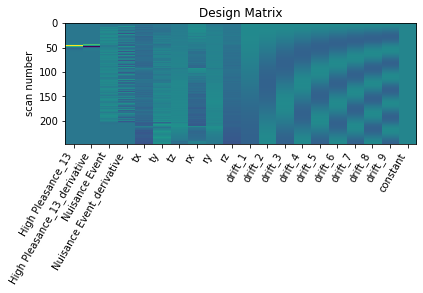

      0         1         2         3         4         5         6      \
0 -0.434184 -0.260955  0.204006  0.522335  0.522732  0.189621 -0.657807   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.211083 -0.144712 -0.601335  ... -1.422166 -2.159549 -1.106782 -0.934568   

      11451     11452     11453     11454     11455     11456  
0  0.376874 -0.599359 -0.499568 -0.644436 -1.357238 -1.206647  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_13
GLM RUN LowPleasance_14


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 19 seconds



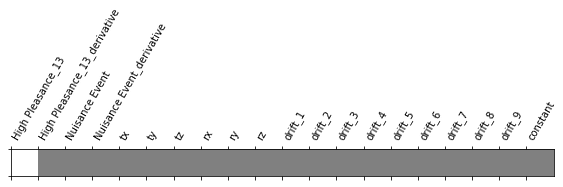

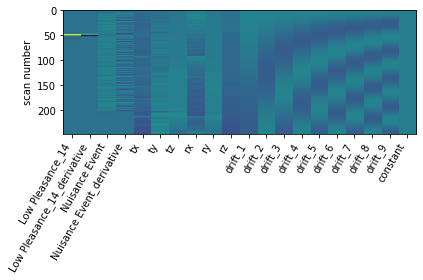

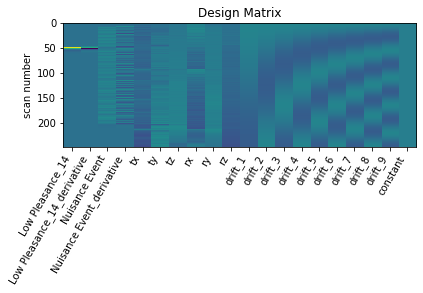

      0         1         2         3         4         5         6      \
0  0.048092  0.999117  0.407996 -0.574033 -1.178209  0.183758 -0.594146   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.446472 -0.067719 -0.082749  ... -1.572236 -1.619115 -0.726538  1.345734   

      11451     11452     11453     11454     11455     11456  
0  0.533485 -0.742207  0.569252 -1.290725  1.377843 -0.521472  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_14
GLM RUN LowPleasance_15


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



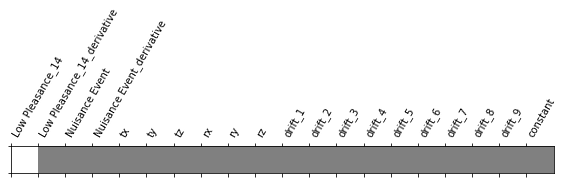

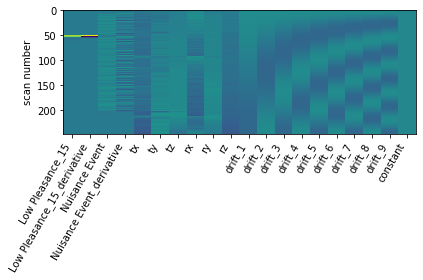

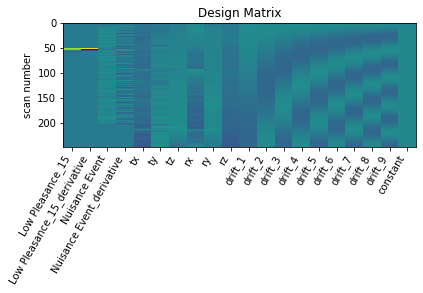

      0         1         2         3         4         5         6      \
0  1.264259 -0.592369 -0.194898  0.080817  0.476188  1.395046  1.673406   

      7         8         9      ...    11447     11448     11449     11450  \
0  1.840472  1.933985  1.678932  ... -0.56483 -0.492236 -0.361331 -0.157768   

      11451     11452     11453     11454     11455     11456  
0  1.205496 -0.157289 -1.370067 -0.666544 -0.559659  0.850043  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_15
GLM RUN LowPleasance_16


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



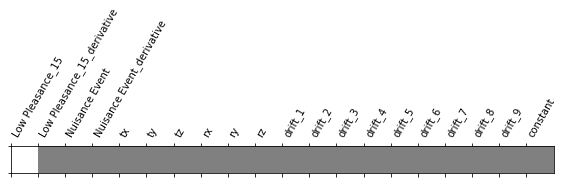

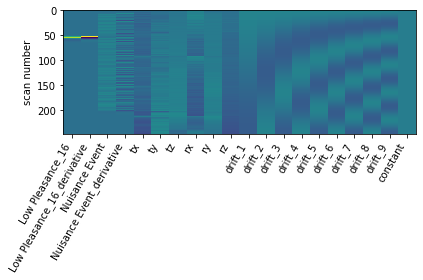

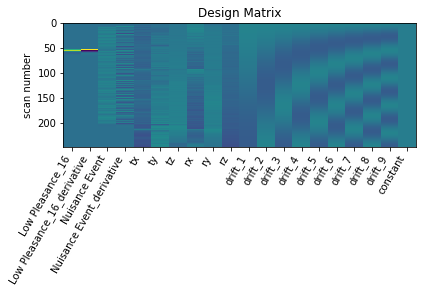

      0        1         2        3         4         5         6      \
0  0.429671 -0.94029  0.274517  0.91665  1.056976 -0.867978 -0.134459   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.088004 -0.351081  0.206584  ... -0.603552 -0.250992 -0.315021  0.283036   

      11451     11452     11453     11454     11455     11456  
0 -0.208044 -1.375167  0.251758 -0.415196 -0.239435 -0.732014  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_16
GLM RUN HighPleasance_17


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



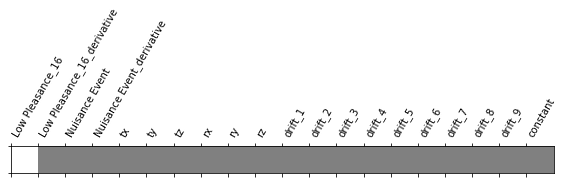

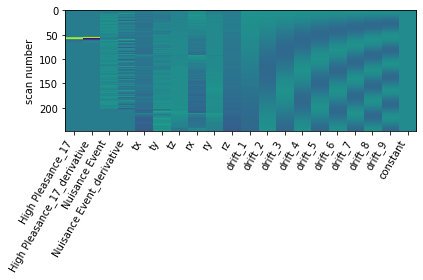

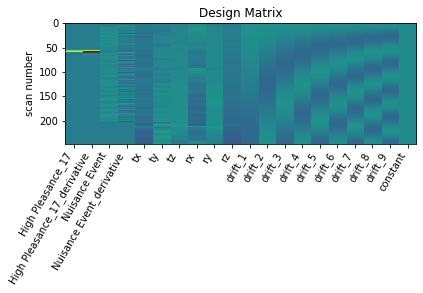

      0         1         2         3         4         5        6      \
0  0.715457 -0.090478 -0.231576 -0.427826 -0.436232  0.823065  0.62653   

     7         8         9      ...     11447     11448     11449     11450  \
0  0.87623  0.984157  0.897932  ... -1.694709 -1.732808 -1.048937  0.539505   

      11451     11452     11453     11454     11455     11456  
0  0.145331 -0.818083  0.049735 -1.023277 -0.168292 -1.576105  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_17
GLM RUN HighPleasance_18


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



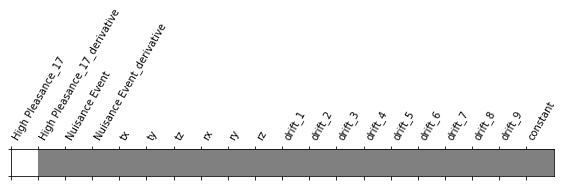

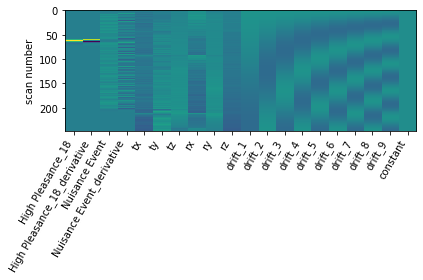

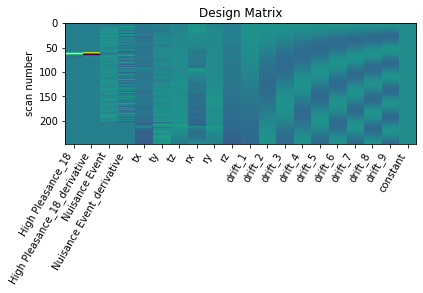

      0         1         2         3         4        5         6      \
0  1.442756 -0.761956  0.622086  1.078411  0.989942  1.15814  0.973943   

      7        8         9      ...     11447     11448    11449     11450  \
0  1.291191  1.30912  1.032841  ... -1.315671 -1.101838 -0.96343  0.502279   

      11451     11452     11453     11454     11455     11456  
0  0.547953 -1.280031  0.091628 -1.138719 -0.322643 -0.938976  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_18
GLM RUN HighPleasance_19


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



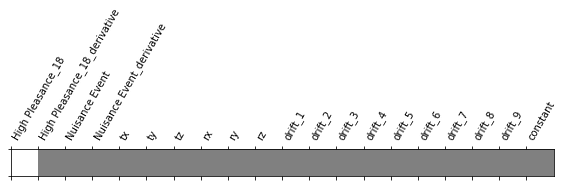

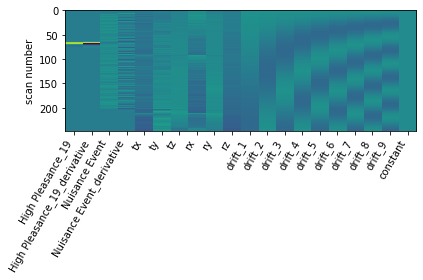

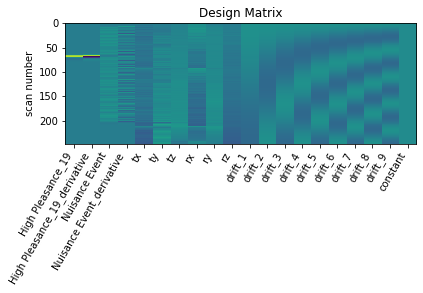

      0         1         2         3         4         5         6      \
0  0.957467 -0.072862 -1.606842 -1.350048 -1.122549  0.114684 -0.307953   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.042769  1.218481  1.807257  ... -1.975268 -1.705484 -1.517441  0.694852   

      11451     11452     11453     11454     11455     11456  
0  1.169603 -2.037033 -0.943776 -1.591698  0.425894 -0.789172  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_19
GLM RUN LowPleasance_20


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



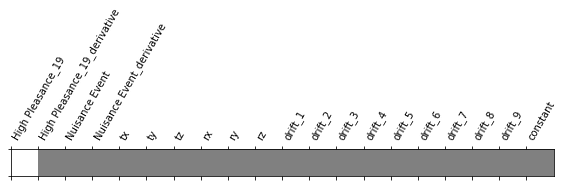

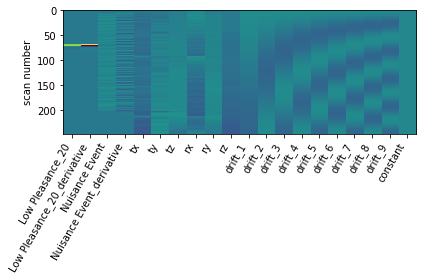

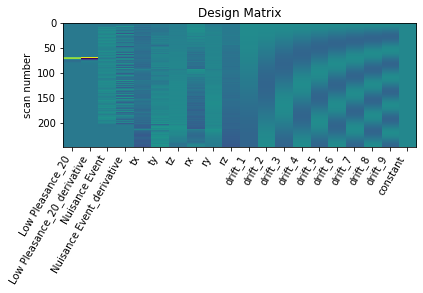

      0         1         2         3         4         5         6      \
0  1.643243 -0.181602  1.231745  1.204203  0.767535  1.063851  0.477826   

      7         8         9      ...    11447     11448     11449     11450  \
0  0.490437  0.572291 -0.068173  ...  0.24946 -0.054301  0.146823  0.794727   

      11451     11452     11453     11454     11455     11456  
0  0.269444 -0.001786  0.716031 -0.107376 -1.026885 -1.011579  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_20
GLM RUN HighPleasance_21


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



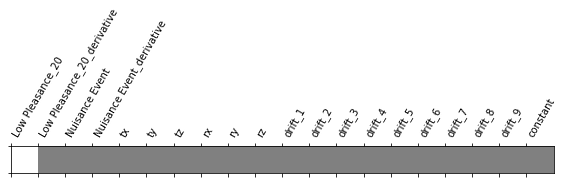

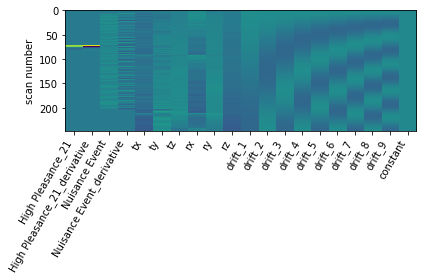

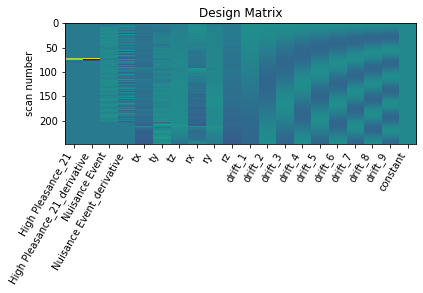

      0         1         2         3         4         5        6      \
0 -0.710849 -1.669085 -0.061553  0.020799  0.426621  0.948683  1.19148   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.374584  1.452098  1.396544  ... -1.598297 -1.098416 -0.981818  0.299833   

      11451    11452     11453     11454    11455     11456  
0  0.154981 -0.55985 -0.455861 -1.340366  0.43253 -0.606761  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_21
GLM RUN LowPleasance_22


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



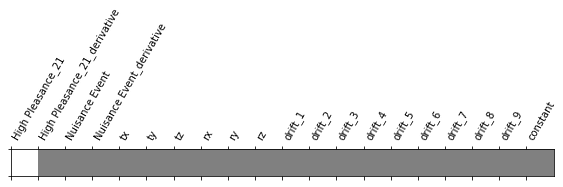

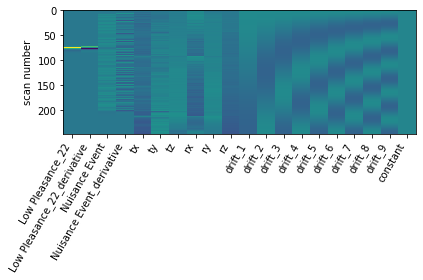

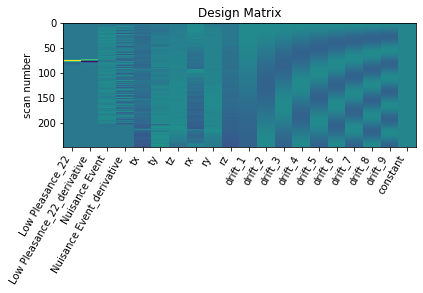

      0         1         2       3         4         5         6      \
0  1.300501 -0.073715 -0.604506  0.0817  0.115537  0.707621 -0.580469   

      7         8        9      ...     11447     11448     11449     11450  \
0  0.494917  1.010222  1.10416  ... -0.979086 -1.632168 -0.324935 -0.171093   

      11451    11452    11453     11454     11455     11456  
0  0.628856 -0.46529 -0.51396 -0.139994 -0.650977 -1.420482  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_22
GLM RUN HighPleasance_23


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



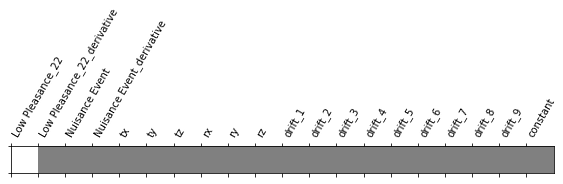

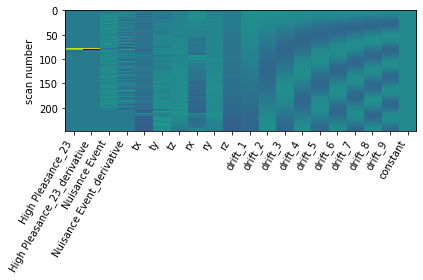

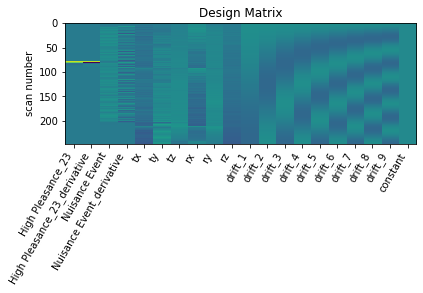

      0         1         2        3         4         5         6      \
0  1.125019  0.523183  0.672982  0.10325  0.089887  1.256321  0.036595   

      7         8        9      ...     11447     11448     11449     11450  \
0  0.601937  0.873101  0.52247  ... -1.544298 -1.274193 -1.252939  1.517543   

      11451    11452     11453    11454     11455     11456  
0  0.077676 -1.14974 -0.005828 -1.41431 -0.433706 -1.316868  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_23
GLM RUN LowPleasance_24


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



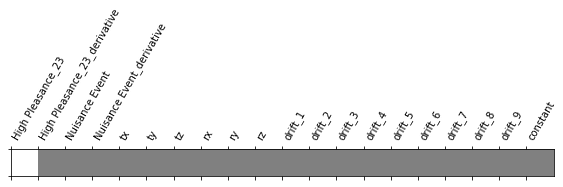

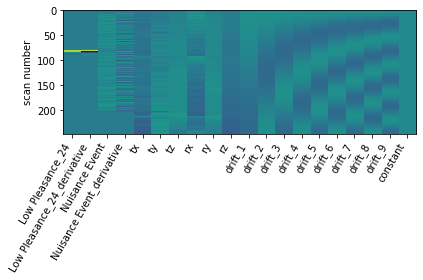

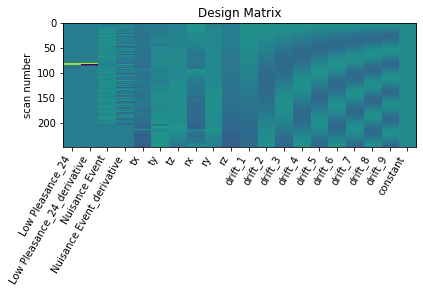

      0         1         2         3         4         5         6      \
0  1.045723 -1.654323  0.837934  1.597593  1.454071  0.582599  1.433312   

      7         8         9      ...     11447    11448     11449     11450  \
0  1.384734  1.253827  1.843387  ...  0.489767  0.31378  1.112024 -0.003403   

     11451     11452     11453     11454    11455     11456  
0  0.50272  0.458991  0.304261  0.153447  0.44085 -0.703789  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_24
GLM RUN LowPleasance_25


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



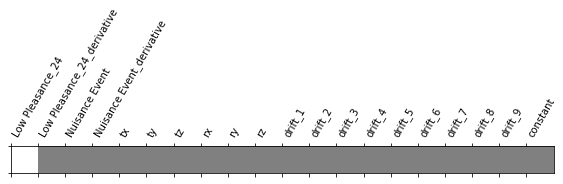

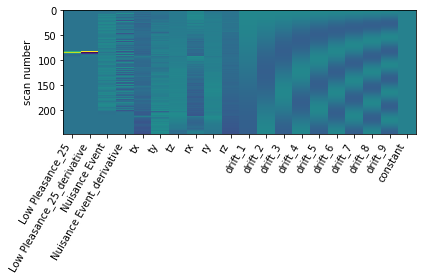

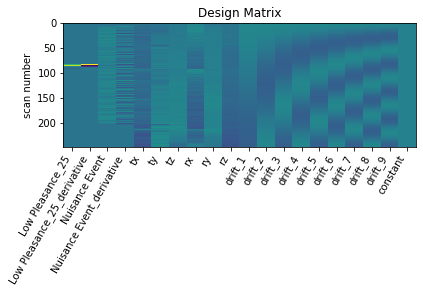

      0         1         2         3         4         5         6      \
0  0.658986 -0.136797 -0.231347 -0.576389 -0.949537  0.446643  1.060846   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.946059  0.432657  0.954875  ... -0.346101 -0.406398 -0.184797  1.600869   

     11451     11452     11453     11454     11455     11456  
0  0.10107 -0.677774  0.132861 -0.108708 -1.317551 -1.039906  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_25
GLM RUN LowPleasance_26


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



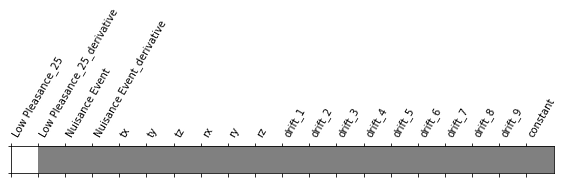

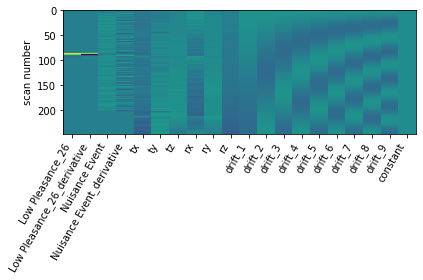

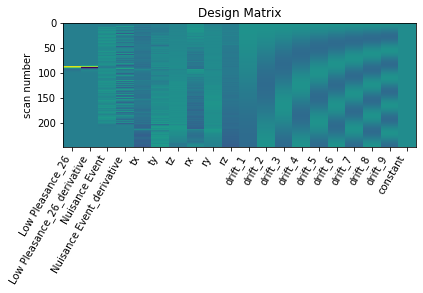

     0         1         2         3         4         5         6      \
0  1.30079  0.334475 -0.405607  0.051577  0.415274  0.021293 -0.264534   

     7         8         9      ...     11447     11448     11449     11450  \
0  0.37202  0.669503  1.231222  ... -0.488822 -0.326098 -0.215183  0.260195   

      11451     11452     11453     11454     11455     11456  
0  0.131908 -0.430892  0.345627  0.017094  0.271904 -0.549023  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_26
GLM RUN HighPleasance_27


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



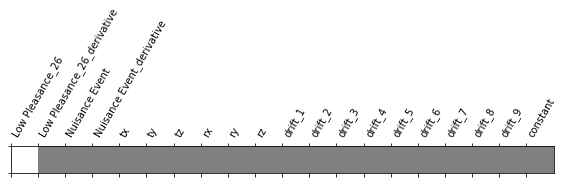

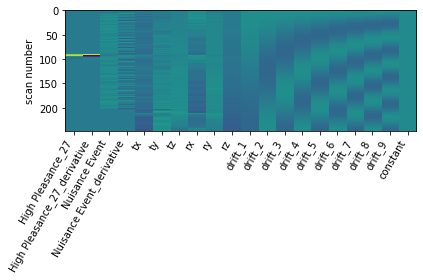

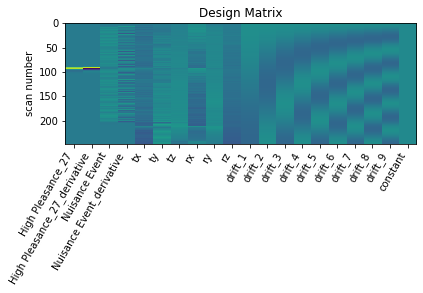

      0         1        2         3         4         5         6      \
0  0.937235 -0.639276  1.61786  1.701616  1.400487  1.913932  1.710963   

      7         8         9      ...     11447     11448     11449     11450  \
0  2.378647  2.306402  2.246276  ... -0.858648 -1.236255 -0.745286  0.945625   

      11451     11452     11453     11454    11455     11456  
0 -0.339577 -0.700757 -0.091357 -0.645294  0.42302 -2.042866  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_27
GLM RUN LowPleasance_28


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



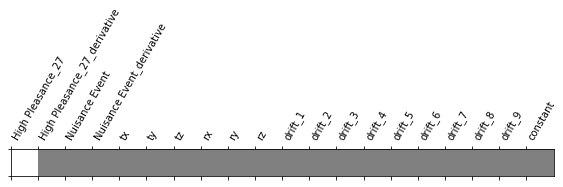

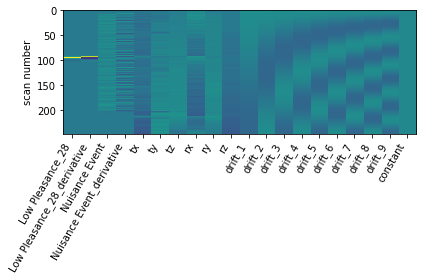

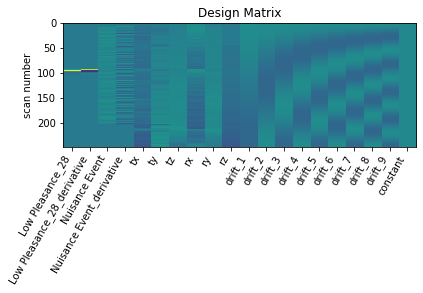

      0         1        2         3         4         5         6      \
0 -1.621515  1.873142 -0.79245 -0.932433 -1.027675 -0.065019 -1.044085   

      7         8         9      ...     11447     11448     11449    11450  \
0 -1.155639 -0.713466 -1.026989  ... -0.607908 -0.521216 -1.105625 -1.92435   

      11451     11452     11453     11454     11455     11456  
0  0.652225 -0.354222  0.091106  0.021381  0.132974  2.230086  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_28
GLM RUN LowPleasance_29


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 27 seconds



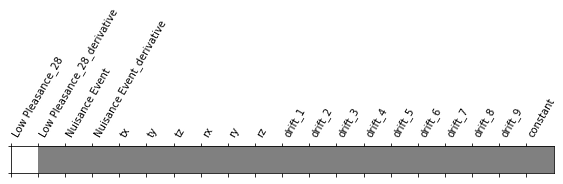

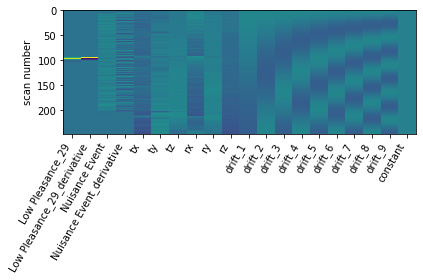

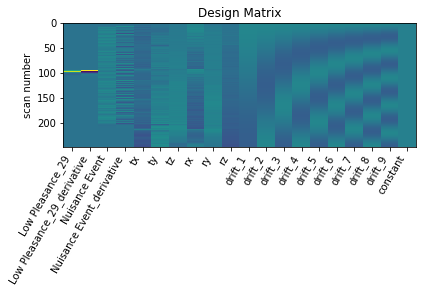

      0         1         2         3         4         5        6      \
0 -0.222625  0.094934 -1.719929 -1.422022 -0.467183 -1.083383 -1.28704   

      7       8         9      ...     11447     11448     11449     11450  \
0 -1.097137 -1.2364 -1.281011  ... -4.547824 -3.652322 -3.744588 -1.710436   

      11451     11452     11453     11454     11455     11456  
0  1.052403 -3.335288 -2.054127 -3.635498 -0.148319  1.037217  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_29
GLM RUN HighPleasance_30


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



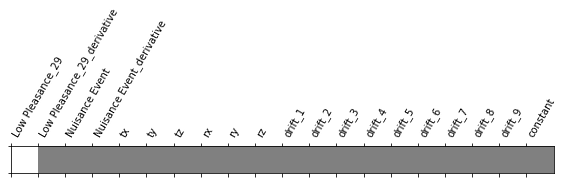

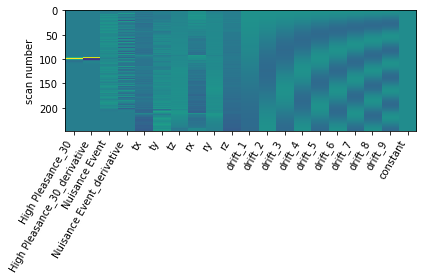

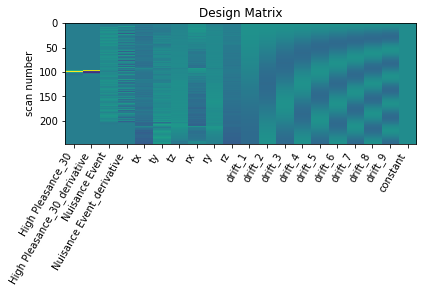

      0         1        2         3         4         5         6      \
0  0.965841 -1.192064  0.47861  0.449811  0.684237  0.506558  0.772286   

      7         8        9      ...    11447     11448     11449     11450  \
0  1.552387  1.505402  1.23505  ... -1.25539 -1.569506 -0.011953  1.663093   

      11451     11452     11453     11454     11455     11456  
0  1.700688 -0.256406 -0.033374 -0.903001 -0.271425 -0.584318  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_30
GLM RUN LowPleasance_31


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



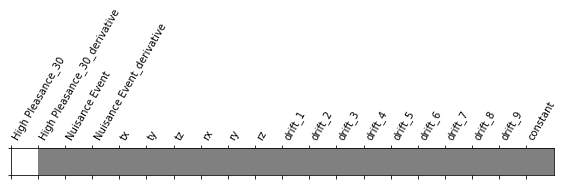

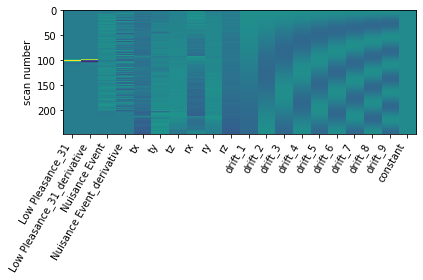

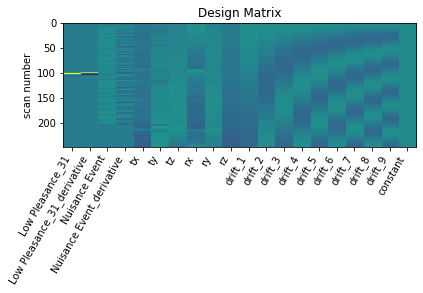

      0         1         2         3         4         5         6      \
0  2.426508 -0.911882  0.145207  0.650717  0.425764  2.133189  0.987194   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.951136  2.276495  2.432078  ...  1.077364  0.792161  0.929415  1.145368   

      11451     11452    11453    11454    11455     11456  
0  0.387079  0.393719 -0.13176  0.33402  0.11251 -2.411877  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_31
GLM RUN LowPleasance_32


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



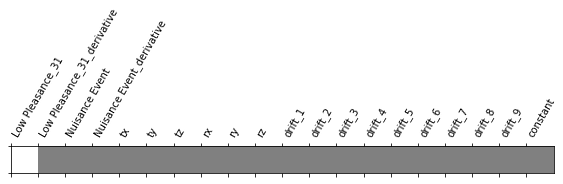

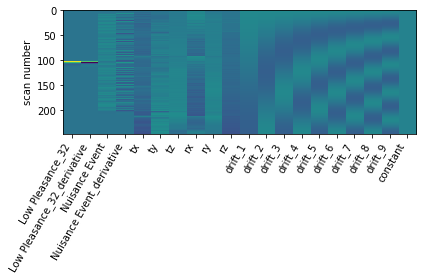

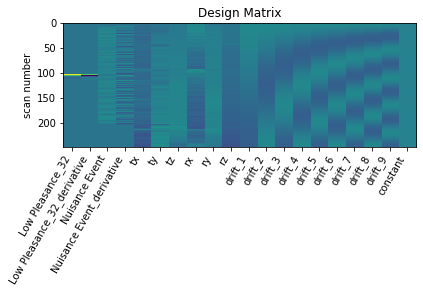

      0         1         2         3         4         5       6      \
0 -0.506477 -0.026668 -0.478342 -0.649717 -0.900392 -0.093098 -0.0619   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.464941 -0.619506 -1.172492  ... -1.628306 -1.028868 -1.583737 -0.652038   

      11451     11452     11453     11454     11455     11456  
0 -0.309273 -1.958972 -0.173483 -1.581998 -1.569763  0.260435  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_32
GLM RUN HighPleasance_33


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



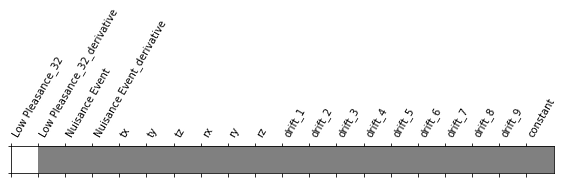

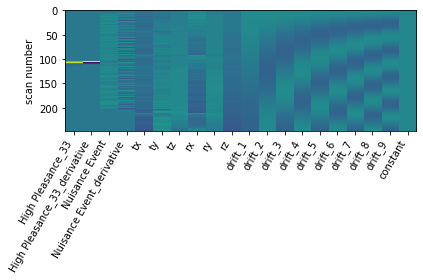

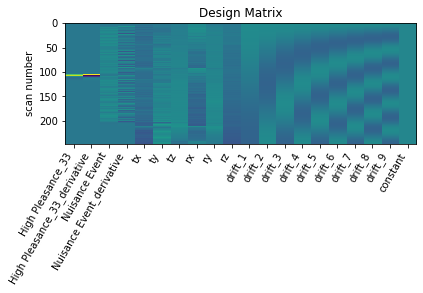

      0         1         2         3         4         5         6      \
0 -0.128722 -0.468899  0.106598  0.365603  0.914908  0.158442 -0.555885   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.280505  0.791492  0.321488  ... -0.963944 -1.324908 -0.720181  1.086348   

      11451     11452     11453     11454     11455     11456  
0  1.230687 -0.478281 -0.330313 -0.456943  0.961591 -0.213166  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_33
GLM RUN HighPleasance_34


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



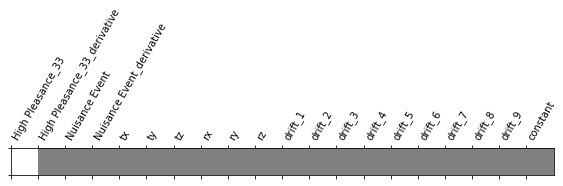

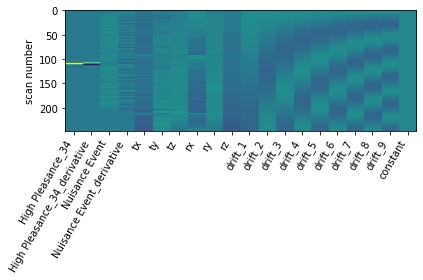

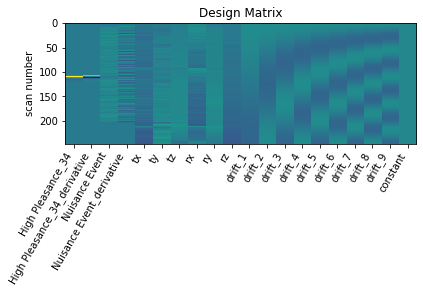

      0         1         2         3        4         5         6      \
0  3.748756 -0.374342 -0.094137  0.132346  0.09766  0.254178  1.731878   

      7         8         9      ...    11447     11448     11449    11450  \
0  2.290513  1.629899  3.488654  ... -1.28133 -1.020598  0.154989  1.79462   

     11451     11452     11453     11454     11455    11456  
0  0.42777 -0.611596 -0.251553 -1.252331 -1.135059 -2.10298  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_34
GLM RUN LowPleasance_35


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



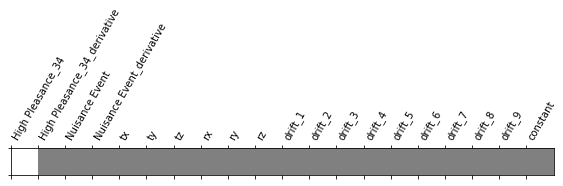

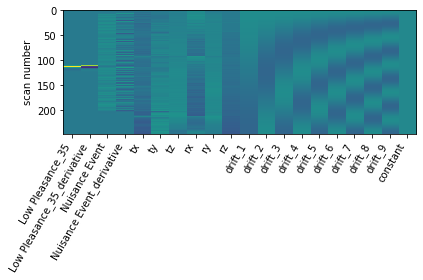

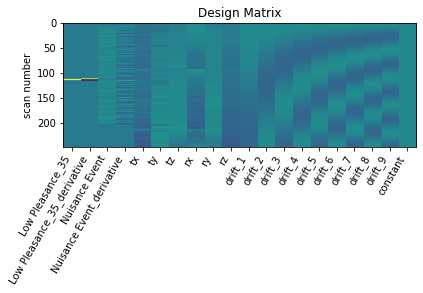

      0         1         2        3         4         5         6      \
0 -2.357576  0.092082 -0.320807 -0.56547 -0.479696  0.070773 -1.300606   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.526283 -0.930625 -2.260648  ... -1.103324 -1.377807 -1.459094 -2.148368   

      11451     11452     11453     11454    11455    11456  
0 -0.035695 -1.231881 -0.378849 -0.363548 -0.01439  1.21199  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_35
GLM RUN LowPleasance_36


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



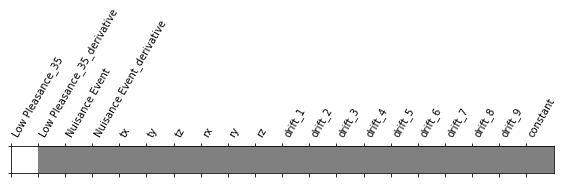

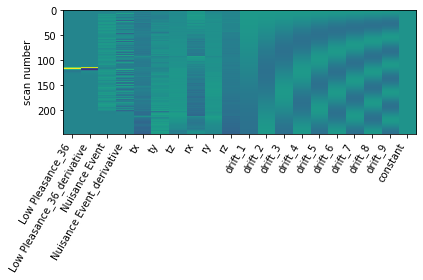

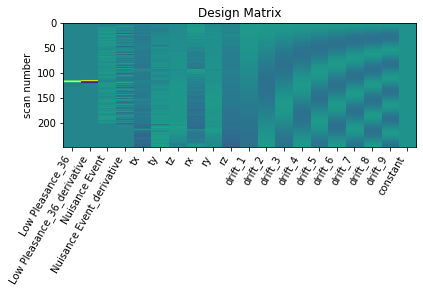

      0         1         2         3         4         5         6      \
0  2.288355 -1.275705  0.906225  1.315327  1.541044  1.090922  1.348865   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.799287  1.663762  2.681523  ... -0.843578 -1.076472  0.056318  2.163972   

      11451     11452     11453     11454     11455     11456  
0  0.797377 -0.250172 -0.039275 -0.829807  0.600022 -1.430559  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_36
GLM RUN LowPleasance_37


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



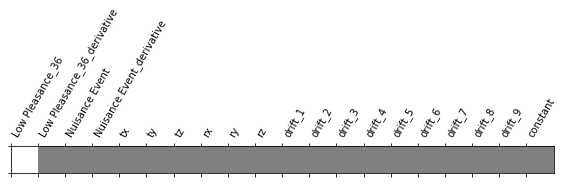

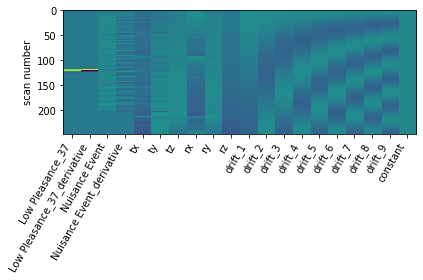

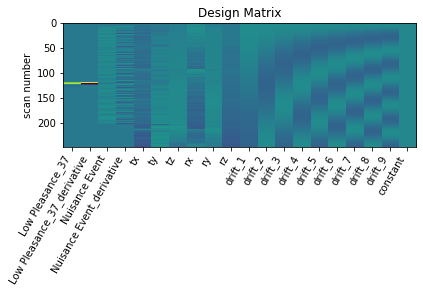

      0         1         2        3         4         5         6      \
0  0.561649  0.781422 -0.213526 -0.14027 -0.411836  0.676363 -0.283063   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.275796  0.681443 -0.457482  ... -0.767478 -0.790684 -0.476083 -1.090863   

      11451     11452     11453     11454     11455     11456  
0  0.055136 -0.377307  1.039232 -0.297681 -0.979076 -2.031005  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_37
GLM RUN HighPleasance_38


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



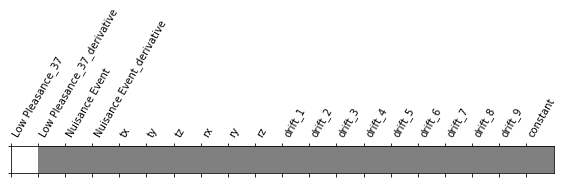

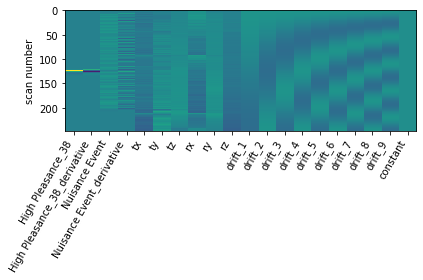

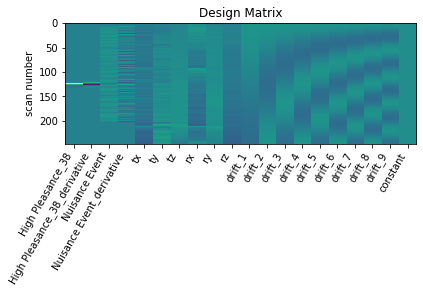

      0         1         2         3         4         5        6      \
0 -0.329293 -0.907794  0.372301  0.470104  0.311129  0.355376  0.65432   

      7       8         9      ...     11447     11448     11449     11450  \
0  0.839644  0.7037  1.119897  ... -1.420469 -1.379818 -1.088564  1.486422   

      11451     11452     11453     11454     11455     11456  
0  0.768828 -0.831565 -0.435533 -1.325086  0.416017  0.340486  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_38
GLM RUN LowPleasance_39


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



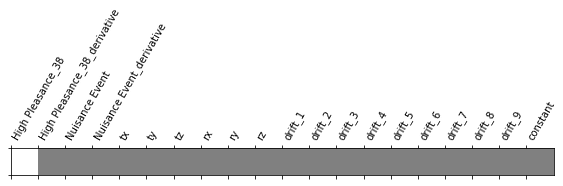

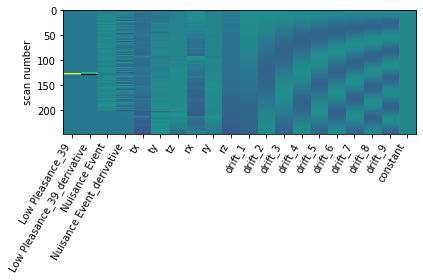

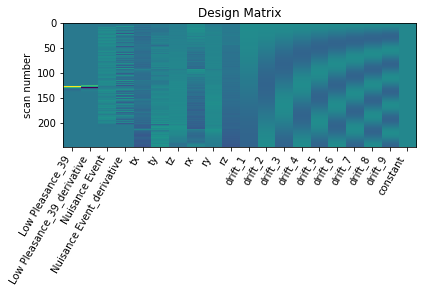

      0         1        2         3         4         5         6      \
0  3.395229 -0.604872 -0.87582 -0.480957 -0.179753  1.636559  0.917221   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.863086  2.155575  2.152866  ...  0.021781  0.193913  0.308258  0.810269   

      11451     11452     11453     11454     11455     11456  
0  0.027585 -0.870982 -0.261073 -0.480745 -0.636747 -2.198728  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_39
GLM RUN LowPleasance_40


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



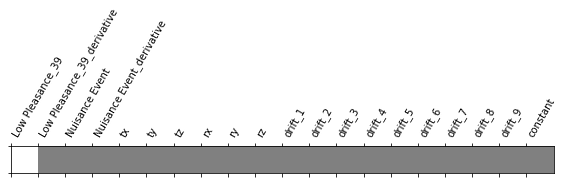

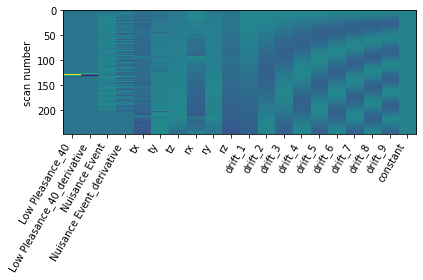

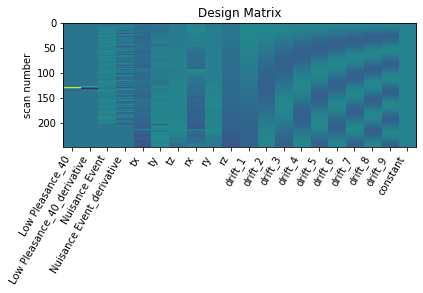

      0         1         2         3         4        5         6      \
0  1.626974 -0.000193  0.164823  0.468257  0.495406  0.87924  0.680338   

      7         8         9      ...     11447    11448     11449     11450  \
0  1.309063  1.041718  0.853493  ... -0.180216 -0.25909  0.278223  0.858674   

      11451     11452     11453     11454     11455     11456  
0 -0.726944  1.259918  2.216204 -0.339729  0.244282 -2.111324  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_40
GLM RUN LowPleasance_41


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



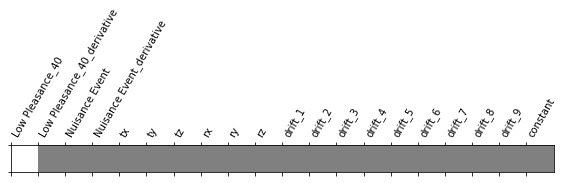

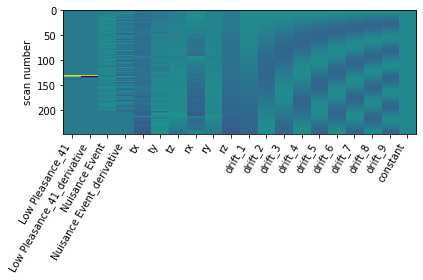

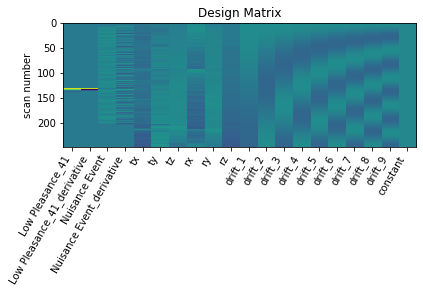

      0        1         2         3         4       5         6      \
0 -1.122105 -0.56497  0.854378  0.447339 -0.234663 -0.4549  0.382828   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.012546  0.159745  0.358652  ... -1.439941 -1.265832 -1.068665  0.661939   

      11451     11452     11453     11454     11455     11456  
0  1.764539 -1.547253 -0.509285 -0.598432 -0.299002  1.060197  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_41
GLM RUN HighPleasance_42


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



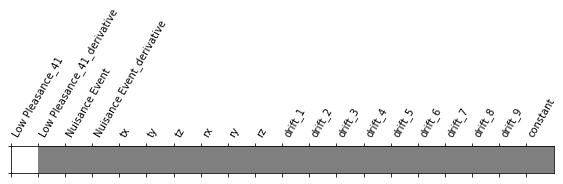

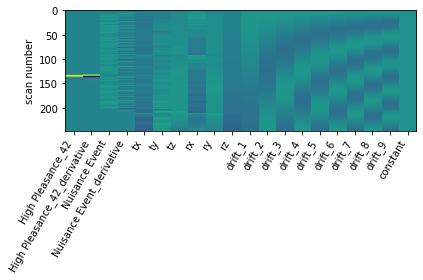

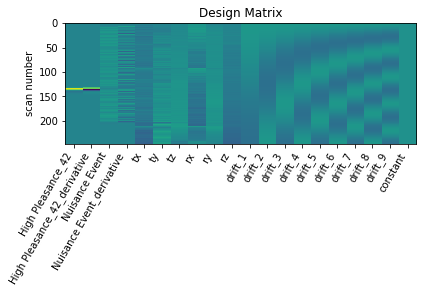

      0         1         2        3         4         5         6      \
0  1.634599 -1.595698 -0.557833 -0.10786  0.347706  1.513812 -0.013148   

      7         8         9      ...   11447     11448     11449     11450  \
0  0.994139  1.319368  0.838563  ... -1.6985 -1.601876 -1.501694 -0.208662   

      11451     11452     11453     11454     11455     11456  
0  0.199339 -1.872925 -1.053451 -1.629562 -0.224441 -1.757512  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_42
GLM RUN LowPleasance_43


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



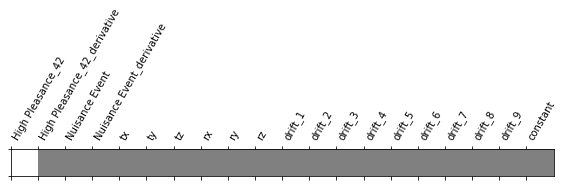

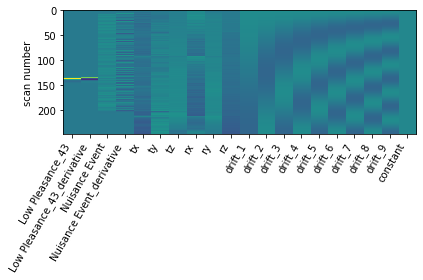

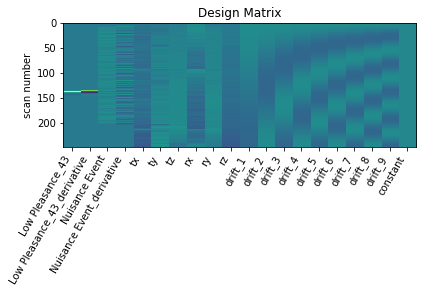

      0         1         2         3         4         5         6      \
0  0.172448  1.536387  0.419699  0.315621 -0.062151  0.088936  0.183944   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.203212 -0.014326  0.120595  ...  0.491908  0.116748  0.646569  1.007783   

      11451     11452     11453    11454     11455     11456  
0  0.484246  0.931844  0.849714 -0.07587  0.679323 -0.280315  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_43
GLM RUN HighPleasance_44


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



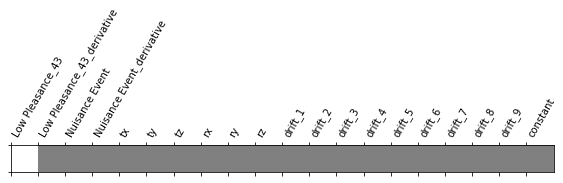

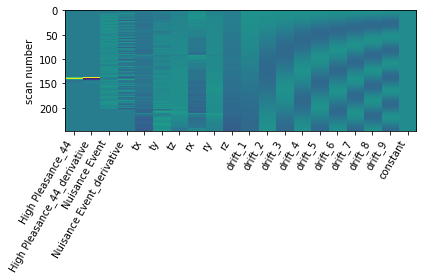

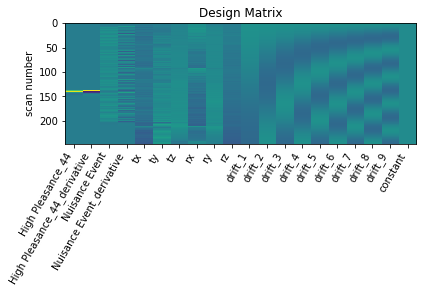

      0         1         2         3         4         5         6      \
0  0.839367 -0.393249 -0.094122  0.110321  0.408426  0.538709  1.140224   

      7         8         9      ...     11447     11448     11449    11450  \
0  1.305455  1.206845  1.521062  ... -1.113416 -0.972619 -0.344116  0.01612   

      11451    11452     11453     11454     11455     11456  
0  1.061702 -0.72178 -0.842773 -0.119548 -0.766079  0.173789  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_44
GLM RUN HighPleasance_45


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



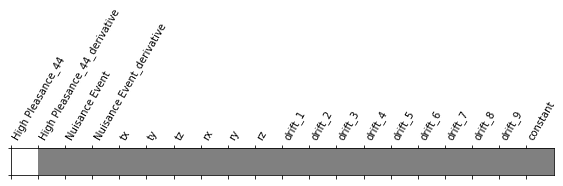

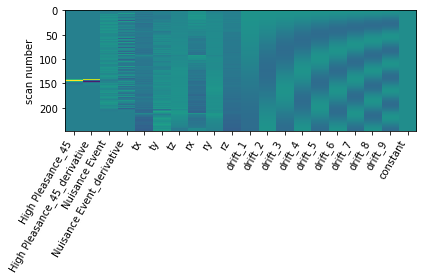

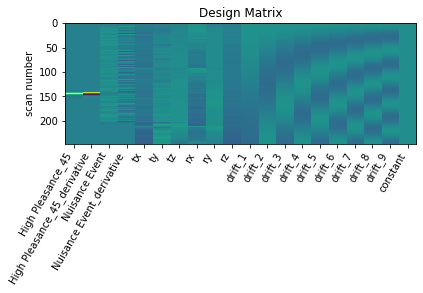

      0         1         2         3         4        5       6      \
0 -0.068805 -0.477062 -0.738379 -0.775662 -1.070635 -0.13114 -0.6798   

      7         8        9      ...     11447     11448     11449     11450  \
0 -0.446311 -0.244161 -0.96538  ... -2.434437 -2.420053 -1.726415  0.745622   

      11451     11452     11453     11454     11455     11456  
0  0.845179 -1.758901  0.052734 -2.716472 -0.412065 -0.939317  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_45
GLM RUN LowPleasance_46


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



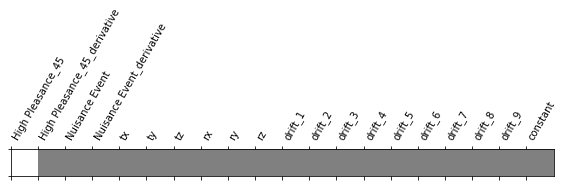

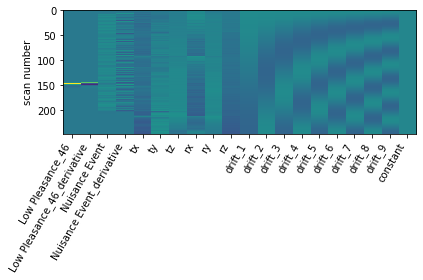

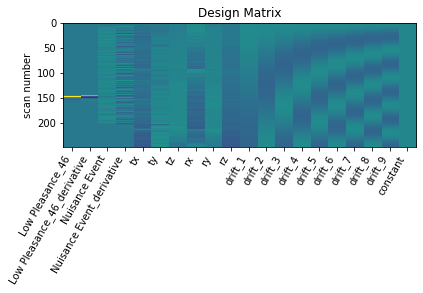

      0         1         2         3         4         5         6      \
0  2.085228  0.365369  0.922769  1.322287  1.968476  0.924986  1.636963   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.849321  1.112972  2.287897  ...  0.572494  0.433017  0.789473  0.419661   

      11451     11452     11453     11454     11455     11456  
0  0.250607  0.326988 -0.744099  1.225844  0.078644 -0.243533  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_46
GLM RUN HighPleasance_47


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



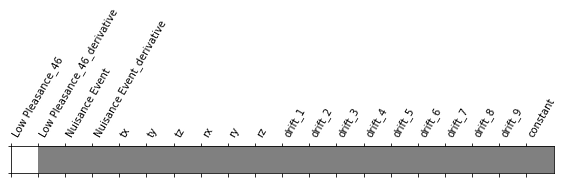

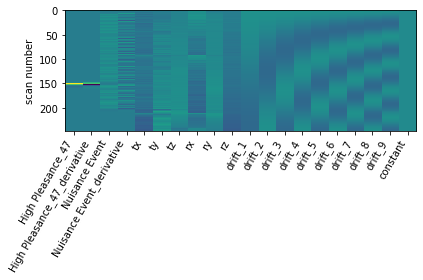

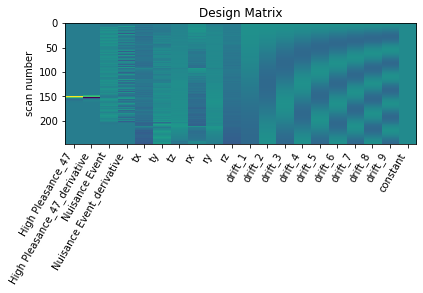

      0         1         2         3         4         5         6      \
0  0.483866 -1.016598 -0.434716 -0.415133 -0.761106  0.211199 -1.303687   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.575645  0.277265 -0.091199  ... -2.059495 -2.241391 -1.342797  0.776108   

     11451     11452     11453     11454     11455     11456  
0  2.13146 -1.643043  0.223674 -1.173936  0.529177 -1.448714  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_47
GLM RUN HighPleasance_48


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



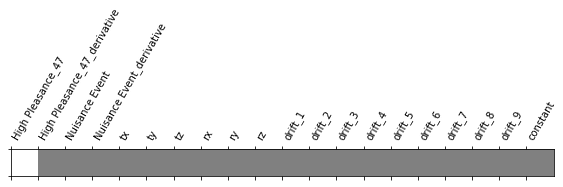

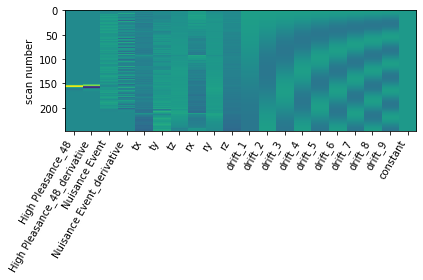

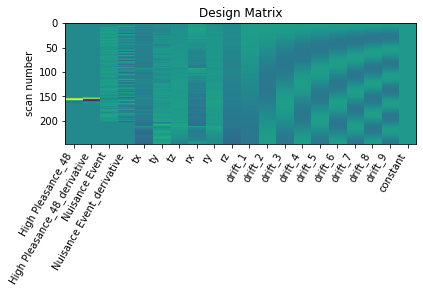

      0         1         2         3         4         5         6      \
0  1.127236 -0.254159  0.308814  0.489738  0.777416  1.177255  0.820933   

      7         8         9      ...    11447     11448     11449     11450  \
0  1.590678  1.573935  1.496873  ... -1.69271 -1.602215 -0.948184  1.212491   

      11451    11452     11453     11454     11455     11456  
0 -0.124948 -0.69633 -0.196719 -1.198029 -0.354717 -0.559214  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_48
GLM RUN LowPleasance_49


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



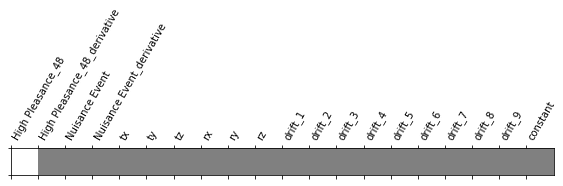

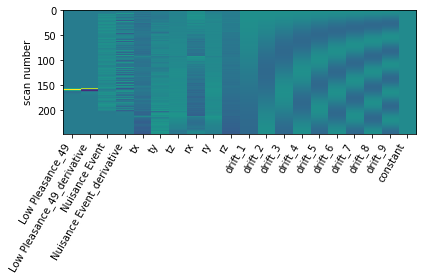

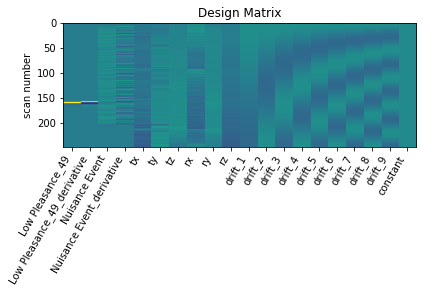

    0         1        2         3         4         5         6      \
0  0.6749  0.465771 -0.45391 -0.620919 -0.954262  0.302011  0.553075   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.268927  0.307717  0.452549  ... -1.201764 -0.911946 -0.616741 -0.763146   

      11451     11452     11453     11454     11455     11456  
0  1.320997 -0.998272 -1.109888 -1.116194  0.072751 -0.808287  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_49
GLM RUN LowPleasance_50


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



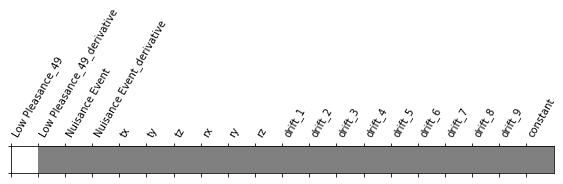

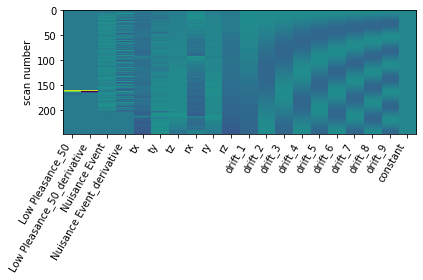

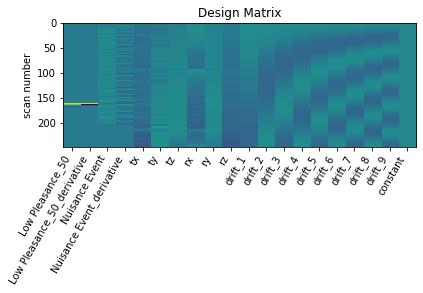

      0         1         2         3         4         5         6      \
0 -0.015281 -1.368123 -1.218626 -0.351383  0.212158 -0.603279 -0.739886   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.541183  0.864509  0.422686  ... -0.970924 -1.220984 -0.545801  1.183709   

      11451     11452     11453     11454     11455     11456  
0 -0.798012 -0.688865 -0.224273 -0.347218 -0.437439 -0.795998  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_50
GLM RUN HighPleasance_51


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



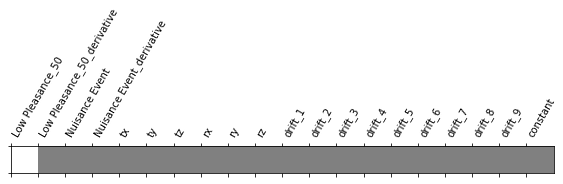

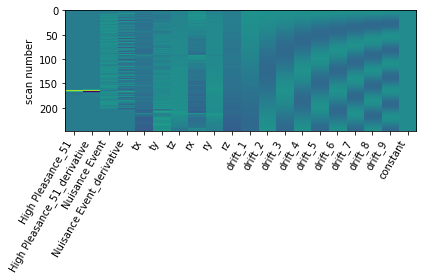

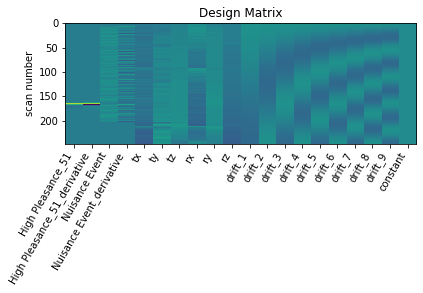

      0         1         2         3         4         5         6      \
0  2.021541 -0.119935  0.678688  0.655977  0.433879  1.765689  1.662523   

      7       8        9      ...     11447     11448    11449     11450  \
0  1.704998  1.6887  2.31207  ... -0.946797 -0.649803 -0.53547  0.685395   

      11451    11452     11453     11454     11455     11456  
0  0.964951 -0.44147  0.619992 -0.882155  0.213106 -0.690328  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_51
GLM RUN HighPleasance_52


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



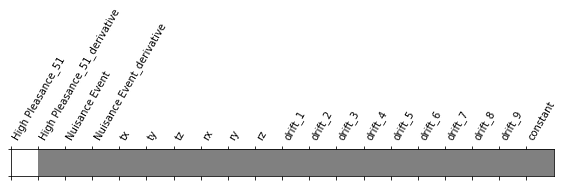

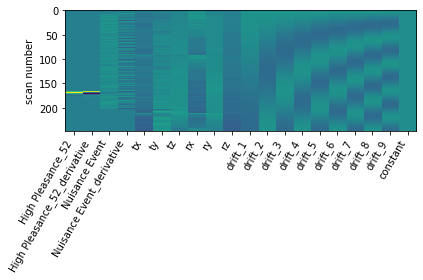

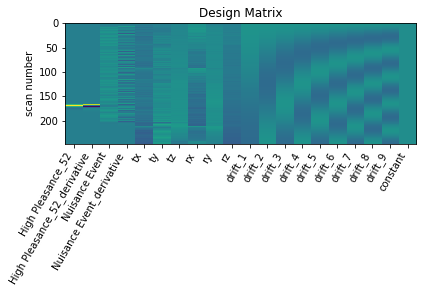

      0         1         2         3         4         5         6      \
0  0.632347 -0.856532 -0.217902 -0.128349 -0.053022 -0.106231 -0.158542   

      7         8         9      ...     11447    11448     11449     11450  \
0  0.614297  0.761545  0.476615  ... -1.504991 -1.64962 -0.883473  1.005586   

      11451     11452     11453    11454     11455     11456  
0  0.213399 -1.517432 -0.311243 -1.44659 -0.527982 -2.354289  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_52
GLM RUN HighPleasance_53


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



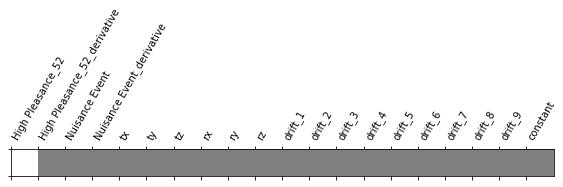

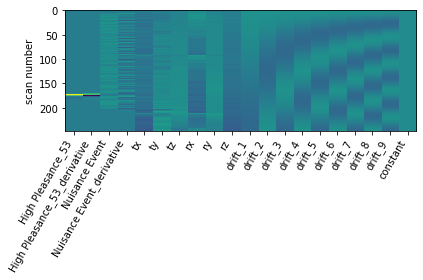

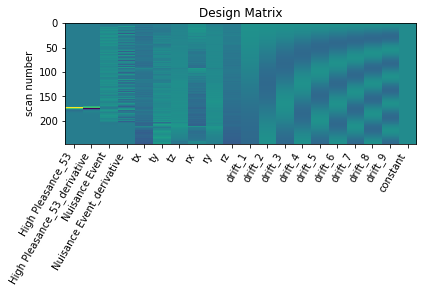

      0         1         2        3         4         5         6      \
0  2.652017 -0.442575  0.314275  0.38696  0.569616  1.225675  1.364067   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.837493  1.558742  2.167469  ... -0.499026 -0.285569  0.076449  1.481542   

      11451     11452     11453     11454    11455     11456  
0  1.555713 -0.364714 -0.394489 -0.405952 -0.41067  0.172092  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_53
GLM RUN HighPleasance_54


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



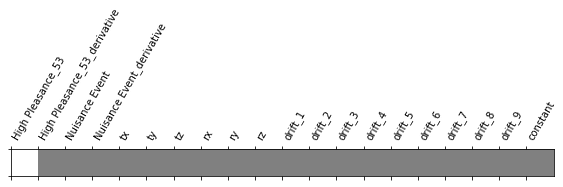

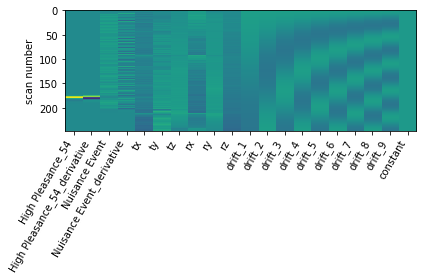

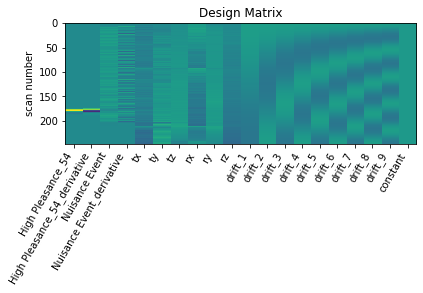

      0         1         2         3         4         5        6      \
0  0.363249 -0.511642 -0.354945 -0.593994 -0.861253  0.340678  0.05503   

      7         8         9      ...     11447    11448     11449     11450  \
0  0.655541  0.677938  0.762395  ... -2.296525 -2.43432 -1.638175  0.092591   

      11451     11452     11453     11454     11455     11456  
0  0.931808 -2.031108  0.088482 -1.714214  0.317411 -1.938935  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_54
GLM RUN LowPleasance_55


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



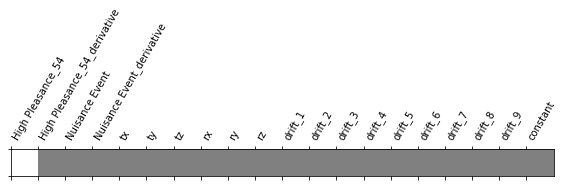

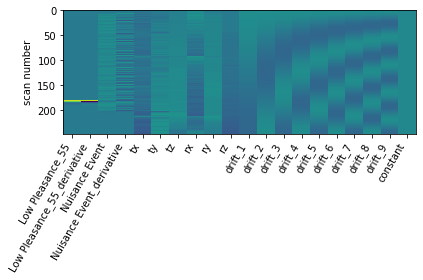

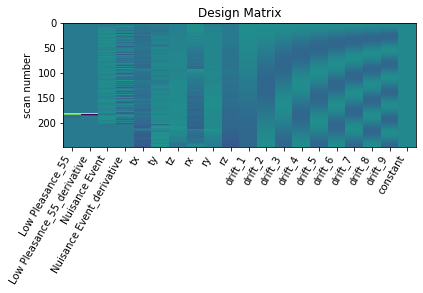

      0         1         2         3         4         5        6      \
0  1.189466  0.274336  0.081315  0.541828  0.613887  0.940689  0.19856   

      7         8         9      ...     11447    11448     11449     11450  \
0  1.196841  1.513123  1.364119  ... -0.067202  0.20322  0.202635  1.265004   

      11451     11452     11453     11454  11455     11456  
0  1.108465  0.334689 -0.432978 -0.067812 -0.827  0.140143  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_55
GLM RUN HighPleasance_56


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



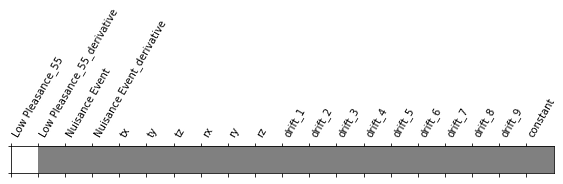

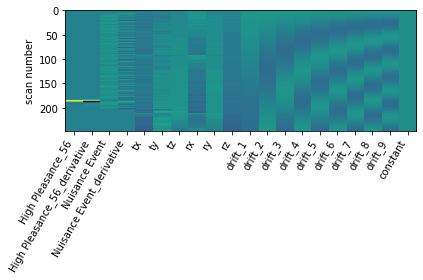

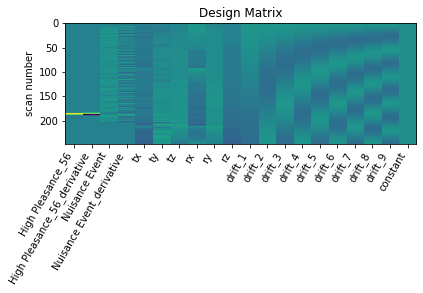

     0         1         2        3         4         5         6      \
0  0.22112 -0.869689  0.557036  0.40723  0.151041  1.029537  0.999535   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.123581  0.846258  0.713476  ... -2.010159 -2.220727 -1.046141  0.221577   

      11451     11452     11453     11454     11455     11456  
0  0.224902 -1.122387  0.634763 -1.602666  0.566905 -0.271201  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_56
GLM RUN HighPleasance_57


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



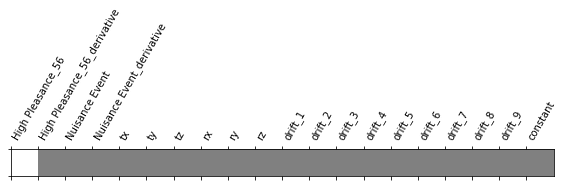

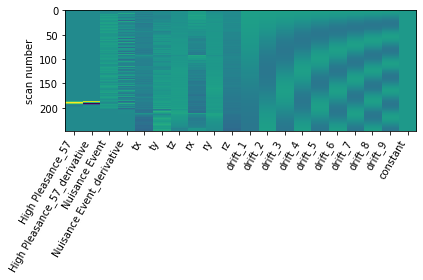

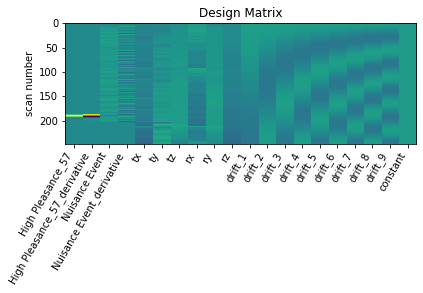

      0         1         2        3        4         5         6      \
0  0.918427 -0.612207  0.050021  0.26655  0.49668  0.593673  0.175734   

      7         8         9      ...  11447     11448     11449     11450  \
0  0.644483  0.943985  0.944815  ... -0.932 -0.706359 -0.709528  0.776895   

      11451     11452     11453     11454    11455     11456  
0  1.314708 -1.256899 -0.982942 -0.425036 -0.45829 -1.287784  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_57
GLM RUN HighPleasance_58


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



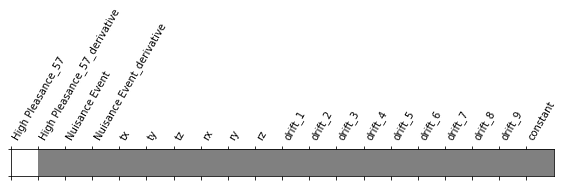

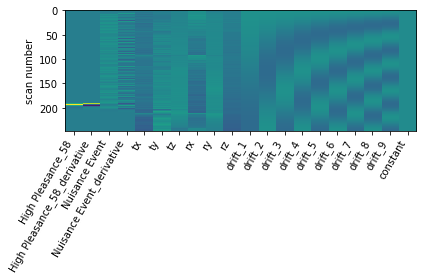

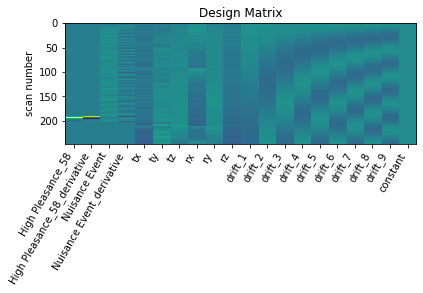

      0         1         2         3         4         5       6      \
0  1.169571 -0.040121 -0.623763 -0.089905  0.074263  0.985557  0.2854   

      7        8         9      ...     11447     11448     11449     11450  \
0  1.021621  1.15637  0.986027  ... -0.929656 -0.908531 -0.632491  1.102579   

      11451     11452     11453     11454     11455     11456  
0 -0.270854 -0.468528  0.319007 -1.304136 -0.141014 -0.535666  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_58
GLM RUN HighPleasance_59


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



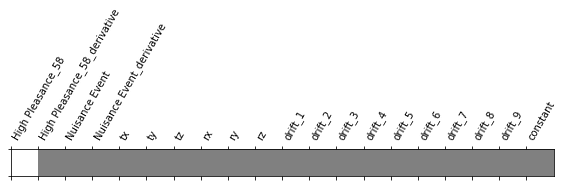

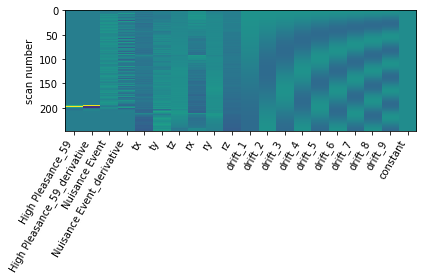

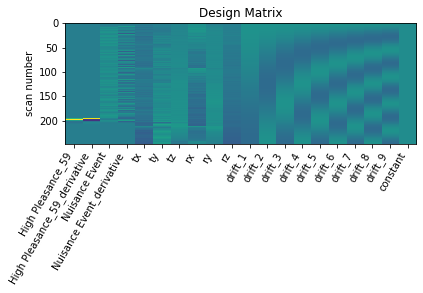

      0         1         2         3         4         5       6      \
0  0.873925 -0.030539  0.898709  0.492941  0.173005 -0.207744  0.7412   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.510021  0.196656  0.753125  ... -0.741315 -1.078122 -0.335662  0.058316   

      11451     11452     11453     11454     11455     11456  
0  0.744561 -0.631847 -0.338644 -0.290213  0.361526 -0.989487  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_59
GLM RUN LowPleasance_60


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 18 seconds



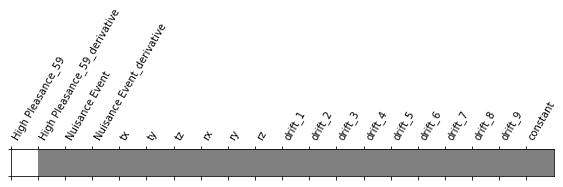

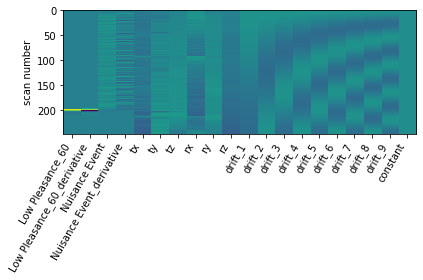

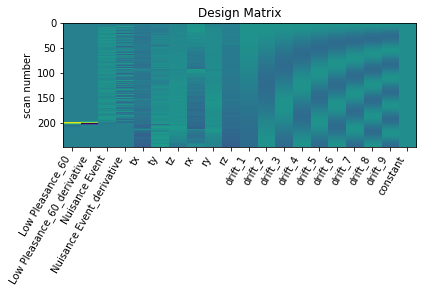

      0         1         2         3         4         5        6      \
0 -1.195583 -0.161774 -1.791125 -1.623085 -1.354845 -0.574378 -2.33719   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.550891 -0.851949 -1.548721  ... -2.012316 -1.573075 -1.854862  0.074105   

      11451    11452     11453     11454     11455     11456  
0  0.058888 -1.80174 -2.116982 -1.393421  0.019901  0.634584  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_60


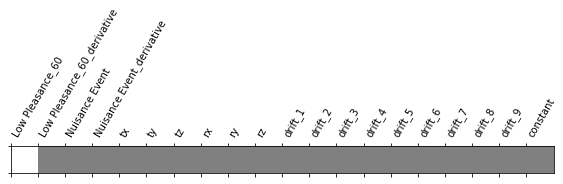

In [ ]:
y_ho_ap, X_ho_ap = lss_separate_method_comp(task =task,
                          data_path=data_path,
                          events_path=events_path,
                          motion_param_path=motion_param_path,
                          cache_mem_path=cache_mem_path,
                          activity_mat_saving_path=activity_mat_saving_path,
                          analysis_type=analysis_type,
                          param_modulation=False,
                          t_r=t_r,
                          drift_model=drift_model,
                          drift_order=drift_order,
                          hrf_model=hrf_model,
                          pre_whitening_spec=pre_whitening_spec,
                          apply_trans_mask=apply_trans_mask,
                          roi_img=roi_img,  
                          hpf_cut=hpf_cut,
                          smoothing_fwhm=smoothing_fwhm,
                          standardize=standardize,
                          detrend=detrend,minimize_memory=minimize_memory)

In [ ]:
y_g.append(y_ho_ap)
X_g.append(X_ho_ap)

In [ ]:
X_ho_ap.shape

(60, 11457)

### Run PA

In [ ]:
data_path = 'ses-19/func/wrdcsub-01_ses-19_task-PreferenceHouses_dir-pa_bold.nii.gz'
events_path = 'ses-19/func/sub-01_ses-19_task-PreferenceHouses_dir-pa_events.tsv'
motion_param_path = 'ses-19/func/rp_dcsub-01_ses-19_task-PreferenceHouses_dir-pa_bold.txt'
task = 'Houses'

In [ ]:
analysis_type = 'High_Low_Pleasance'
hrf_model = 'spm + derivative'
param_modulation = False
drift_model='cosine'
t_r=2
drift_order=None
apply_trans_mask=True
roi_img = mask_img
standardize=True
detrend=True
minimize_memory = True
activity_mat_saving_path = 'mvpa/test2'

events = pd.read_csv(events_path,sep='\t')

# onset shift in order to capture the very moment of the appreciation decision
events['onset'] = events['onset']-1

onset_periods = [events['onset'][i+1] - events['onset'][i]  for i in range(len(events['onset']))if (i<len(events['onset'])-1)]
onset_periods = np.array(onset_periods)
onset_freq = np.reciprocal(onset_periods)
hpf_cut = np.min(onset_freq)/2 # cf High Pass Filtering Rule of Thumb ( fMRI Handbook 2011)

Event 0
      onset  duration       trial_type
0     9.238     5.596  Low Pleasance_1
1    16.171     3.365   Nuisance Event
2    21.953     3.775   Nuisance Event
3    28.952     4.305   Nuisance Event
4    37.001     4.014   Nuisance Event
5    43.833     3.531   Nuisance Event
6    48.166     3.592   Nuisance Event
7    54.032     3.473   Nuisance Event
8    60.781     4.043   Nuisance Event
9    67.563     3.341   Nuisance Event
10   73.979     2.441   Nuisance Event
11   79.828     2.893   Nuisance Event
12   83.395     2.372   Nuisance Event
13   86.294     2.864   Nuisance Event
14   93.260     2.533   Nuisance Event
15   97.676     4.051   Nuisance Event
16  104.608     2.825   Nuisance Event
17  110.774     2.386   Nuisance Event
18  115.240     4.176   Nuisance Event
19  121.356     5.204   Nuisance Event
20  131.055     4.575   Nuisance Event
21  138.170     8.780   Nuisance Event
22  150.102     4.804   Nuisance Event
23  158.384     6.034   Nuisance Event
24  167.433     6

59  421.431     6.200    Nuisance Event
Event 57
      onset  duration        trial_type
0     9.238     5.596    Nuisance Event
1    16.171     3.365    Nuisance Event
2    21.953     3.775    Nuisance Event
3    28.952     4.305    Nuisance Event
4    37.001     4.014    Nuisance Event
5    43.833     3.531    Nuisance Event
6    48.166     3.592    Nuisance Event
7    54.032     3.473    Nuisance Event
8    60.781     4.043    Nuisance Event
9    67.563     3.341    Nuisance Event
10   73.979     2.441    Nuisance Event
11   79.828     2.893    Nuisance Event
12   83.395     2.372    Nuisance Event
13   86.294     2.864    Nuisance Event
14   93.260     2.533    Nuisance Event
15   97.676     4.051    Nuisance Event
16  104.608     2.825    Nuisance Event
17  110.774     2.386    Nuisance Event
18  115.240     4.176    Nuisance Event
19  121.356     5.204    Nuisance Event
20  131.055     4.575    Nuisance Event
21  138.170     8.780    Nuisance Event
22  150.102     4.804    Nuisan

Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



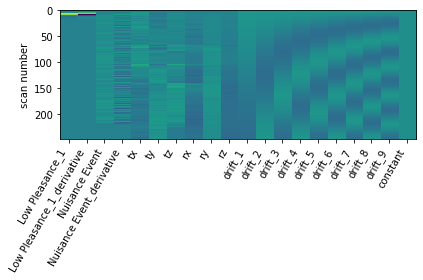

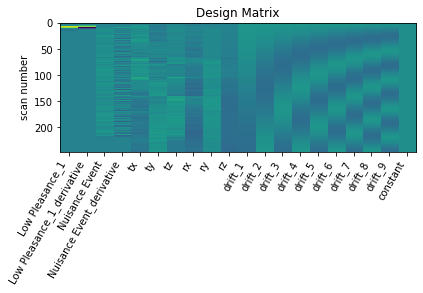

      0         1         2         3         4         5         6      \
0  0.203502 -0.303399  0.080937  0.181599  0.112197  0.572095  0.047723   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.716759  1.138856  0.790583  ... -1.743482 -1.625324 -1.738897  0.259065   

      11451     11452     11453     11454    11455     11456  
0 -1.426794 -1.534803  0.656417 -1.472804  1.90812 -0.586272  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_1
GLM RUN HighPleasance_2


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



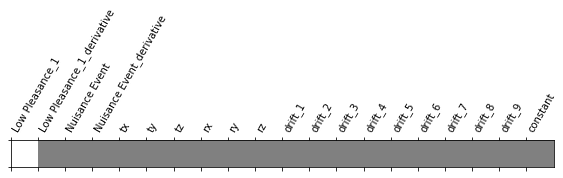

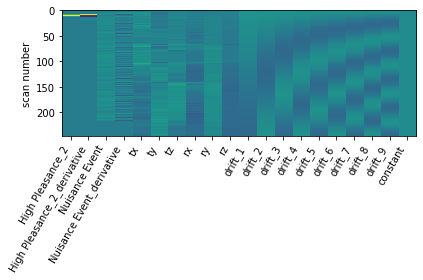

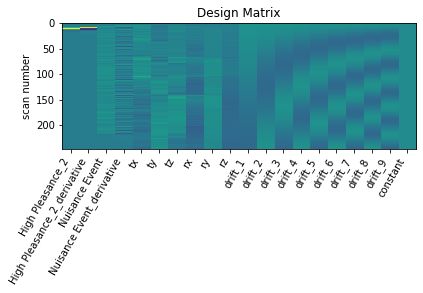

      0         1         2         3         4         5         6      \
0 -0.169812 -1.131304 -0.992872 -0.485048  0.165316  0.068806 -0.491681   

      7        8         9      ...     11447    11448     11449     11450  \
0 -0.515663 -0.69829 -0.870193  ... -0.551732 -0.52062 -0.091308 -0.922576   

      11451     11452     11453     11454     11455     11456  
0  1.492699 -0.405348 -0.317845 -0.219018 -0.871852 -0.330597  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_2
GLM RUN HighPleasance_3


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



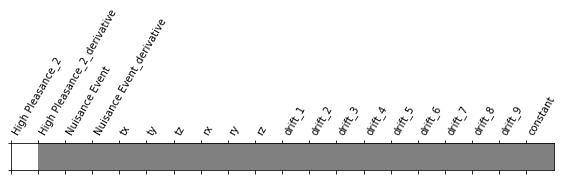

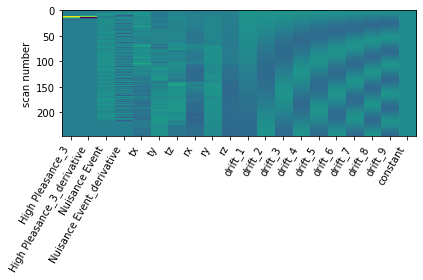

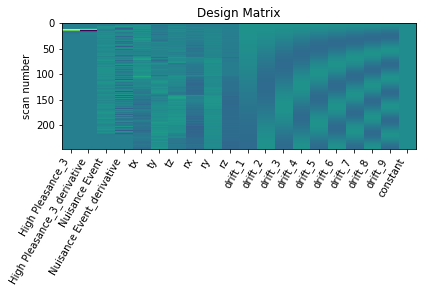

      0         1         2         3         4         5         6      \
0  0.807937 -0.618322  1.302967  0.887567  0.209921  0.615253  0.012432   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.697551  1.025813  1.189924  ... -0.667797 -0.613284 -1.053199  0.437876   

      11451     11452     11453     11454     11455     11456  
0  0.352111 -0.756877 -0.762786 -0.721875  0.098833 -0.691415  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_3
GLM RUN LowPleasance_4


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



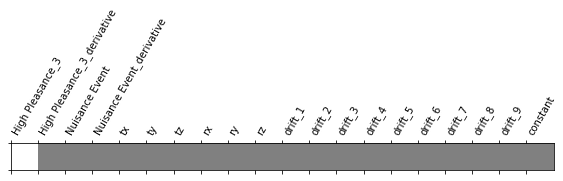

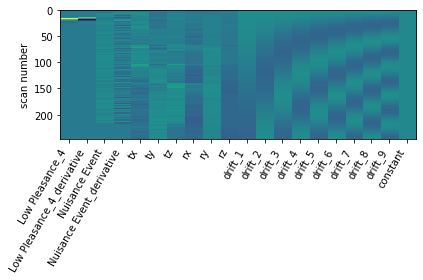

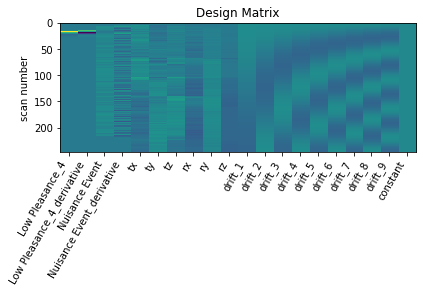

     0         1         2         3         4         5         6      \
0 -0.73995  0.185552 -0.301781 -0.257112 -0.309731  0.943562 -1.052453   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.077742  0.724236  0.139842  ... -0.913833 -1.117226 -0.799881 -1.300096   

      11451     11452     11453     11454     11455     11456  
0 -1.010974 -1.521175  0.706723 -0.673881 -0.434551 -0.074967  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_4
GLM RUN HighPleasance_5


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



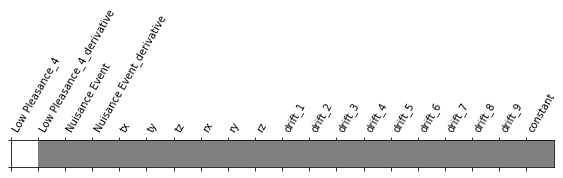

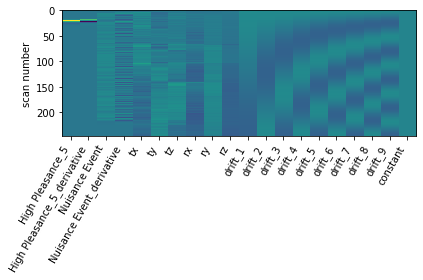

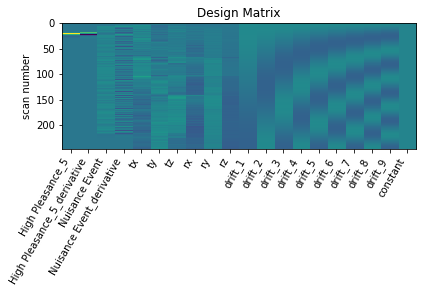

      0         1         2         3         4         5         6      \
0  1.310941 -1.756772  0.510619  0.518418  0.581648  0.134647  0.248234   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.359278  0.510546  0.109625  ... -1.848754 -1.210864 -1.787309  0.791974   

      11451    11452     11453     11454     11455     11456  
0  1.658486 -1.65556 -1.359108 -2.247352  1.443198 -2.402026  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_5
GLM RUN HighPleasance_6


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



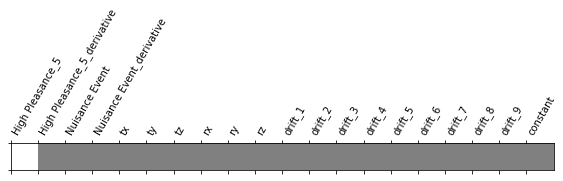

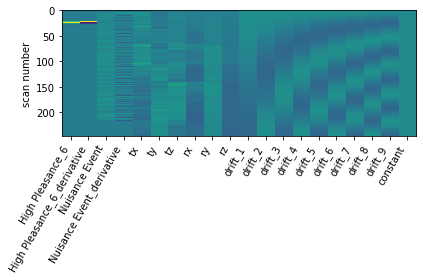

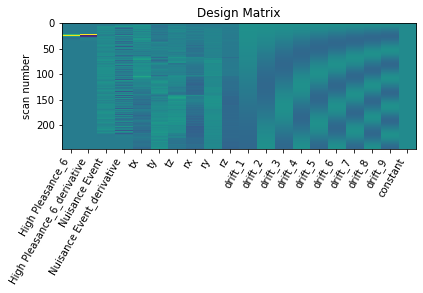

      0         1         2         3         4         5         6      \
0 -1.366717 -0.229405 -0.521911 -0.495689 -0.432641  0.302298 -1.121311   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.976304 -0.672832 -0.631813  ... -1.022455 -1.310036 -1.017308 -0.178479   

      11451     11452     11453     11454     11455     11456  
0 -0.980095 -1.163597 -0.834272 -0.887166 -0.681849 -0.243512  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_6
GLM RUN LowPleasance_7


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



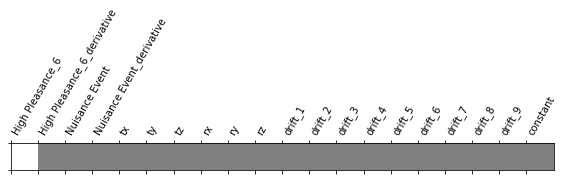

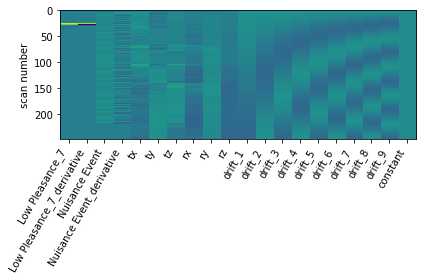

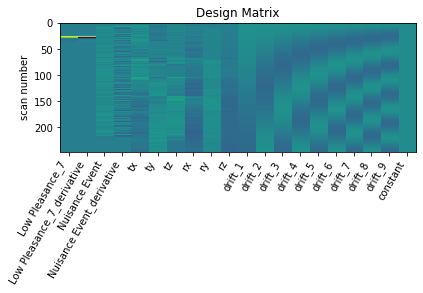

     0         1         2         3         4         5         6      \
0 -0.54076 -0.215731 -0.014388 -0.388996 -0.882604 -0.207919 -0.464263   

      7         8         9      ...    11447     11448     11449     11450  \
0  0.153733  0.357377 -0.269446  ... -1.00083 -0.012757 -0.834356 -0.562932   

      11451     11452     11453     11454     11455     11456  
0 -0.956795 -1.242028  0.559085 -1.602355 -1.291045 -1.364135  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_7
GLM RUN HighPleasance_8


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 19 seconds



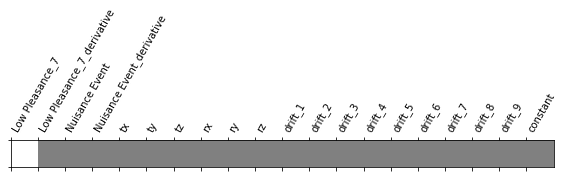

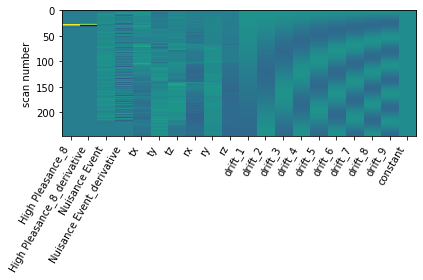

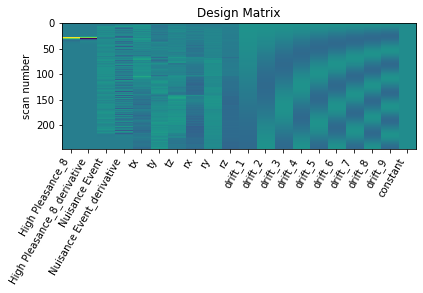

      0         1         2         3         4         5         6      \
0  0.279325 -1.251353 -0.881484 -0.523177 -0.040132 -0.326249 -0.961706   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.824039 -0.433961 -0.162697  ... -1.036641 -1.191157 -0.847137 -0.610313   

      11451     11452     11453     11454     11455     11456  
0  0.803453 -1.082963 -0.906514 -1.009173  1.590823 -0.199981  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_8
GLM RUN HighPleasance_9


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



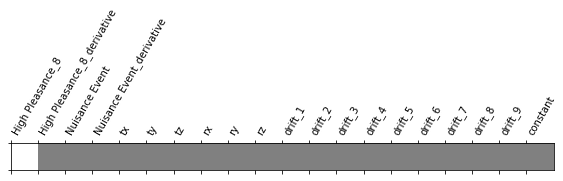

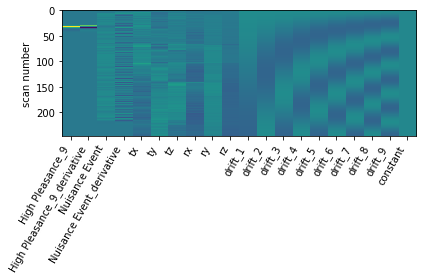

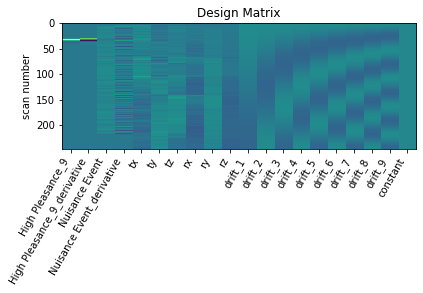

      0         1         2         3         4         5         6      \
0 -0.131021 -0.750359 -0.265052 -0.294213 -0.091966  1.354307 -0.145374   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.540373  1.034701  0.551642  ... -2.278944 -1.690065 -2.123413  0.158672   

      11451     11452     11453     11454     11455     11456  
0 -0.429044 -2.082176  0.226853 -2.669249 -1.314592 -2.461995  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_9
GLM RUN HighPleasance_10


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



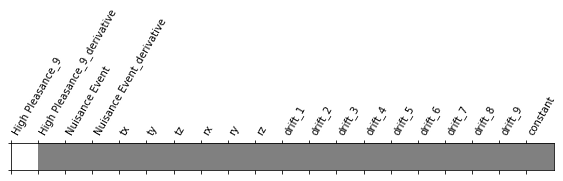

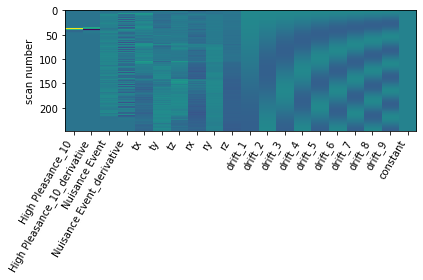

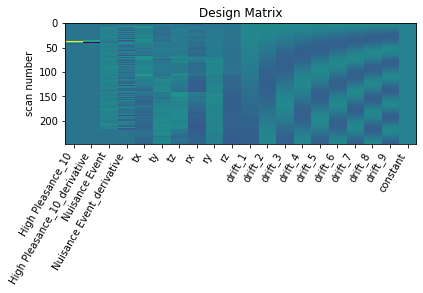

      0         1         2         3         4         5         6      \
0  0.384649 -0.845632 -0.745248 -0.260572 -0.280564 -0.864189 -0.334801   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.037004 -0.384122  0.121168  ... -1.729109 -1.365259 -1.631553 -0.329354   

      11451     11452    11453    11454     11455     11456  
0  0.379175 -1.724371 -0.97873 -1.81936  0.477226 -0.613329  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_10
GLM RUN LowPleasance_11


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



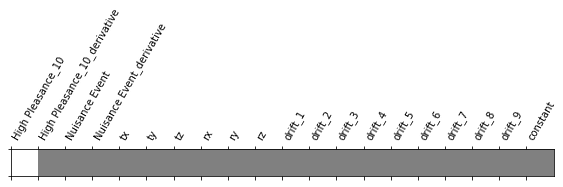

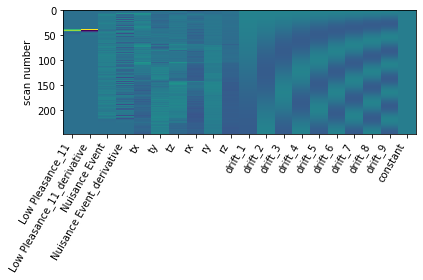

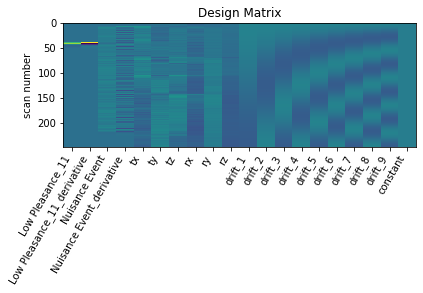

      0         1         2         3         4         5         6      \
0 -0.075131 -0.871593  1.281931  0.924985  0.744169  1.010062 -1.114117   

      7        8         9      ...     11447    11448     11449     11450  \
0 -0.540065  0.22569 -0.427143  ... -0.932066 -0.58096 -0.175709  0.016154   

      11451     11452     11453     11454    11455     11456  
0 -0.312366 -0.306714  0.303852 -0.742983  0.02445 -2.379084  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_11
GLM RUN LowPleasance_12


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



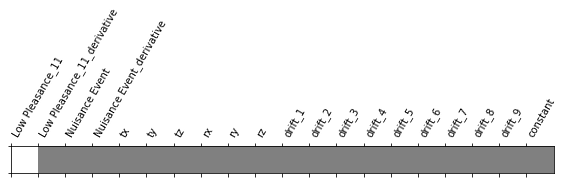

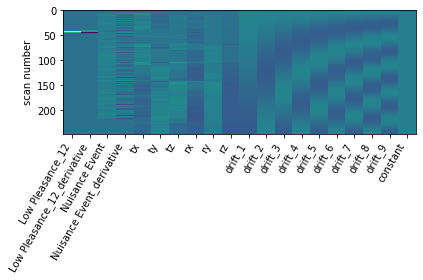

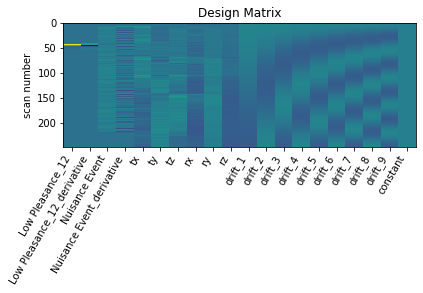

      0         1         2         3         4         5         6      \
0 -1.064823 -0.239293 -1.473535 -1.080873 -0.294708 -0.531985  0.043648   

      7         8       9      ...     11447     11448     11449     11450  \
0  0.001686  0.178114  0.2672  ... -0.670335 -0.403506 -1.310428 -0.575767   

      11451     11452     11453     11454     11455     11456  
0 -0.479422 -1.648063 -0.678514 -1.355097  0.122121  0.318958  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_12
GLM RUN HighPleasance_13


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



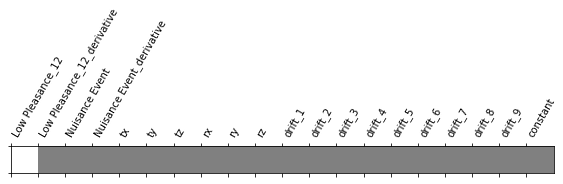

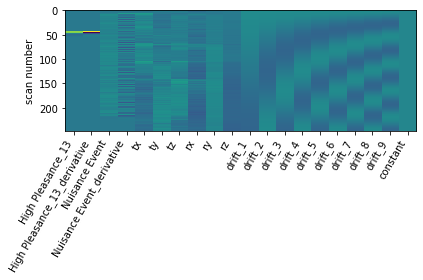

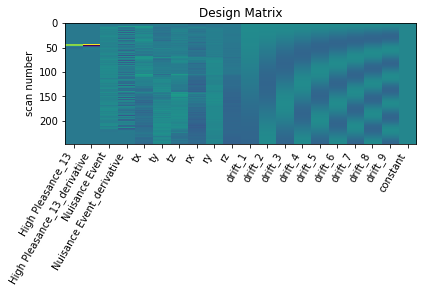

      0         1         2         3         4         5         6      \
0 -0.569346 -0.959485 -0.506111 -0.281795 -0.365024 -0.858762 -0.313974   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.041612 -0.146553 -0.296221  ... -0.378029 -0.639578 -0.353975 -0.538797   

      11451     11452     11453     11454     11455     11456  
0 -0.205802 -0.522568 -1.325178  0.075813  0.301132  0.500572  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_13
GLM RUN HighPleasance_14


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



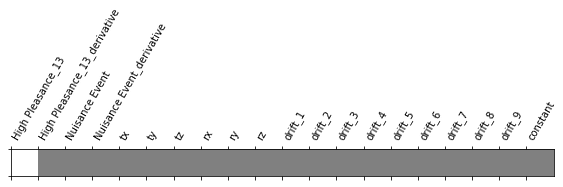

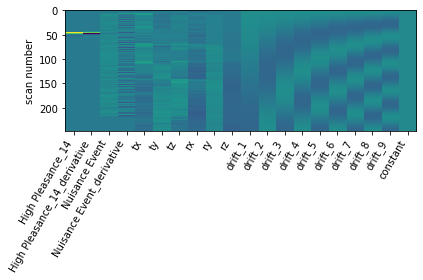

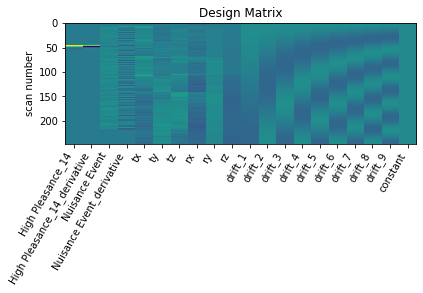

      0         1         2         3         4        5         6      \
0  0.659553  0.110985  0.691229  0.453517  0.053747  0.73685  0.042135   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.273786 -0.000172 -0.190456  ... -1.375172 -1.563847 -0.303638 -0.590673   

      11451     11452    11453     11454     11455     11456  
0  0.071751  0.203747 -0.11821 -0.595892 -0.516383 -0.117206  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_14
GLM RUN HighPleasance_15


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



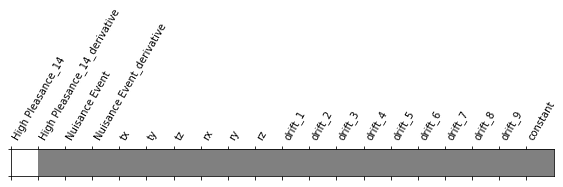

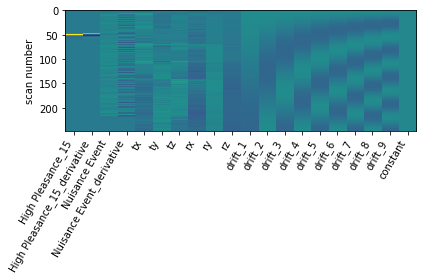

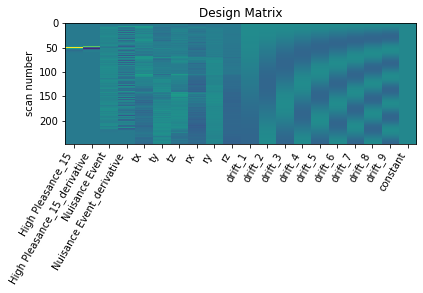

     0         1         2         3        4         5         6      \
0 -0.81913 -0.626421 -0.398547 -0.124839 -0.00382 -0.431361 -1.221023   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.176061 -0.711696 -0.827681  ... -0.273623 -0.180313 -0.600726  0.486382   

      11451     11452     11453     11454     11455    11456  
0 -0.089609 -1.264203  0.293965 -0.534093 -0.026681 -0.90051  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_15
GLM RUN HighPleasance_16


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



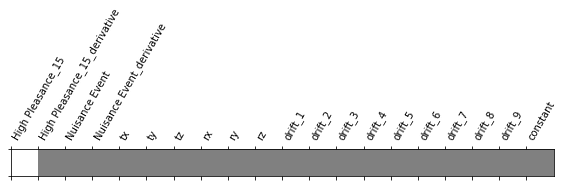

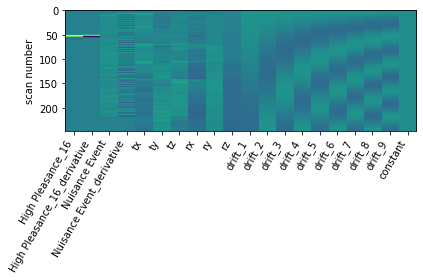

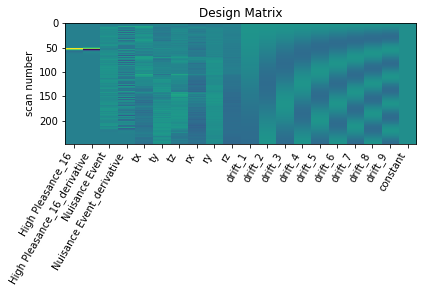

      0         1         2         3         4         5         6      \
0  0.885115 -1.795421  0.182768  0.474064  0.701962  0.518626  0.276992   

      7         8         9      ...    11447     11448     11449     11450  \
0  1.358691  1.579459  1.530616  ... -1.21075 -1.196295 -1.430385  0.050748   

      11451     11452     11453     11454     11455     11456  
0 -0.240961 -1.350099 -0.221276 -1.351462  0.244801 -0.870698  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_16
GLM RUN HighPleasance_17


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



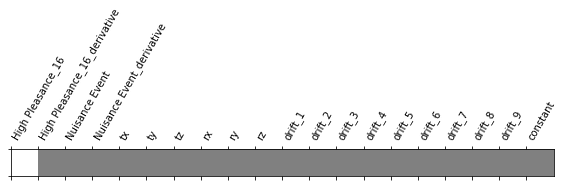

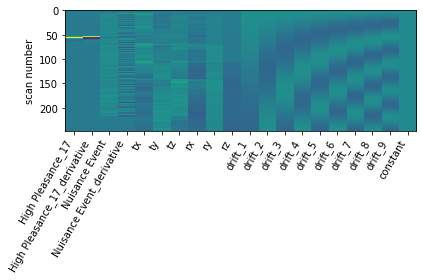

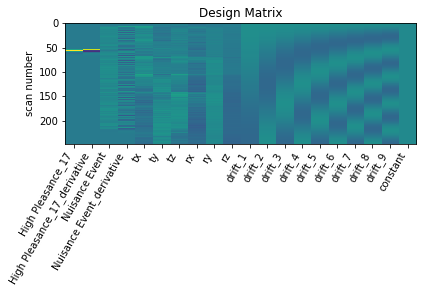

      0         1        2         3         4         5         6      \
0 -0.185284  0.396962 -1.21163 -0.766186 -0.351137  0.509399 -0.588055   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.188537 -0.006447 -0.021767  ... -1.903464 -1.628676 -1.303869 -0.485715   

      11451     11452     11453     11454     11455     11456  
0  0.787086 -1.590015 -0.229131 -1.471346 -0.329834 -0.925075  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_17
GLM RUN LowPleasance_18


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



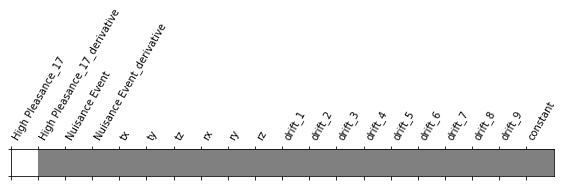

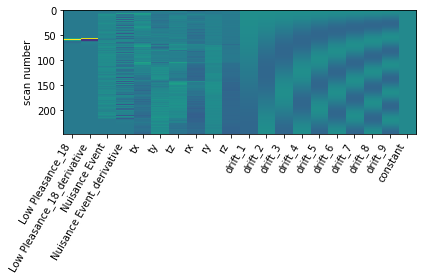

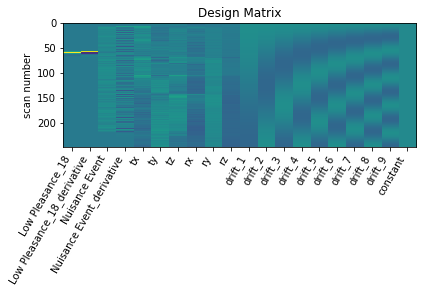

     0         1         2         3         4         5         6      \
0  0.01606 -0.188208  1.013598  0.951925  0.425292  0.199398 -0.360887   

      7         8        9      ...     11447     11448     11449    11450  \
0 -0.233785  0.125196 -0.79044  ...  0.784222  0.248946  0.290948 -1.23128   

      11451     11452    11453     11454     11455     11456  
0 -0.604939 -0.108671 -0.53544  0.877588 -0.856974  0.743739  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_18
GLM RUN LowPleasance_19


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



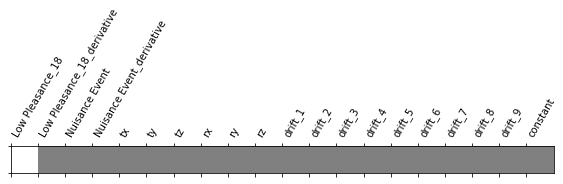

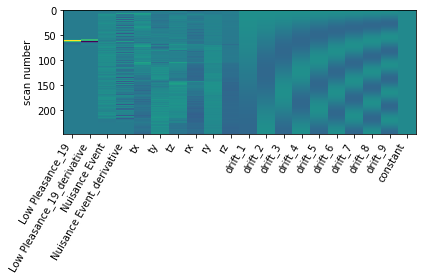

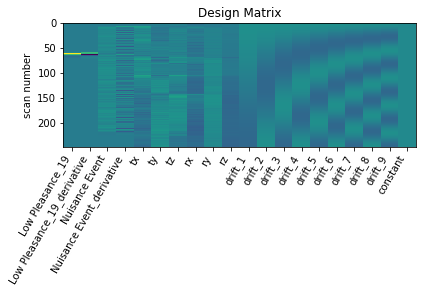

      0        1         2         3         4         5         6      \
0 -0.694596  0.30087 -0.819006 -0.370329  0.149904  0.355556  0.399934   

     7         8         9      ...     11447    11448     11449     11450  \
0  1.01843  0.914736  0.407922  ... -0.801682 -0.37185 -0.833693  1.792103   

      11451    11452     11453     11454     11455     11456  
0  0.428507 -0.83804  0.133887 -0.753806  0.826407 -1.668317  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_19
GLM RUN HighPleasance_20


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



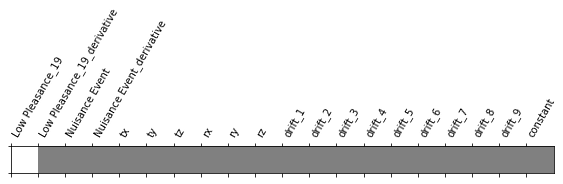

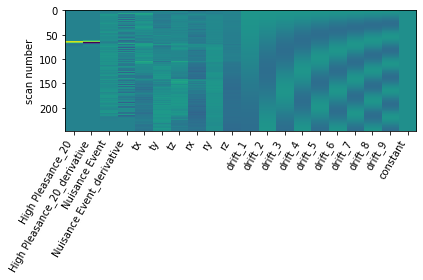

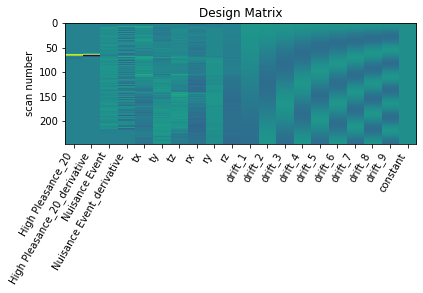

      0         1        2         3         4         5         6      \
0  0.435728 -1.960281  0.28121 -0.188023 -0.345473  0.062927 -0.393976   

      7         8         9      ...     11447     11448    11449     11450  \
0 -0.392717 -0.005536  0.248397  ... -1.806119 -0.988766 -1.63585 -0.671583   

      11451    11452     11453     11454     11455     11456  
0  0.174698 -1.86409 -0.476816 -1.930207  0.185983 -1.553324  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_20
GLM RUN HighPleasance_21


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



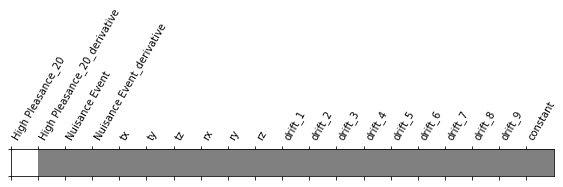

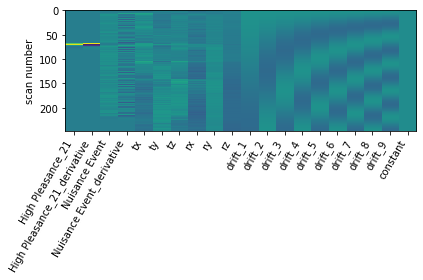

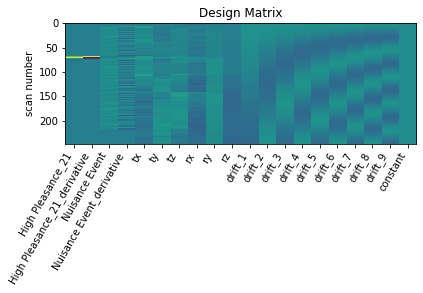

      0        1         2         3         4         5         6      \
0 -0.700632 -0.00973  0.583924  0.674325  0.270161  0.921974 -0.580586   

      7         8        9      ...     11447     11448     11449     11450  \
0  0.375794  0.864128  0.24267  ... -2.064664 -1.455454 -1.686306  1.336738   

      11451     11452     11453     11454     11455     11456  
0 -0.325109 -1.600954  0.939381 -2.410495  0.389238 -1.742352  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_21
GLM RUN LowPleasance_22


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



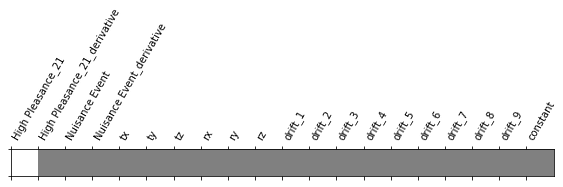

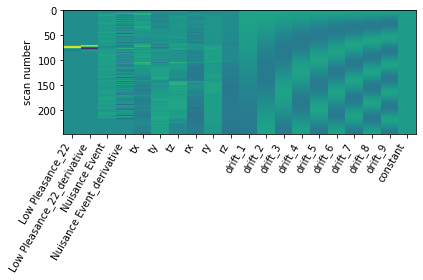

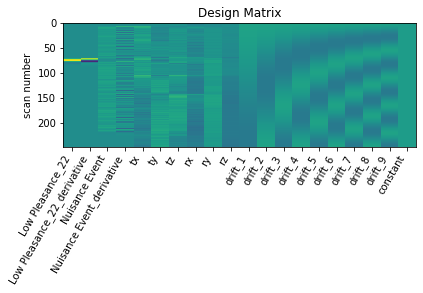

      0         1         2         3         4         5         6      \
0  0.321436 -1.594696  0.170806  0.238092  0.476168 -0.515558 -1.702332   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.744165 -1.231377 -0.867909  ... -1.466128 -1.327712 -1.453988 -1.783587   

      11451     11452     11453    11454     11455     11456  
0  0.081464 -1.540717 -2.696245 -1.58418 -0.145383 -1.263409  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_22
GLM RUN LowPleasance_23


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



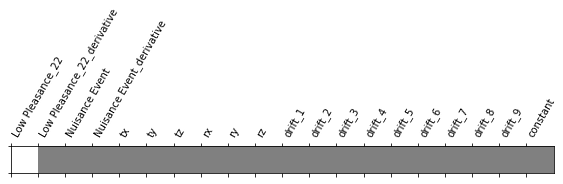

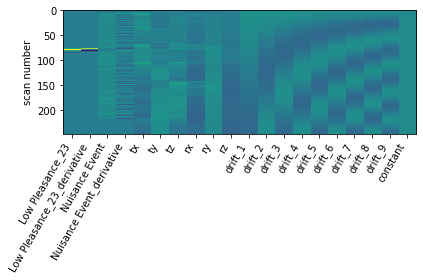

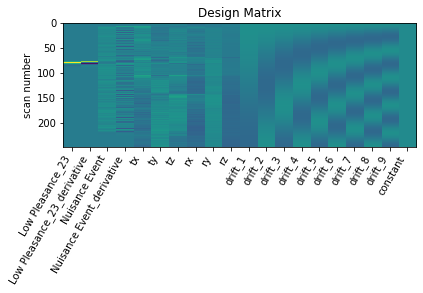

      0         1         2         3         4         5         6      \
0 -0.376475 -0.530347 -1.921628 -1.321432 -0.771115  1.301726 -0.402639   

     7         8         9      ...     11447    11448     11449     11450  \
0  0.49657  0.865387  0.070141  ... -2.495672 -2.36645 -2.643091 -0.001171   

     11451     11452    11453     11454     11455     11456  
0  0.29948 -3.143428  0.25258 -2.498041 -0.637499 -1.286272  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_23
GLM RUN LowPleasance_24


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



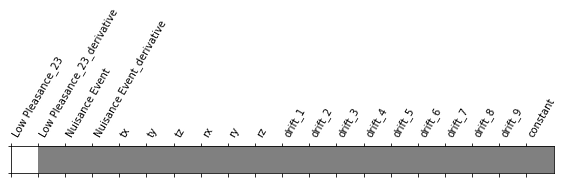

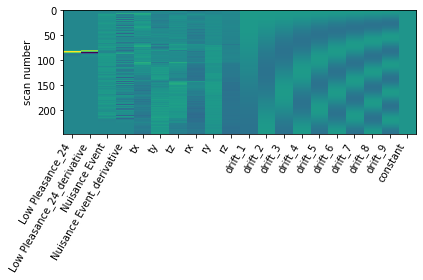

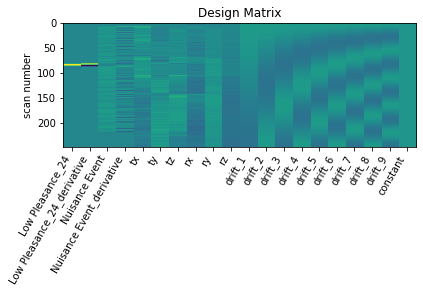

      0         1       2         3         4         5         6      \
0  0.310116 -1.337711  1.4762  1.643264  1.504354  0.104522 -0.422034   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.223799  0.220366 -0.071448  ... -1.715067 -1.151826 -1.074608  0.298544   

      11451    11452    11453     11454     11455     11456  
0 -0.263738 -0.61523 -0.88942 -1.550988  0.989394 -1.004625  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_24
GLM RUN LowPleasance_25


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



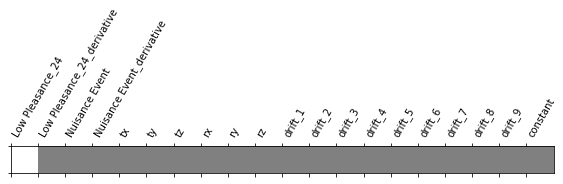

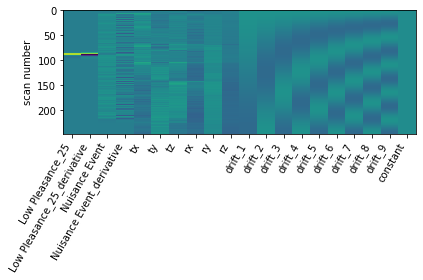

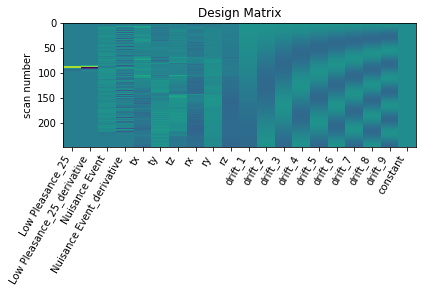

      0         1        2         3         4         5         6      \
0 -1.832209 -1.473993 -2.48111 -2.750243 -2.347307  0.168094 -1.341369   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.155614  0.427506  0.210903  ... -3.240647 -2.619015 -3.408465 -1.157796   

      11451     11452     11453     11454     11455     11456  
0  1.006324 -3.197248 -1.439773 -3.475911  0.240219 -2.335048  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_25
GLM RUN LowPleasance_26


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



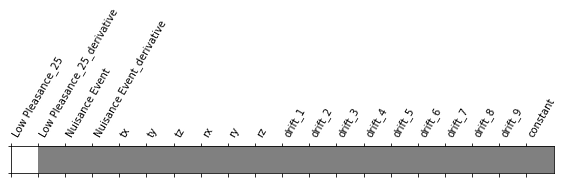

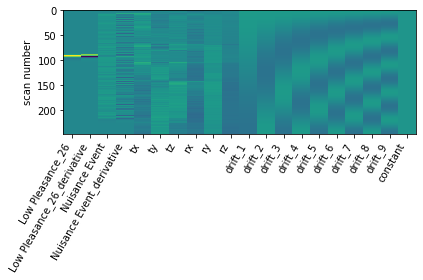

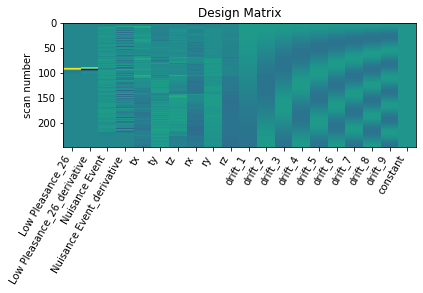

      0         1         2         3         4         5         6      \
0  0.875126 -0.170748  0.718131  1.305187  1.298582  0.222119  0.286003   

      7         8         9      ...   11447     11448     11449     11450  \
0  0.278254  0.125581  0.383657  ... -1.2837 -1.160784 -0.628115  1.369695   

      11451     11452     11453     11454     11455     11456  
0 -1.344997 -1.260672  0.716491 -1.038648 -0.640021 -0.969683  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_26
GLM RUN HighPleasance_27


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



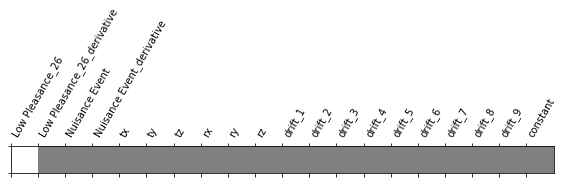

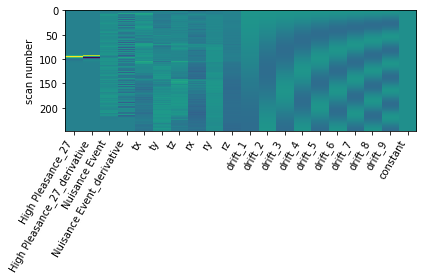

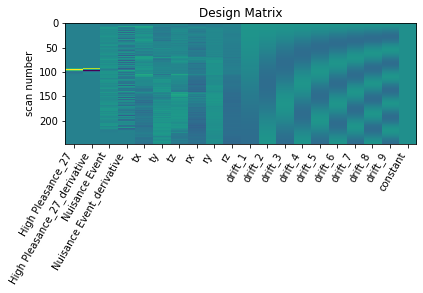

      0        1         2         3         4         5         6      \
0 -0.522424 -1.63419 -0.108376  0.042341  0.053925  0.934563 -0.548155   

     7         8        9      ...    11447     11448    11449     11450  \
0  0.59151  1.249519  0.35349  ... -1.57048 -1.078297 -1.52916 -0.673708   

      11451     11452     11453     11454     11455     11456  
0  0.756022 -1.264352 -0.551919 -1.729959  1.233137 -1.150673  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_27
GLM RUN HighPleasance_28


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



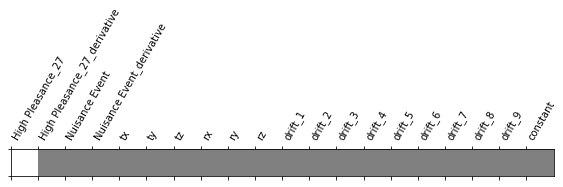

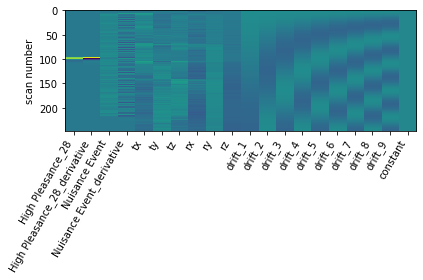

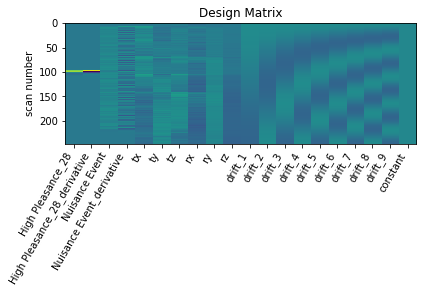

      0         1        2         3         4         5        6      \
0 -0.122203  0.538342 -0.40589  0.172758  0.852726 -0.848028  0.77209   

      7        8         9      ...     11447     11448     11449     11450  \
0  0.616195 -0.07807  0.480675  ...  0.049487  0.121538 -0.194542 -0.034461   

     11451     11452     11453     11454     11455    11456  
0  0.25417 -0.308802 -0.330038  0.407919 -1.282395  0.16056  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_28
GLM RUN LowPleasance_29


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



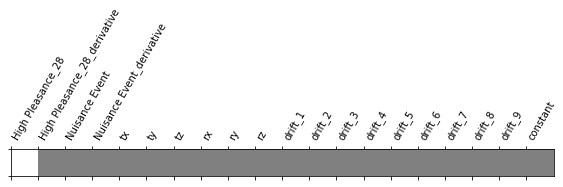

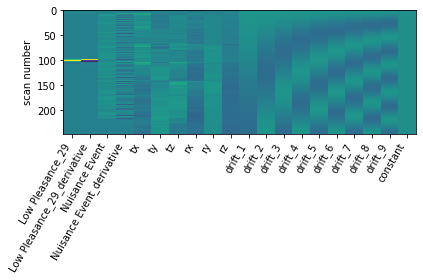

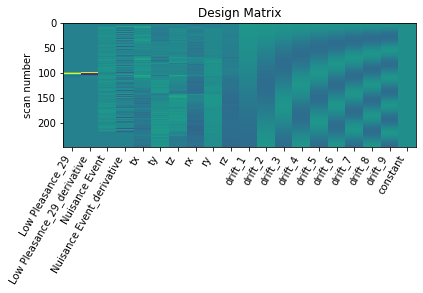

      0         1         2         3         4         5         6      \
0 -0.409193 -0.459821 -0.190438 -0.310672 -0.070434  1.420775 -0.376306   

      7         8         9      ...     11447     11448     11449    11450  \
0 -0.306975  0.230706 -1.012676  ... -2.103583 -1.617589 -2.043624  0.77567   

      11451     11452     11453     11454     11455    11456  
0 -1.498983 -2.266684  0.557555 -1.896402 -0.784452 -2.37392  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_29
GLM RUN HighPleasance_30


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



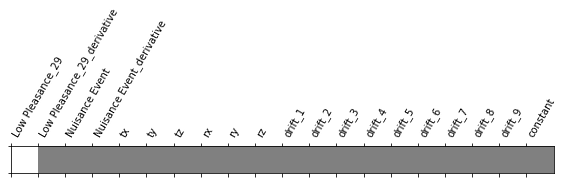

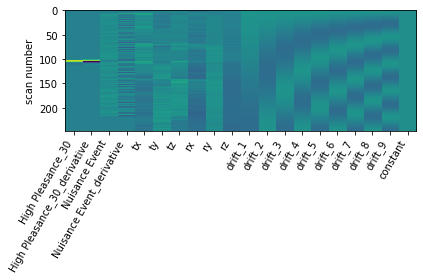

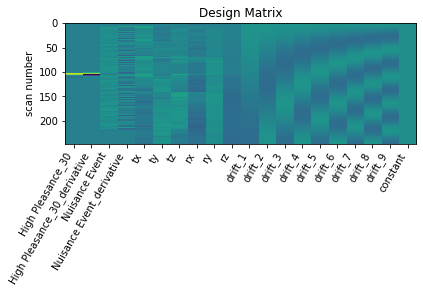

     0         1         2         3         4         5         6      \
0 -1.19797 -0.596163 -0.243786 -0.298989 -0.773356 -0.809743 -1.808696   

      7        8         9      ...     11447     11448     11449     11450  \
0 -0.599989 -0.28766 -0.056144  ... -1.909765 -2.104968 -1.534101 -1.761393   

      11451    11452     11453     11454     11455     11456  
0  0.660967 -2.24869 -0.957793 -1.760498 -1.033144 -1.229325  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_30
GLM RUN LowPleasance_31


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



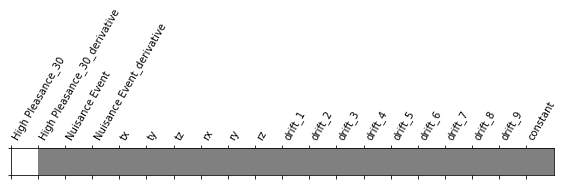

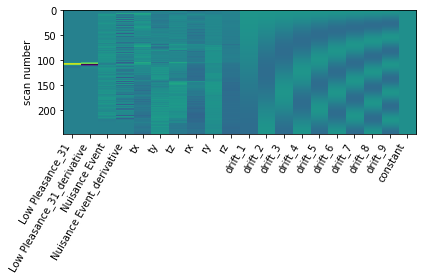

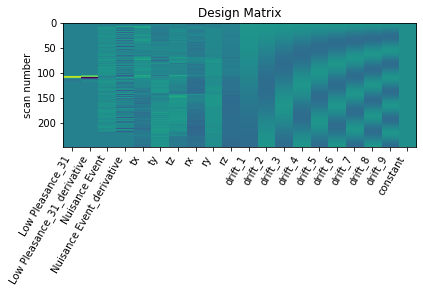

      0         1         2         3         4         5        6      \
0  2.309324 -1.096823  0.323043  0.305556  0.480821  1.592877  0.12864   

      7         8         9      ...    11447     11448     11449     11450  \
0  0.834848  1.288507  1.307688  ... -0.42639  0.025339 -0.260925  0.175956   

      11451   11452     11453     11454    11455     11456  
0  0.626319 -0.8107  0.282814 -1.360704  0.86365 -1.785396  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_31
GLM RUN HighPleasance_32


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



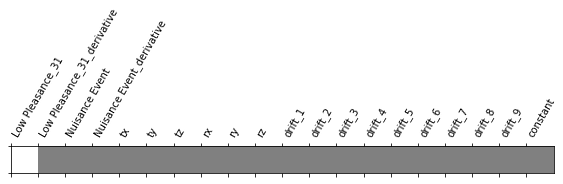

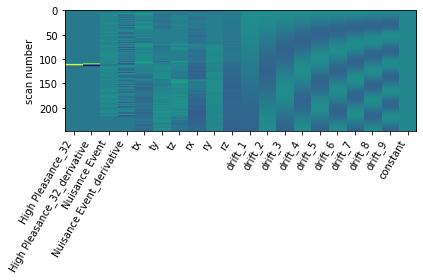

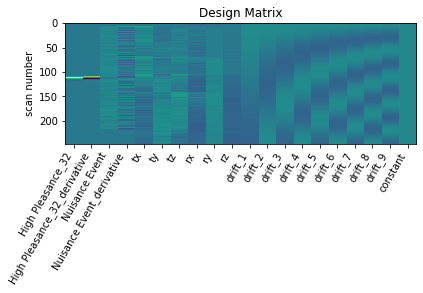

      0         1         2         3         4         5        6      \
0 -0.825796 -1.187931 -1.228453 -1.399749 -1.495591  0.267783 -0.51323   

    7         8        9      ...     11447     11448     11449     11450  \
0 -0.4866 -0.007504 -0.43434  ... -2.420554 -2.188672 -2.328303 -0.188115   

      11451    11452     11453     11454     11455     11456  
0  0.413117 -2.56683 -0.709498 -2.297642  0.608918 -2.093438  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_32
GLM RUN LowPleasance_33


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



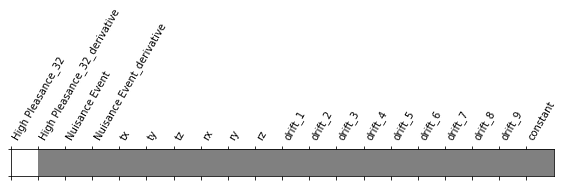

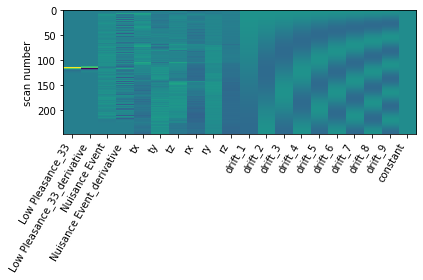

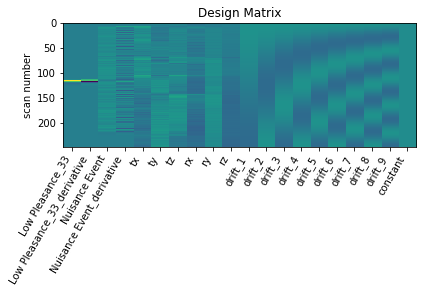

     0         1         2         3         4         5         6      \
0 -0.54467 -0.250071  0.784649  0.794134  0.399753 -0.173901 -2.104061   

      7         8         9      ...     11447     11448   11449     11450  \
0 -1.358449 -0.534122 -0.846059  ... -1.033794 -0.901762 -0.9628 -1.199385   

      11451     11452     11453    11454     11455     11456  
0 -0.455031 -1.887043 -0.158585 -1.57271 -0.158959 -1.221758  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_33
GLM RUN LowPleasance_34


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



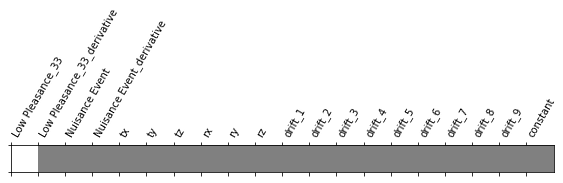

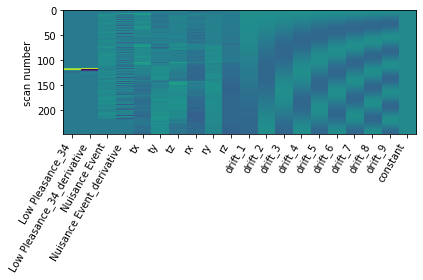

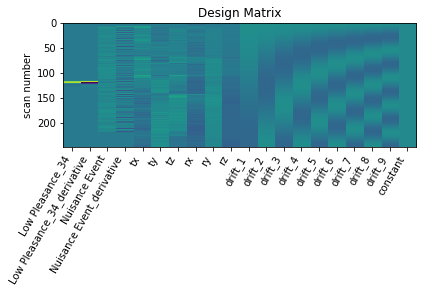

      0         1         2         3         4         5         6      \
0  0.339034  0.078526 -0.013642 -0.469079 -0.808469  0.727588 -0.117931   

      7         8         9      ...     11447     11448     11449    11450  \
0 -0.100027  0.121392 -0.218756  ... -0.350722 -0.141113 -0.236035  0.05624   

      11451     11452     11453     11454     11455     11456  
0  0.265593 -0.795068 -0.233583 -0.552573  0.275738 -0.455715  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_34
GLM RUN LowPleasance_35


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



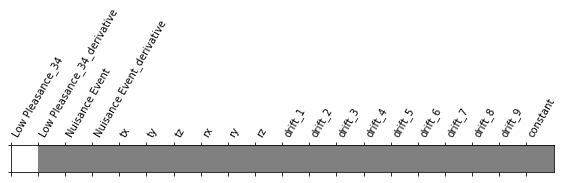

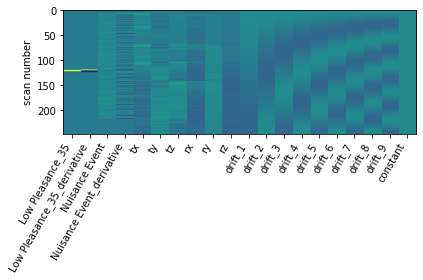

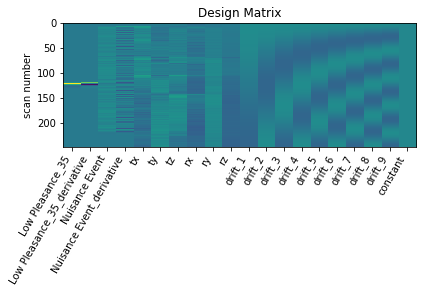

      0         1         2         3         4         5         6      \
0 -0.127465 -1.485183 -0.914533 -0.557532 -0.121013 -0.195921 -0.250895   

      7         8         9      ...     11447     11448   11449     11450  \
0 -0.143159  0.062548  0.077984  ... -1.461179 -1.403113 -1.2216 -0.174482   

     11451     11452     11453     11454    11455     11456  
0  0.59998 -0.863062 -0.526759 -1.284696  0.77034 -1.372763  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_35
GLM RUN LowPleasance_36


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



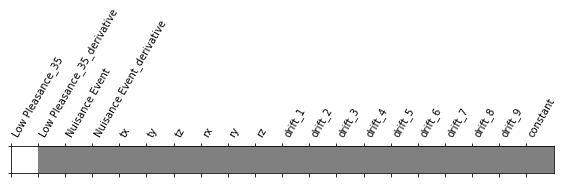

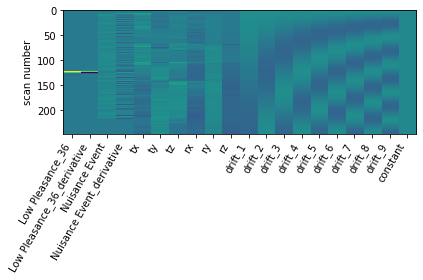

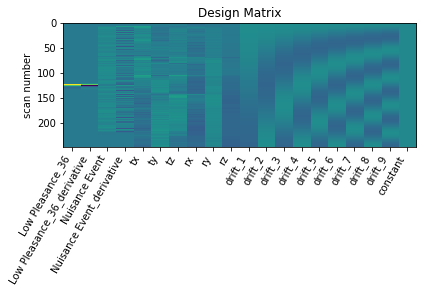

      0         1         2         3         4         5         6      \
0  0.063042 -0.806731  0.771053  1.093542  1.132485  0.796826  0.513428   

      7         8         9      ...    11447     11448     11449     11450  \
0  1.133197  1.266667  1.095746  ... -1.10131 -0.731666 -1.047957 -0.636367   

      11451    11452     11453     11454     11455     11456  
0 -0.878954 -0.92367 -0.202196 -1.105767  0.149019 -0.297033  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_36
GLM RUN HighPleasance_37


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



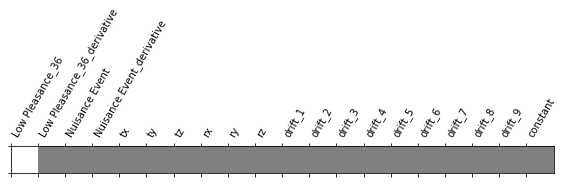

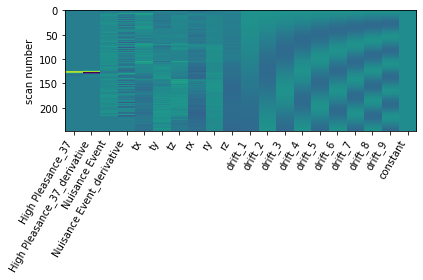

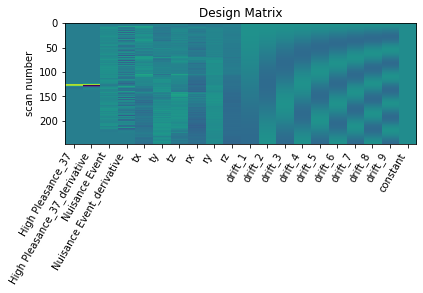

      0         1        2         3         4         5         6      \
0 -1.574162 -0.803685 -1.85019 -2.033045 -1.965825 -0.296378 -1.872773   

      7         8         9      ...     11447     11448    11449     11450  \
0 -0.992133 -0.544147 -0.556173  ... -2.772001 -2.627544 -2.62584 -0.364667   

      11451     11452     11453     11454     11455     11456  
0  0.800067 -3.313678 -0.950981 -2.775669 -0.975391 -2.173519  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_37
GLM RUN HighPleasance_38


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



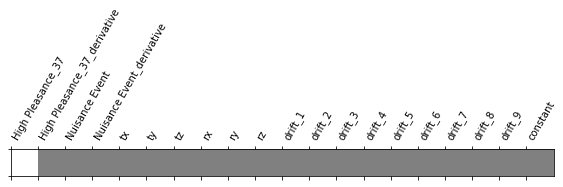

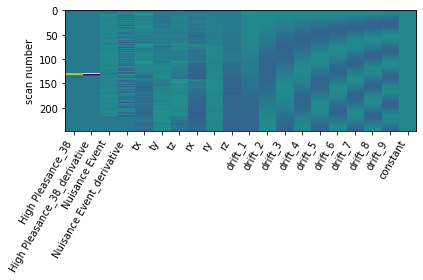

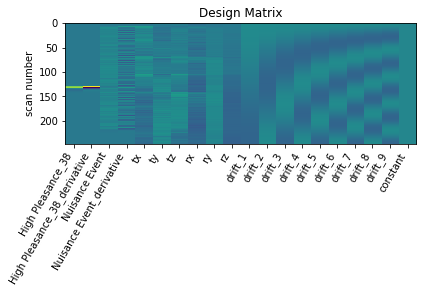

      0         1         2         3         4         5         6      \
0  1.237252 -0.485459  1.152254  2.119443  2.652673  0.321694  0.783746   

      7        8         9      ...     11447     11448    11449    11450  \
0  0.716718  0.74951  1.047861  ... -0.754439 -0.570747 -0.71617  0.14472   

      11451     11452     11453     11454     11455     11456  
0 -1.536254  0.160625 -0.556784 -0.353059  0.555152  0.311426  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_38
GLM RUN LowPleasance_39


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



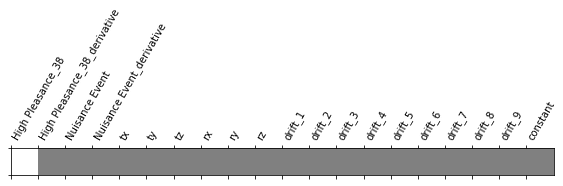

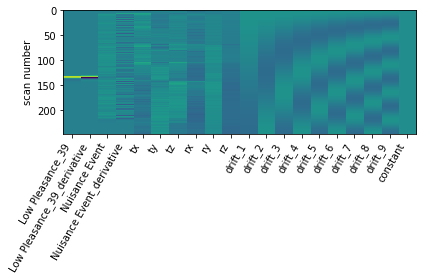

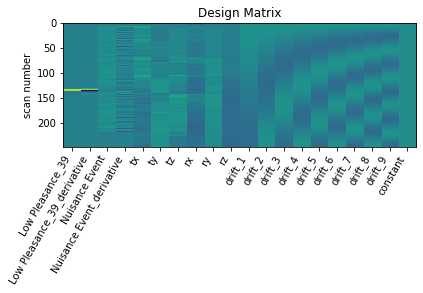

     0         1         2        3         4         5         6      \
0 -0.30601 -1.131619 -0.741955 -0.65511 -0.317169  1.120274  1.216205   

      7         8         9      ...     11447    11448     11449     11450  \
0  1.429596  1.028295  0.813793  ... -1.192042 -0.98263 -1.134999  0.157288   

      11451    11452     11453     11454     11455     11456  
0  0.574379 -1.42102  0.009611 -1.071729 -0.260439 -1.643087  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_39
GLM RUN LowPleasance_40


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



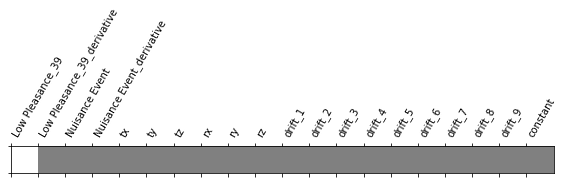

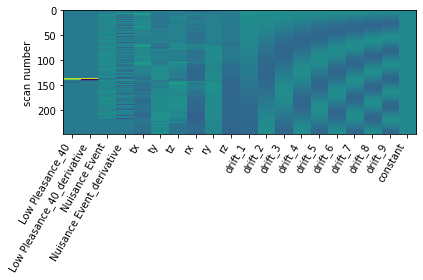

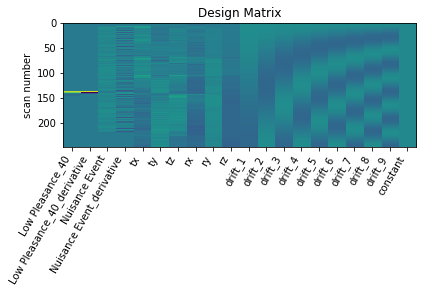

      0        1         2         3         4         5         6      \
0 -0.894418 -0.63878 -0.156739  0.247561  0.242873 -0.552604 -1.869842   

      7       8         9      ...     11447     11448     11449     11450  \
0 -1.303103 -0.5896 -0.618715  ... -1.659921 -1.142329 -2.049682  1.121134   

     11451    11452     11453     11454     11455     11456  
0 -1.03901 -0.94554 -0.256873 -1.541316  1.363379  0.449337  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_40
GLM RUN LowPleasance_41


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



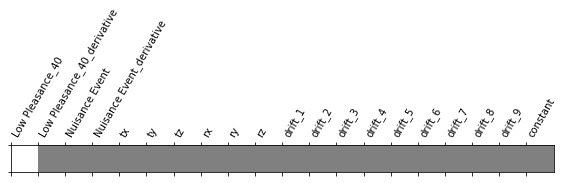

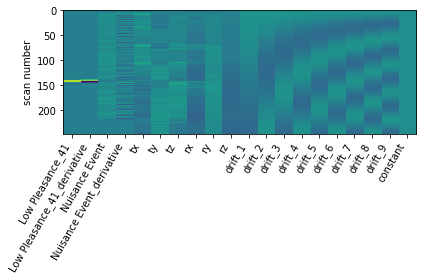

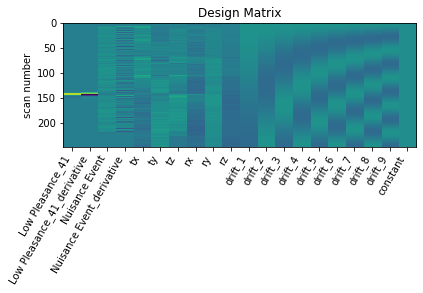

      0         1         2         3         4         5         6      \
0  0.079896 -1.275382 -0.369369 -0.382432 -0.013515  0.101904  0.025065   

     7         8         9      ...     11447     11448     11449     11450  \
0  0.40027  0.126399 -0.192462  ... -2.335584 -1.475196 -1.733324  0.384409   

      11451     11452     11453     11454     11455     11456  
0 -0.212312 -2.091242 -0.315034 -2.755228 -0.376834 -3.366993  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_41
GLM RUN LowPleasance_42


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



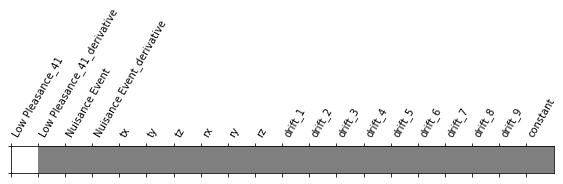

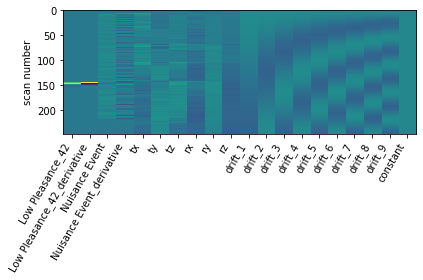

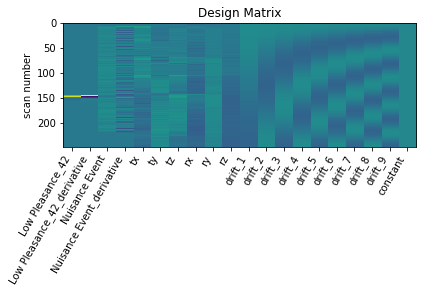

      0         1         2         3         4         5         6      \
0 -0.839156 -0.075357  0.142012 -0.024554 -0.701293 -0.295473 -1.487168   

      7         8         9      ...     11447     11448    11449     11450  \
0 -0.570899  0.367398  0.370201  ... -1.258215 -1.922629 -1.17273 -2.867307   

      11451     11452    11453    11454     11455     11456  
0  0.053591 -1.814306 -1.27391 -0.50001 -1.377275 -0.437159  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_42
GLM RUN LowPleasance_43


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



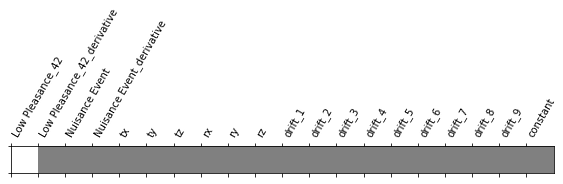

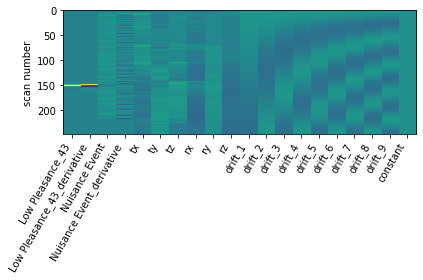

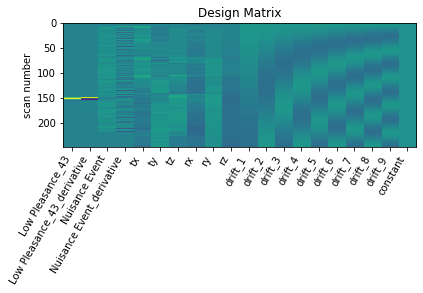

      0         1         2         3         4         5         6      \
0  1.013103  0.111362 -0.184523  0.043631  0.158433  0.803804 -0.793418   

      7         8        9      ...     11447     11448     11449     11450  \
0  0.224046  0.597979 -0.18995  ... -0.718897 -0.340872 -0.641765 -0.096594   

      11451     11452     11453     11454     11455    11456  
0  0.541515 -1.613626  0.923415 -1.340185 -1.257665 -1.44447  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_43
GLM RUN HighPleasance_44


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



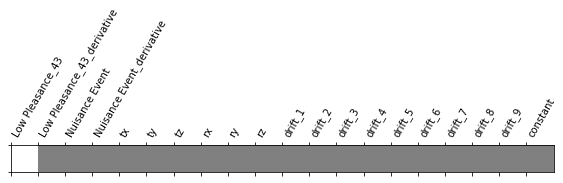

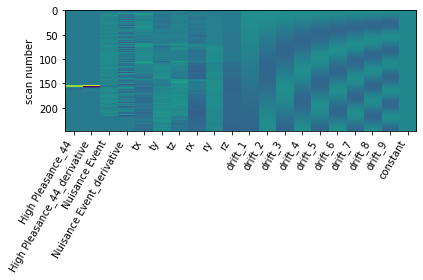

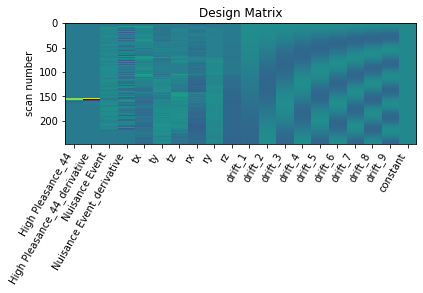

      0         1         2         3         4         5         6      \
0 -1.726621 -1.777753 -1.468071 -1.466931 -1.177943 -0.691567 -0.429865   

      7        8         9      ...     11447     11448     11449     11450  \
0 -0.803067 -0.64626 -0.341807  ... -1.020213 -0.969204 -1.081432  0.229632   

      11451    11452     11453     11454     11455    11456  
0  0.255458 -1.55374 -1.688965 -0.903535  0.792753 -0.71308  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_44
GLM RUN LowPleasance_45


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



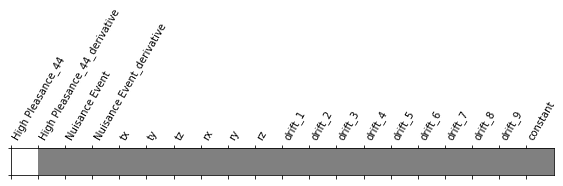

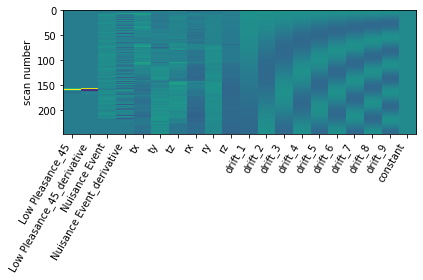

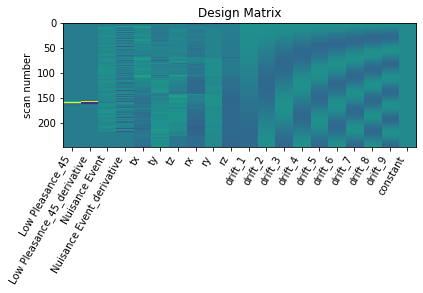

      0         1         2         3         4         5         6      \
0  0.142453 -0.681301 -0.226058 -0.658672 -0.555937  0.610312 -1.249354   

      7         8         9      ...  11447     11448     11449     11450  \
0 -0.768885 -0.217174 -1.193941  ... -1.673 -1.314103 -1.415601 -1.387414   

      11451     11452     11453     11454     11455     11456  
0 -0.055269 -1.361877 -0.433017 -1.310449  0.151706 -1.248349  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_45
GLM RUN LowPleasance_46


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



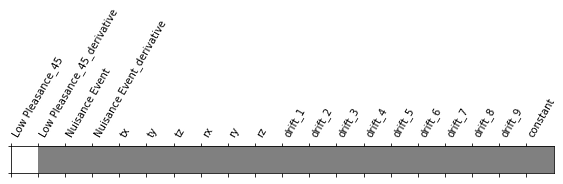

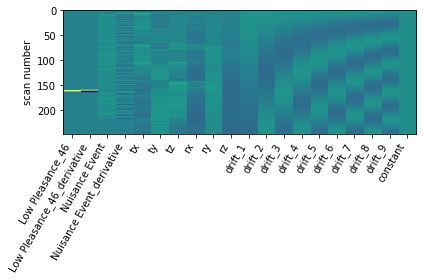

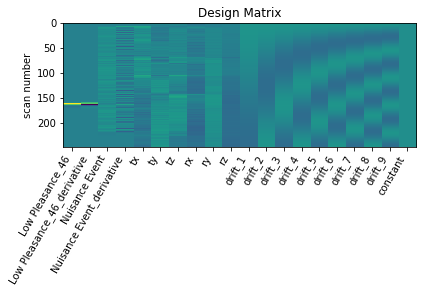

      0         1         2         3         4         5         6      \
0 -0.307655  0.762318  0.086915  0.245697  0.115889 -0.342548 -0.857589   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.560217 -0.453293 -0.591423  ...  0.174194 -0.105687 -0.118251  0.654317   

      11451    11452     11453     11454     11455     11456  
0 -0.863366 -0.11364 -0.292208 -0.277185 -0.833108  0.345403  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_46
GLM RUN HighPleasance_47


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



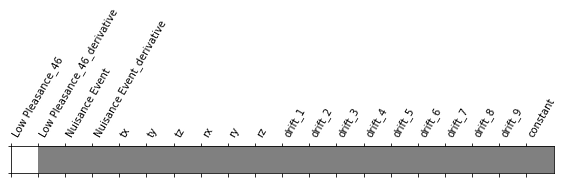

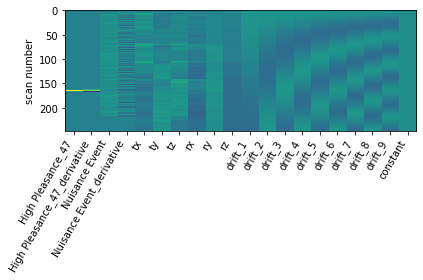

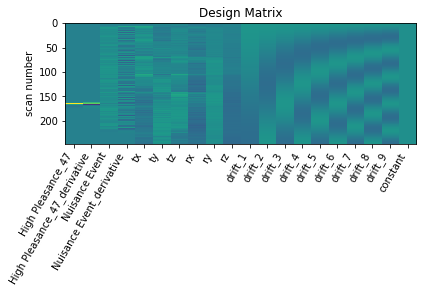

      0         1         2         3         4         5         6      \
0 -0.258621 -1.883638 -0.202373 -0.318641 -0.340951  0.234955  0.312049   

      7        8         9      ...     11447    11448     11449     11450  \
0 -0.150451 -0.25886  0.315915  ... -1.199367 -0.71452 -0.798972 -0.643286   

      11451     11452     11453     11454     11455     11456  
0  1.050319 -0.731267 -0.812366 -0.629394  0.161583  0.155195  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_47
GLM RUN LowPleasance_48


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



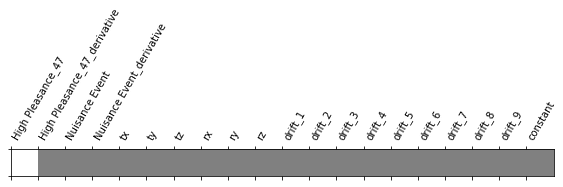

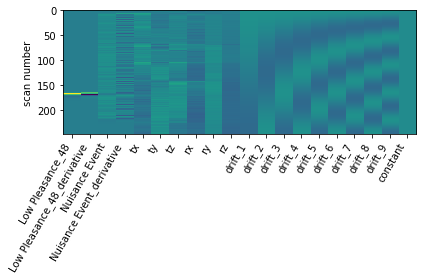

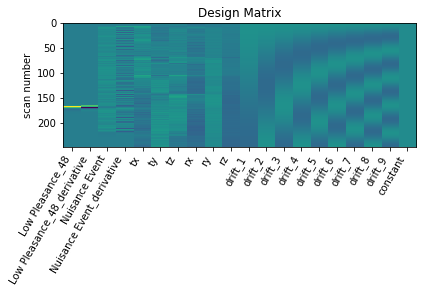

      0         1         2         3        4         5         6      \
0 -0.075306 -0.775468 -1.067938 -0.485432  0.05074  0.450193 -0.201643   

     7         8         9      ...     11447     11448    11449    11450  \
0  0.76112  1.342151  0.410939  ... -2.762188 -2.464586 -2.29303 -0.37139   

      11451     11452     11453   11454     11455     11456  
0 -0.708753 -2.569615  0.029122 -3.1168  0.832505 -3.346811  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_48
GLM RUN LowPleasance_49


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



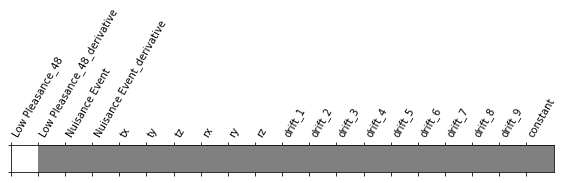

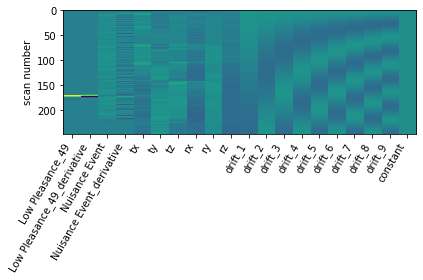

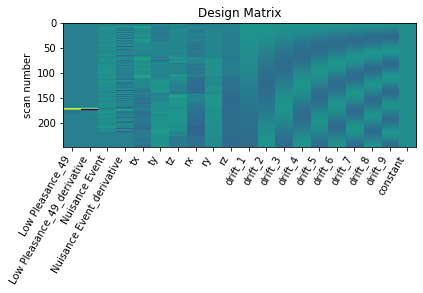

      0         1         2         3         4         5         6      \
0 -0.965563 -1.041915 -0.042962 -0.223241 -0.123722  0.019644 -0.210419   

      7         8        9      ...     11447     11448     11449    11450  \
0  0.431826  0.046814  0.83583  ... -1.842004 -1.638659 -2.112909  0.69557   

      11451     11452     11453     11454     11455     11456  
0 -0.343587 -1.986479 -1.161557 -1.408935 -0.149095 -0.210024  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_49
GLM RUN HighPleasance_50


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



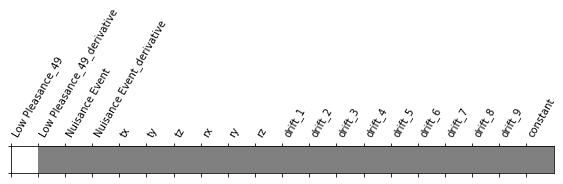

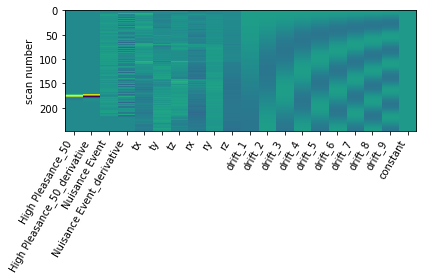

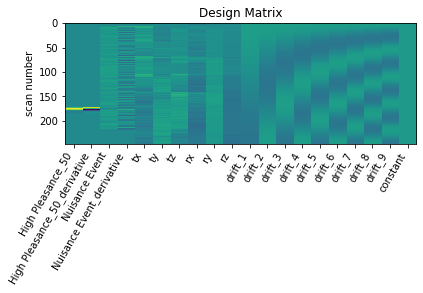

      0         1         2         3         4         5         6      \
0  1.067498 -1.197362  0.450383  0.851907  0.768163  1.047714 -0.290154   

      7         8        9      ...     11447     11448     11449     11450  \
0  0.120226  0.828715  0.51799  ... -2.152947 -1.334338 -1.299246 -0.383178   

      11451     11452     11453     11454    11455     11456  
0  0.513308 -1.041103 -0.354446 -2.724442  0.69311 -2.361163  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_50
GLM RUN HighPleasance_51


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



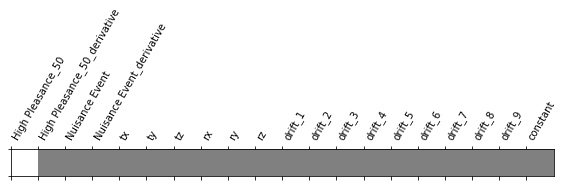

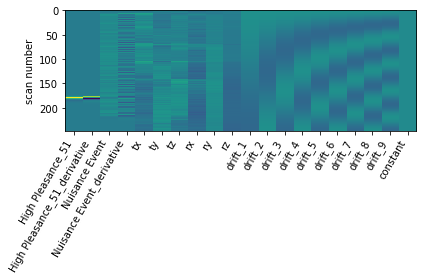

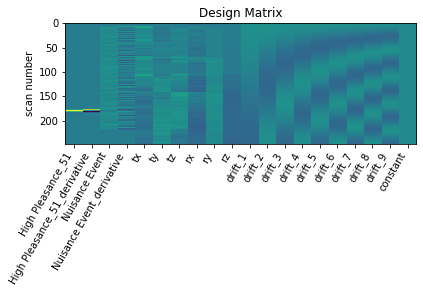

     0         1         2         3         4         5         6      \
0 -1.27872 -0.721464 -1.005104 -1.117024 -0.807248 -0.588345 -0.395555   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.128325  0.073846 -0.252961  ... -0.915168 -1.040353 -1.558556 -0.035327   

      11451     11452     11453     11454     11455     11456  
0 -0.888451 -2.442396  0.026703 -0.783944 -0.040604 -0.860883  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_51
GLM RUN HighPleasance_52


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



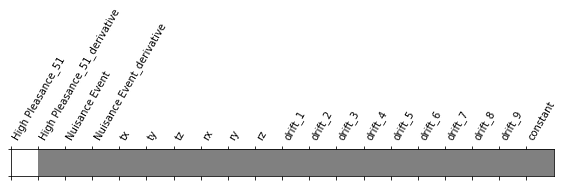

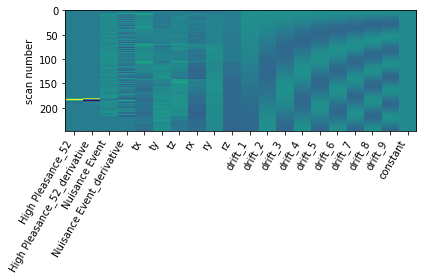

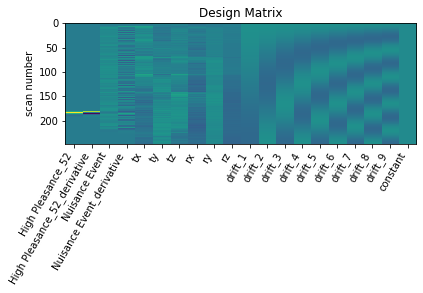

      0         1         2         3         4         5         6      \
0  0.608853  0.087954  0.254615  0.568534  0.767806  1.160825 -1.207498   

      7         8         9      ...    11447     11448     11449     11450  \
0 -0.589975  0.203873 -0.395741  ... -1.31577 -0.945866 -0.711283 -0.046169   

      11451     11452     11453     11454     11455     11456  
0  1.038099 -1.005887 -0.456963 -1.484144 -0.007928 -0.125349  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_52
GLM RUN HighPleasance_53


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



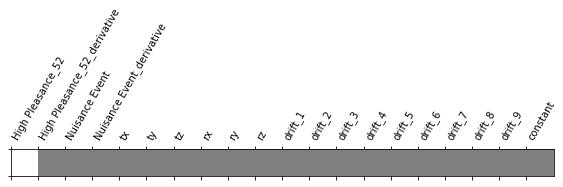

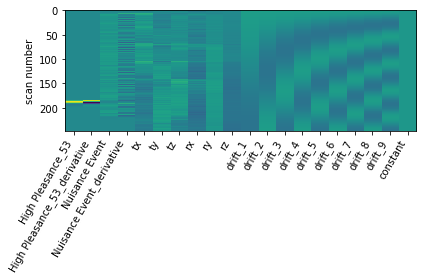

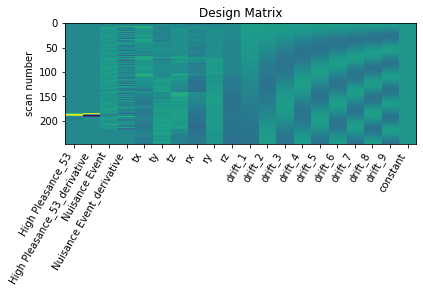

      0         1         2       3         4         5         6      \
0 -0.668038 -2.172666 -0.522534 -0.3269 -0.350028 -0.384551 -0.832392   

      7         8         9      ...     11447     11448     11449   11450  \
0 -0.185318  0.093274 -0.066485  ... -2.729067 -2.572087 -2.684876 -0.6764   

     11451     11452     11453    11454     11455     11456  
0 -0.19371 -3.129749 -1.001552 -2.62741  0.069858 -2.100817  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_53
GLM RUN LowPleasance_54


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



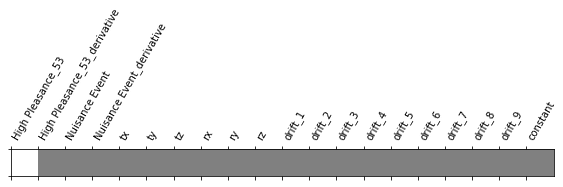

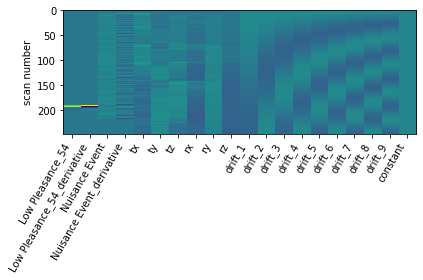

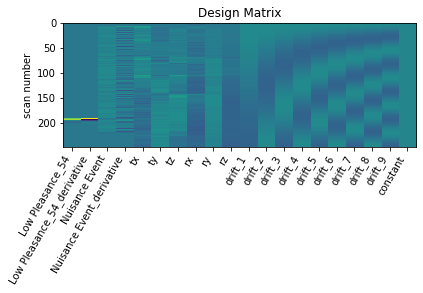

      0         1         2         3         4         5         6      \
0 -0.072048 -0.522064 -0.520899 -0.327109 -0.156898  0.756982 -1.249274   

      7         8         9      ...     11447    11448     11449     11450  \
0 -0.568857 -0.101908 -0.457856  ... -1.444299 -0.96278 -1.017056 -0.109768   

      11451     11452     11453     11454     11455     11456  
0  1.155839 -1.546759 -0.579198 -1.546831 -0.270856 -1.018226  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_54
GLM RUN HighPleasance_55


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



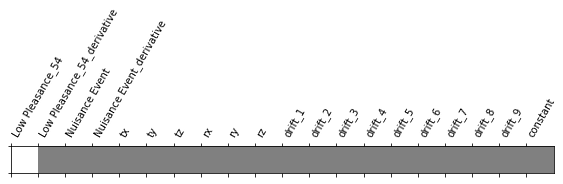

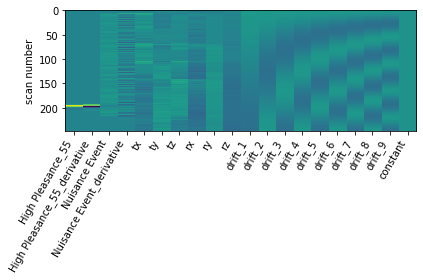

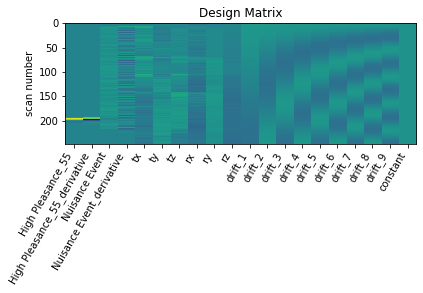

      0         1        2         3         4         5         6      \
0 -0.273049 -1.181705 -0.07374 -0.274514 -0.556843  0.345387 -0.390063   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.085822  0.298444 -0.188512  ... -1.943652 -1.587953 -1.748628 -0.669774   

      11451     11452     11453     11454     11455     11456  
0  0.297167 -1.952347 -0.269411 -2.343151 -0.364935 -2.159263  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_55
GLM RUN LowPleasance_56


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



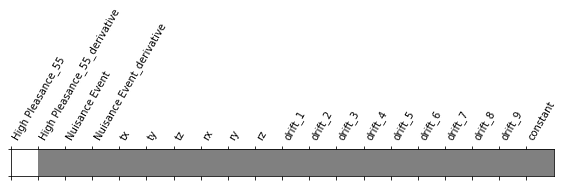

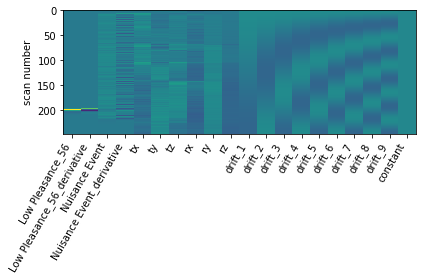

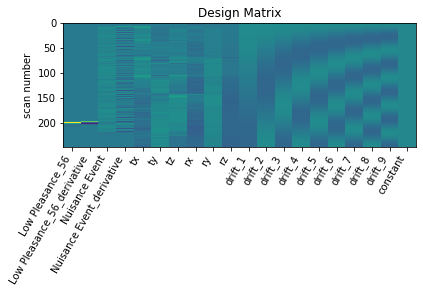

    0         1         2         3         4         5         6       7      \
0 -0.0794 -0.736947 -0.247526 -0.074529 -0.069521 -0.284823 -0.725356 -0.2194   

      8         9      ...     11447     11448     11449     11450     11451  \
0  0.070527  0.094198  ... -2.416497 -2.369438 -2.262246 -1.192721 -1.585156   

     11452     11453     11454     11455     11456  
0 -2.16267 -1.133208 -1.885104  0.475374 -0.879668  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_56
GLM RUN LowPleasance_57


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



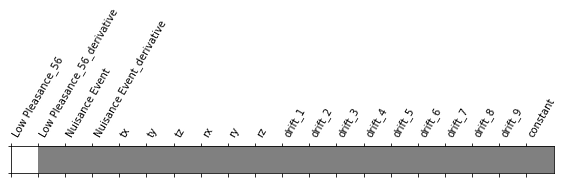

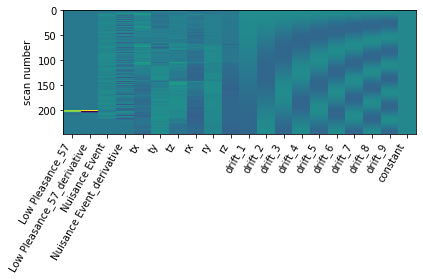

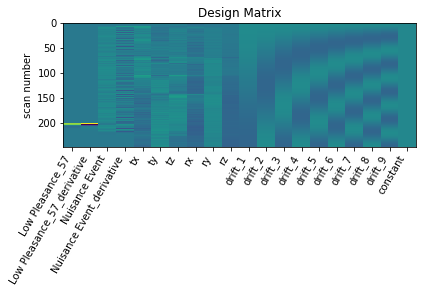

      0         1         2        3      4         5         6         7      \
0 -0.710664 -0.801879 -0.619316 -0.06838  0.549 -0.200657 -0.688946 -0.442692   

      8         9      ...     11447     11448     11449     11450     11451  \
0 -0.371578 -0.768861  ...  0.483783  1.283617  0.493753  0.820464  1.369954   

      11452     11453     11454     11455     11456  
0 -0.299095  0.177455 -0.382548 -0.193916 -0.466766  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_57
GLM RUN LowPleasance_58


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



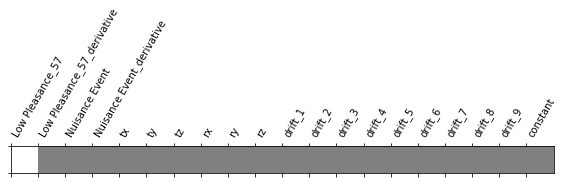

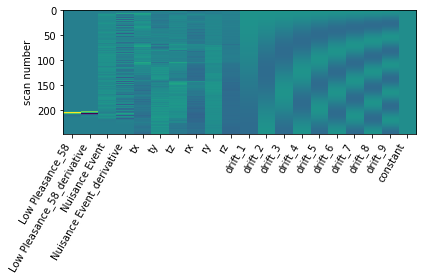

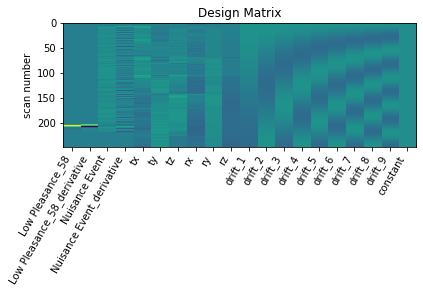

      0        1         2         3        4         5         6      \
0  0.205641  0.24503  0.499242 -0.011383 -0.50448  0.639207 -0.431626   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.014395  0.545487  0.030741  ... -1.838037 -1.568616 -1.797288 -0.099695   

      11451     11452     11453     11454     11455     11456  
0 -0.632308 -2.048436 -1.353207 -1.780525  0.469527 -1.943749  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_58
GLM RUN HighPleasance_59


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 28 seconds



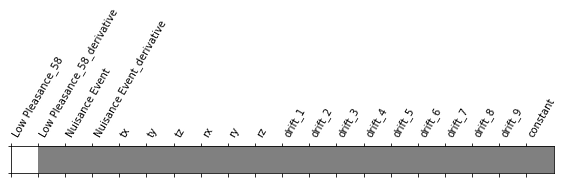

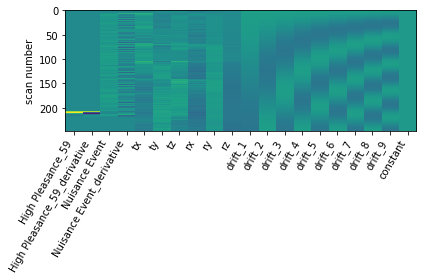

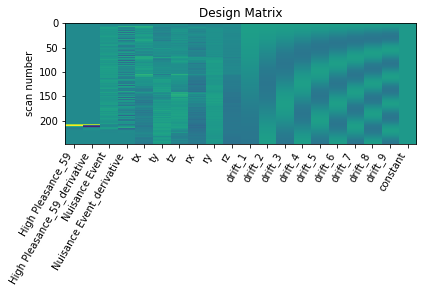

      0         1         2         3         4         5         6      \
0  0.308593 -0.951366 -0.317015 -0.039356 -0.001333  0.285698 -0.132756   

      7         8        9      ...    11447    11448     11449     11450  \
0  0.155069  0.282989  0.66316  ... -0.49755 -0.71209 -0.354305 -0.628681   

      11451     11452     11453     11454     11455     11456  
0  0.922463 -0.585614  0.615148 -0.446899  0.102439 -0.338017  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_59
GLM RUN HighPleasance_60


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



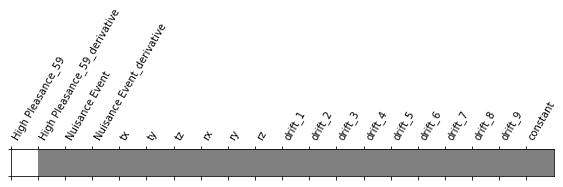

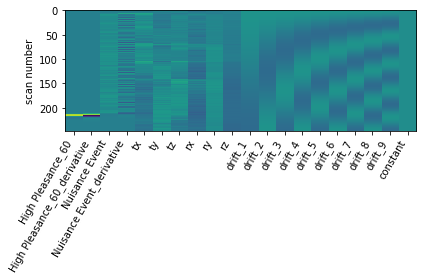

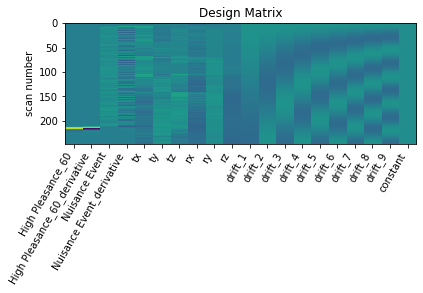

      0         1         2         3         4         5         6      \
0  0.933296 -0.631588  0.990529  1.436145  1.723908  1.147095  0.514641   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.163911  1.439041  0.951614  ...  0.100292  0.148618 -0.065921 -0.261667   

      11451     11452     11453     11454     11455     11456  
0 -0.043383 -0.478246  0.330531 -0.438479  0.357412 -0.970629  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_60


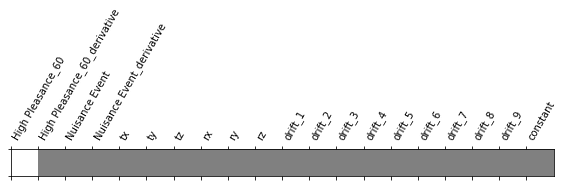

In [ ]:
y_ho_pa, X_ho_pa = lss_separate_method_comp(task =task,
                          data_path=data_path,
                          events_path=events_path,
                          motion_param_path=motion_param_path,
                          cache_mem_path=cache_mem_path,
                          activity_mat_saving_path=activity_mat_saving_path,
                          analysis_type=analysis_type,
                          param_modulation=False,
                          t_r=t_r,
                          drift_model=drift_model,
                          drift_order=drift_order,
                          hrf_model=hrf_model,
                          pre_whitening_spec=pre_whitening_spec,
                          apply_trans_mask=apply_trans_mask,
                          roi_img=roi_img,  
                          hpf_cut=hpf_cut,
                          smoothing_fwhm=smoothing_fwhm,
                          standardize=standardize,
                          detrend=detrend,minimize_memory=minimize_memory)

In [ ]:
y_g.append(y_ho_pa)
X_g.append(X_ho_pa)

In [ ]:
X_ho_pa.shape

(60, 11457)

### Paintings Task

### Run AP

In [ ]:
data_path = 'ses-19/func/wrdcsub-01_ses-19_task-PreferencePaintings_dir-ap_bold.nii.gz'
events_path = 'ses-19/func/sub-01_ses-19_task-PreferencePaintings_dir-ap_events.tsv'
motion_param_path = 'ses-19/func/rp_dcsub-01_ses-19_task-PreferencePaintings_dir-ap_bold.txt'
task = 'Paintings'

In [ ]:
analysis_type = 'High_Low_Pleasance'
hrf_model = 'spm + derivative'
param_modulation = False
drift_model='cosine'
t_r=2
drift_order=None
apply_trans_mask=True
roi_img = mask_img
standardize=True
detrend=True
minimize_memory = True
activity_mat_saving_path = 'mvpa/test2'

events = pd.read_csv(events_path,sep='\t')

# onset shift in order to capture the very moment of the appreciation decision
events['onset'] = events['onset']-1

onset_periods = [events['onset'][i+1] - events['onset'][i]  for i in range(len(events['onset']))if (i<len(events['onset'])-1)]
onset_periods = np.array(onset_periods)
onset_freq = np.reciprocal(onset_periods)
hpf_cut = np.min(onset_freq)/2 # cf High Pass Filtering Rule of Thumb ( fMRI Handbook 2011)

Event 0
      onset  duration       trial_type
0     7.149     4.575  Low Pleasance_1
1    15.747     6.156   Nuisance Event
2    25.329     3.533   Nuisance Event
3    31.345     6.079   Nuisance Event
4    38.844     4.918   Nuisance Event
5    44.643     4.282   Nuisance Event
6    49.459     3.537   Nuisance Event
7    54.459     3.006   Nuisance Event
8    58.192     3.318   Nuisance Event
9    63.924     5.976   Nuisance Event
10   72.123     3.156   Nuisance Event
11   75.872     5.392   Nuisance Event
12   85.154     4.153   Nuisance Event
13   91.454     1.838   Nuisance Event
14   95.303     5.273   Nuisance Event
15  104.118     5.721   Nuisance Event
16  111.101     7.995   Nuisance Event
17  121.449     1.953   Nuisance Event
18  127.882     1.419   Nuisance Event
19  130.431     4.784   Nuisance Event
20  139.380     5.612   Nuisance Event
21  146.063     3.270   Nuisance Event
22  151.945     6.959   Nuisance Event
23  162.527     5.099   Nuisance Event
24  169.709     6

59  388.879     2.056    Nuisance Event
Event 56
      onset  duration        trial_type
0     7.149     4.575    Nuisance Event
1    15.747     6.156    Nuisance Event
2    25.329     3.533    Nuisance Event
3    31.345     6.079    Nuisance Event
4    38.844     4.918    Nuisance Event
5    44.643     4.282    Nuisance Event
6    49.459     3.537    Nuisance Event
7    54.459     3.006    Nuisance Event
8    58.192     3.318    Nuisance Event
9    63.924     5.976    Nuisance Event
10   72.123     3.156    Nuisance Event
11   75.872     5.392    Nuisance Event
12   85.154     4.153    Nuisance Event
13   91.454     1.838    Nuisance Event
14   95.303     5.273    Nuisance Event
15  104.118     5.721    Nuisance Event
16  111.101     7.995    Nuisance Event
17  121.449     1.953    Nuisance Event
18  127.882     1.419    Nuisance Event
19  130.431     4.784    Nuisance Event
20  139.380     5.612    Nuisance Event
21  146.063     3.270    Nuisance Event
22  151.945     6.959    Nuisan

Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



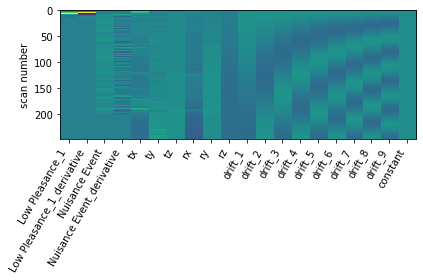

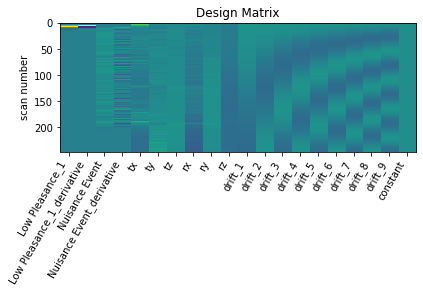

      0        1         2         3         4         5         6      \
0  1.384378  2.16415  1.141485  1.040432  0.533075  0.719897  0.150298   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.314348  1.680006  2.347936  ... -0.746161 -0.280519 -0.742125  1.496993   

      11451     11452     11453     11454     11455     11456  
0 -0.035127 -0.473187  0.489933 -0.298061 -0.216547 -1.121561  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_1
GLM RUN LowPleasance_2


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



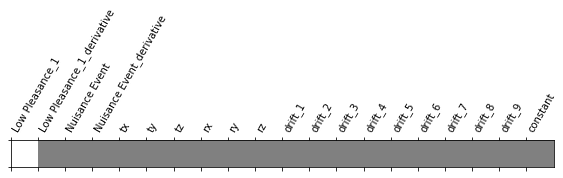

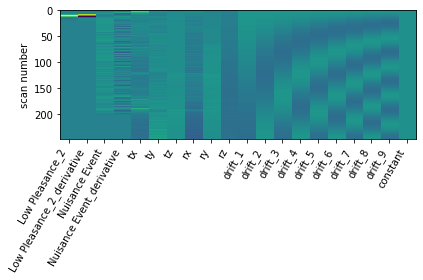

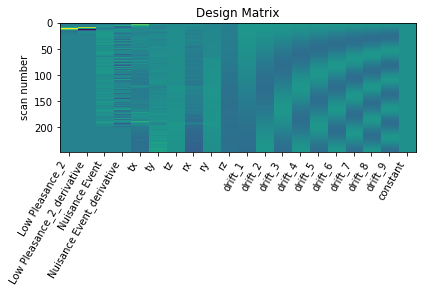

      0         1         2         3         4         5         6      \
0 -0.211165 -1.661665 -0.176599 -0.359893  0.063442 -0.335259  0.518486   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.434309  0.366666  0.454553  ... -1.128038 -1.022553 -0.557939  0.853153   

      11451    11452     11453     11454     11455     11456  
0  0.091442 -0.89953  0.732487 -0.750221 -0.339301 -0.057971  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_2
GLM RUN LowPleasance_3


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



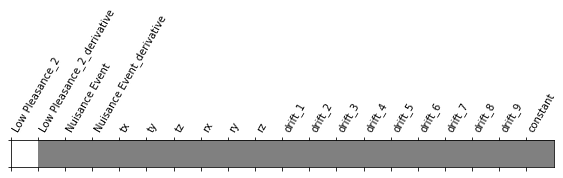

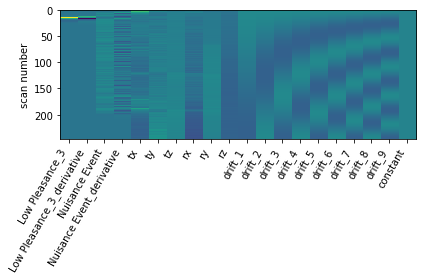

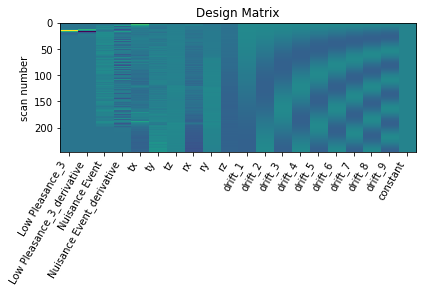

      0         1         2         3         4         5         6      \
0  2.255512  1.539966 -0.042868 -0.377151 -0.389445  1.115412 -0.543645   

     7         8         9      ...     11447     11448     11449    11450  \
0  0.07486  0.788867  0.632837  ... -1.411332 -1.167267 -1.376904  0.20557   

      11451     11452     11453     11454     11455     11456  
0 -0.636585 -0.875216 -0.017452 -1.142226 -1.085123 -1.030711  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_3
GLM RUN LowPleasance_4


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



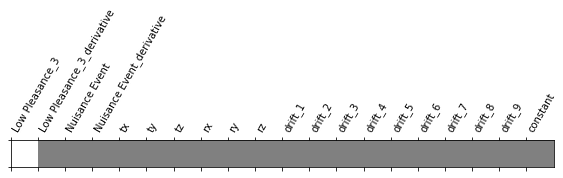

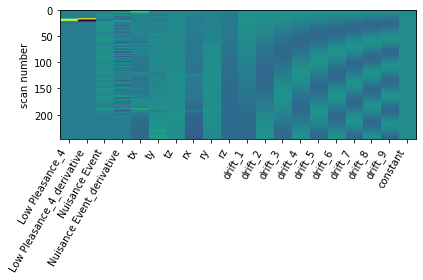

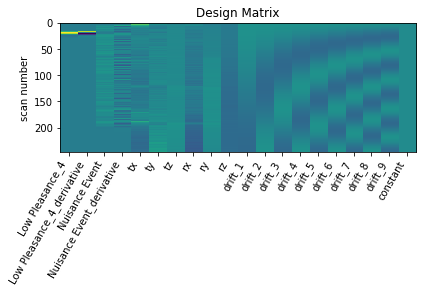

     0         1         2         3         4         5      6         7      \
0 -1.40452 -0.875386  0.788564  0.607944  0.538652 -0.556664 -0.106 -0.266766   

      8         9      ...     11447     11448     11449     11450     11451  \
0 -0.221911 -0.168596  ... -0.850174 -0.798142  0.030415  1.115126  0.912881   

      11452     11453     11454   11455     11456  
0  0.397909  0.610606 -0.439134  0.0534  0.120904  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_4
GLM RUN LowPleasance_5


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



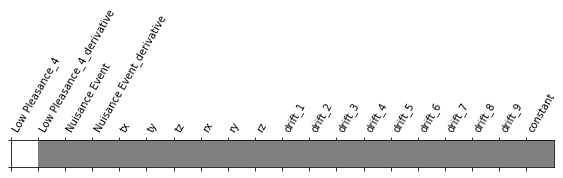

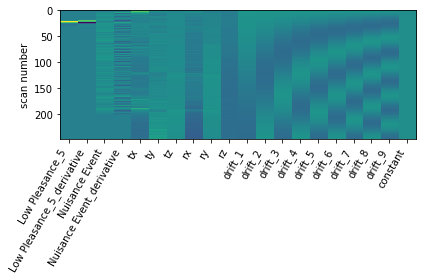

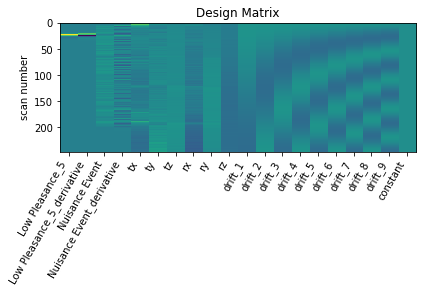

      0         1         2         3         4         5         6      \
0  2.591192  0.114306 -0.383513 -0.511589 -0.387972  0.890121  0.356534   

     7         8         9      ...     11447     11448     11449    11450  \
0  1.34186  1.799032  1.856164  ... -0.847854 -0.948175 -1.519038 -0.04005   

      11451     11452     11453    11454     11455     11456  
0 -0.471741 -1.083136  0.668598 -0.51062 -1.178897 -1.210862  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_5
GLM RUN LowPleasance_6


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



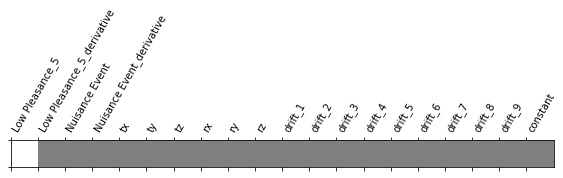

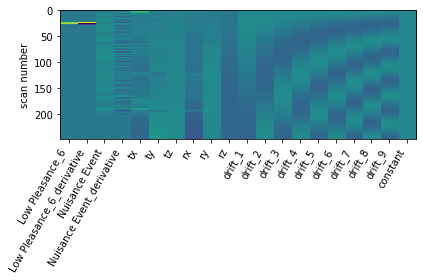

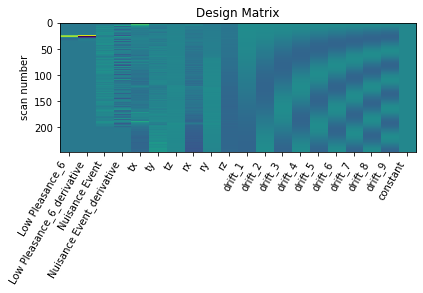

      0         1         2         3         4         5         6      \
0 -0.637772  1.587799  0.253737 -0.125113 -0.185614  0.243401 -0.637239   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.821569 -0.380521 -1.214449  ... -1.185969 -0.842373 -0.564674  0.824746   

      11451     11452     11453    11454     11455     11456  
0  0.330099 -0.875204  0.409031 -1.25087 -0.338713 -0.143887  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_6
GLM RUN LowPleasance_7


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



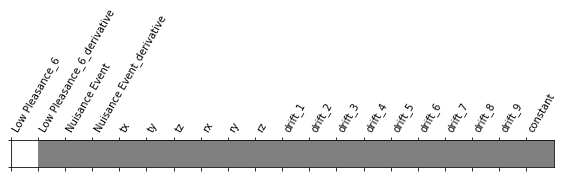

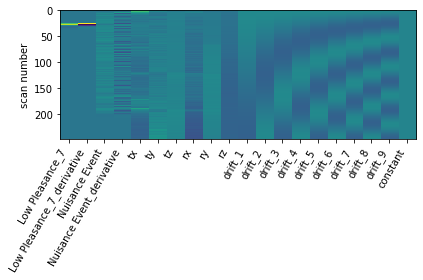

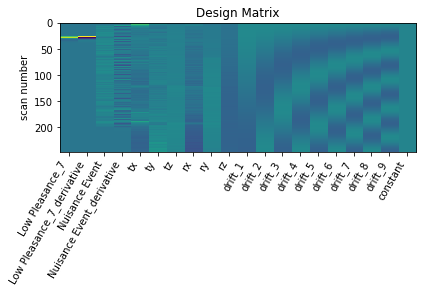

      0         1         2         3         4        5         6      \
0 -0.514518 -1.111201 -0.192378 -0.475338 -0.270907 -0.38385  0.693318   

      7         8        9      ...     11447     11448     11449     11450  \
0  0.464047  0.220668  1.04415  ... -0.519895 -0.825071  0.242683 -0.099548   

      11451     11452     11453     11454     11455     11456  
0 -0.299039 -0.164404 -0.284216 -0.565403  0.474143 -0.113798  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_7
GLM RUN LowPleasance_8


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



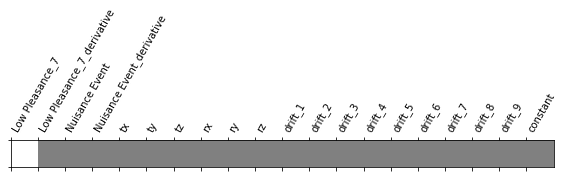

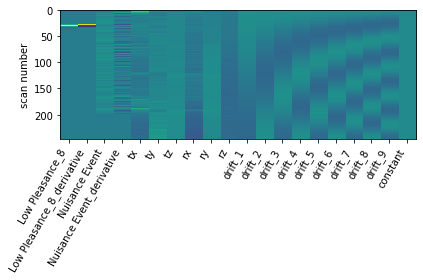

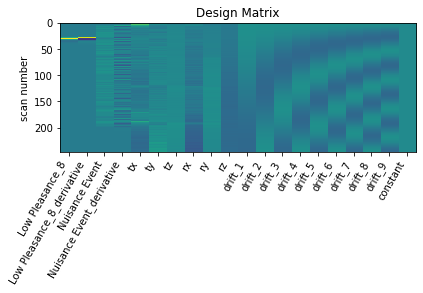

      0         1        2         3         4         5         6      \
0  1.446272 -1.252194 -0.32141  0.073387  0.190389 -0.137851  0.029103   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.807004  1.069513  0.992748  ... -0.883686 -0.953887 -0.927138  0.346895   

      11451     11452     11453     11454     11455     11456  
0 -0.849678 -0.386705  0.966736 -0.053682 -1.710862 -0.916172  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_8
GLM RUN LowPleasance_9


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



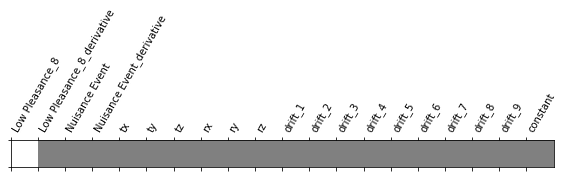

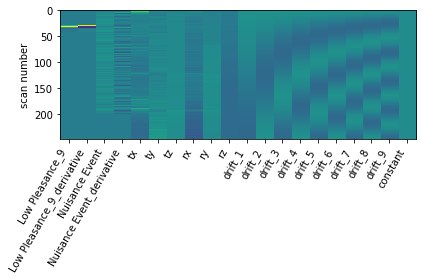

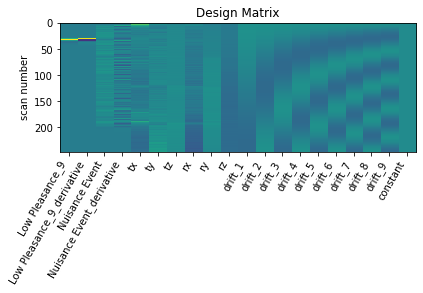

      0         1         2         3         4         5         6      \
0  1.233529  1.151855  0.601289  0.691703  0.609785  1.656701 -1.458121   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.216718  1.534461  0.337215  ... -0.914582 -1.339141 -1.431802  0.346311   

      11451     11452     11453     11454    11455     11456  
0  0.518376 -0.589209  0.822724 -0.638674  0.93012 -0.556991  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_9
GLM RUN LowPleasance_10


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



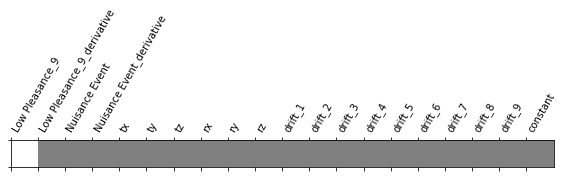

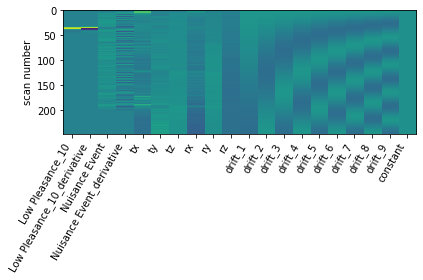

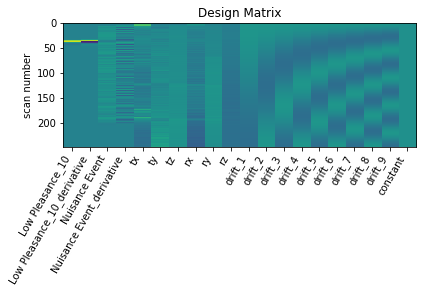

      0         1        2         3         4         5         6      \
0 -0.034397  0.110586  0.92804  0.372325  0.213756 -0.232928  0.381518   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.224891 -0.153062  0.551421  ... -1.206514 -1.285065 -0.741391  0.303072   

      11451     11452     11453     11454     11455     11456  
0  0.287683 -1.064954  0.269926 -0.621206 -0.279729 -0.077427  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_10
GLM RUN LowPleasance_11


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



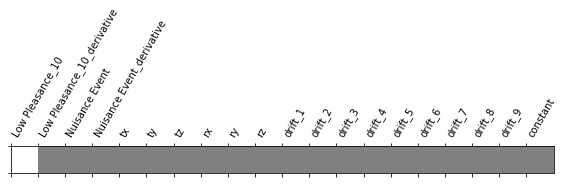

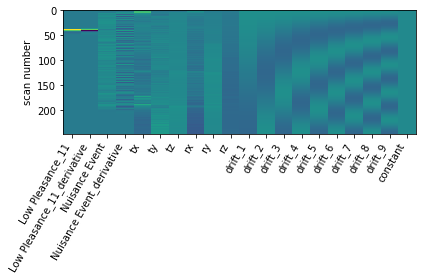

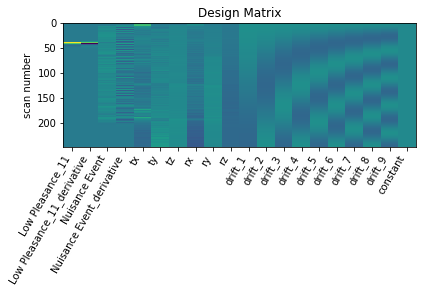

      0         1         2        3         4         5         6      \
0  0.675232 -1.009235  0.510582  0.75207  0.765314  0.582787 -1.086425   

      7        8         9      ...     11447     11448     11449     11450  \
0  0.072847  1.33422  0.956389  ... -0.212409 -0.253344 -0.037069  0.337795   

      11451   11452     11453     11454     11455     11456  
0  0.126381  0.1044  0.641604  0.063628 -0.351129 -0.223859  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_11
GLM RUN LowPleasance_12


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 19 seconds



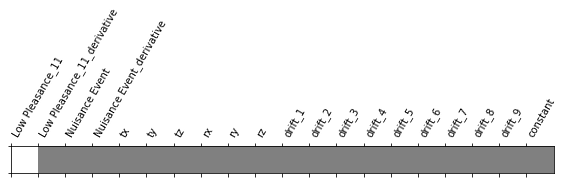

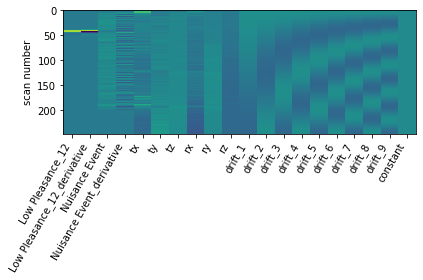

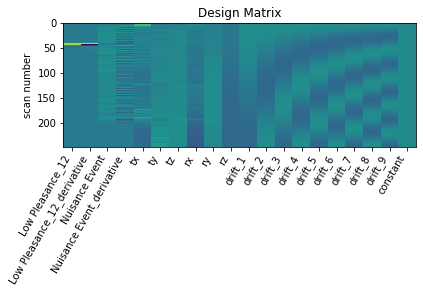

      0       1         2         3         4         5         6      \
0  1.750185  1.1449  0.970421  0.622975  0.627565 -0.276729  0.510826   

      7         8         9      ...     11447    11448     11449     11450  \
0  0.486847  0.219748  0.838031  ... -1.371598 -1.68794 -1.000134  0.259635   

      11451     11452     11453     11454     11455     11456  
0 -0.272163 -0.326169  0.653004 -0.620399  0.010855  0.016486  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_12
GLM RUN LowPleasance_13


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



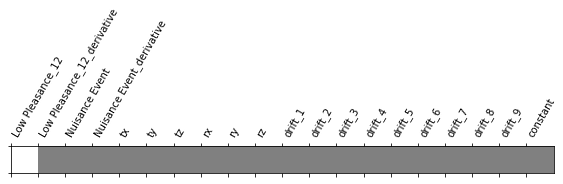

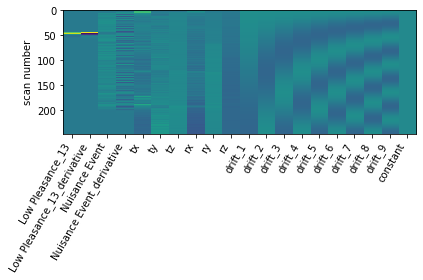

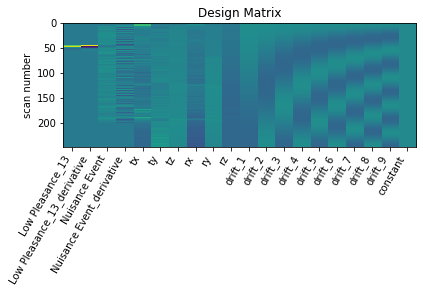

      0         1         2         3         4         5         6      \
0  0.275867 -1.605178  0.029946  0.012927 -0.046362 -0.215542 -0.769359   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.560183  0.168234  0.551004  ... -1.491388 -1.782354 -1.255812  0.450862   

      11451     11452     11453     11454     11455     11456  
0  0.383278 -1.690795  0.289127 -0.803213 -0.331867 -0.523067  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_13
GLM RUN LowPleasance_14


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



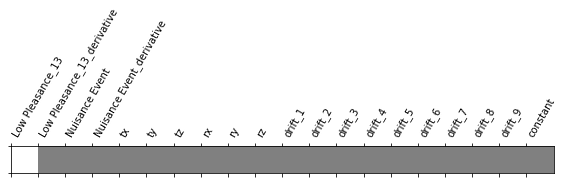

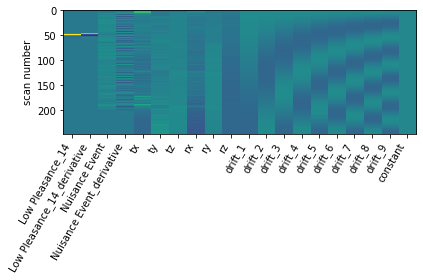

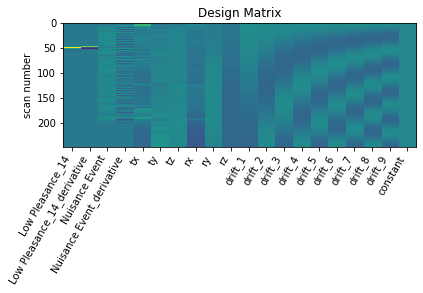

      0         1         2         3        4         5        6      \
0  0.341305  0.599831 -0.146601 -0.445024 -0.35244  0.212037 -1.11404   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.050978  0.732849  0.262318  ... -0.380779 -0.263277  0.118018  0.178624   

      11451     11452     11453     11454     11455     11456  
0 -0.929395  0.736671  0.352964  0.041444 -0.180353 -0.380227  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_14
GLM RUN HighPleasance_15


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



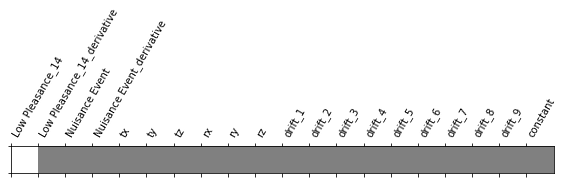

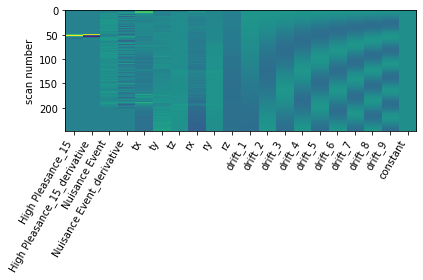

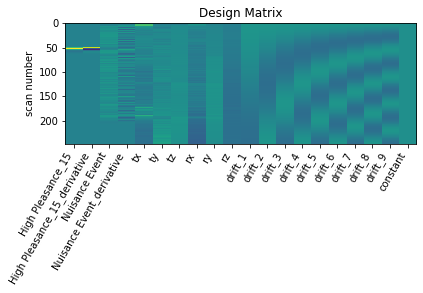

      0         1         2         3         4         5         6      \
0  1.696012 -0.143632  1.503642  1.407898  1.235687  0.538286  1.284154   

      7         8         9      ...     11447     11448     11449    11450  \
0  0.982905  0.540217  1.436033  ... -1.111852 -1.179183 -0.975504  0.30873   

      11451     11452     11453     11454     11455     11456  
0  1.281652 -1.130378  0.281999 -0.788114  0.314426  0.041786  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_15
GLM RUN HighPleasance_16


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



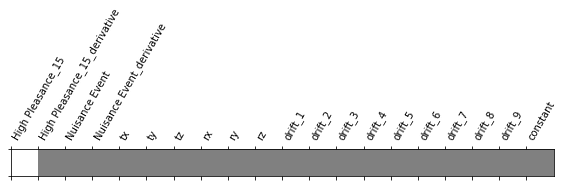

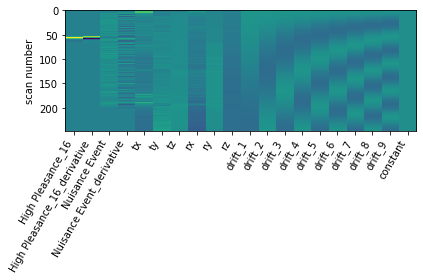

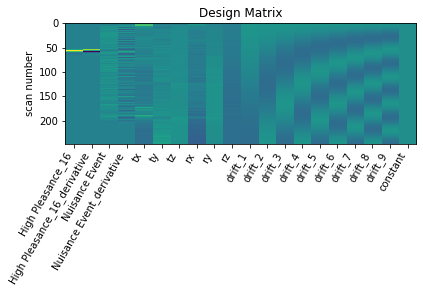

      0         1        2         3         4         5         6      \
0 -0.488234 -0.354653  0.44324 -0.177332 -0.091017  0.808359 -1.195333   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.501832  0.526849 -0.476108  ... -1.139221 -1.225467 -0.651001  0.742234   

      11451     11452     11453     11454     11455     11456  
0 -1.271281  0.040655  1.143171 -0.588454  0.302781 -0.190324  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_16
GLM RUN LowPleasance_17


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



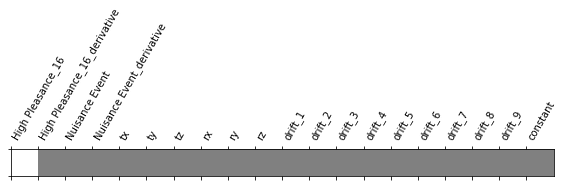

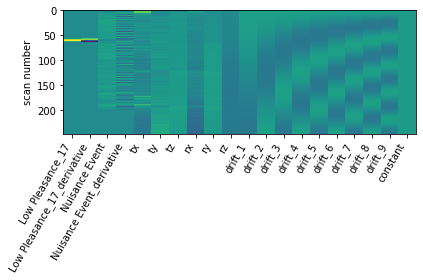

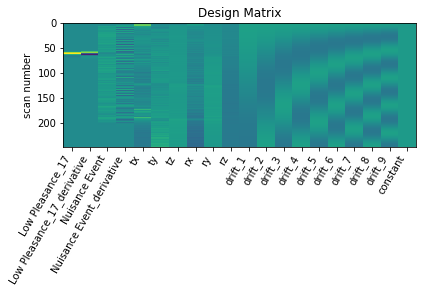

      0         1         2         3         4         5         6      \
0  1.149831  0.867726  0.492169  0.145294  0.008107  0.171105  0.952595   

   7         8         9      ...     11447     11448     11449     11450  \
0  1.472  1.403263  1.536931  ... -0.971582 -0.698244 -0.654672  0.153243   

      11451     11452     11453     11454     11455     11456  
0  0.624915 -0.311148 -0.034067 -1.159196 -1.334121 -0.396056  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_17
GLM RUN LowPleasance_18


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



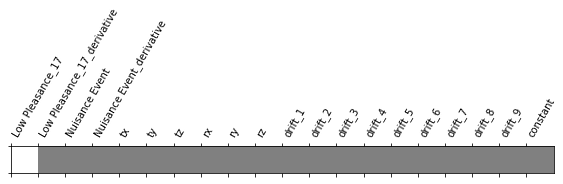

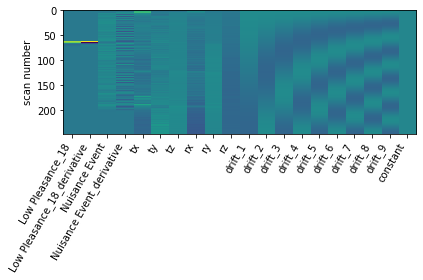

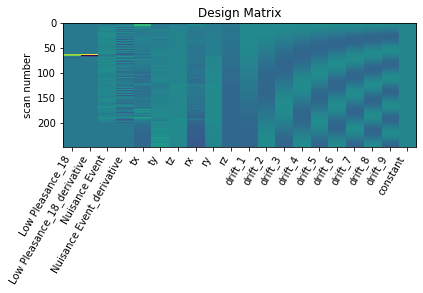

      0         1         2         3         4         5         6      \
0  0.022627 -0.001743 -2.403921 -2.267577 -2.145752 -0.302158 -1.547347   

    7         8         9      ...     11447     11448     11449     11450  \
0 -1.3897 -0.726537 -1.356497  ... -1.170703 -1.051105 -0.786742 -0.723476   

      11451     11452     11453     11454     11455     11456  
0 -0.619172 -0.947473 -0.267113 -1.132238 -0.276962 -1.080252  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_18
GLM RUN HighPleasance_19


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



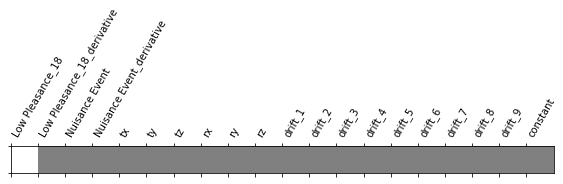

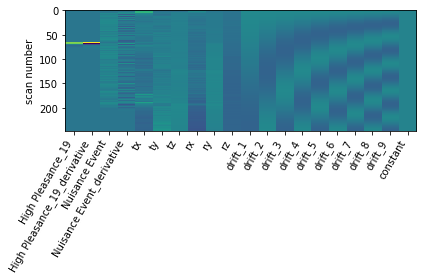

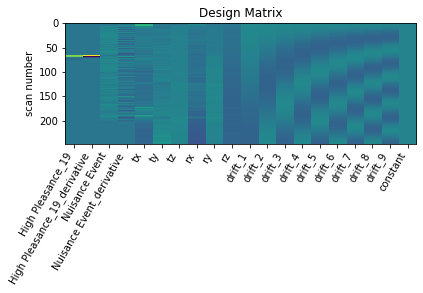

      0         1         2         3         4         5         6      \
0  0.918419 -0.730922  1.864482  1.768272  2.075959  1.540139  1.807126   

     7         8         9      ...     11447     11448     11449     11450  \
0  2.03598  2.124792  1.983712  ... -0.461616 -0.402122 -0.508623  1.255363   

      11451     11452    11453     11454     11455     11456  
0 -0.030994 -0.092251  1.11087 -0.210746 -0.286601 -0.027109  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_19
GLM RUN LowPleasance_20


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



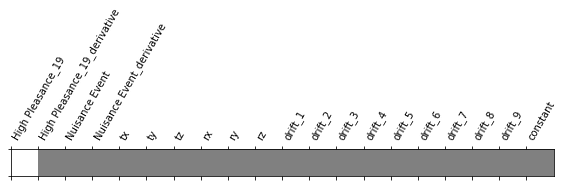

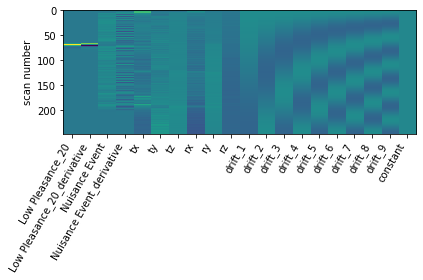

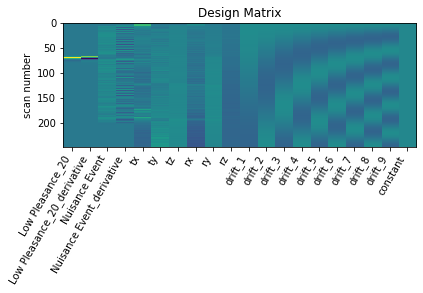

      0         1         2         3         4         5         6      \
0  0.240934 -0.101887  0.003602 -0.298006 -0.275384 -0.447638 -0.928751   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.584489  0.031879  0.288278  ... -1.595291 -1.886272 -1.072067  0.577136   

      11451     11452     11453     11454     11455     11456  
0  0.465002 -0.460699 -0.031276 -1.040587 -0.514212 -0.124329  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_20
GLM RUN HighPleasance_21


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



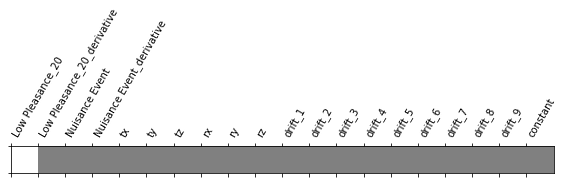

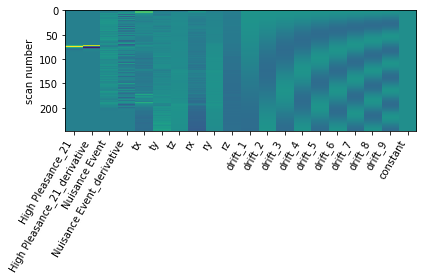

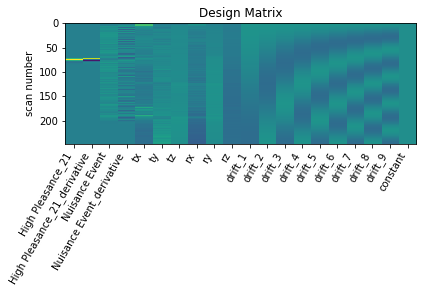

      0         1         2         3         4         5         6      \
0  1.055093 -0.047442  0.713944  0.893123  1.012404  0.429912  0.609018   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.827201  0.781901  0.745537  ... -0.876305 -1.072955 -0.518375  0.509741   

      11451     11452    11453     11454     11455     11456  
0 -0.071535 -1.058832  0.97117 -0.224023  0.834718 -0.711863  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_21
GLM RUN LowPleasance_22


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



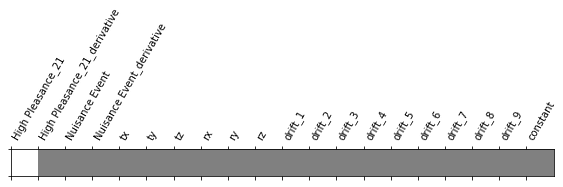

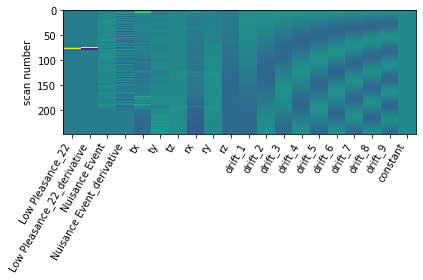

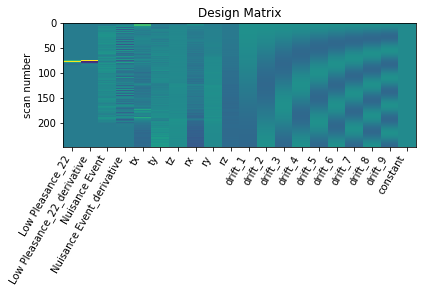

      0         1         2         3         4        5         6      \
0  0.632145 -1.351585  0.119804 -0.161134  0.198719 -0.62327 -0.055905   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.822449 -0.934136  0.027456  ... -0.141964 -0.556506 -0.007446  1.505544   

      11451     11452     11453     11454     11455     11456  
0  0.578355  0.012721  0.696628  0.373385 -0.634261  0.111732  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_22
GLM RUN LowPleasance_23


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



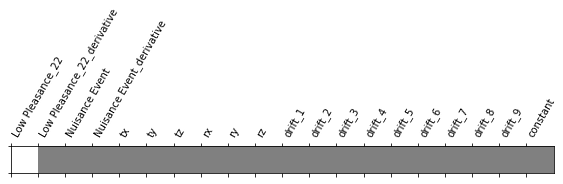

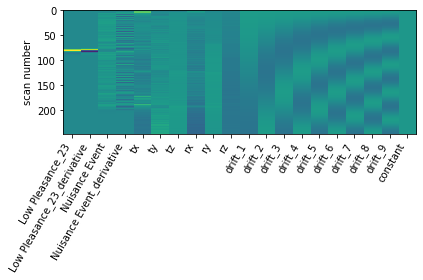

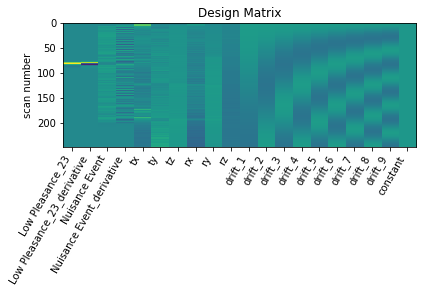

      0         1         2         3         4         5         6      \
0  0.710463  0.710403  0.544832  0.224449 -0.451954  0.795981 -0.602925   

      7         8         9      ...     11447    11448     11449     11450  \
0  0.760196  1.832221  1.185902  ... -1.839163 -1.41744 -1.401876 -0.041899   

      11451     11452     11453     11454    11455     11456  
0 -0.457473 -1.233991  0.910086 -1.818227 -0.26703 -1.672518  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_23
GLM RUN LowPleasance_24


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



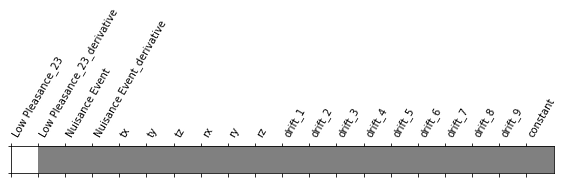

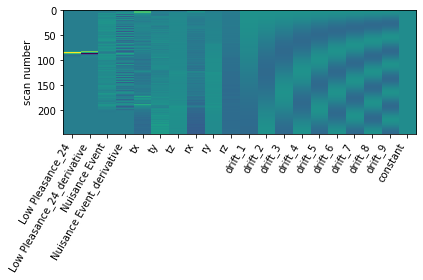

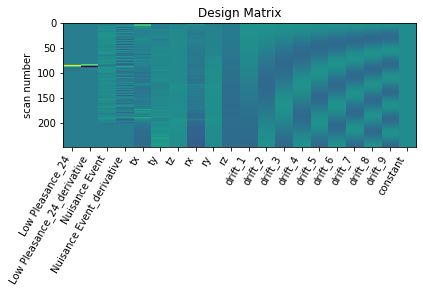

      0         1         2         3         4         5         6      \
0  0.327931 -0.547839 -0.048917  0.249656  1.022883  0.262801 -0.154966   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.123633  0.150374  0.691641  ... -0.082224 -0.453837 -0.212041  1.044771   

      11451     11452     11453     11454    11455     11456  
0 -0.074273 -0.131291  0.345941  0.163426 -0.69178  0.733124  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_24
GLM RUN HighPleasance_25


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



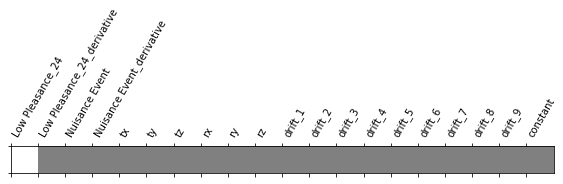

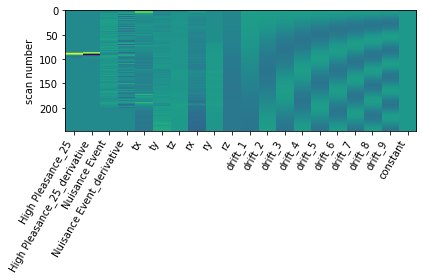

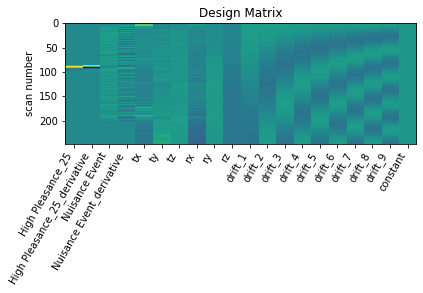

      0         1         2        3         4        5         6      \
0  1.803457  0.910298  1.044071  0.69818  0.294867  0.87951  0.106323   

      7        8         9      ...     11447     11448     11449     11450  \
0  1.079032  1.71355  1.361454  ... -2.032243 -1.994476 -1.600507  0.100023   

      11451    11452     11453     11454     11455    11456  
0  0.118423 -1.13055  1.395764 -1.498491 -0.626082 -1.95351  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_25
GLM RUN LowPleasance_26


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



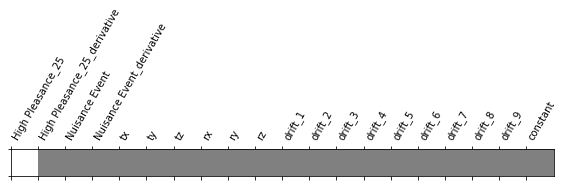

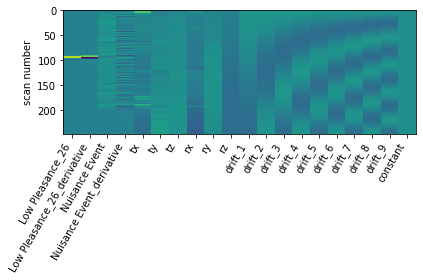

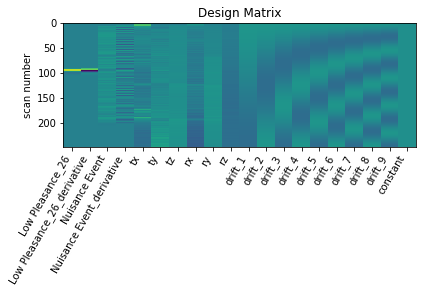

      0         1         2         3         4         5         6      \
0 -0.591347 -0.961625  0.099867 -0.111024  0.198294  0.001372 -0.136901   

     7        8         9      ...     11447     11448     11449     11450  \
0  0.05851  0.21296  0.456636  ...  0.090183  0.094349  0.273587  0.089391   

      11451     11452     11453     11454     11455     11456  
0  0.391046  0.485544 -0.919649  0.005255  0.530239  1.535931  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_26
GLM RUN LowPleasance_27


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



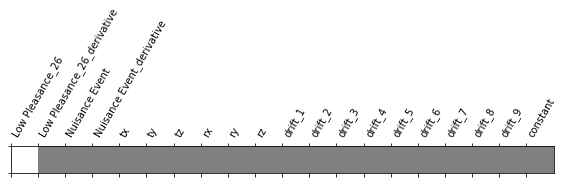

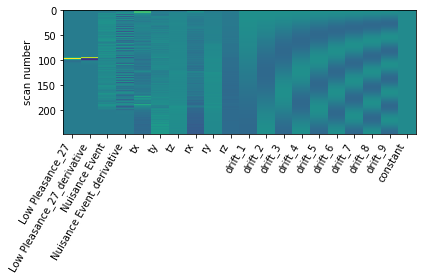

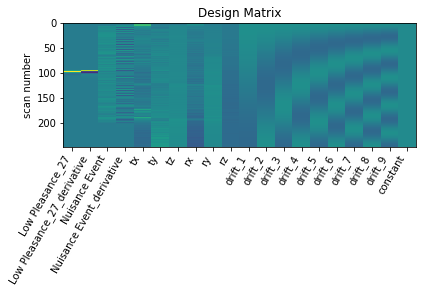

      0         1         2         3         4         5         6      \
0  2.622727  0.683362  0.394966  0.124748 -0.200194 -0.089257 -0.600762   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.178391  0.325418  0.310964  ... -1.640696 -1.698101 -0.994276  0.920076   

      11451     11452     11453     11454     11455     11456  
0 -1.029427 -1.149739  1.936889 -1.031862 -0.963505 -1.471472  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_27
GLM RUN LowPleasance_28


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



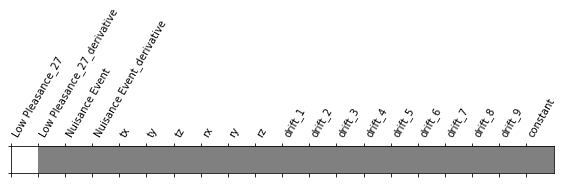

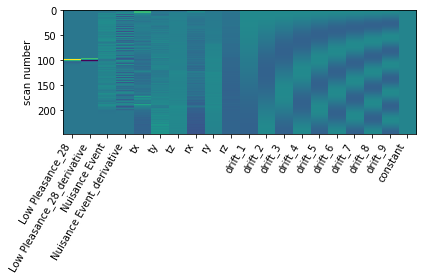

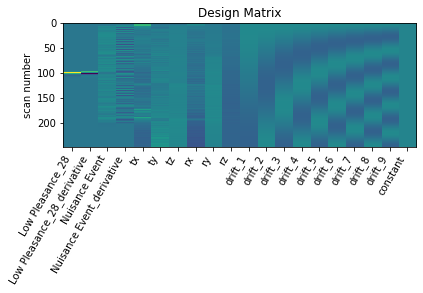

      0         1         2        3         4         5         6      \
0 -1.361429  0.185711  0.912701  0.71582  0.176253 -0.225547  0.205709   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.202155 -0.074134  0.050518  ... -2.180851 -1.746332 -1.445646 -0.128505   

     11451     11452     11453     11454     11455     11456  
0  0.74858 -0.726355 -0.486455 -1.153605 -0.330268  0.703473  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_28
GLM RUN LowPleasance_29


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



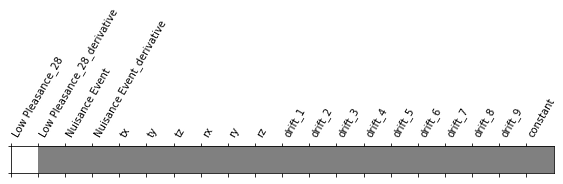

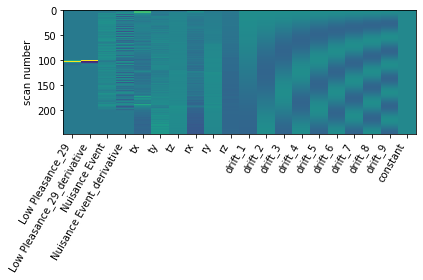

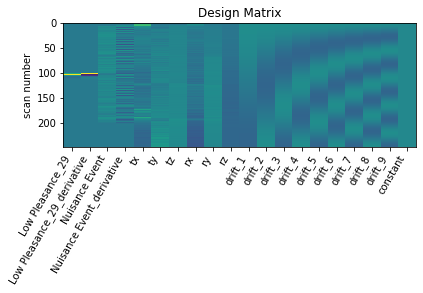

      0        1         2         3         4         5         6      \
0  0.608187 -0.53648  0.115013  0.281402  0.741491  0.162007 -0.133948   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.131755  0.762337  0.611444  ...  0.583648  0.732612  0.245291 -0.406562   

     11451     11452     11453     11454     11455     11456  
0 -0.18825 -0.489438 -0.064174  0.312227  0.009892  0.197102  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_29
GLM RUN LowPleasance_30


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



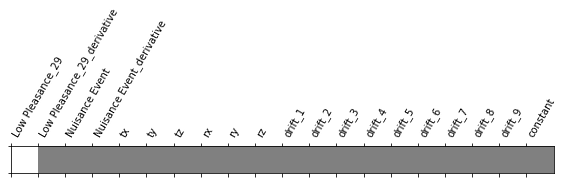

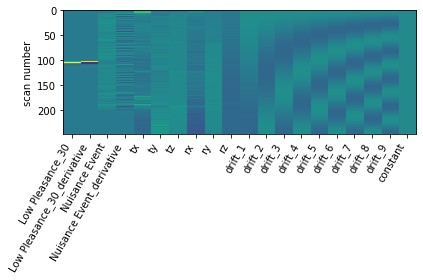

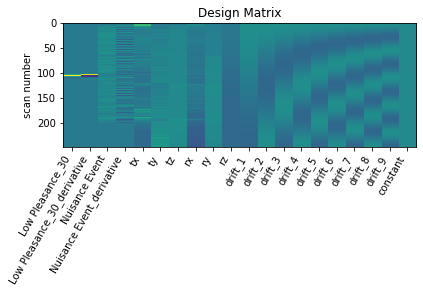

      0         1         2         3         4         5         6      \
0  0.698263  0.165031  0.323976  0.340452  0.447688  0.751109  0.035808   

      7         8         9      ...    11447     11448     11449     11450  \
0  0.733202  1.192698  0.599869  ... -1.30211 -1.169018 -0.833268  1.378676   

      11451     11452     11453     11454     11455     11456  
0 -0.831408 -0.544083  1.485655 -1.428462 -0.294367 -0.604558  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_30
GLM RUN LowPleasance_31


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



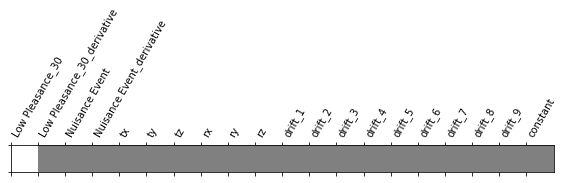

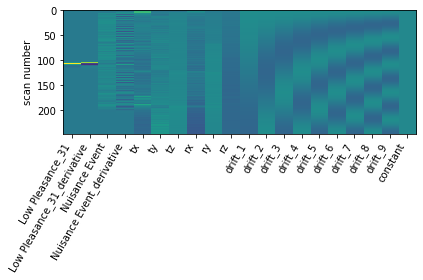

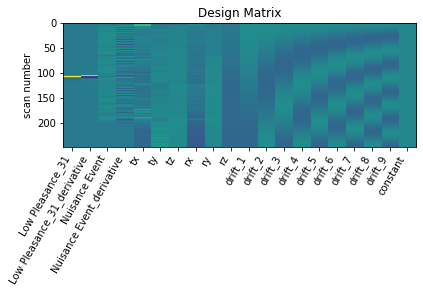

      0         1         2         3         4         5         6      \
0  0.597679  0.494588  0.535266  0.226564  0.314361 -0.007729  0.692038   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.735876  0.255109  0.995182  ... -0.873423 -1.314562 -0.161971  0.452023   

    11451     11452     11453     11454     11455     11456  
0  0.3214  0.278633  1.024398 -0.252995 -0.674537 -0.939374  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_31
GLM RUN HighPleasance_32


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



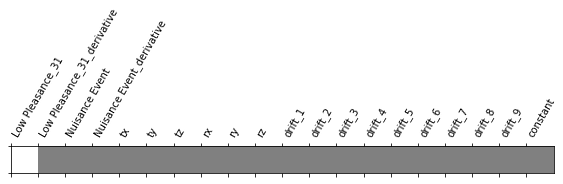

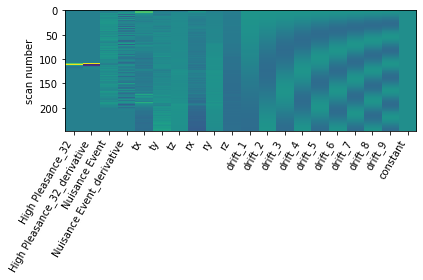

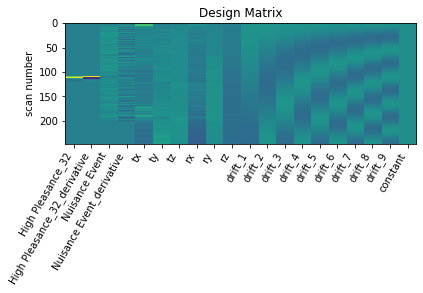

      0         1         2         3         4         5       6      \
0  0.241928 -0.259113 -0.693096 -0.571503 -0.618543  0.033445 -1.4988   

      7         8        9      ...     11447     11448     11449     11450  \
0 -1.033199  0.279906 -0.38135  ... -1.055645 -0.649609 -1.482015 -0.199372   

      11451     11452     11453     11454     11455   11456  
0 -0.182148 -1.648217 -0.325582 -0.533565  0.481092 -0.5333  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_32
GLM RUN LowPleasance_33


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



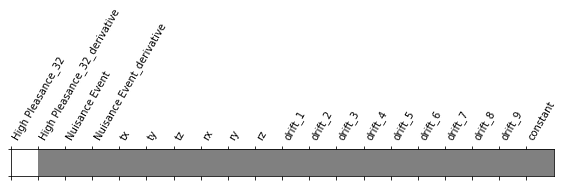

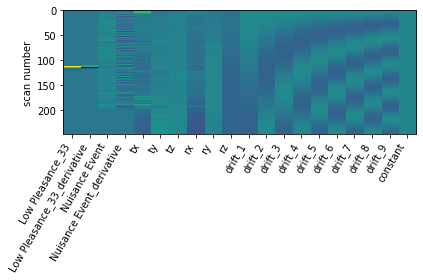

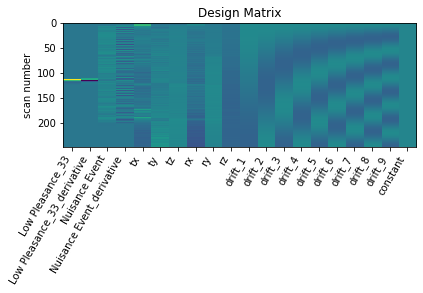

      0         1         2         3        4         5         6      \
0  0.841092 -0.258392  0.589501  0.309104  0.58416  0.002811  2.006609   

      7         8         9      ...     11447    11448     11449     11450  \
0  1.350824  0.031187  1.330833  ... -0.369152 -0.81018  0.575777  1.392853   

      11451     11452     11453     11454     11455     11456  
0  1.315507  0.714519  1.807797 -0.482571 -0.182735  0.200706  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_33
GLM RUN LowPleasance_34


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



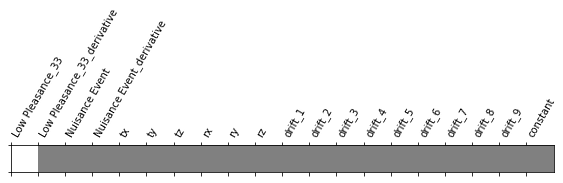

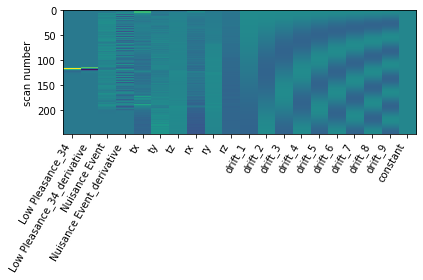

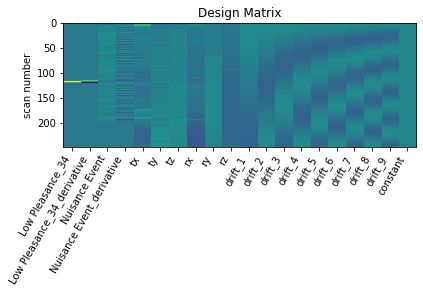

      0         1         2        3         4         5         6      \
0  1.115214  0.555699 -0.915174 -0.96071 -1.031322  0.374023 -2.814929   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.961471 -0.365942 -0.662145  ... -1.364342 -1.545821 -1.127915 -0.995095   

      11451     11452     11453     11454     11455     11456  
0 -0.246358 -1.005685 -1.305655 -0.220924  0.048453 -1.096625  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_34
GLM RUN HighPleasance_35


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



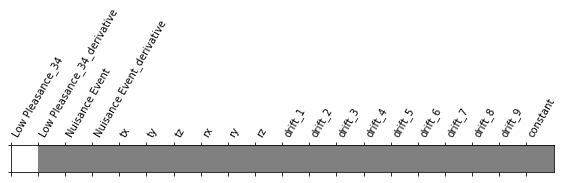

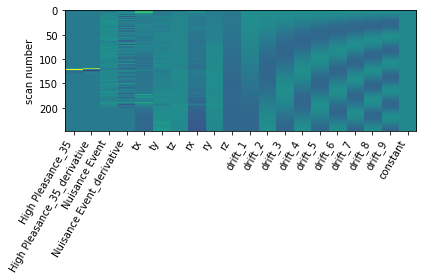

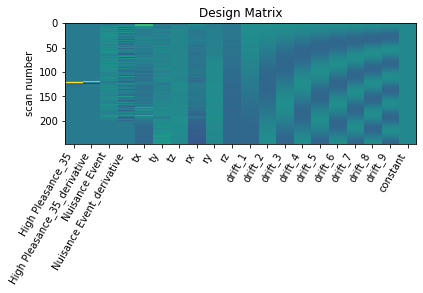

      0         1         2         3         4         5         6      \
0  0.801016 -0.705294  0.565167  0.539512  0.648621  0.355287  0.691353   

      7         8         9      ...    11447     11448     11449     11450  \
0  1.402688  1.277686  0.913005  ... -0.76514 -0.571936 -0.996813  0.174229   

      11451     11452     11453     11454     11455     11456  
0  0.044034 -1.041092  0.716119 -1.169096 -0.300001 -0.148419  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_35
GLM RUN LowPleasance_36


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



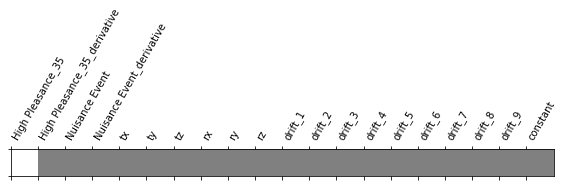

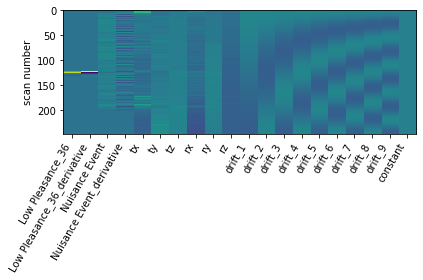

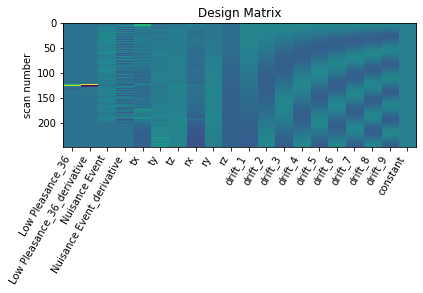

      0         1         2         3         4         5         6      \
0 -0.721066  0.632644  0.786461  1.105222  0.799465  0.430981 -0.437428   

      7        8         9      ...     11447     11448    11449     11450  \
0 -0.108795  0.58381  0.679737  ... -0.154842 -0.438911  0.16336  0.824048   

      11451     11452     11453     11454     11455     11456  
0 -0.386008  0.493988  0.210915 -0.326647  0.121384 -0.580839  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_36
GLM RUN LowPleasance_37


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



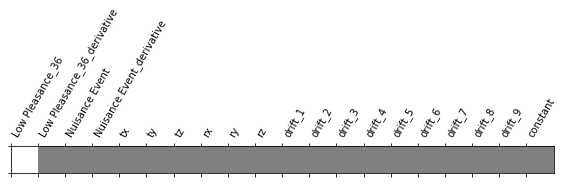

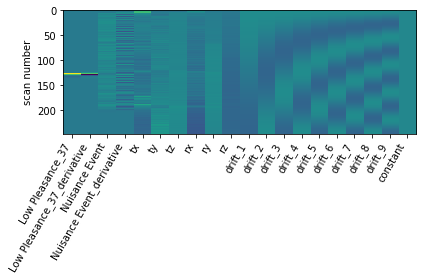

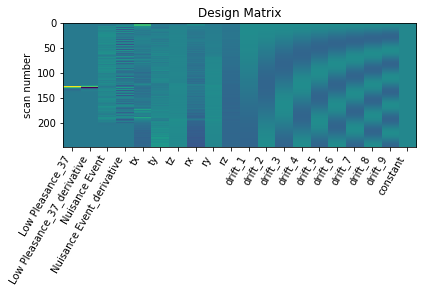

      0       1         2         3         4        5        6         7      \
0  0.267323 -0.0814  0.543156  0.118669  0.223509 -0.31133  0.03679  0.457434   

      8         9      ...     11447     11448     11449     11450     11451  \
0  0.642825  0.845187  ... -1.027082 -0.880113 -1.142184 -0.202845  0.089051   

      11452    11453     11454     11455     11456  
0 -1.713636  0.59113 -0.282799 -0.944353  0.358213  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_37
GLM RUN LowPleasance_38


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



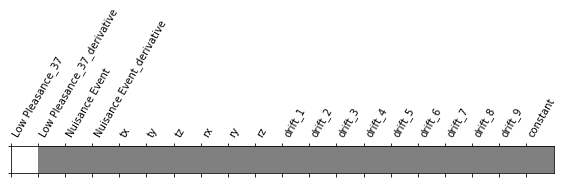

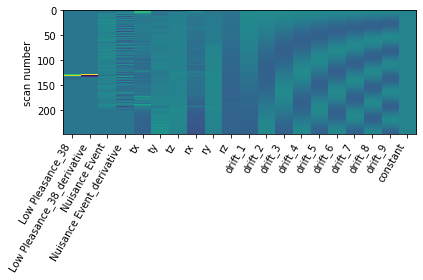

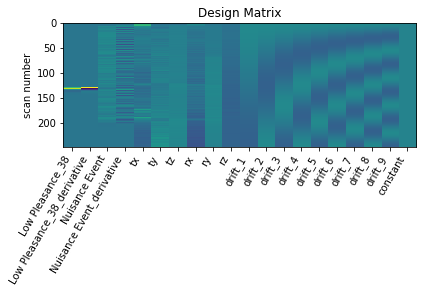

     0         1         2        3         4         5         6      \
0  0.87907  0.425176  1.073255  1.24744  1.571257 -0.065893  0.762719   

      7         8        9      ...     11447    11448     11449     11450  \
0  0.900883  0.662216  1.21303  ... -0.519205 -0.70499 -0.152929  1.324298   

      11451     11452     11453     11454     11455     11456  
0 -0.181334  0.457337  0.970426 -0.035538 -0.308148 -0.931237  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_38
GLM RUN HighPleasance_39


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



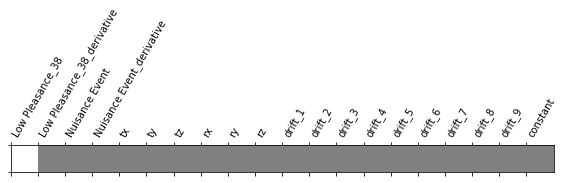

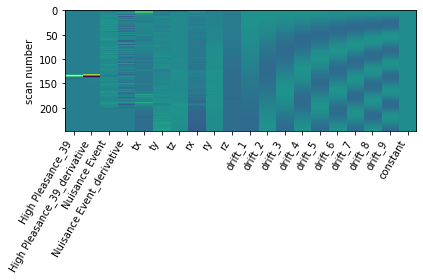

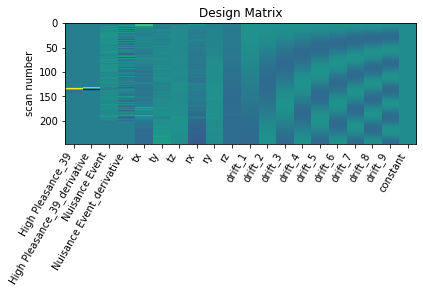

      0         1         2         3         4         5         6      \
0 -0.203862  0.643741  0.663827  0.317942  0.248131  0.210797 -0.307027   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.081874  0.337972 -0.313722  ...  0.163698  0.283227  0.383836  0.354588   

      11451     11452     11453     11454     11455     11456  
0  0.173401  0.325892  0.424729 -0.208212 -0.347768  0.009335  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_39
GLM RUN LowPleasance_40


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



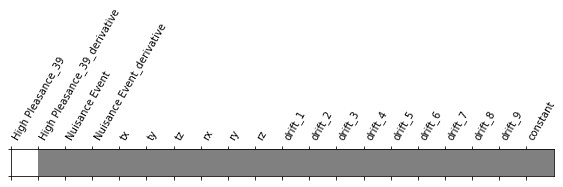

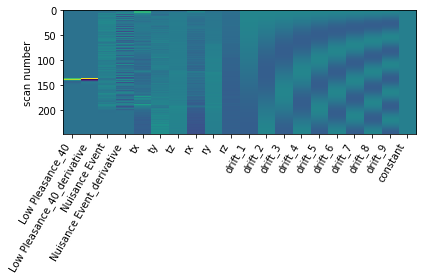

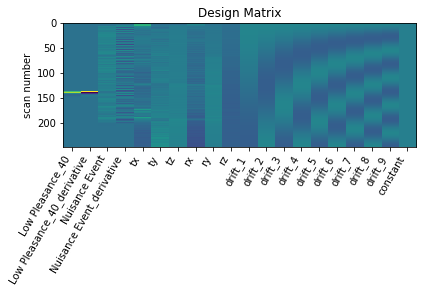

      0         1         2         3         4         5         6      \
0  1.699652 -0.469945  0.048042 -0.243808 -0.374838  0.060469 -0.075029   

      7         8         9      ...     11447    11448     11449     11450  \
0  0.395473  0.757006  1.745874  ... -1.395008 -1.36955 -1.544429  0.243505   

      11451     11452     11453     11454    11455     11456  
0 -0.671787 -1.851025  0.325424 -0.701921 -0.03963 -0.675364  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_40
GLM RUN LowPleasance_41


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



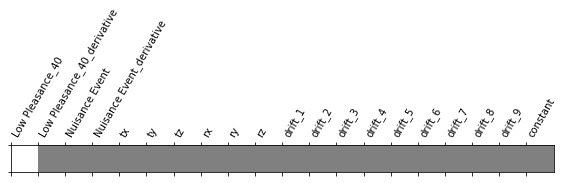

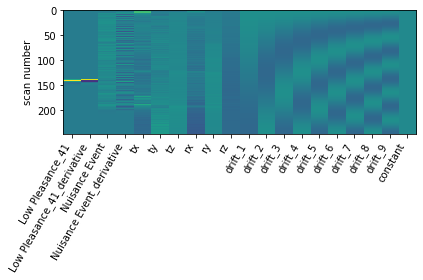

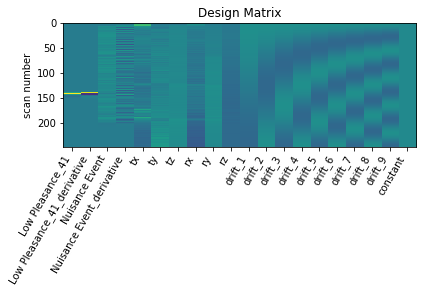

      0         1         2         3         4         5         6      \
0  1.532614 -0.064217  1.332563  1.283322  1.066547 -0.506306 -0.264981   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.187585 -0.195921 -0.498579  ... -1.235491 -1.127322 -0.543179  0.467019   

      11451     11452     11453     11454     11455     11456  
0  0.628135  0.062247  0.183978 -1.422554 -0.650744 -1.171127  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_41
GLM RUN HighPleasance_42


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



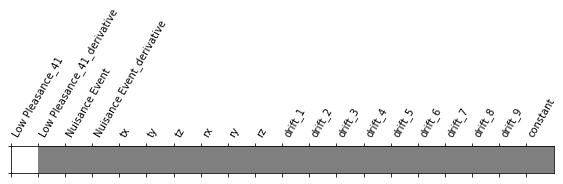

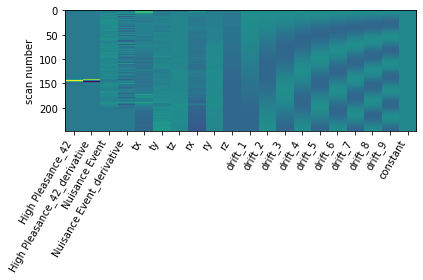

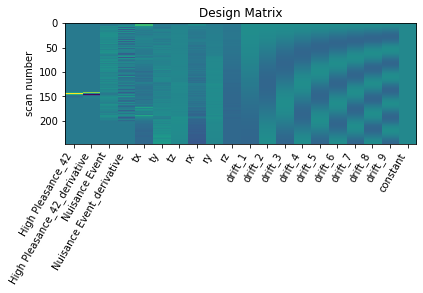

      0         1         2         3        4         5         6      \
0 -0.126229  0.333778 -1.257919 -1.585872 -1.47556  0.667448 -0.681816   

      7         8         9      ...     11447     11448    11449     11450  \
0 -0.318698  0.463349  0.534541  ... -0.610573 -0.550608 -0.47381  0.491554   

      11451     11452     11453     11454     11455     11456  
0  0.487118 -0.611747 -0.479603  0.001248 -0.146744 -0.547697  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_42
GLM RUN LowPleasance_43


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



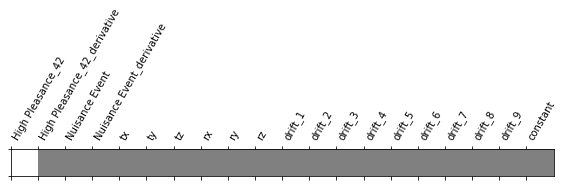

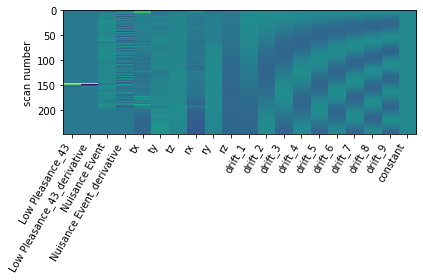

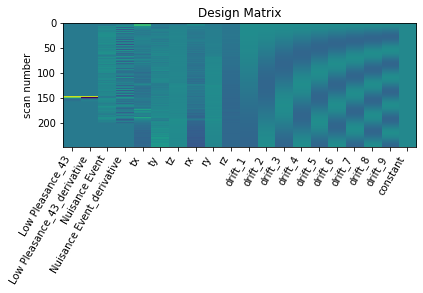

      0         1         2         3         4         5         6      \
0 -0.260692 -1.389385  2.098508  1.624976  1.058645 -0.409333  0.111087   

      7        8         9      ...     11447    11448     11449     11450  \
0  0.062643  0.11375  0.302369  ... -0.326788  0.05436 -0.207842  0.462747   

      11451     11452     11453     11454    11455     11456  
0 -0.752753 -0.052292  1.878012 -0.765528  1.21195  0.303004  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_43
GLM RUN HighPleasance_44


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



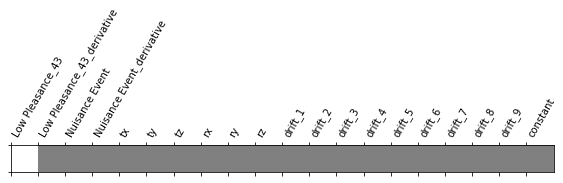

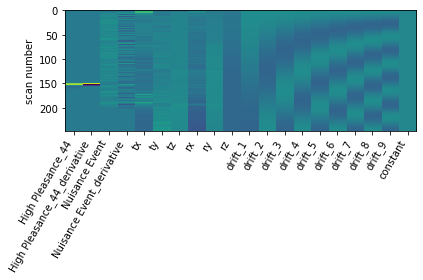

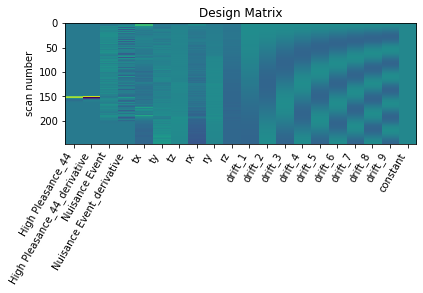

      0         1         2         3         4         5         6      \
0  1.840579  1.112242 -0.436688 -0.140672  0.250213  0.778909 -0.910894   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.111179  0.600676  0.473366  ... -1.054964 -1.445979 -0.827627 -0.190589   

      11451     11452   11453     11454     11455     11456  
0  0.829294 -0.608259 -1.0222 -0.735577 -0.827111 -1.307297  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_44
GLM RUN LowPleasance_45


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



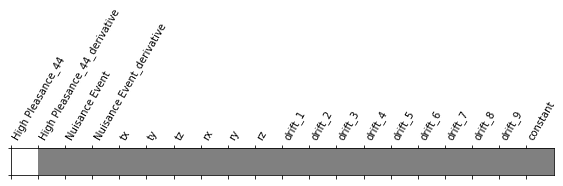

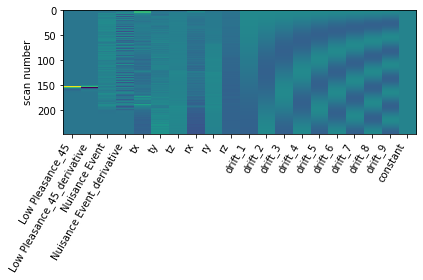

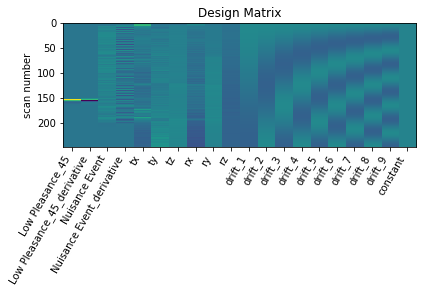

      0         1        2         3         4         5         6      \
0  0.425347  0.230337  0.16637 -0.005067 -0.233501  0.308184  0.663516   

      7         8         9      ...     11447     11448    11449     11450  \
0  0.380963  0.159718  0.287139  ...  0.723256  0.699949  0.54779  1.207441   

      11451     11452     11453    11454    11455     11456  
0 -0.031923  0.099997  1.282017  1.28202  0.60625 -0.458194  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_45
GLM RUN LowPleasance_46


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



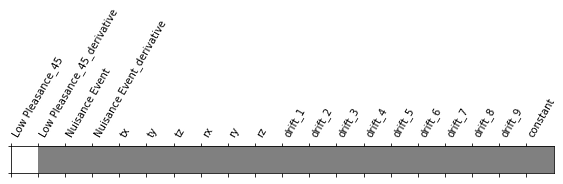

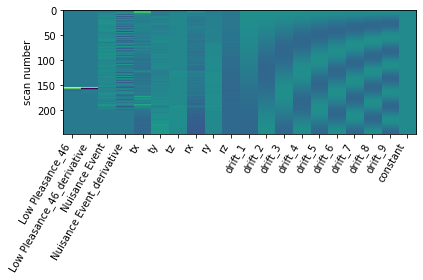

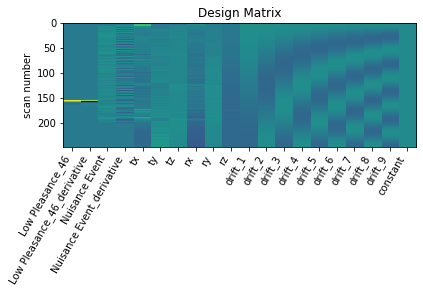

      0         1         2         3         4         5         6      \
0 -1.547894 -0.426732  0.694543  0.299743  0.061895 -0.223452  0.309133   

     7         8         9      ...     11447     11448     11449     11450  \
0  0.35049  0.291316 -0.407914  ... -1.452116 -1.051494 -1.219005 -0.612326   

      11451     11452     11453     11454     11455     11456  
0 -0.406313 -0.961658  0.138638 -1.362981 -0.185207  1.103857  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_46
GLM RUN LowPleasance_47


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



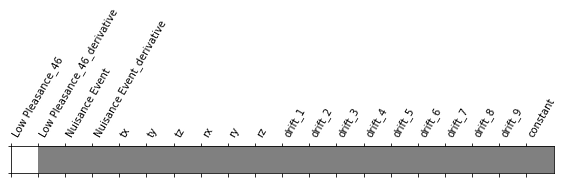

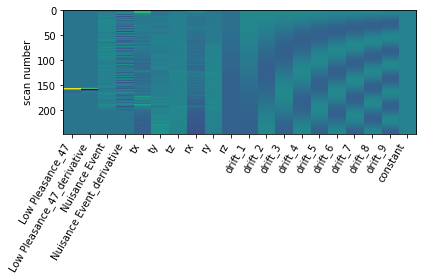

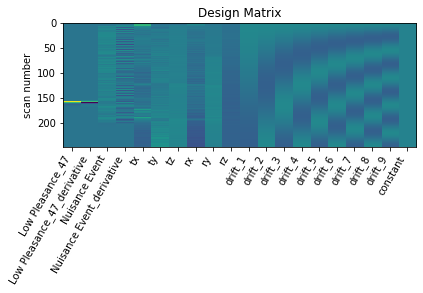

      0         1         2         3         4         5         6      \
0  0.143376 -0.751518 -0.012294 -0.477237 -0.450246 -1.619817 -0.741261   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.061831 -0.936318  0.191692  ... -0.212661 -0.502019  0.352393  0.357454   

      11451     11452     11453     11454     11455     11456  
0 -0.094548  0.546415 -0.185079 -1.082373 -0.985775  0.501104  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_47
GLM RUN LowPleasance_48


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



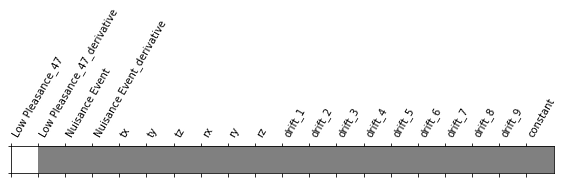

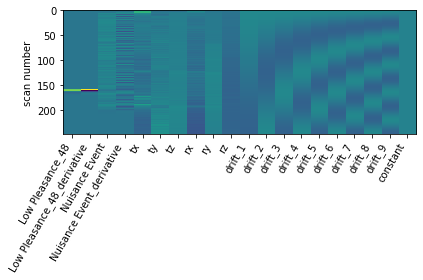

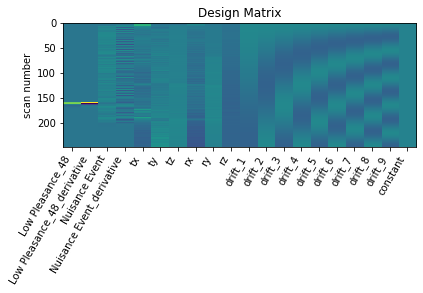

      0        1         2         3         4         5         6      \
0  1.484314  0.31372  0.067957  0.554528  0.715596  1.423033 -0.143284   

      7         8         9      ...    11447     11448     11449     11450  \
0  0.341929  1.026647  0.987409  ... -1.68313 -1.712044 -1.367587  0.559378   

      11451    11452    11453    11454     11455     11456  
0  0.001775 -1.18017  0.28409 -0.22839  0.645861 -1.807514  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_48
GLM RUN LowPleasance_49


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



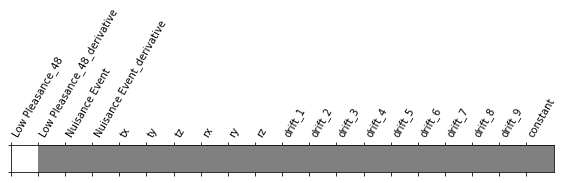

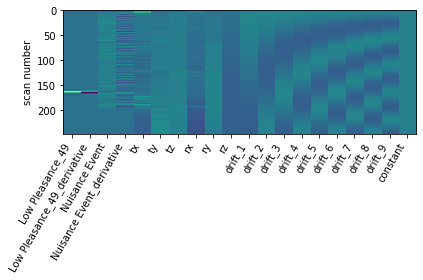

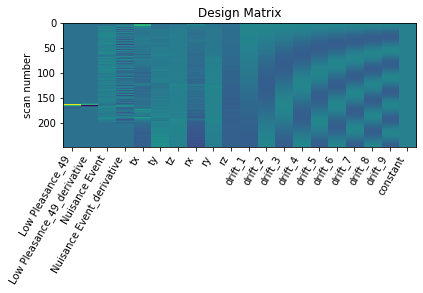

      0         1         2         3         4         5         6      \
0  1.076577  0.529347  1.090497  0.630147  0.365694 -0.373646  0.198667   

      7        8         9      ...     11447     11448     11449     11450  \
0  0.754959  0.72954  0.890967  ... -0.584964 -0.261306 -0.775995 -0.012963   

      11451     11452     11453    11454     11455    11456  
0  0.318287 -0.414113  0.930172 -1.30192 -1.132516 -0.56247  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_49
GLM RUN HighPleasance_50


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



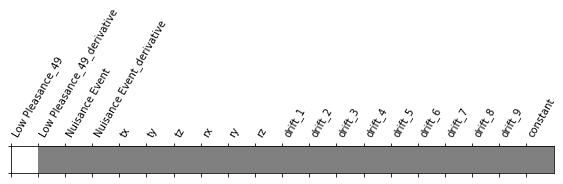

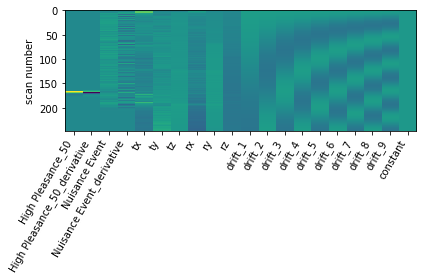

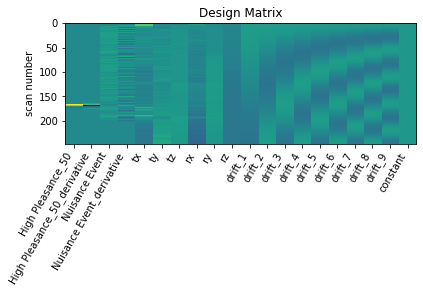

      0         1         2         3         4        5        6      \
0 -0.071713  0.085294  1.006541  0.968883  1.056382  0.66653 -0.18696   

      7         8         9      ...     11447    11448     11449     11450  \
0  0.349119  0.898156  0.914073  ... -1.031132 -0.84562 -0.234517  0.480366   

      11451    11452     11453     11454     11455     11456  
0  0.296201  0.57618  0.591429 -0.873248 -0.464268  0.281523  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_50
GLM RUN LowPleasance_51


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



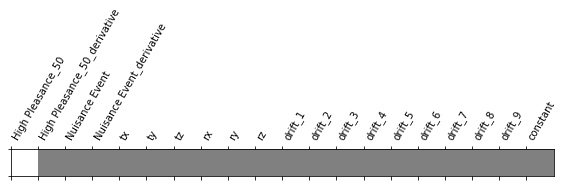

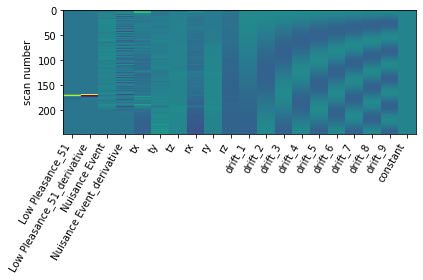

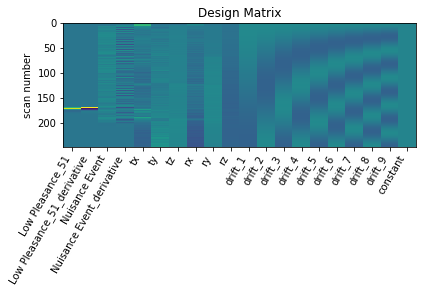

      0         1         2         3         4         5         6      \
0  0.127676  0.499948 -0.437469 -0.928494 -1.021198  0.237368  0.444612   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.043338  0.077793  0.179167  ... -0.433127 -0.666813 -0.628799 -0.093372   

      11451     11452     11453     11454     11455     11456  
0 -0.874551 -0.854293  0.310482  0.409281 -0.286624 -0.775794  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_51
GLM RUN LowPleasance_52


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



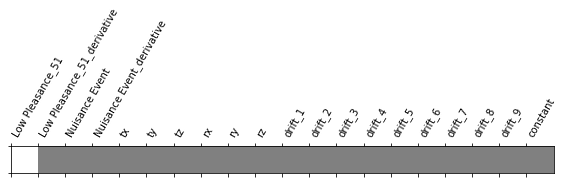

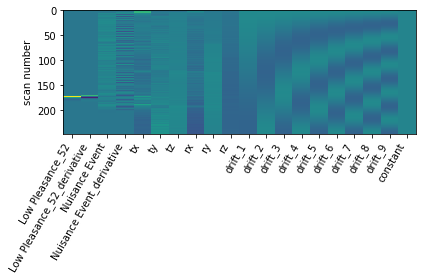

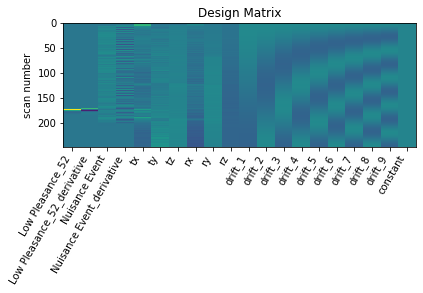

      0         1         2         3         4        5       6      \
0  1.393986 -0.096856  0.418792  0.947635  1.525542  0.18389  1.2015   

      7         8         9      ...     11447     11448     11449     11450  \
0  2.229886  2.235628  2.173295  ...  0.124087 -0.140071 -0.155318  0.154855   

      11451     11452     11453     11454     11455     11456  
0  0.391194 -0.456264  0.696555 -0.066669 -0.443953 -1.049183  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_52
GLM RUN LowPleasance_53


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



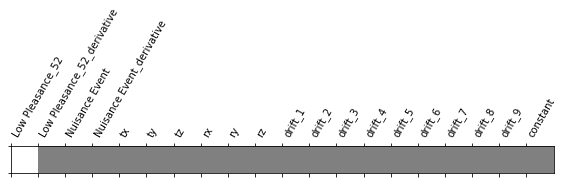

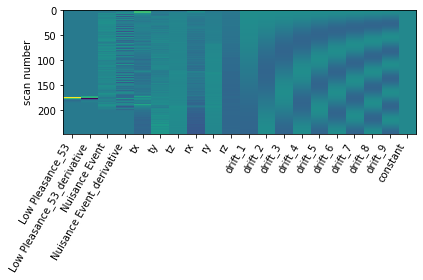

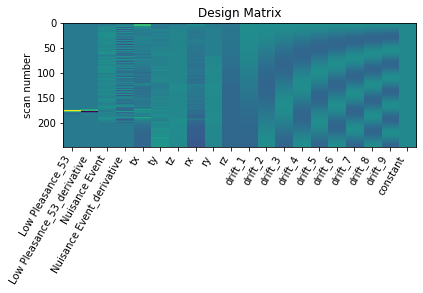

      0         1         2         3         4         5         6      \
0 -0.529467 -0.094163  0.457597  0.197112  0.054134 -0.609651  0.004716   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.095707  0.110541  0.291728  ... -0.634895 -0.369356  0.212941  1.152799   

      11451     11452     11453     11454     11455     11456  
0 -0.863208  0.040857  0.946672 -1.113125 -0.393581  0.471166  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_53
GLM RUN LowPleasance_54


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



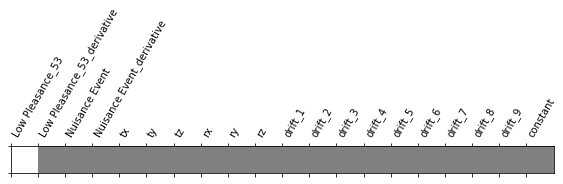

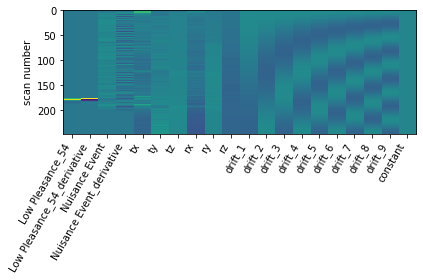

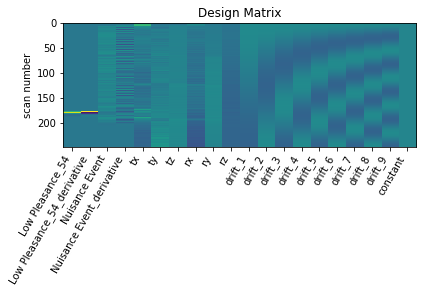

      0         1         2         3         4         5         6      \
0  0.309466 -0.168535 -1.092837 -1.199173 -0.925367  0.728386 -0.805523   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.026254 -0.518955 -0.793952  ... -1.241078 -1.644279 -1.731153 -0.377535   

      11451     11452     11453     11454     11455     11456  
0 -0.020531 -1.445691  0.012084 -0.151229 -0.149966 -0.445865  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_54
GLM RUN HighPleasance_55


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



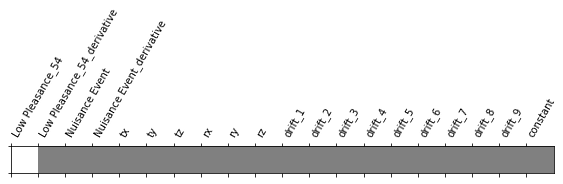

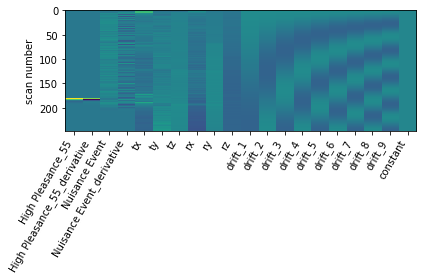

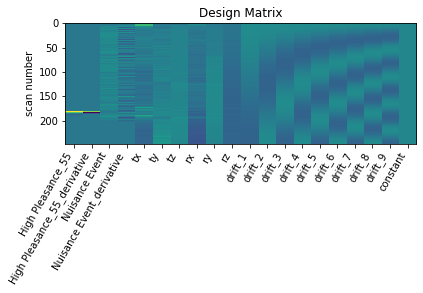

      0         1       2         3         4         5         6      \
0  0.698041 -1.026287 -0.3372 -0.446805 -0.667447 -1.256391  0.221852   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.881746  0.585701  1.347378  ... -1.003822 -0.963934 -0.601278  0.368713   

      11451     11452    11453     11454     11455     11456  
0  0.278516 -1.105141 -0.74187 -0.819819 -0.416435 -0.116429  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_55
GLM RUN LowPleasance_56


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



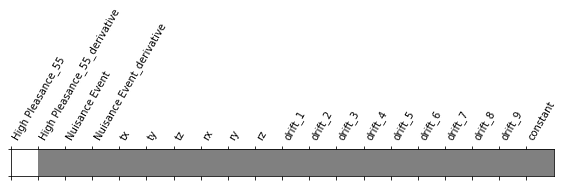

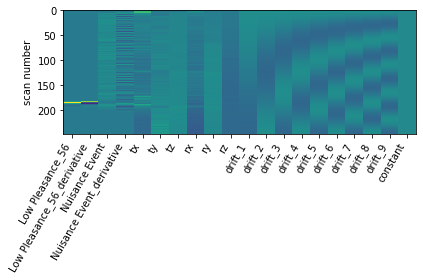

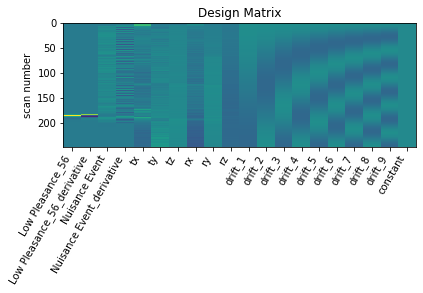

      0         1         2         3         4        5         6      \
0  0.188803  0.376121  1.462801  1.322135  1.330061  0.91992 -0.072183   

      7         8         9      ...    11447     11448     11449     11450  \
0 -0.248845  0.243655  0.286006  ... -0.41662 -0.488397 -0.027169  0.794017   

      11451     11452     11453    11454     11455     11456  
0  0.623053  0.722543  1.745957 -0.08496  1.329686  1.131357  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_56
GLM RUN LowPleasance_57


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



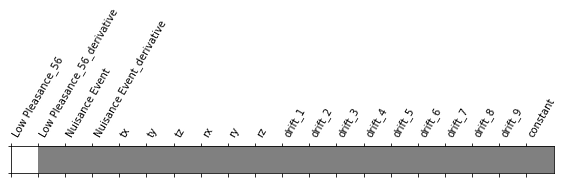

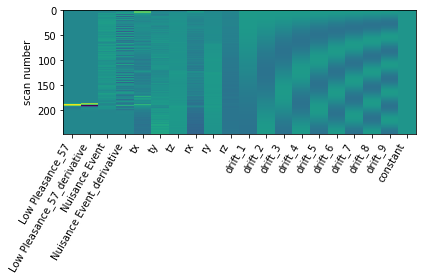

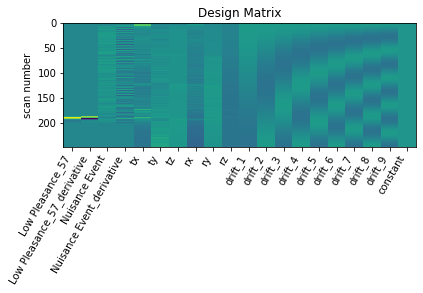

      0         1         2         3        4         5         6      \
0  0.834555 -0.177583 -0.703692 -0.760826 -0.58313 -0.443674 -0.106661   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.042667  0.060086  0.655472  ... -1.065283 -1.351044 -1.075078  0.236878   

      11451     11452     11453    11454    11455     11456  
0 -0.121649 -0.728754 -0.279297  0.20834 -0.62179 -1.004993  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_57
GLM RUN LowPleasance_58


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



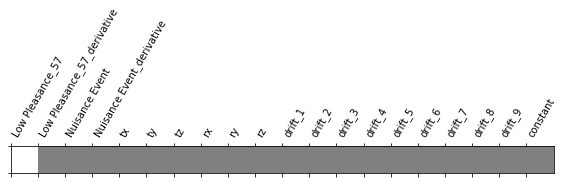

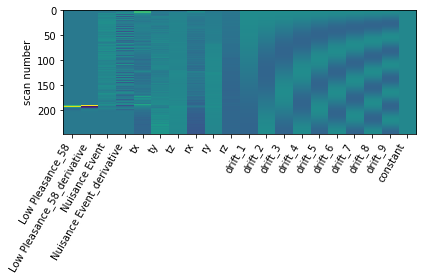

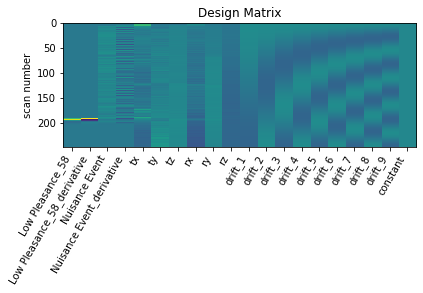

      0         1         2         3         4         5         6      \
0  0.221306  0.534691  1.445893  1.538344  1.374641  0.768467  0.245427   

      7        8         9      ...     11447     11448     11449     11450  \
0  0.564893  0.96849  0.750156  ...  0.873425  0.749763  0.366735  0.196469   

      11451     11452     11453     11454     11455     11456  
0  0.677633 -0.110885  1.179083 -0.477574  0.798104 -0.553005  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_58
GLM RUN LowPleasance_59


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



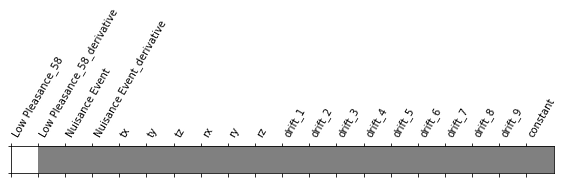

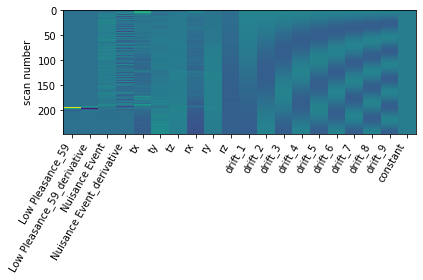

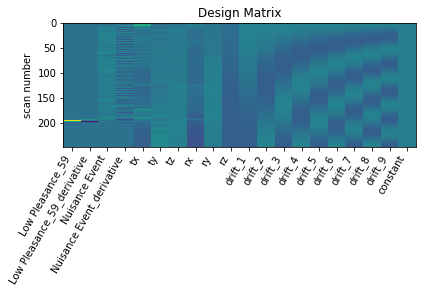

      0         1         2         3        4         5         6      \
0 -1.811546 -0.295803  0.299836  0.786506  0.71372 -0.578788 -0.654019   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.258142 -0.400642 -0.524753  ... -0.923616 -0.166038 -0.291573 -1.006424   

      11451     11452     11453     11454     11455     11456  
0 -0.369938  0.140931  0.039812 -1.373618  0.006246  0.687849  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_59
GLM RUN LowPleasance_60


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



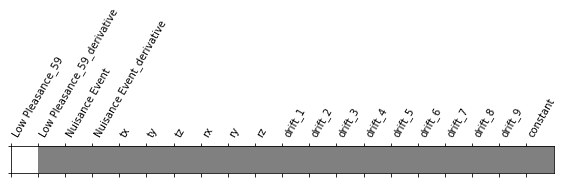

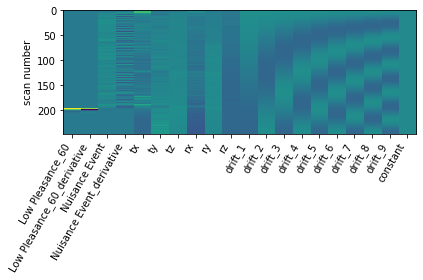

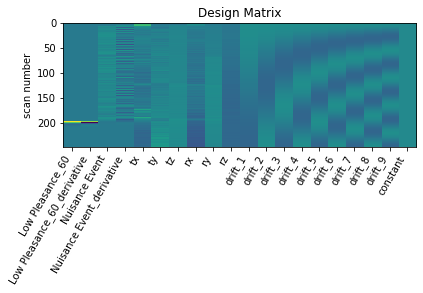

      0         1         2         3         4         5        6      \
0  1.428794  0.447029 -0.515898 -0.294144  0.048003 -0.839972  0.39918   

      7         8         9      ...     11447     11448    11449     11450  \
0  0.427861  0.565239  1.392661  ... -1.162659 -1.162437 -0.95226  1.025629   

      11451     11452     11453     11454     11455     11456  
0 -0.958041 -1.390674 -0.041962 -0.299191 -0.909536 -0.244283  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_60


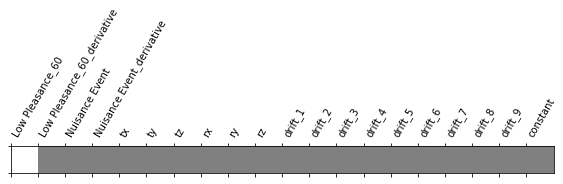

In [ ]:
y_p_ap, X_p_ap = lss_separate_method_comp(task =task,
                          data_path=data_path,
                          events_path=events_path,
                          motion_param_path=motion_param_path,
                          cache_mem_path=cache_mem_path,
                          activity_mat_saving_path=activity_mat_saving_path,
                          analysis_type=analysis_type,
                          param_modulation=False,
                          t_r=t_r,
                          drift_model=drift_model,
                          drift_order=drift_order,
                          hrf_model=hrf_model,
                          pre_whitening_spec=pre_whitening_spec,
                          apply_trans_mask=apply_trans_mask,
                          roi_img=roi_img,  
                          hpf_cut=hpf_cut,
                          smoothing_fwhm=smoothing_fwhm,
                          standardize=standardize,
                          detrend=detrend,minimize_memory=minimize_memory)

In [ ]:
y_g.append(y_p_ap)
X_g.append(X_p_ap)

### Run PA

In [ ]:
data_path = 'ses-19/func/wrdcsub-01_ses-19_task-PreferencePaintings_dir-pa_bold.nii.gz'
events_path = 'ses-19/func/sub-01_ses-19_task-PreferencePaintings_dir-pa_events.tsv'
motion_param_path = 'ses-19/func/rp_dcsub-01_ses-19_task-PreferencePaintings_dir-pa_bold.txt'
task = 'Paintings'

In [ ]:
analysis_type = 'High_Low_Pleasance'
hrf_model = 'spm + derivative'
param_modulation = False
drift_model='cosine'
t_r=2
drift_order=None
apply_trans_mask=True
roi_img = mask_img
standardize=True
detrend=True
minimize_memory = True
activity_mat_saving_path = 'mvpa/test2'

events = pd.read_csv(events_path,sep='\t')

# onset shift in order to capture the very moment of the appreciation decision
events['onset'] = events['onset']-1

onset_periods = [events['onset'][i+1] - events['onset'][i]  for i in range(len(events['onset']))if (i<len(events['onset'])-1)]
onset_periods = np.array(onset_periods)
onset_freq = np.reciprocal(onset_periods)
hpf_cut = np.min(onset_freq)/2 # cf High Pass Filtering Rule of Thumb ( fMRI Handbook 2011)

Event 0
      onset  duration        trial_type
0     9.955     3.250  High Pleasance_1
1    14.204     4.735    Nuisance Event
2    19.820     2.121    Nuisance Event
3    24.620     5.271    Nuisance Event
4    33.635     3.568    Nuisance Event
5    38.151     4.722    Nuisance Event
6    45.150     3.953    Nuisance Event
7    53.266     7.929    Nuisance Event
8    64.481     4.315    Nuisance Event
9    69.597     3.777    Nuisance Event
10   75.579     3.688    Nuisance Event
11   81.078     2.702    Nuisance Event
12   86.261     3.233    Nuisance Event
13   92.910     5.002    Nuisance Event
14  101.609     3.374    Nuisance Event
15  106.258     3.502    Nuisance Event
16  111.641     7.458    Nuisance Event
17  121.456     6.335    Nuisance Event
18  130.405     4.599    Nuisance Event
19  136.138     5.197    Nuisance Event
20  143.003     6.283    Nuisance Event
21  151.036     2.462    Nuisance Event
22  154.968     2.648    Nuisance Event
23  160.434     2.722    Nuisanc

59  408.017     7.895    Nuisance Event
Event 57
      onset  duration        trial_type
0     9.955     3.250    Nuisance Event
1    14.204     4.735    Nuisance Event
2    19.820     2.121    Nuisance Event
3    24.620     5.271    Nuisance Event
4    33.635     3.568    Nuisance Event
5    38.151     4.722    Nuisance Event
6    45.150     3.953    Nuisance Event
7    53.266     7.929    Nuisance Event
8    64.481     4.315    Nuisance Event
9    69.597     3.777    Nuisance Event
10   75.579     3.688    Nuisance Event
11   81.078     2.702    Nuisance Event
12   86.261     3.233    Nuisance Event
13   92.910     5.002    Nuisance Event
14  101.609     3.374    Nuisance Event
15  106.258     3.502    Nuisance Event
16  111.641     7.458    Nuisance Event
17  121.456     6.335    Nuisance Event
18  130.405     4.599    Nuisance Event
19  136.138     5.197    Nuisance Event
20  143.003     6.283    Nuisance Event
21  151.036     2.462    Nuisance Event
22  154.968     2.648    Nuisan

Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



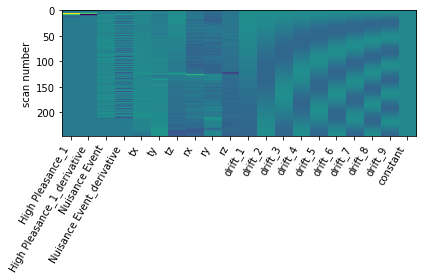

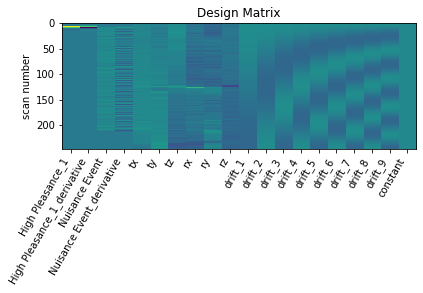

      0         1         2         3         4         5         6      \
0  1.123057  0.467571  0.786518  1.131926  1.226046  0.164251 -0.059283   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.667573 -0.200002  0.157322  ...  0.869091  0.842429  1.248054  0.437485   

      11451     11452    11453     11454     11455     11456  
0  0.447506  1.319701  0.28889  0.161835  0.606897  0.058055  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_1
GLM RUN LowPleasance_2


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



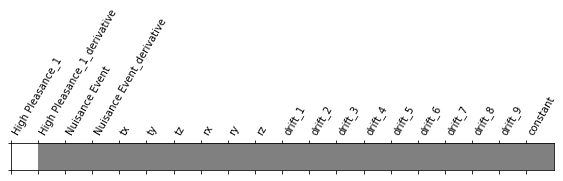

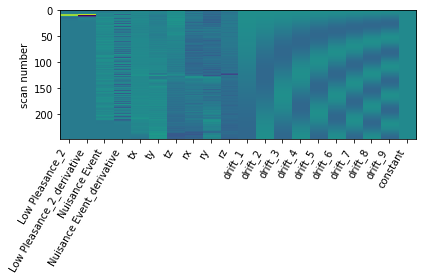

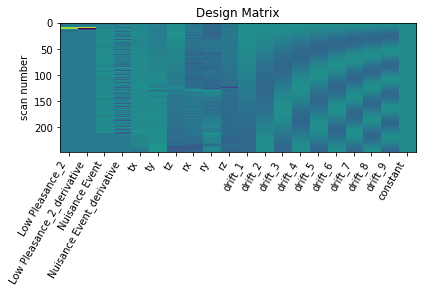

      0         1         2         3         4         5        6      \
0  0.256485  0.188972  0.125859  0.281059  0.179664 -0.356402  0.29635   

      7         8         9      ...     11447     11448    11449     11450  \
0 -0.025502 -0.416975 -0.199887  ... -0.752814 -0.693895 -0.97125 -0.286445   

      11451     11452     11453     11454     11455     11456  
0 -0.682146 -1.206167  0.673291 -0.518236 -0.987802 -0.771182  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_2
GLM RUN HighPleasance_3


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 33 seconds



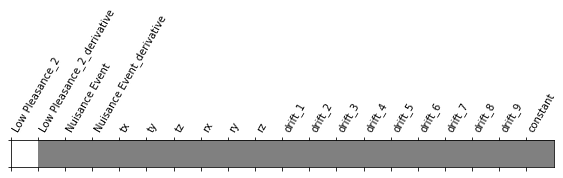

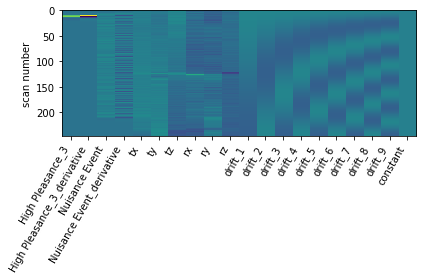

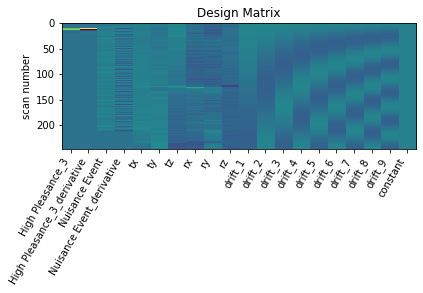

      0         1         2         3         4         5        6      \
0 -1.211029 -1.227664 -2.155124 -2.252746 -2.207437  0.235658 -0.02435   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.006202 -0.173395 -0.228035  ... -1.103724 -1.656178 -1.001231  0.088635   

      11451     11452     11453     11454     11455     11456  
0 -0.632688 -0.658292 -1.397256 -0.561205 -0.362559 -0.594727  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_3
GLM RUN LowPleasance_4


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



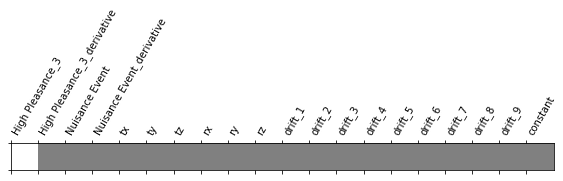

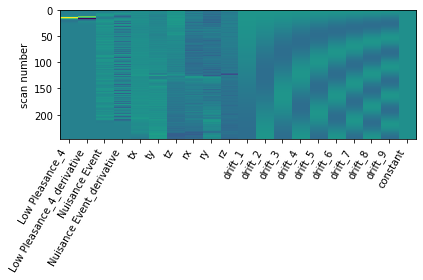

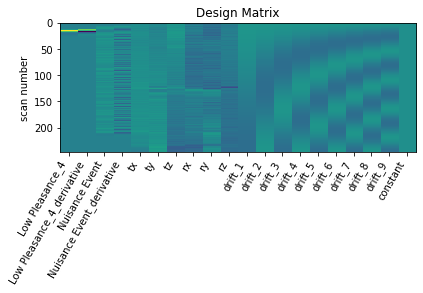

      0         1         2         3         4         5         6      \
0  2.434704  0.115824  2.231922  2.679788  3.338112  1.884105  0.283228   

      7        8         9      ...    11447     11448     11449     11450  \
0  0.972744  1.82408  0.818868  ... -0.08147  0.104802 -0.057405 -0.133576   

      11451     11452     11453     11454     11455     11456  
0  2.682156 -0.146858  2.657389 -0.697326  1.061849 -1.890263  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_4
GLM RUN LowPleasance_5


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



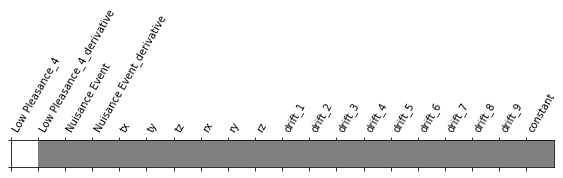

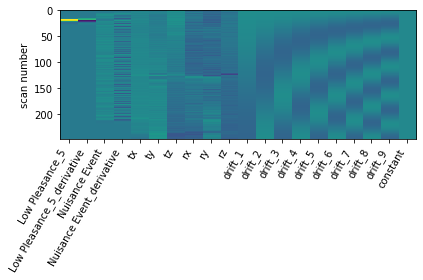

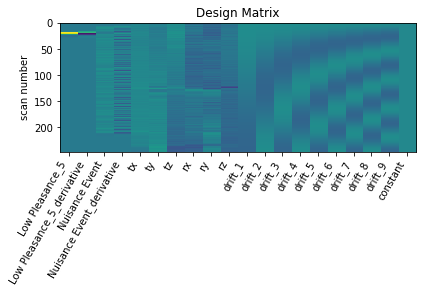

      0        1         2         3         4         5         6      \
0  0.653478  0.51512  0.464669  0.741512  0.545662  1.004127 -0.005894   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.291289  0.367225  0.298663  ... -1.056599 -1.107917 -1.417144  0.443836   

      11451     11452     11453     11454     11455     11456  
0 -1.445475 -1.352387  0.158797 -1.428389 -0.683012 -1.178626  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_5
GLM RUN LowPleasance_6


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 28 seconds



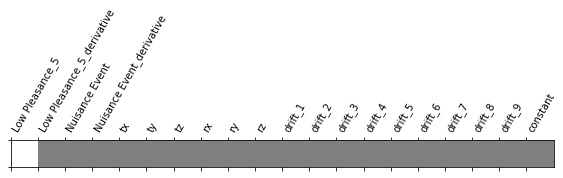

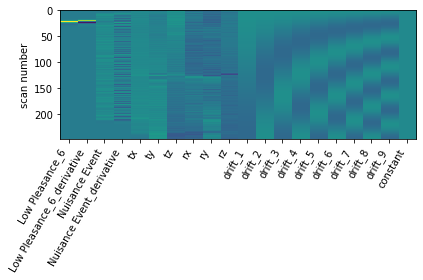

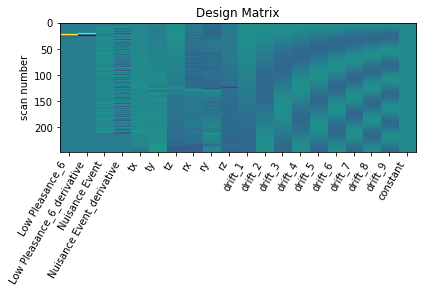

      0         1         2         3         4         5         6      \
0  1.733499 -1.852864  0.841275  1.192481  1.654184  0.946159 -0.116327   

      7         8         9      ...    11447     11448     11449     11450  \
0  0.493729  1.012125  0.525784  ... -0.90254 -1.422063 -0.631594 -0.326131   

      11451     11452     11453     11454     11455     11456  
0  1.392701 -0.569872  1.154928 -0.641006  0.234553 -2.769096  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_6
GLM RUN HighPleasance_7


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



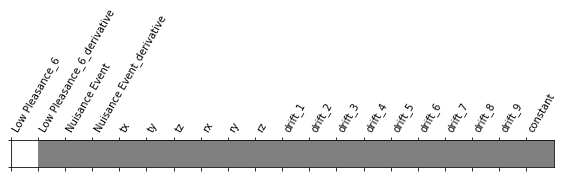

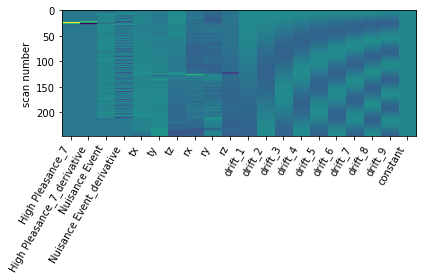

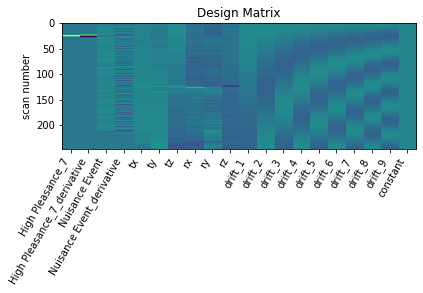

      0         1        2         3        4        5         6      \
0  1.106124  0.894393 -0.16146  0.239558  0.47929  0.73353  0.509645   

      7         8         9      ...     11447     11448    11449     11450  \
0  0.447956  0.637732 -0.051492  ... -1.466982 -1.006939 -1.15498  0.262619   

      11451     11452     11453     11454     11455     11456  
0  0.460043 -1.489436  0.292776 -1.633909 -0.222021 -1.466263  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_7
GLM RUN HighPleasance_8


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



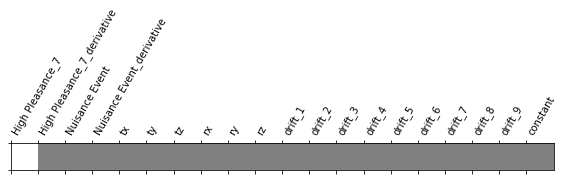

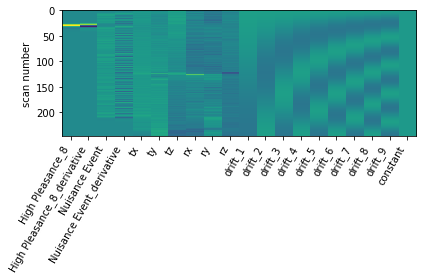

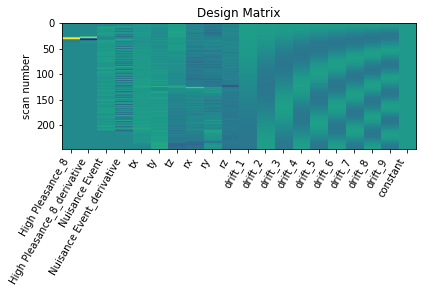

      0         1         2         3         4         5        6      \
0  2.359763 -1.204856  1.490568  1.927842  2.239267  1.555396  0.68382   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.895063  0.988057  0.625152  ... -0.793094 -1.228034 -0.934285 -0.889743   

      11451     11452     11453     11454     11455     11456  
0  0.266841 -1.513488  1.230505 -1.064927 -0.654746 -3.111437  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_8
GLM RUN LowPleasance_9


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



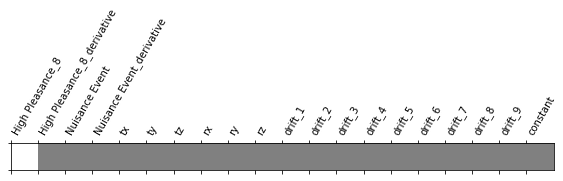

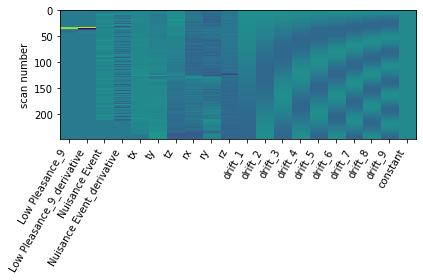

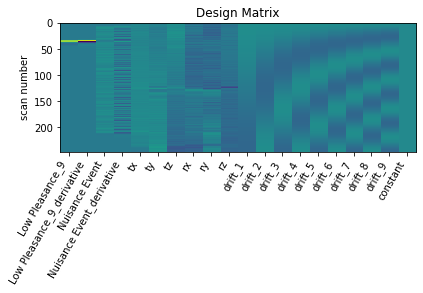

      0         1         2         3         4        5         6      \
0  0.638097  0.124788  1.229512  1.368441  1.281338  0.45019 -0.005532   

      7        8        9      ...     11447     11448     11449     11450  \
0 -0.306224  0.02011 -0.35918  ... -1.016105 -1.003693 -1.085216  0.835712   

      11451     11452     11453     11454     11455     11456  
0 -0.214186 -0.831005 -0.161506 -1.105843  0.452669 -0.631802  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_9
GLM RUN HighPleasance_10


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



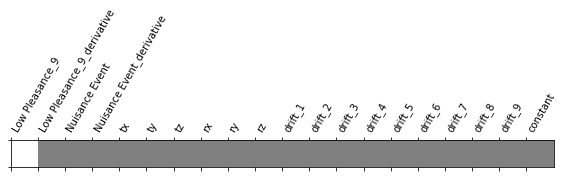

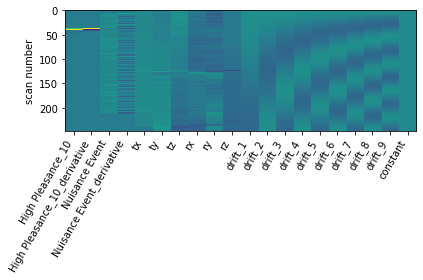

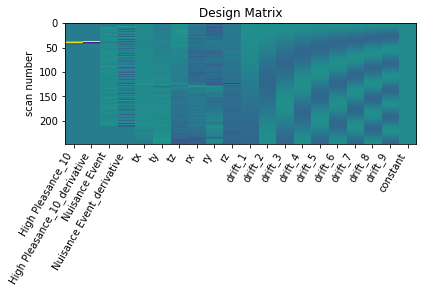

      0         1         2         3        4         5         6      \
0 -0.904977  0.488672 -0.236989 -0.219807 -0.14434 -0.041953 -1.129131   

      7        8         9      ...     11447     11448     11449     11450  \
0 -0.796047 -0.40061 -0.543776  ...  0.353608  0.487737 -0.395427 -0.232626   

      11451     11452     11453     11454     11455     11456  
0  0.273229 -1.230988  0.769323 -0.274645 -0.508788 -1.463738  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_10
GLM RUN LowPleasance_11


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



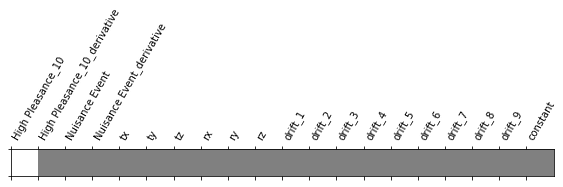

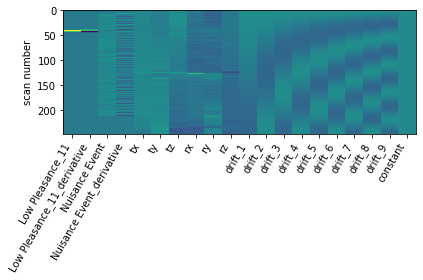

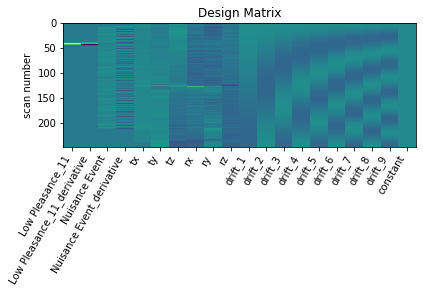

      0         1         2         3         4         5        6      \
0  1.471243 -0.891543  0.732505  1.178759  1.595323  1.326664  1.05554   

      7         8        9      ...     11447     11448     11449     11450  \
0  1.087697  0.920347  0.68337  ... -0.865422 -1.400836 -0.677331 -0.059753   

      11451     11452     11453     11454     11455     11456  
0  0.916831 -1.278377  0.706139 -1.105149 -1.059634 -2.219025  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_11
GLM RUN LowPleasance_12


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



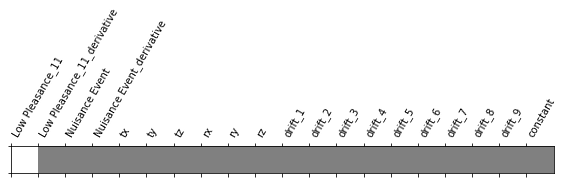

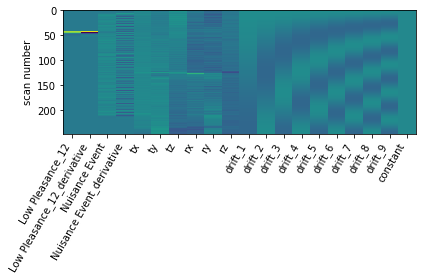

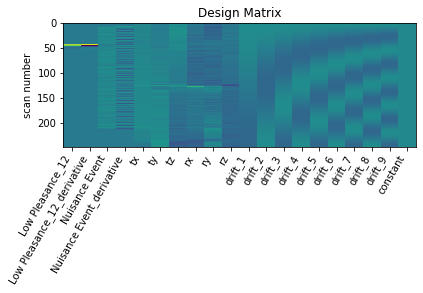

      0         1        2         3         4         5         6      \
0  1.337146 -1.094441  0.50886  0.803329  0.943622  0.102566  0.416587   

     7         8         9      ...     11447     11448     11449     11450  \
0  0.13195 -0.136122 -0.131328  ... -0.987394 -1.421809 -0.279389 -0.300478   

      11451     11452     11453     11454     11455     11456  
0 -1.048617  0.478474  0.221498 -0.385419  0.266765 -1.251578  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_12
GLM RUN HighPleasance_13


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



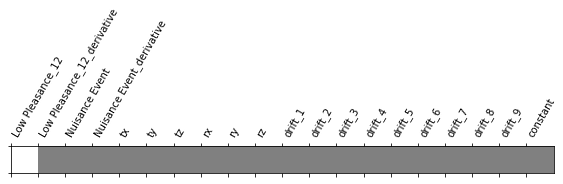

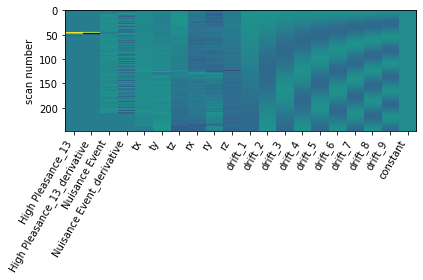

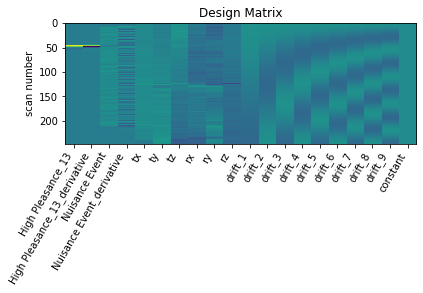

      0         1         2        3         4         5         6      \
0  0.383398  1.818678  1.143039  1.20967  1.087796  0.575803 -0.903911   

      7         8         9      ...     11447     11448     11449    11450  \
0 -0.684607  0.022599 -0.692787  ... -0.279128  0.392453 -0.848815 -0.27346   

     11451     11452     11453     11454     11455     11456  
0  0.71595 -1.520018  0.298457 -1.305368  0.371681 -0.887117  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_13
GLM RUN LowPleasance_14


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



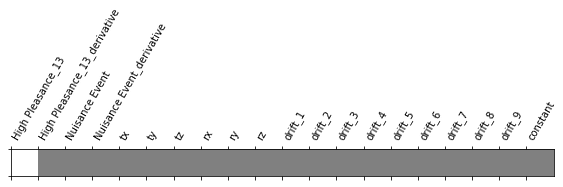

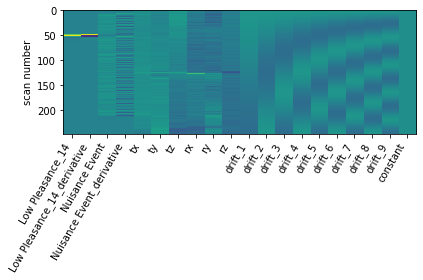

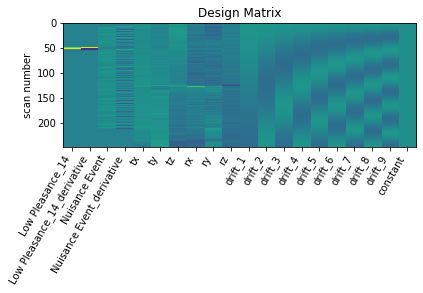

      0         1         2         3         4         5         6      \
0  2.050485 -1.236184  0.533792  1.028202  1.487952  1.860601  1.691185   

     7         8         9      ...     11447     11448     11449     11450  \
0  2.17068  1.966444  2.103137  ... -0.896275 -1.018426 -0.559486 -0.021598   

      11451     11452     11453     11454     11455     11456  
0  1.075918 -0.803293  2.709192 -0.914322 -0.802357 -2.828045  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_14
GLM RUN LowPleasance_15


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



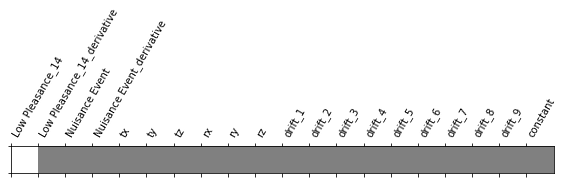

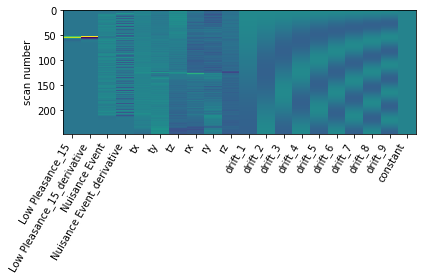

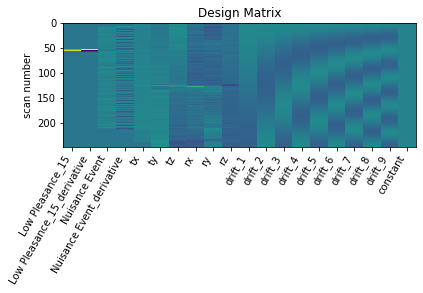

      0         1         2         3         4         5         6      \
0  1.507331  0.774101  1.817359  2.170558  2.142122  0.114256 -0.492183   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.443243 -0.358785  0.084732  ...  0.710453  0.304572  0.275638  1.067965   

      11451     11452     11453     11454     11455     11456  
0  0.118271 -0.101242 -0.242984  0.526331  1.706775 -0.274846  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_15
GLM RUN LowPleasance_16


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



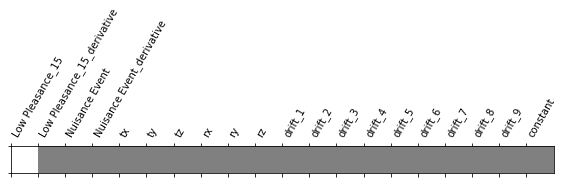

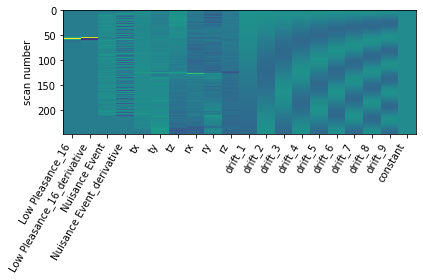

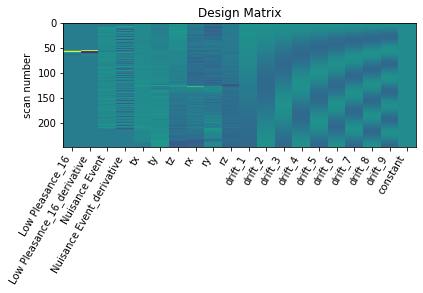

      0         1         2        3         4         5         6      \
0  0.602123 -0.287809  0.802975  0.73838  0.697667  1.645267  0.275621   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.788353  1.200339  0.534768  ... -1.058679 -0.698271 -1.208439 -0.278438   

      11451     11452     11453     11454     11455     11456  
0  0.271739 -0.629609  0.279129 -0.971378 -0.862641 -0.611515  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_16
GLM RUN HighPleasance_17


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



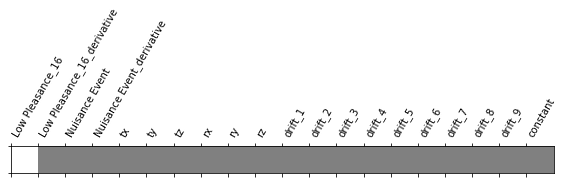

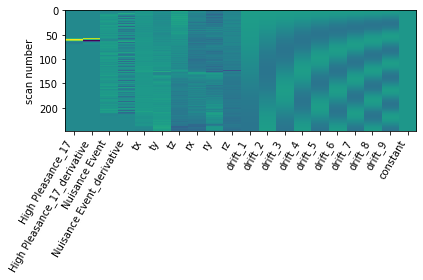

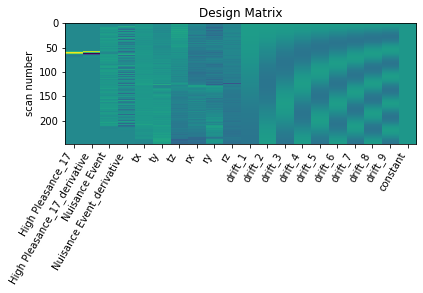

      0         1         2         3         4         5         6      \
0  1.048065 -0.356029  0.754065  1.364967  1.698165  0.487063 -0.268046   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.099485  0.306089 -0.180409  ... -1.212499 -1.774728 -1.037009 -0.127713   

      11451     11452     11453     11454     11455     11456  
0  0.478201 -1.274328  0.455863 -1.383242 -0.691454 -2.566947  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_17
GLM RUN LowPleasance_18


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



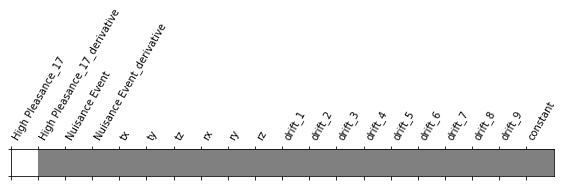

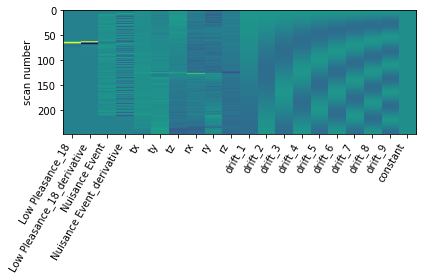

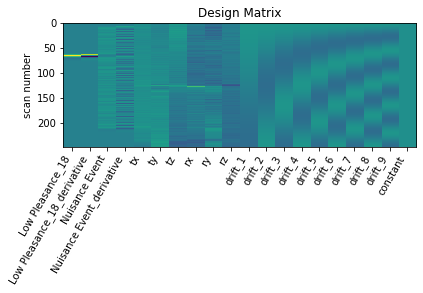

      0         1         2         3         4         5         6      \
0  1.032996 -0.120544  0.991618  1.587316  1.977719  1.100999  0.175019   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.158039  0.722478 -0.035754  ... -1.666985 -1.566343 -1.991199 -0.062195   

      11451     11452     11453     11454    11455     11456  
0  1.498655 -2.264671  1.461595 -2.128987 -0.50138 -2.274321  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_18
GLM RUN LowPleasance_19


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



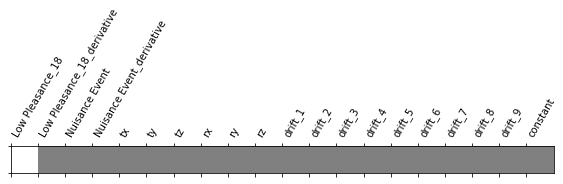

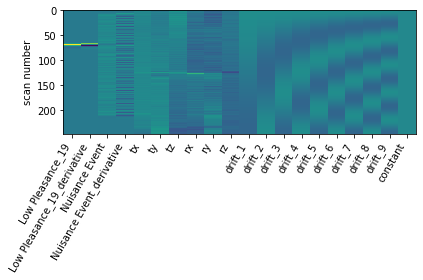

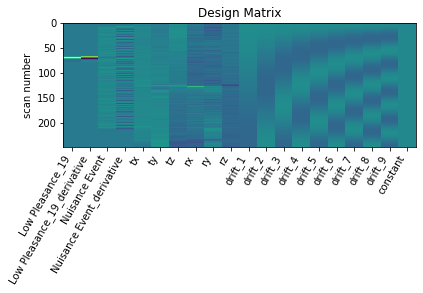

      0         1         2         3        4         5        6      \
0  1.741628 -0.615482  1.226276  1.373688  1.22711  1.217799  0.43949   

     7         8         9      ...     11447     11448     11449     11450  \
0  1.14338  1.263514  1.109749  ... -0.194246 -0.498851 -0.027302 -0.139876   

      11451     11452     11453     11454     11455     11456  
0  0.197527  0.196274  0.147953 -0.074176 -0.133756 -1.002656  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_19
GLM RUN HighPleasance_20


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



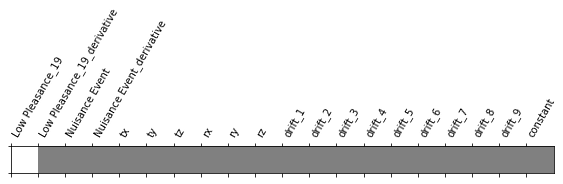

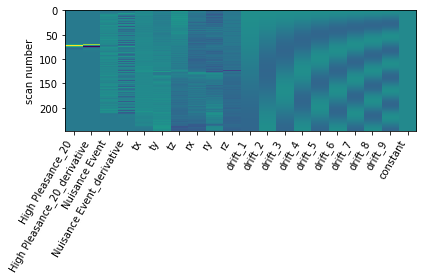

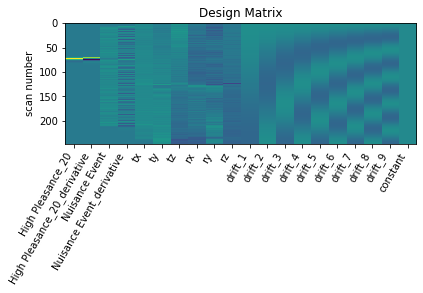

      0         1         2         3        4         5         6      \
0  0.652787  0.279586  0.162104  0.434036  0.69705  0.674106  0.282829   

      7        8         9      ...     11447     11448     11449     11450  \
0  0.419813  0.47169  0.032201  ... -1.319251 -0.974256 -0.997275  0.004397   

     11451     11452     11453     11454     11455     11456  
0 -0.11681 -1.664488  1.441311 -1.660541  0.068683 -2.005891  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_20
GLM RUN HighPleasance_21


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



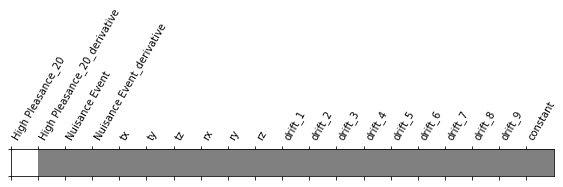

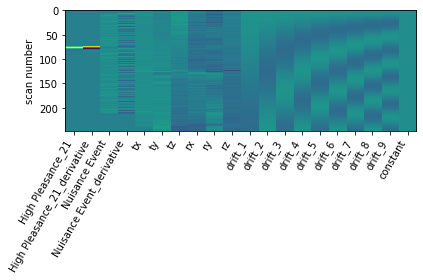

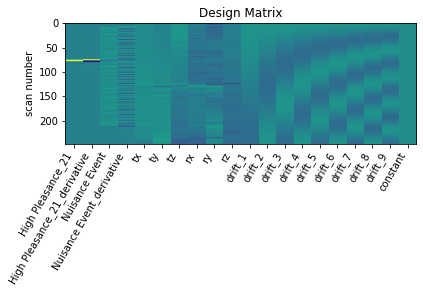

      0         1         2         3         4         5         6      \
0  1.198159 -1.070494  1.063967  1.389109  1.651363  1.346401  0.325704   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.545676  0.844055  0.622525  ... -0.334461 -0.719534 -0.405604 -0.018981   

      11451     11452     11453     11454     11455     11456  
0  1.147814 -0.255007  0.551884 -0.350529 -0.260582 -1.349802  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_21
GLM RUN LowPleasance_22


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



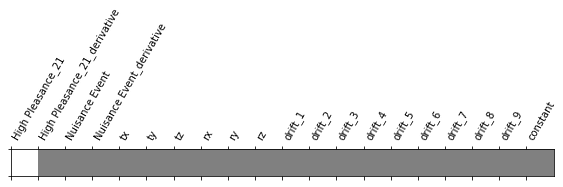

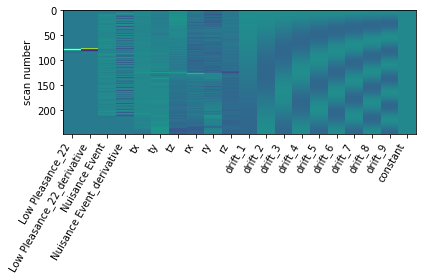

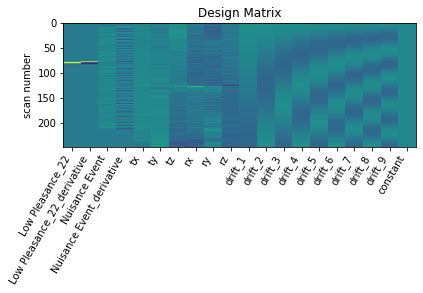

      0         1         2         3         4         5         6      \
0  1.003587  0.696827 -0.404308 -0.421984 -0.572031  0.044906 -0.254056   

     7         8         9      ...     11447     11448    11449     11450  \
0 -0.30482  0.118764 -0.533506  ... -1.003278 -1.049386 -0.96546 -0.098125   

     11451     11452    11453     11454     11455     11456  
0 -0.53867 -0.874153  0.31273 -1.123627 -0.151888 -2.363722  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_22
GLM RUN LowPleasance_23


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



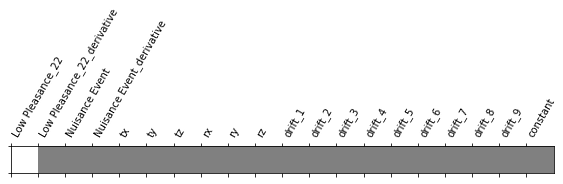

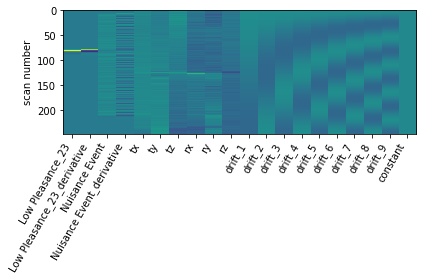

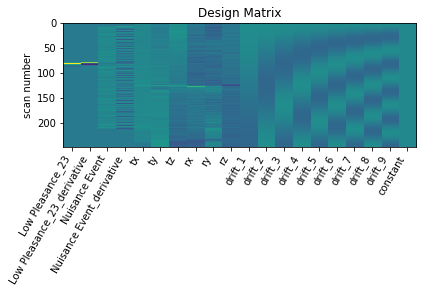

      0         1         2         3         4         5         6      \
0  0.685157  1.191171 -0.063516  0.472032  0.937934 -0.063581  0.658797   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.594356  0.115904 -0.322422  ... -1.840522 -1.430817 -1.542162 -0.112995   

      11451     11452     11453     11454     11455     11456  
0  0.124931 -2.380067 -0.213119 -2.252815 -0.759132 -2.379511  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_23
GLM RUN LowPleasance_24


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 19 seconds



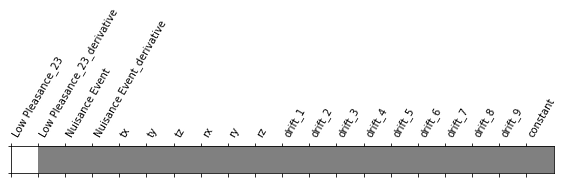

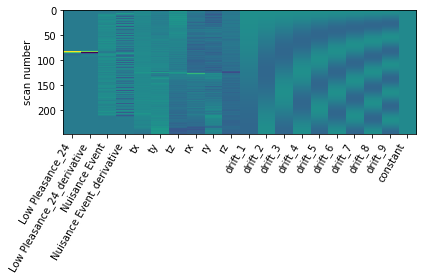

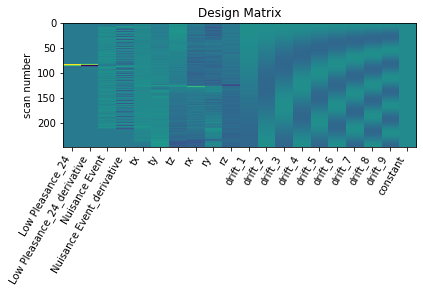

      0         1         2         3        4         5         6      \
0  1.595372 -1.218037  1.870069  2.444519  2.72908  2.156408  0.469423   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.939324  1.335609  1.501848  ...  0.793033 -0.036565  0.259978 -0.308241   

      11451     11452    11453     11454     11455    11456  
0  1.183934  0.330249  1.86603  0.720679  0.021436 -0.60892  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_24
GLM RUN LowPleasance_25


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



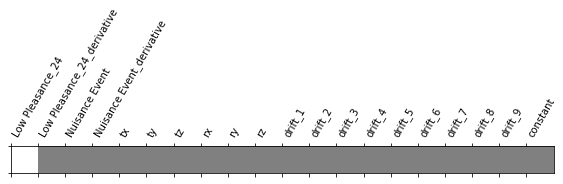

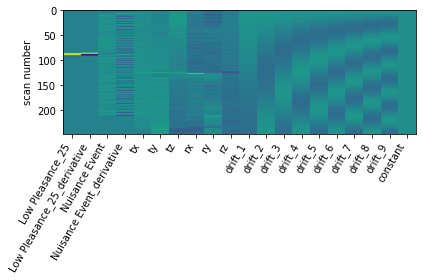

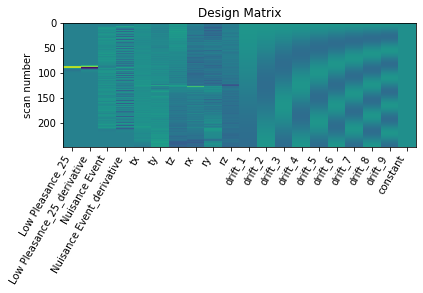

     0         1         2         3        4         5         6      \
0  1.49066  0.533744  1.221319  1.344717  1.38849  0.585039  0.220931   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.324147  0.784446 -0.176982  ... -1.939811 -1.787228 -1.879285  0.304976   

      11451     11452     11453     11454     11455     11456  
0  0.690619 -1.946404  0.819412 -2.262546 -0.575003 -3.107106  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_25
GLM RUN LowPleasance_26


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



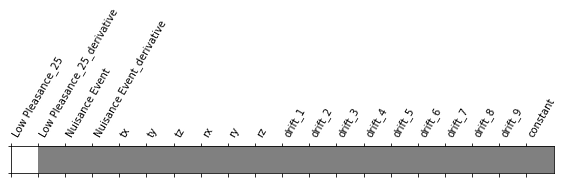

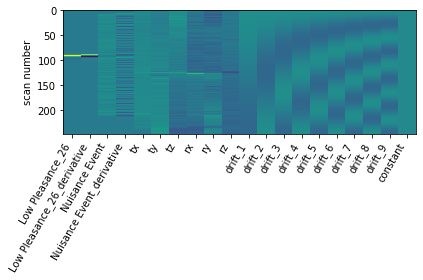

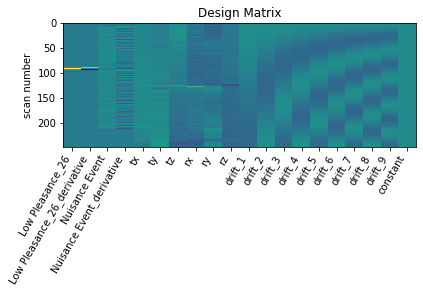

     0       1         2         3         4         5         6      \
0  0.72931 -0.2206  0.380549  1.134155  1.412657  0.529171  0.094434   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.089926 -0.229456 -0.331491  ... -1.114378 -1.261429 -0.864491 -0.005109   

      11451     11452     11453     11454     11455     11456  
0  0.174145 -1.424252  0.236672 -1.077444 -0.120216 -2.142926  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_26
GLM RUN LowPleasance_27


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



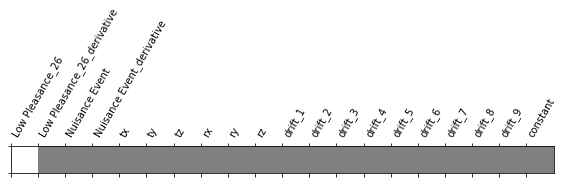

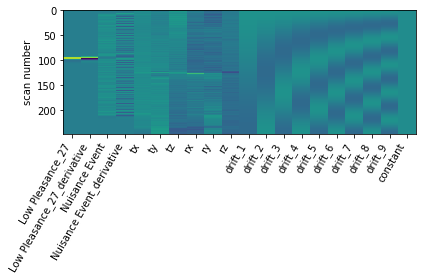

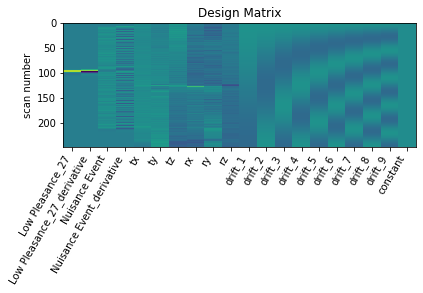

      0         1         2         3         4         5         6      \
0  1.448147 -0.284707  1.744261  2.009958  2.309147  1.460139  0.983119   

      7         8         9      ...     11447     11448    11449     11450  \
0  0.898921  1.116845  1.166221  ... -0.644372 -0.336237 -0.59865 -0.359525   

      11451     11452     11453     11454     11455     11456  
0  0.272777 -1.605718  0.804813 -1.054227  0.202418 -1.556342  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_27
GLM RUN LowPleasance_28


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



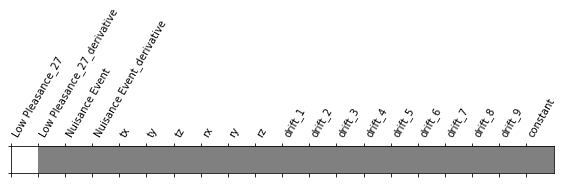

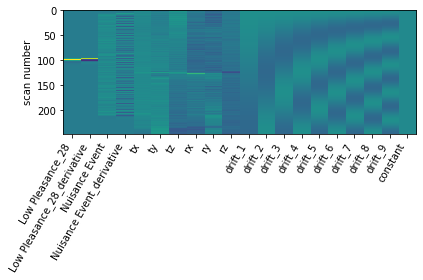

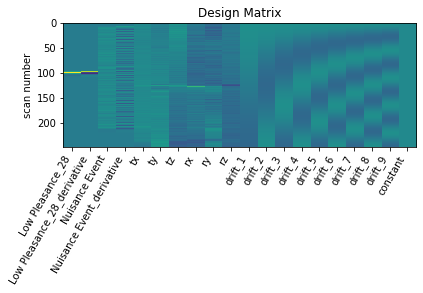

      0        1         2         3         4         5         6      \
0  0.997405 -0.07798 -0.546506 -0.380426 -0.386843 -0.544484 -0.479157   

     7         8         9      ...     11447     11448     11449     11450  \
0 -0.64762 -0.679051 -0.859269  ... -0.933989 -1.251581 -0.252642  0.723149   

      11451     11452     11453     11454     11455     11456  
0  0.504842 -0.199246 -0.350068 -0.580668 -0.507493 -1.426377  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_28
GLM RUN LowPleasance_29


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



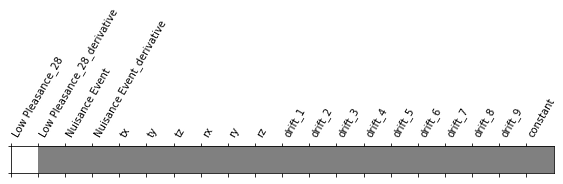

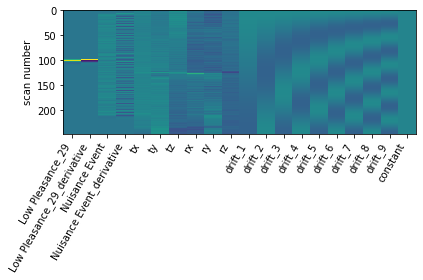

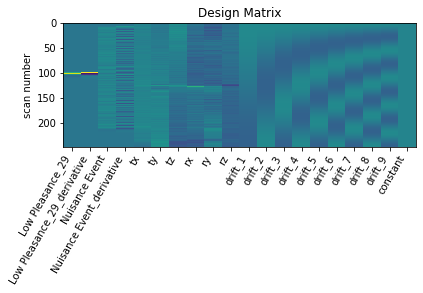

      0         1         2         3         4         5         6      \
0 -0.168618  0.622552 -0.383311  0.152006  0.357147 -0.652023  0.179901   

      7        8         9      ...     11447     11448    11449     11450  \
0  0.133888 -0.14542  0.352304  ... -0.594869 -0.850697 -1.26087  0.955096   

      11451     11452     11453     11454     11455     11456  
0  0.111626 -0.517454  0.528114 -0.602306 -0.134713 -0.960875  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_29
GLM RUN LowPleasance_30


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



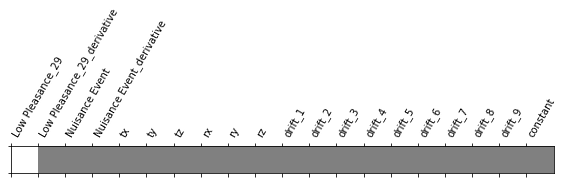

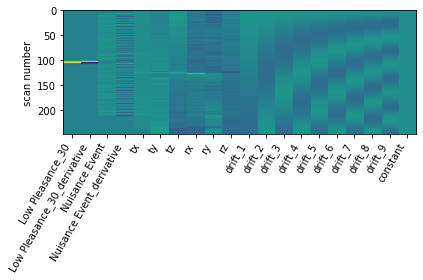

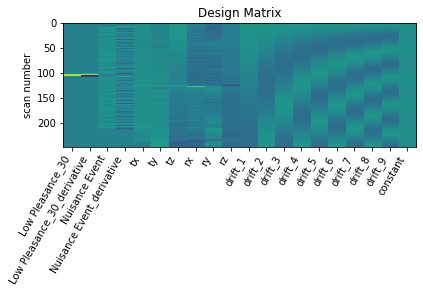

      0         1         2         3         4         5         6      \
0  1.244489 -0.612042  1.444502  1.435379  1.518942  1.763883  0.624957   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.890832  0.973387  0.606993  ... -0.304262 -0.584196 -0.233072 -0.310753   

      11451     11452     11453     11454     11455     11456  
0  0.304037 -0.610884  0.665094 -0.620957  0.366478 -1.500761  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_30
GLM RUN LowPleasance_31


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



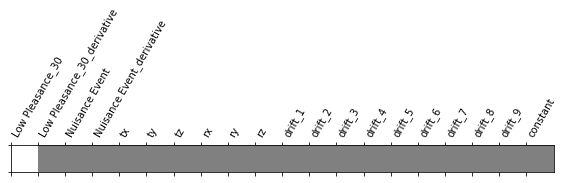

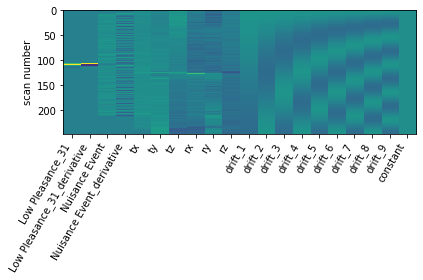

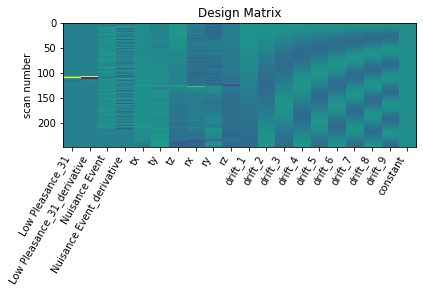

      0         1         2         3        4         5         6      \
0  1.280775 -0.041744  0.744186  1.155877  1.44221  0.885201  0.836336   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.000839  1.037434  0.909366  ... -0.486796 -0.650859 -0.031672  0.402962   

     11451     11452     11453     11454     11455     11456  
0  1.03411 -0.334217  0.389069 -0.703671 -0.163908 -1.344965  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_31
GLM RUN LowPleasance_32


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



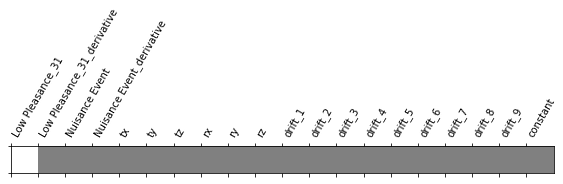

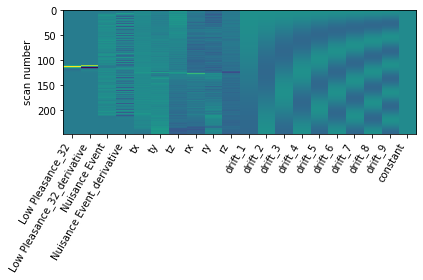

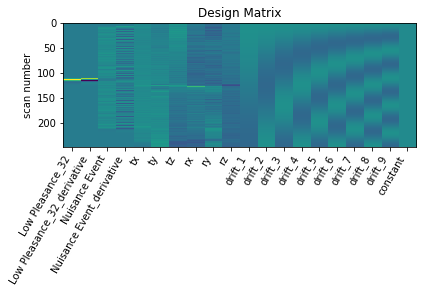

     0         1         2         3         4         5         6      \
0  1.44621  0.069003  0.068917  0.657274  1.298205  1.599323  0.074798   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.512431  0.651454 -0.118549  ... -1.548732 -1.482075 -2.100217  0.621174   

      11451     11452     11453     11454     11455     11456  
0  0.805269 -1.323044  1.714884 -1.423689 -0.034771 -1.905099  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_32
GLM RUN LowPleasance_33


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



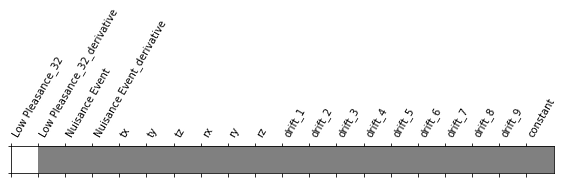

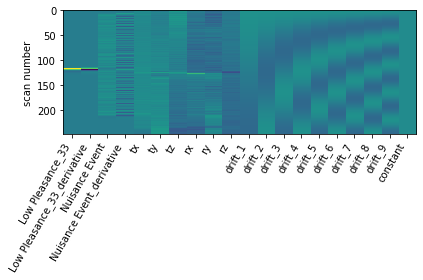

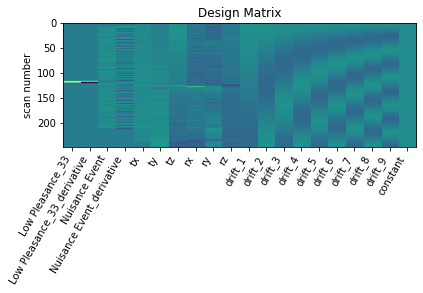

      0         1         2        3         4         5         6      \
0  0.956622 -1.351837  1.962708  2.47766  2.210043  1.247509  0.034445   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.883457  1.595742  1.060411  ... -1.033161 -1.680939 -0.794333  0.048762   

      11451     11452     11453     11454     11455    11456  
0  1.292013 -2.104755 -0.085607 -1.207453 -1.039374 -2.61268  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_33
GLM RUN LowPleasance_34


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



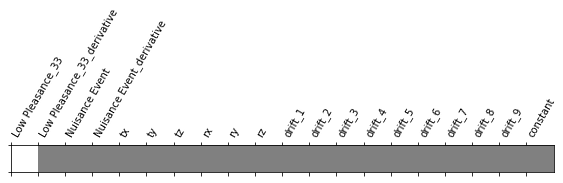

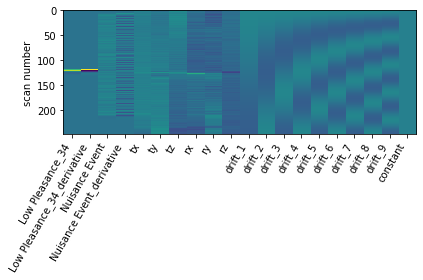

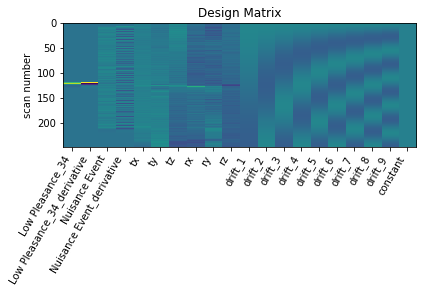

      0         1         2         3         4         5         6      \
0  0.147252 -0.122241 -1.735786 -1.093295 -0.840534  0.459494 -0.693839   

    7         8         9      ...     11447     11448     11449     11450  \
0 -0.1651  0.310916 -0.557721  ... -1.025096 -0.945558 -1.586721 -0.985726   

      11451     11452     11453     11454     11455     11456  
0  0.022518 -0.850742 -0.852625 -0.854912 -0.149252 -0.411323  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_34
GLM RUN HighPleasance_35


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



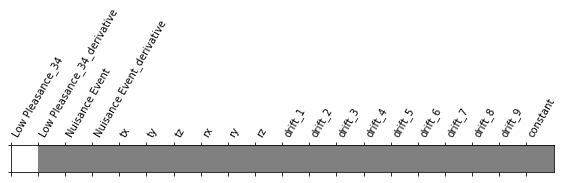

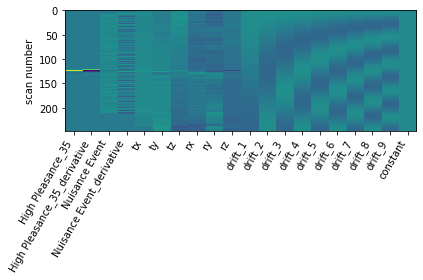

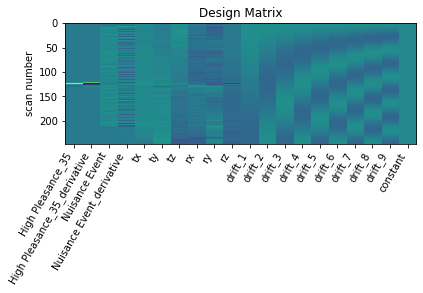

      0         1         2        3         4         5         6      \
0  0.729852 -0.233814  0.960036  0.59354  0.877633  0.004783  0.764615   

      7         8         9      ...     11447    11448     11449     11450  \
0  0.053591 -0.549854 -0.208649  ... -0.492642 -0.45739 -0.116508 -0.606188   

      11451     11452     11453     11454     11455     11456  
0 -0.236679 -0.193412  0.946189 -0.695344 -0.236202 -2.675116  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_35
GLM RUN LowPleasance_36


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



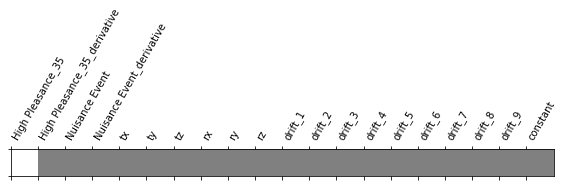

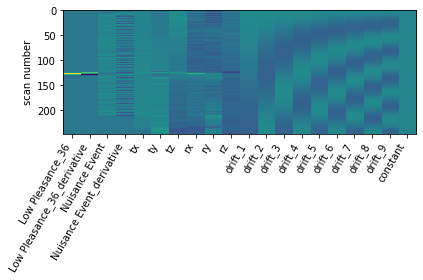

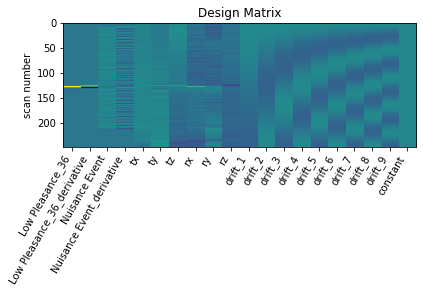

      0         1         2         3        4         5         6      \
0  2.694326  1.922923  3.091526  3.412523  3.42364  2.377916  0.447365   

      7         8         9      ...     11447     11448   11449     11450  \
0  1.220128  2.789504  0.998438  ... -0.623418 -0.251177 -0.7465  0.251754   

      11451     11452     11453     11454     11455     11456  
0  0.587289 -1.129906  2.964587 -1.727781 -0.589751 -1.890987  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_36
GLM RUN LowPleasance_37


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 19 seconds



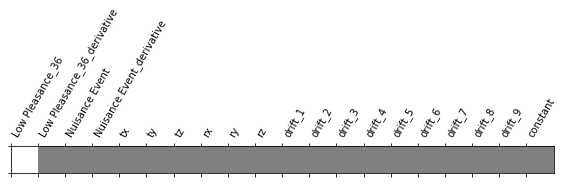

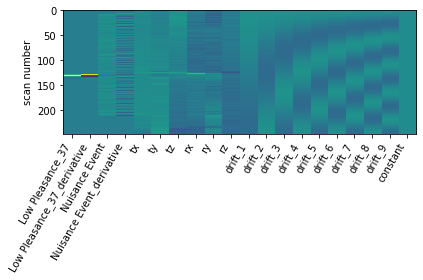

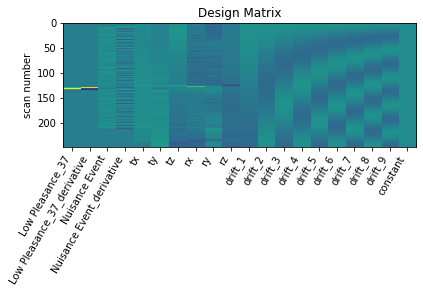

      0         1         2        3         4         5         6      \
0 -0.980352 -0.371088 -0.670931 -0.39117 -0.231745 -1.189867 -0.602569   

      7         8         9      ...     11447     11448     11449     11450  \
0 -1.363182 -1.756394 -1.221512  ...  0.204345  0.221668 -0.455484 -1.358679   

      11451     11452     11453     11454     11455     11456  
0 -0.273141 -0.960484 -1.267893  0.310694 -0.734083 -2.058717  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_37
GLM RUN LowPleasance_38


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 25 seconds



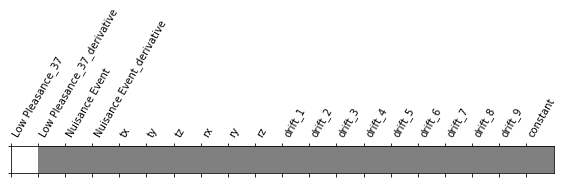

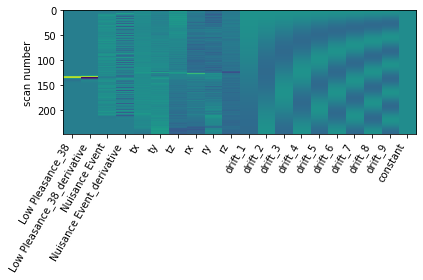

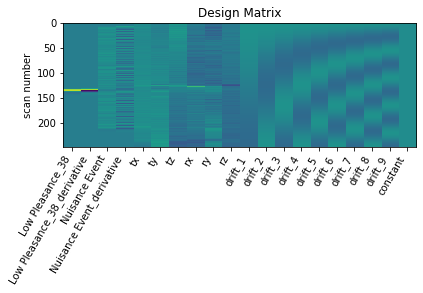

      0         1         2         3         4         5         6      \
0  3.615272  0.885729  2.589403  2.638617  2.985428  1.666269  2.523222   

      7         8         9      ...     11447     11448     11449     11450  \
0  2.033548  1.651106  2.544141  ...  1.540401  1.490641  1.946229  2.660648   

      11451     11452     11453     11454     11455     11456  
0  1.298725  1.546899  2.518755  0.991327  1.332068 -0.290572  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_38
GLM RUN LowPleasance_39


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



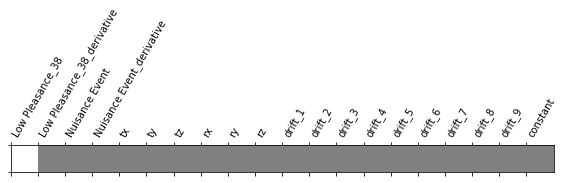

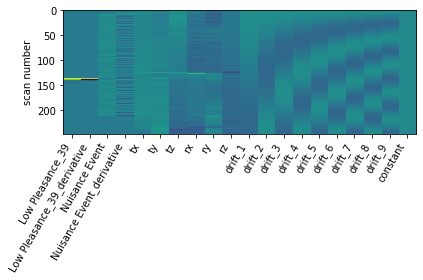

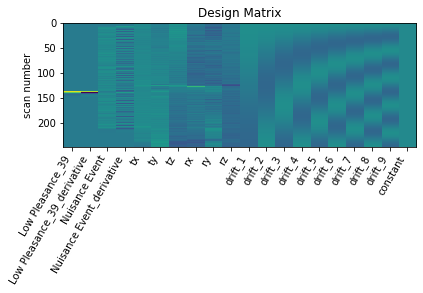

      0         1         2         3         4         5         6      \
0 -1.283882 -0.900829 -2.072347 -1.817069 -1.595959 -0.720876 -0.975465   

      7         8         9      ...     11447     11448    11449   11450  \
0 -0.327737 -0.380033 -0.500563  ... -3.066653 -3.084381 -2.94413 -0.8408   

      11451     11452     11453     11454     11455     11456  
0 -0.581737 -2.637971 -0.018259 -3.122489  0.575682 -1.132033  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_39
GLM RUN HighPleasance_40


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



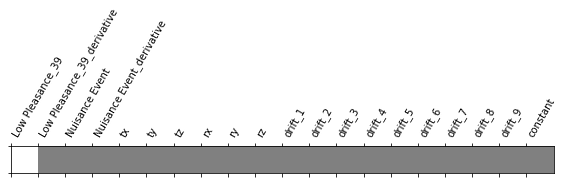

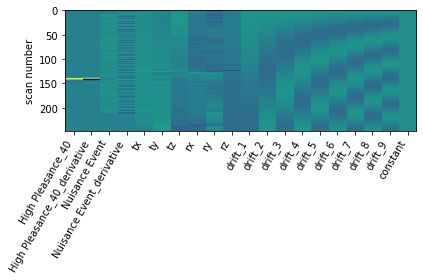

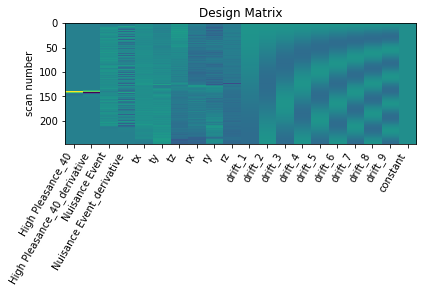

      0        1         2         3         4         5        6      \
0  1.134681 -0.53045  0.147794  0.954337  1.354654  0.766165  0.17419   

      7         8         9      ...     11447    11448     11449    11450  \
0 -0.382845 -0.344053 -0.814749  ... -0.217291 -0.64786  0.185768 -1.17204   

      11451     11452     11453     11454     11455     11456  
0  1.507098 -0.583753 -0.358326 -0.144984 -0.883286 -1.764337  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_40
GLM RUN LowPleasance_41


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



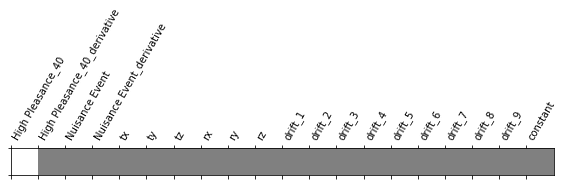

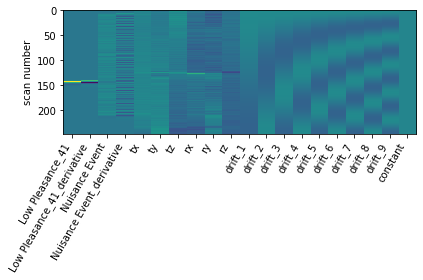

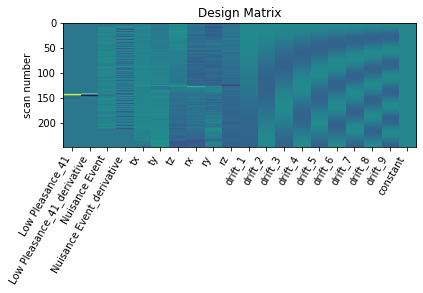

      0         1         2        3         4        5         6      \
0  0.458763  0.184756  1.436678  1.59589  1.639779  0.32312  0.144824   

      7        8         9      ...     11447    11448     11449     11450  \
0  0.551737  0.53636  0.797821  ... -0.289899 -0.11236 -0.739861  1.122108   

      11451     11452     11453     11454     11455     11456  
0 -0.821667 -0.827581  0.807838 -0.498797 -0.240967 -2.168397  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_41
GLM RUN LowPleasance_42


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



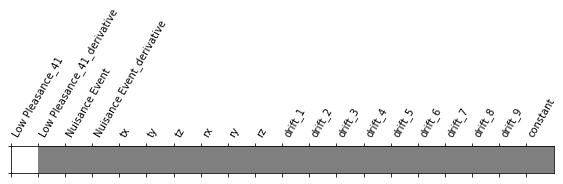

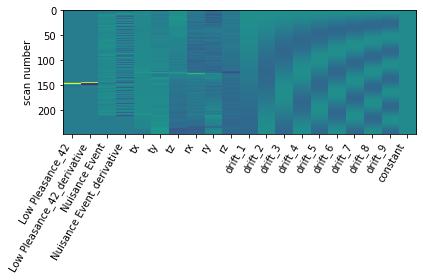

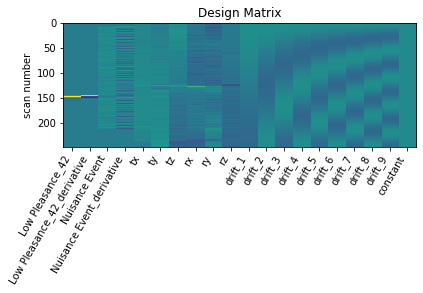

     0         1         2         3         4         5        6      \
0  0.88138 -1.073751 -0.479495 -0.128912 -0.028875  1.539252 -1.17752   

      7         8         9      ...     11447     11448     11449    11450  \
0 -0.293667  0.616484 -0.743273  ... -2.484258 -2.771397 -1.726467 -0.54766   

      11451     11452     11453     11454     11455     11456  
0  1.435643 -1.792188  0.725564 -2.248365 -0.027924 -1.679044  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_42
GLM RUN LowPleasance_43


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



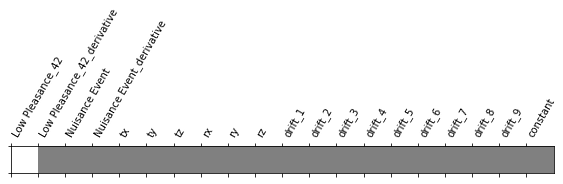

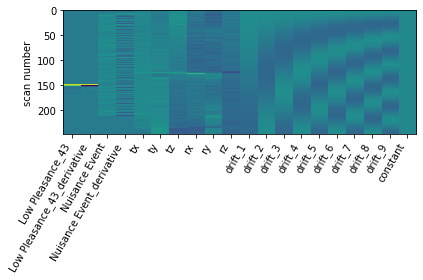

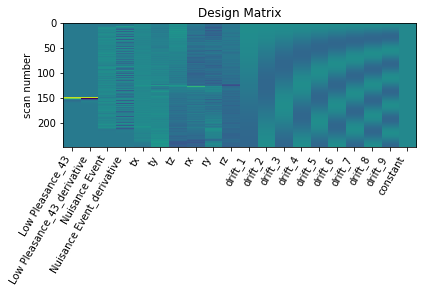

      0        1         2         3         4         5         6      \
0 -0.923278  0.23173  0.183878  0.758333  1.285868 -0.428812  0.027076   

      7       8         9      ...     11447     11448     11449     11450  \
0 -0.168965 -0.3341 -0.249141  ... -0.426033 -0.099928 -0.975152 -0.841795   

      11451     11452     11453     11454     11455     11456  
0  0.523009 -1.651221 -0.713578 -0.914933 -1.133914 -1.054128  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_43
GLM RUN LowPleasance_44


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 19 seconds



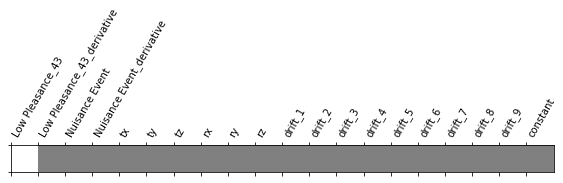

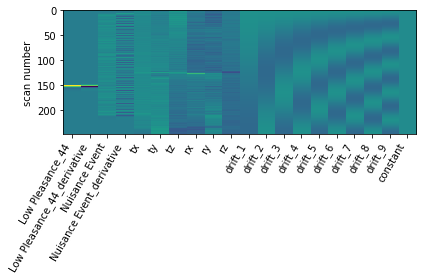

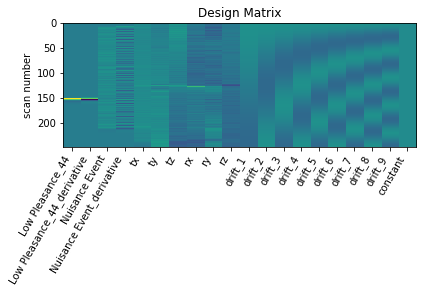

      0         1         2         3         4         5         6      \
0  1.036886 -0.715925  0.747778  1.174605  1.354998  1.041529  0.613495   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.445284  0.162855 -0.099579  ... -0.192199 -0.675099 -0.570217 -0.027245   

      11451     11452     11453     11454     11455     11456  
0 -0.274985 -0.018481  0.362576  0.127568  0.551013 -0.707663  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_44
GLM RUN HighPleasance_45


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



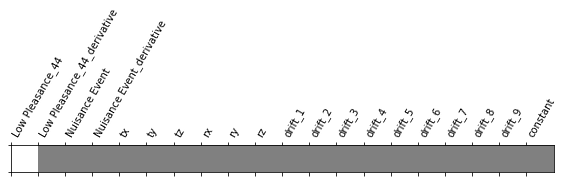

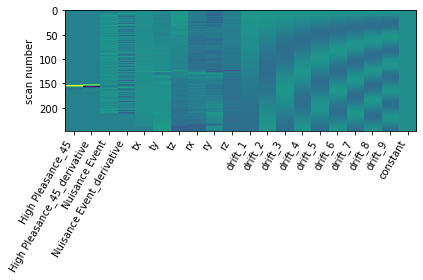

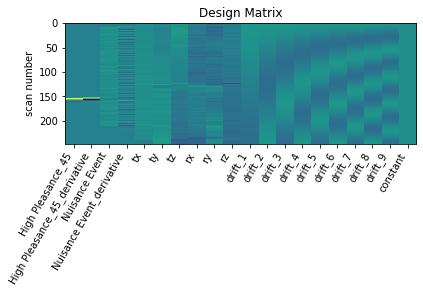

      0         1         2         3         4         5         6      \
0  1.199607 -0.565571  1.279434  1.313492  1.269758  0.915574 -0.129811   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.176104  0.588601  0.517673  ... -0.411254 -0.623214 -0.560432  0.494008   

      11451     11452     11453     11454     11455     11456  
0  0.093878 -1.229964  0.650338 -0.697503 -0.616289 -2.358869  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_45
GLM RUN LowPleasance_46


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



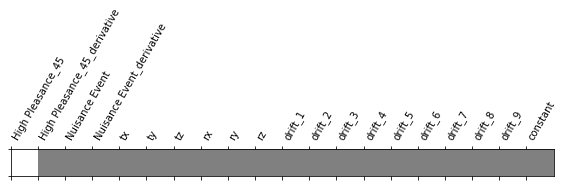

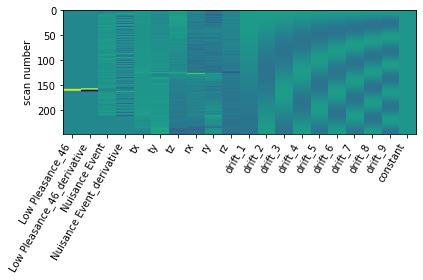

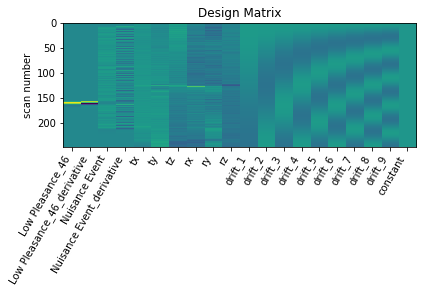

      0         1         2         3         4         5        6      \
0  1.731813 -0.455383  0.456288  1.366495  1.879806  1.201828 -0.33799   

      7         8         9      ...     11447    11448     11449     11450  \
0  0.395825  0.745189  0.233935  ... -1.042271 -1.11941 -0.885053 -1.082194   

      11451    11452     11453     11454     11455    11456  
0  1.028951 -1.26839  0.674781 -1.491446  0.279997 -2.46377  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_46
GLM RUN LowPleasance_47


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 19 seconds



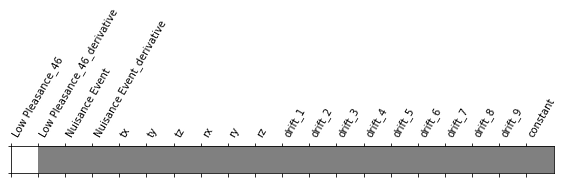

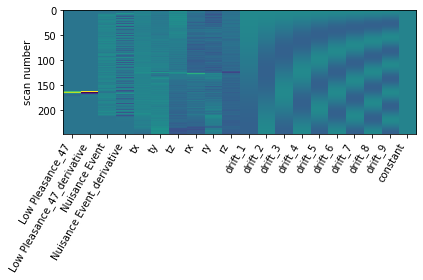

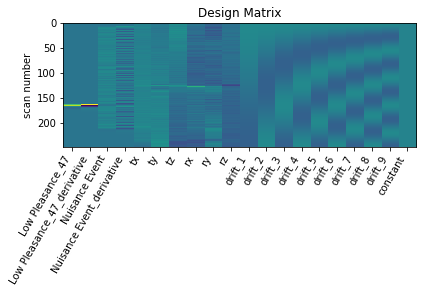

      0         1         2         3         4        5         6      \
0  0.775685  0.492836  0.765931  0.910541  0.964046  1.25078  1.121872   

    7        8         9      ...     11447     11448     11449     11450  \
0  1.0381  1.21957  0.593663  ...  0.039369 -0.248229 -0.582892  0.877795   

      11451     11452     11453    11454     11455     11456  
0 -0.191367 -0.853947  1.603064 -0.14561  0.642237 -0.434122  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_47
GLM RUN HighPleasance_48


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 19 seconds



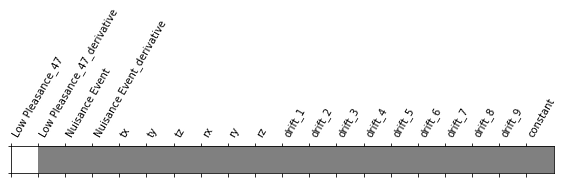

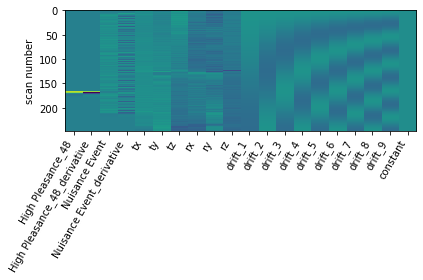

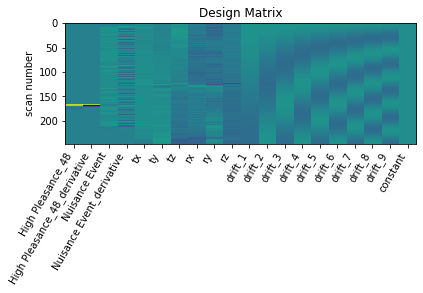

      0         1         2         3         4         5        6      \
0  1.776668 -0.314778  1.588504  1.892736  1.981612  1.819782 -0.01093   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.694258  1.174627  0.658256  ... -0.460718 -0.418068  0.252793 -0.577165   

      11451     11452    11453     11454     11455     11456  
0  0.616069 -0.704571  0.73014 -1.050579 -0.562807 -2.821639  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_48
GLM RUN LowPleasance_49


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



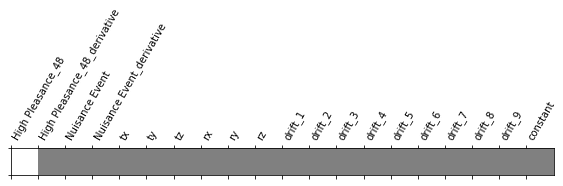

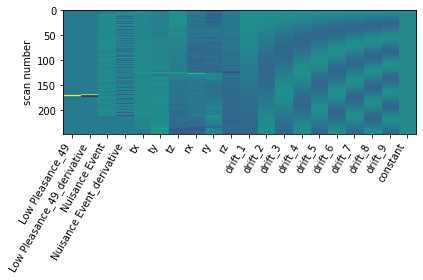

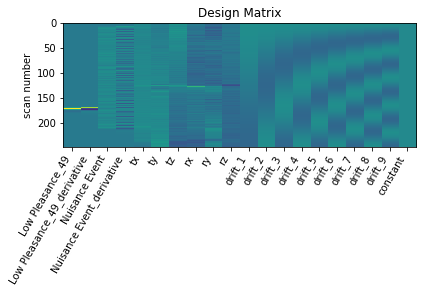

      0         1         2         3         4         5         6      \
0  1.135681  0.190815  0.108114  0.142459  0.496961 -1.504575 -0.405279   

      7         8         9      ...     11447     11448     11449    11450  \
0 -1.178308 -1.091806 -0.265421  ... -0.115067 -0.429817 -0.840218  0.58459   

      11451     11452     11453     11454     11455     11456  
0  0.820223 -0.093314  1.184932  0.225227  0.351989  0.131459  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_49
GLM RUN LowPleasance_50


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 23 seconds



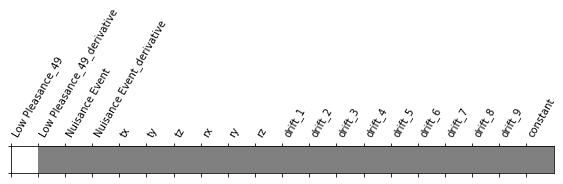

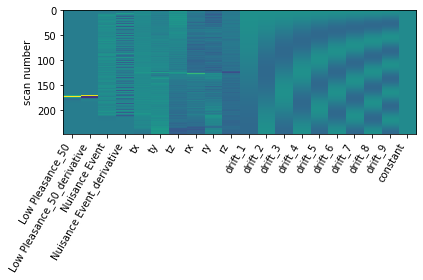

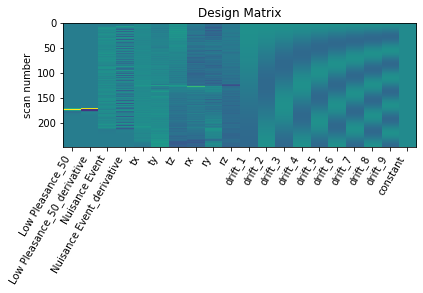

      0         1         2         3         4        5         6      \
0 -0.827072 -0.177082 -0.280015  0.540131  0.944837 -0.34536  0.108828   

      7         8         9      ...     11447     11448    11449     11450  \
0 -0.835558 -0.499046 -0.945016  ... -1.035975 -0.575382 -1.26238 -0.040759   

      11451     11452     11453     11454     11455     11456  
0  0.169358 -1.134413 -0.307654 -0.963565 -0.672931 -0.891214  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_50
GLM RUN LowPleasance_51


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



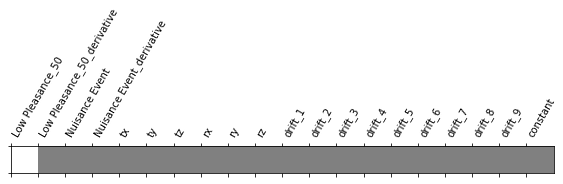

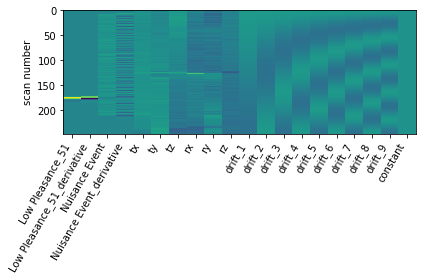

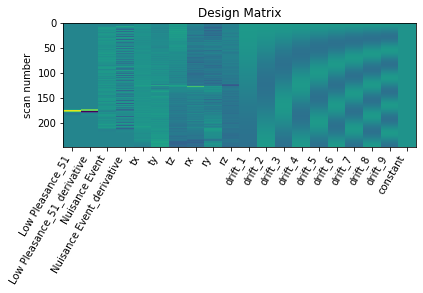

      0         1         2         3         4         5         6      \
0  1.009135  0.125676  0.934428  1.036416  1.010595  1.694907  0.572852   

      7         8         9      ...     11447     11448     11449    11450  \
0  1.422713  1.257497  0.638096  ... -0.500009 -0.841425 -0.464632 -0.19661   

      11451     11452     11453     11454     11455     11456  
0 -0.070041 -1.398226  0.719387 -1.330958 -0.247474 -2.503012  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_51
GLM RUN LowPleasance_52


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



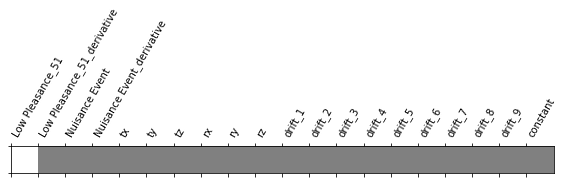

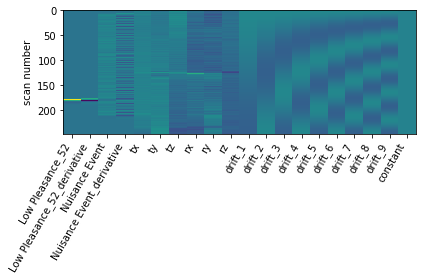

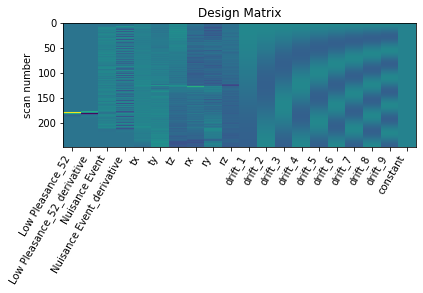

      0         1         2         3         4         5        6      \
0  1.369877 -0.108604  0.591011  0.954594  1.493274  0.221759 -0.52053   

      7         8         9      ...     11447     11448     11449     11450  \
0 -0.706956  0.028217 -0.539456  ... -1.406474 -1.154896 -0.678902  0.576959   

      11451    11452     11453    11454     11455     11456  
0  1.481957 -0.45329  1.115681 -0.97018  0.093347 -1.185732  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_52
GLM RUN HighPleasance_53


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



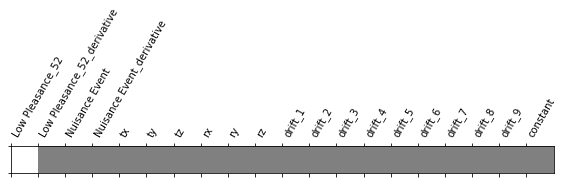

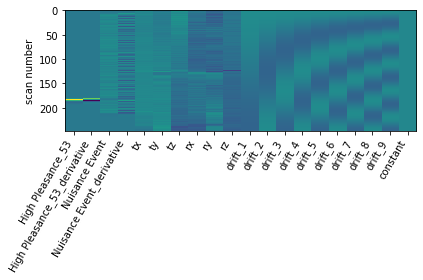

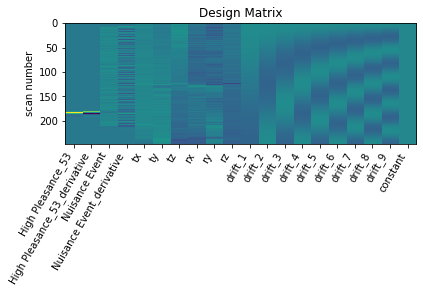

      0         1         2         3         4         5         6      \
0  0.713123  0.445023  0.281825  0.811346  0.730792  0.638658  0.072283   

      7         8         9      ...    11447    11448     11449     11450  \
0  0.258321  0.328241  0.259766  ... -1.02822 -0.70491 -1.366894 -0.232791   

      11451     11452     11453     11454   11455     11456  
0 -0.039904 -1.973725  0.998872 -1.513022 -0.8496 -1.944192  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_53
GLM RUN HighPleasance_54


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 18 seconds



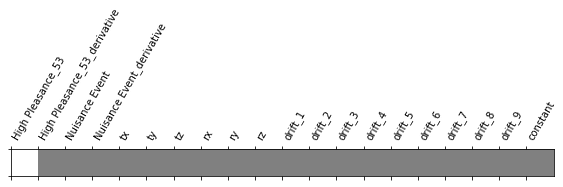

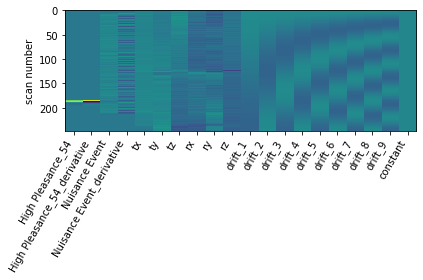

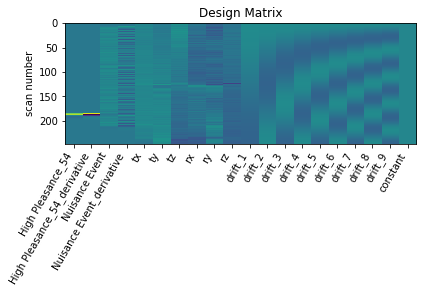

      0         1         2         3         4         5         6      \
0  0.608127 -1.442398  0.065201  0.553083  1.257969  1.659271  0.936821   

     7         8         9      ...    11447    11448     11449     11450  \
0  1.07269  1.055251  0.156771  ... -1.88562 -2.37606 -1.319294 -0.833695   

      11451     11452     11453     11454     11455     11456  
0  0.213216 -0.848186 -0.600443 -1.555015  0.035065 -1.883738  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_54
GLM RUN LowPleasance_55


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 21 seconds



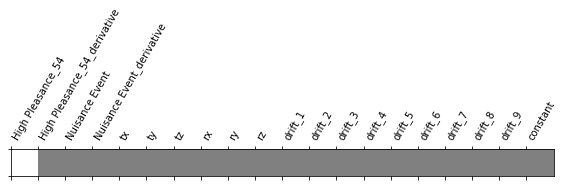

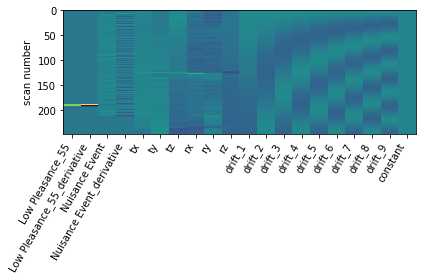

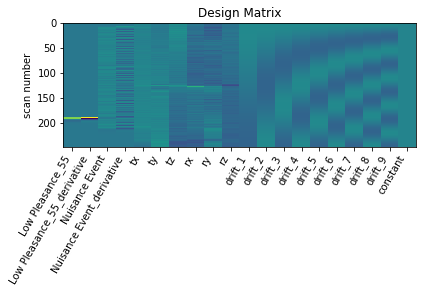

      0        1         2         3         4         5         6      \
0  2.254904  0.04429  2.921095  2.989849  2.429129  0.314428  0.690973   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.776601  0.770385  1.422797  ...  0.456317  0.146179 -0.143072  0.822277   

      11451     11452     11453     11454     11455     11456  
0  1.041962 -0.741255  1.854938  0.104662 -0.394649 -2.237844  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_55
GLM RUN LowPleasance_56


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



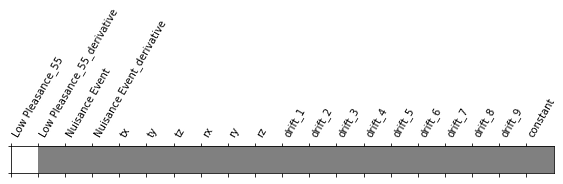

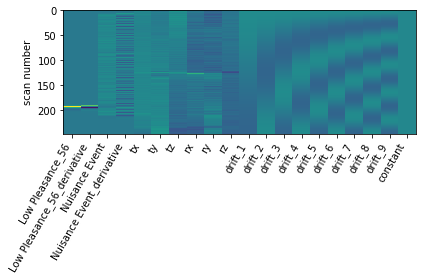

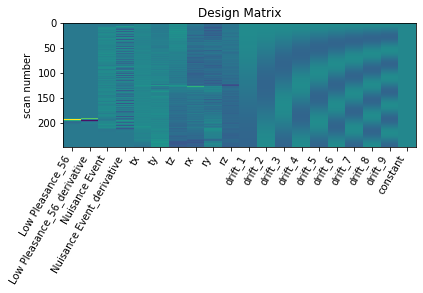

      0         1         2         3         4         5         6      \
0  0.622256  1.278033 -0.720309  0.130864  0.703953  1.033994  0.585549   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.507003  0.542966  0.490535  ... -0.169777 -0.387137  0.328846  0.126827   

      11451    11452     11453    11454     11455     11456  
0  0.482092  0.04155  1.171073 -0.37087  0.649688 -1.458292  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_56
GLM RUN LowPleasance_57


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



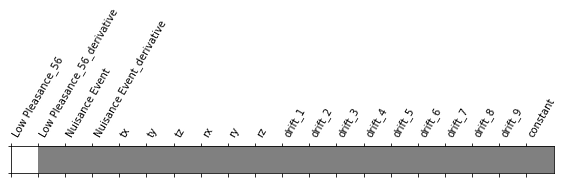

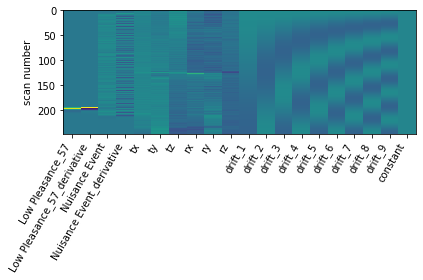

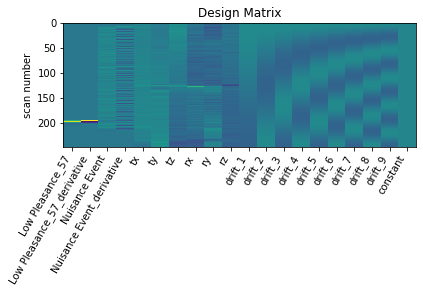

      0         1         2         3         4         5         6      \
0  1.323608 -2.249471  1.512379  1.220944  1.440357  0.212461  0.419627   

      7         8         9      ...     11447     11448     11449     11450  \
0  0.547938  0.221676 -0.361166  ... -1.275891 -0.967372 -1.525597 -0.251032   

      11451     11452    11453     11454     11455     11456  
0  0.480548 -1.007418 -0.01412 -1.259812 -0.730362 -1.182663  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_57
GLM RUN LowPleasance_58


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 19 seconds



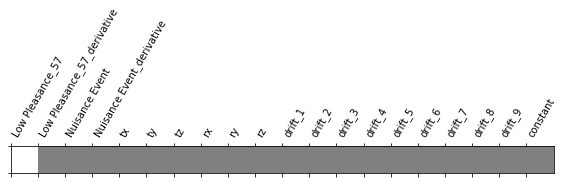

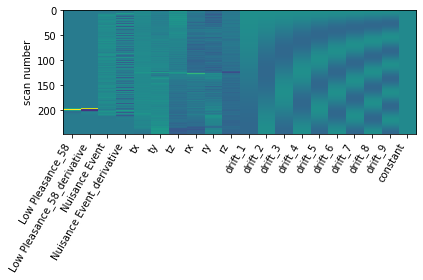

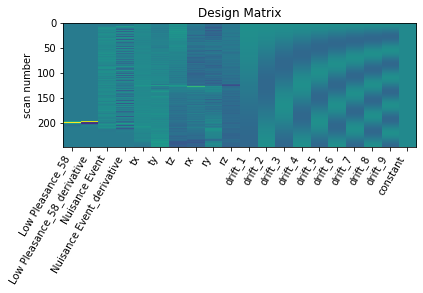

      0         1         2         3        4         5         6      \
0  1.675703  0.444703  1.249821  1.490093  1.05283  0.470161  0.950289   

      7         8         9      ...     11447     11448     11449     11450  \
0  1.583928  1.538644  1.847586  ...  0.272109  0.086636  0.212232 -0.215014   

      11451     11452    11453     11454     11455     11456  
0  0.023601 -0.523085  0.25506 -0.445372  0.712459  0.178415  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_58
GLM RUN HighPleasance_59


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 20 seconds



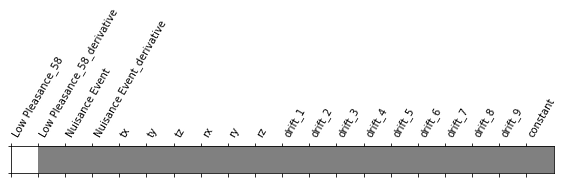

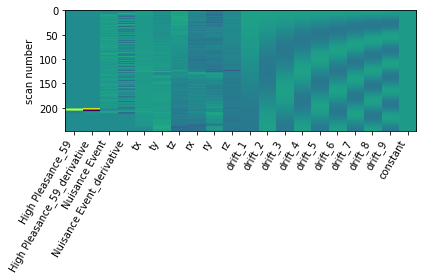

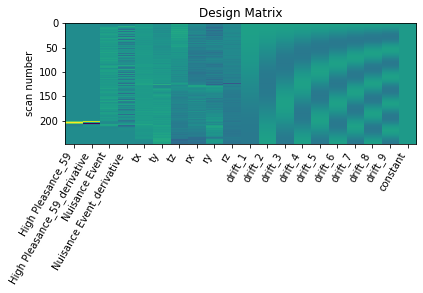

      0         1        2         3       4         5         6        7      \
0  0.644277 -0.137845  1.29227  1.496091  1.7471  1.478658 -0.125962 -0.07544   

      8         9      ...     11447    11448     11449     11450     11451  \
0  0.553085 -0.558271  ... -1.244332 -1.36576 -1.305265  0.858715  0.723802   

      11452     11453     11454     11455     11456  
0 -0.954797  0.128302 -1.170237 -1.119269 -2.482088  

[1 rows x 11457 columns]
ACTIVITY MATRIX HighPleasance_59
GLM RUN LowPleasance_60


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 22 seconds



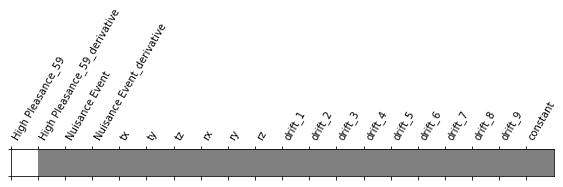

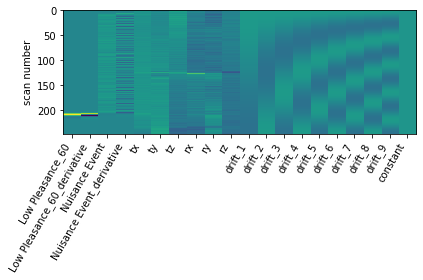

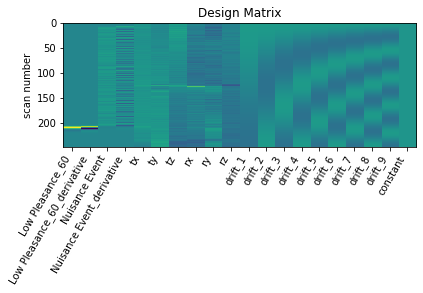

      0         1         2        3         4         5         6      \
0  0.640052 -0.332655 -0.335479  0.21491  0.226857  0.265021 -1.320097   

      7         8         9      ...    11447     11448    11449     11450  \
0 -0.504208  0.035747 -0.659467  ... -1.89308 -1.907998 -2.31134  0.019955   

      11451     11452     11453     11454     11455     11456  
0  0.619024 -2.965902 -0.284998 -1.772997 -1.170642 -2.122147  

[1 rows x 11457 columns]
ACTIVITY MATRIX LowPleasance_60


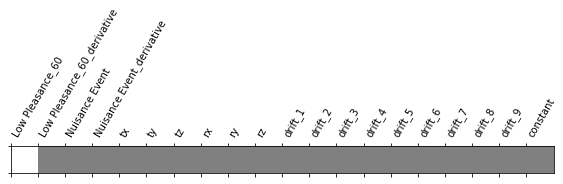

In [ ]:
y_p_pa, X_p_pa = lss_separate_method_comp(task =task,
                          data_path=data_path,
                          events_path=events_path,
                          motion_param_path=motion_param_path,
                          cache_mem_path=cache_mem_path,
                          activity_mat_saving_path=activity_mat_saving_path,
                          analysis_type=analysis_type,
                          param_modulation=False,
                          t_r=t_r,
                          drift_model=drift_model,
                          drift_order=drift_order,
                          hrf_model=hrf_model,
                          pre_whitening_spec=pre_whitening_spec,
                          apply_trans_mask=apply_trans_mask,
                          roi_img=roi_img,  
                          hpf_cut=hpf_cut,
                          smoothing_fwhm=smoothing_fwhm,
                          standardize=standardize,
                          detrend=detrend,minimize_memory=minimize_memory)

In [ ]:
y_g.append(y_p_pa)
X_g.append(X_p_pa)

### Global Dataset Construction

In [ ]:
y = np.vstack(y_g)
X = np.vstack(X_g)

In [ ]:
X.shape

(480, 11457)

In [ ]:
X

array([[-1.70422687,  1.92546241, -0.10691589, ...,  0.70083621,
         0.09323885,  0.6205132 ],
       [ 0.78493375, -0.43170829, -0.30364898, ..., -2.19357488,
         0.63363814, -1.91531656],
       [ 1.65100166, -0.71309618, -0.67164236, ...,  0.02392379,
        -2.35584922, -1.67773022],
       ...,
       [ 0.30887591, -2.62015283,  0.76716839, ..., -0.47513342,
        -0.92761726,  0.36003911],
       [ 0.68529284,  0.71258191,  0.52571039, ...,  0.50113342,
         1.25116959,  2.00136135],
       [-0.4218985 , -0.24902198, -0.93218671, ..., -1.09028583,
        -1.59247896, -0.77288414]])

In [ ]:
y.shape

(480, 1)

In [ ]:
y

array([['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['LP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['HP'],
       ['H

In [ ]:
X.tofile('mvpa/X_pref_lss_shift.dat')
y.tofile('mvpa/y_pref_lss_shift.dat')

In [ ]:
np.save('mvpa/X_pref_lss_shift',X)
np.save('mvpa/y_pref_lss_shift',y)
